# <center> Credit Risk Model </center>

# Risk Model

## Data Preparation

### Import Libraries

Import all the libraries important to build the model here

In [1]:
import pandas as pd 
import numpy as np 
import matplotlib.pyplot as plt    
import seaborn as sns  
 

### Import Data
The dataset contains all available data for more than 800,000 consumer loans issued from 2007 to 2015 by Lending Club: a large US peer-to-peer lending company. There are several different versions of this dataset. We have used a version available on kaggle.com. You can find it here: https://www.kaggle.com/wendykan/lending-club-loan-data/version/1
We divided the data into two periods because we assume that some data are available at the moment when we need to build Expected Loss models, and some data comes from applications after. Later, we investigate whether the applications we have after we built the Probability of Default (PD) model have similar characteristics with the applications we used to build the PD model.

In [2]:
loan_data_backup = pd.read_csv(r'F:\Learning\CreditRiskModelingInPython\loan_data_2007_2014.csv', low_memory=False)

#### Check the shape of the Data Frame

In [3]:
print("The shape of the dataframe loan data backup is :\t",loan_data_backup.shape)

The shape of the dataframe loan data backup is :	 (466285, 75)


So we have 466285 rows and 75 columns 

#### Check out all the columns in this dataset

In [4]:
loan_data_backup.columns.values

array(['Unnamed: 0', 'id', 'member_id', 'loan_amnt', 'funded_amnt',
       'funded_amnt_inv', 'term', 'int_rate', 'installment', 'grade',
       'sub_grade', 'emp_title', 'emp_length', 'home_ownership',
       'annual_inc', 'verification_status', 'issue_d', 'loan_status',
       'pymnt_plan', 'url', 'desc', 'purpose', 'title', 'zip_code',
       'addr_state', 'dti', 'delinq_2yrs', 'earliest_cr_line',
       'inq_last_6mths', 'mths_since_last_delinq',
       'mths_since_last_record', 'open_acc', 'pub_rec', 'revol_bal',
       'revol_util', 'total_acc', 'initial_list_status', 'out_prncp',
       'out_prncp_inv', 'total_pymnt', 'total_pymnt_inv',
       'total_rec_prncp', 'total_rec_int', 'total_rec_late_fee',
       'recoveries', 'collection_recovery_fee', 'last_pymnt_d',
       'last_pymnt_amnt', 'next_pymnt_d', 'last_credit_pull_d',
       'collections_12_mths_ex_med', 'mths_since_last_major_derog',
       'policy_code', 'application_type', 'annual_inc_joint', 'dti_joint',
       'veri

#### First five rows of this dataset

In [5]:
pd.set_option("display.max_columns", None)

In [6]:
loan_data_backup.head()

,Unnamed: 0,id,member_id,loan_amnt,funded_amnt,funded_amnt_inv,term,int_rate,installment,grade,sub_grade,emp_title,emp_length,home_ownership,annual_inc,verification_status,issue_d,loan_status,pymnt_plan,url,desc,purpose,title,zip_code,addr_state,dti,delinq_2yrs,earliest_cr_line,inq_last_6mths,mths_since_last_delinq,mths_since_last_record,open_acc,pub_rec,revol_bal,revol_util,total_acc,initial_list_status,out_prncp,out_prncp_inv,total_pymnt,total_pymnt_inv,total_rec_prncp,total_rec_int,total_rec_late_fee,recoveries,collection_recovery_fee,last_pymnt_d,last_pymnt_amnt,next_pymnt_d,last_credit_pull_d,collections_12_mths_ex_med,mths_since_last_major_derog,policy_code,application_type,annual_inc_joint,dti_joint,verification_status_joint,acc_now_delinq,tot_coll_amt,tot_cur_bal,open_acc_6m,open_il_6m,open_il_12m,open_il_24m,mths_since_rcnt_il,total_bal_il,il_util,open_rv_12m,open_rv_24m,max_bal_bc,all_util,total_rev_hi_lim,inq_fi,total_cu_tl,inq_last_12m
0,0,1077501,1296599,5000,5000,4975.0,36 months,10.65,162.87,B,B2,NaN,10+ years,RENT,24000.0,Verified,Dec-11,Fully Paid,n,https://www.lendingclub.com/browse/loanDetail....,Borrower added on 12/22/11 > I need to upgra...,credit_card,Computer,860xx,AZ,27.65,0.0,Jan-85,1.0,NaN,NaN,3.0,0.0,13648,83.7,9.0,f,0.0,0.0,5861.071414,5831.78,5000.00,861.07,0.00,0.00,0.00,Jan-15,171.62,NaN,Jan-16,0.0,NaN,1,INDIVIDUAL,NaN,NaN,NaN,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,1,1077430,1314167,2500,2500,2500.0,60 months,15.27,59.83,C,C4,Ryder,< 1 year,RENT,30000.0,Source Verified,Dec-11,Charged Off,n,https://www.lendingclub.com/browse/loanDetail....,Borrower added on 12/22/11 > I plan to use t...,car,bike,309xx,GA,1.00,0.0,Apr-99,5.0,NaN,NaN,3.0,0.0,1687,9.4,4.0,f,0.0,0.0,1008.710000,1008.71,456.46,435.17,0.00,117.08,1.11,Apr-13,119.66,NaN,Sep-13,0.0,NaN,1,INDIVIDUAL,NaN,NaN,NaN,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,2,1077175,1313524,2400,2400,2400.0,36 months,15.96,84.33,C,C5,NaN,10+ years,RENT,12252.0,Not Verified,Dec-11,Fully Paid,n,https://www.lendingclub.com/browse/loanDetail....,NaN,small_business,real estate business,606xx,IL,8.72,0.0,Nov-01,2.0,NaN,NaN,2.0,0.0,2956,98.5,10.0,f,0.0,0.0,3003.653644,3003.65,2400.00,603.65,0.00,0.00,0.00,Jun-14,649.91,NaN,Jan-16,0.0,NaN,1,INDIVIDUAL,NaN,NaN,NaN,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,3,1076863,1277178,10000,10000,10000.0,36 months,13.49,339.31,C,C1,AIR RESOURCES BOARD,10+ years,RENT,49200.0,Source Verified,Dec-11,Fully Paid,n,https://www.lendingclub.com/browse/loanDetail....,Borrower added on 12/21/11 > to pay for prop...,other,personel,917xx,CA,20.00,0.0,Feb-96,1.0,35.0,NaN,10.0,0.0,5598,21.0,37.0,f,0.0,0.0,12226.302210,12226.30,10000.00,2209.33,16.97,0.00,0.00,Jan-15,357.48,NaN,Jan-15,0.0,NaN,1,INDIVIDUAL,NaN,NaN,NaN,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,4,1075358,1311748,3000,3000,3000.0,60 months,12.69,67.79,B,B5,University Medical Group,1 year,RENT,80000.0,Source Verified,Dec-11,Current,n,https://www.lendingclub.com/browse/loanDetail....,Borrower added on 12/21/11 > I plan on combi...,other,Personal,972xx,OR,17.94,0.0,Jan-96,0.0,38.0,NaN,15.0,0.0,27783,53.9,38.0,f,766.9,766.9,3242.170000,3242.17,2233.10,1009.07,0.00,0.00,0.00,Jan-16,67.79,Feb-16,Jan-16,0.0,NaN,1,INDIVIDUAL,NaN,NaN,NaN,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


### Copy this dataframe to new dataframe

We will use the working data frame and keep loan_data_backup for backup incase we need it later

In [7]:
loan_data = loan_data_backup.copy()

#### Check the shape of the new working dataframe Loan_data

In [8]:
print("The shape of the dataframe loan_data is\t", loan_data.shape)

The shape of the dataframe loan_data is	 (466285, 75)


### Explore Data

In [9]:
pd.set_option("display.max_rows", None)

In [10]:
loan_data.sample(5)

,Unnamed: 0,id,member_id,loan_amnt,funded_amnt,funded_amnt_inv,term,int_rate,installment,grade,sub_grade,emp_title,emp_length,home_ownership,annual_inc,verification_status,issue_d,loan_status,pymnt_plan,url,desc,purpose,title,zip_code,addr_state,dti,delinq_2yrs,earliest_cr_line,inq_last_6mths,mths_since_last_delinq,mths_since_last_record,open_acc,pub_rec,revol_bal,revol_util,total_acc,initial_list_status,out_prncp,out_prncp_inv,total_pymnt,total_pymnt_inv,total_rec_prncp,total_rec_int,total_rec_late_fee,recoveries,collection_recovery_fee,last_pymnt_d,last_pymnt_amnt,next_pymnt_d,last_credit_pull_d,collections_12_mths_ex_med,mths_since_last_major_derog,policy_code,application_type,annual_inc_joint,dti_joint,verification_status_joint,acc_now_delinq,tot_coll_amt,tot_cur_bal,open_acc_6m,open_il_6m,open_il_12m,open_il_24m,mths_since_rcnt_il,total_bal_il,il_util,open_rv_12m,open_rv_24m,max_bal_bc,all_util,total_rev_hi_lim,inq_fi,total_cu_tl,inq_last_12m
172790,172790,3098466,3771039,25000,25000,25000.0,36 months,10.16,808.56,B,B1,"Accurate Background, Inc",2 years,MORTGAGE,97000.0,Verified,Jan-13,Fully Paid,n,https://www.lendingclub.com/browse/loanDetail....,NaN,credit_card,Credit Card Refinancing,923xx,CA,11.64,0.0,Jul-02,1.0,NaN,NaN,12.0,0.0,20239,86.1,31.0,w,0.00,0.00,27487.51,27487.51,25000.00,2487.51,0.0,0.0,0.0,Mar-14,16976.23,NaN,Jan-16,0.0,NaN,1,INDIVIDUAL,NaN,NaN,NaN,0.0,0.0,339852.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,23500.0,NaN,NaN,NaN
375448,375448,17954747,20107251,16200,16200,16200.0,36 months,6.49,496.45,A,A2,Treasury Analyst,6 years,MORTGAGE,120000.0,Source Verified,Jun-14,Current,n,https://www.lendingclub.com/browse/loanDetail....,NaN,debt_consolidation,Debt consolidation,988xx,WA,23.83,0.0,Oct-00,1.0,39.0,NaN,21.0,0.0,16438,49.1,42.0,w,8042.19,8042.19,9432.55,9432.55,8157.81,1274.74,0.0,0.0,0.0,Jan-16,496.45,Feb-16,Jan-16,0.0,NaN,1,INDIVIDUAL,NaN,NaN,NaN,0.0,0.0,356768.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,33500.0,NaN,NaN,NaN
406998,406998,14638654,16700994,4850,4850,4850.0,36 months,19.47,178.94,D,D5,sales associate,2 years,RENT,13534.0,Verified,Apr-14,Current,n,https://www.lendingclub.com/browse/loanDetail....,NaN,major_purchase,Major purchase,207xx,MD,34.25,0.0,Nov-95,0.0,43.0,NaN,5.0,0.0,9081,56.8,18.0,f,2365.39,2365.39,3757.74,3757.74,2484.61,1273.13,0.0,0.0,0.0,Jan-16,178.94,Feb-16,Jan-16,0.0,43.0,1,INDIVIDUAL,NaN,NaN,NaN,0.0,0.0,12650.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,16000.0,NaN,NaN,NaN
450107,450107,11395429,13317604,8400,8400,8400.0,36 months,9.67,269.75,B,B1,Retired teacher/Per Diem Teacher,10+ years,RENT,45000.0,Not Verified,Jan-14,Current,n,https://www.lendingclub.com/browse/loanDetail....,NaN,other,Other,112xx,NY,3.65,0.0,Nov-97,0.0,NaN,99.0,7.0,1.0,4502,14.9,13.0,w,3316.47,3316.47,6204.25,6204.25,5083.53,1120.72,0.0,0.0,0.0,Jan-16,269.75,Feb-16,Jan-16,0.0,NaN,1,INDIVIDUAL,NaN,NaN,NaN,0.0,0.0,4502.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,30200.0,NaN,NaN,NaN
319005,319005,25256965,27709770,6000,6000,6000.0,36 months,11.67,198.35,B,B4,Collection Specialist,3 years,OWN,28000.0,Source Verified,Aug-14,Current,n,https://www.lendingclub.com/browse/loanDetail....,NaN,debt_consolidation,Debt consolidation,272xx,NC,9.90,0.0,Nov-93,0.0,NaN,44.0,10.0,1.0,4753,57.3,33.0,f,3588.97,3588.97,3173.60,3173.60,2411.03,762.57,0.0,0.0,0.0,Jan-16,198.35,Feb-16,Jan-16,0.0,NaN,1,INDIVIDUAL,NaN,NaN,NaN,0.0,0.0,17465.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,8300.0,NaN,NaN,NaN


#### Dataset columns

In [11]:
loan_data.columns.values

array(['Unnamed: 0', 'id', 'member_id', 'loan_amnt', 'funded_amnt',
       'funded_amnt_inv', 'term', 'int_rate', 'installment', 'grade',
       'sub_grade', 'emp_title', 'emp_length', 'home_ownership',
       'annual_inc', 'verification_status', 'issue_d', 'loan_status',
       'pymnt_plan', 'url', 'desc', 'purpose', 'title', 'zip_code',
       'addr_state', 'dti', 'delinq_2yrs', 'earliest_cr_line',
       'inq_last_6mths', 'mths_since_last_delinq',
       'mths_since_last_record', 'open_acc', 'pub_rec', 'revol_bal',
       'revol_util', 'total_acc', 'initial_list_status', 'out_prncp',
       'out_prncp_inv', 'total_pymnt', 'total_pymnt_inv',
       'total_rec_prncp', 'total_rec_int', 'total_rec_late_fee',
       'recoveries', 'collection_recovery_fee', 'last_pymnt_d',
       'last_pymnt_amnt', 'next_pymnt_d', 'last_credit_pull_d',
       'collections_12_mths_ex_med', 'mths_since_last_major_derog',
       'policy_code', 'application_type', 'annual_inc_joint', 'dti_joint',
       'veri

#### Dataset information

In [12]:
loan_data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 466285 entries, 0 to 466284
Data columns (total 75 columns):
 #   Column                       Non-Null Count   Dtype  
---  ------                       --------------   -----  
 0   Unnamed: 0                   466285 non-null  int64  
 1   id                           466285 non-null  int64  
 2   member_id                    466285 non-null  int64  
 3   loan_amnt                    466285 non-null  int64  
 4   funded_amnt                  466285 non-null  int64  
 5   funded_amnt_inv              466285 non-null  float64
 6   term                         466285 non-null  object 
 7   int_rate                     466285 non-null  float64
 8   installment                  466285 non-null  float64
 9   grade                        466285 non-null  object 
 10  sub_grade                    466285 non-null  object 
 11  emp_title                    438697 non-null  object 
 12  emp_length                   445277 non-null  object 
 13 

In [13]:
# Get data types of columns
data_types = loan_data.dtypes
# Count the occurrences of each data type
data_type_counts = data_types.value_counts()
# Print the result
print("The total count of datatypes are :\n", data_type_counts)

The total count of datatypes are :
 float64    46
object     22
int64       7
Name: count, dtype: int64


### General Preprocessing

#### Preprocessing continuous variables

##### emp_length

In [14]:
loan_data['emp_length'].unique()
# Displays unique values of a column.

array(['10+ years', '< 1 year', '1 year', '3 years', '8 years', '9 years',
       '4 years', '5 years', '6 years', '2 years', '7 years', nan],
      dtype=object)

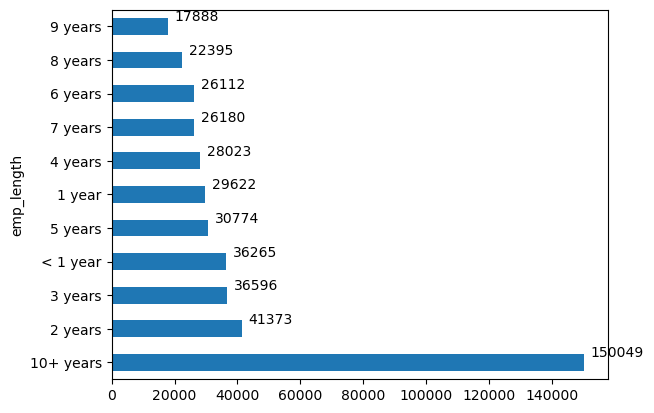

In [15]:
# Perhaps it is better if we can use value_count for this to know the distribution

ax = loan_data['emp_length'].value_counts().plot(kind = 'barh')

for p in ax.patches:
    ax.annotate(str(p.get_width()), (p.get_x() + p.get_width(), p.get_y()), xytext=(5, 10), textcoords='offset points')

# Show the plot
plt.show()

* We store the preprocessed ‘employment length’ variable in a new variable called ‘employment length int’,<br>
* We assign the new ‘employment length int’ to be equal to the ‘employment length’ variable with the string ‘+ years’<br>
* replaced with nothing. Next, we replace the whole string ‘less than 1 year’ with the string ‘0’.<br>
* Then, we replace the ‘n/a’ string with the string ‘0’. Then, we replace the string ‘space years’ with nothing.<br>
* Finally, we replace the string ‘space year’ with nothing.<br>

In [16]:
loan_data['emp_length_int'] = loan_data['emp_length'].str.replace('+ years', '')
loan_data['emp_length_int'] = loan_data['emp_length_int'].str.replace('< 1 year', str(0))
loan_data['emp_length_int'] = loan_data['emp_length_int'].str.replace('n/a',  str(0))
loan_data['emp_length_int'] = loan_data['emp_length_int'].str.replace(' years', '')
loan_data['emp_length_int'] = loan_data['emp_length_int'].str.replace(' year', '')



Let us see the how many missing values we have

In [17]:
print(round(loan_data['emp_length_int'].isnull().sum()/len(loan_data) * 100,2),"% data missing in emp_lenght_int column which is", loan_data['emp_length_int'].isnull().sum(),"out of ", len(loan_data), "missing")

4.51 % data missing in emp_lenght_int column which is 21008 out of  466285 missing


We can see there is still nan in the data. Need to do something about it. I will assign 0 to it.

In [18]:
loan_data['emp_length_int'].fillna(str(0), inplace=True)

In [19]:
loan_data['emp_length'].unique()
# Displays unique values of a column.

array(['10+ years', '< 1 year', '1 year', '3 years', '8 years', '9 years',
       '4 years', '5 years', '6 years', '2 years', '7 years', nan],
      dtype=object)

In [20]:
loan_data['emp_length_int'].unique()
# Displays unique values of a column.

array(['10', '0', '1', '3', '8', '9', '4', '5', '6', '2', '7'],
      dtype=object)

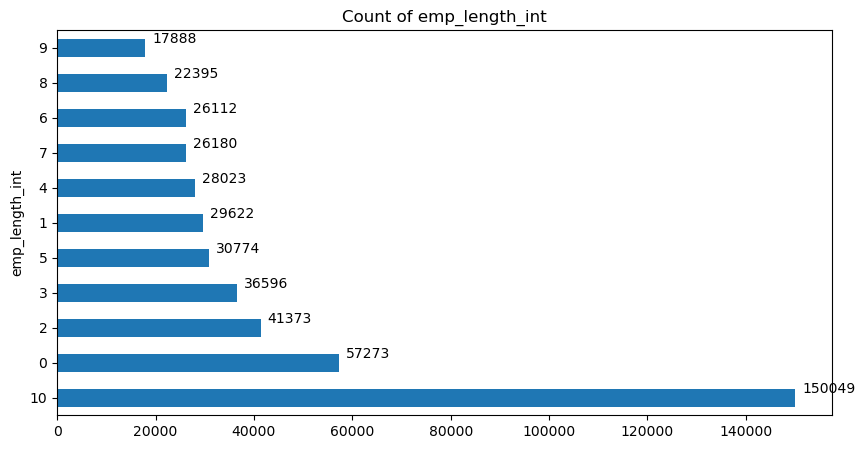

In [21]:
# Perhaps it is better if we can use value_count for this to know the distribution

ax = loan_data['emp_length_int'].value_counts().plot(kind = 'barh', figsize=(10,5))

for p in ax.patches:
    ax.annotate(str(p.get_width()), (p.get_x() + p.get_width(), p.get_y()), xytext=(5, 10), textcoords='offset points')
# Title of plot
plt.title("Count of emp_length_int")
# Show the plot
plt.show()

We will check the datatype of new column and change it to integer if required

In [22]:
type(loan_data['emp_length_int'][0])
# Checks the datatype of a single element of a column.

str

Since this is string we will convert it to integer

In [23]:
loan_data['emp_length_int'] = pd.to_numeric(loan_data['emp_length_int'])
# Transforms the values to numeric.

In [24]:
type(loan_data['emp_length_int'][0])
# Checks the datatype of a single element of a column.

numpy.int64

##### earliest_cr_line

In [25]:
loan_data['earliest_cr_line'].value_counts()
# Displays a column.

earliest_cr_line
Oct-00    3674
Aug-00    3597
Aug-01    3455
Oct-99    3406
Oct-01    3329
Nov-99    3323
Nov-00    3267
Sep-00    3256
Sep-99    3130
Aug-99    3126
Sep-01    3061
Oct-02    3016
Dec-99    2968
Dec-00    2951
Nov-98    2899
Dec-98    2883
Oct-98    2862
Aug-02    2851
Sep-02    2846
Jul-00    2835
May-01    2819
Jul-01    2798
Jan-01    2797
Nov-01    2797
Sep-98    2782
May-00    2778
Mar-01    2757
Mar-00    2732
Dec-01    2726
Jun-01    2718
Jan-00    2685
Jun-00    2664
Feb-00    2644
Oct-03    2610
Sep-03    2580
Aug-98    2580
Apr-01    2544
Jul-99    2533
Mar-99    2501
Dec-97    2463
Apr-00    2456
Oct-97    2442
Jul-02    2435
Feb-01    2432
Jan-02    2419
Jun-99    2413
Nov-97    2404
May-99    2386
Aug-03    2347
Nov-96    2325
Nov-02    2319
Jan-99    2311
May-02    2295
Feb-99    2267
Oct-96    2246
Mar-02    2237
Jul-03    2232
Sep-97    2230
Sep-04    2200
Feb-02    2158
Apr-02    2157
Sep-95    2156
Oct-95    2145
Jul-98    2143
Nov-03    2136
Dec-02  

Extracts the date and the time from a string variable that is in a given format.

In [26]:
loan_data['earliest_cr_line_date'] = pd.to_datetime(loan_data['earliest_cr_line'], format = '%b-%y')
# Extracts the date and the time from a string variable that is in a given format.

Check the sample

In [27]:
loan_data['earliest_cr_line_date'].sample(5)

57582    1980-04-01
453569   2000-10-01
218432   1990-01-01
55600    1996-08-01
338916   1992-05-01
Name: earliest_cr_line_date, dtype: datetime64[ns]

Checkout of the datatype of single element of a column

In [28]:
type(loan_data['earliest_cr_line_date'][0])
# Checks the datatype of a single element of a column.

pandas._libs.tslibs.timestamps.Timestamp

Any date which is greater then 2017-12-01 is incorrect and so we should replace the first two digitis of the year from 20 to 19

In [29]:
# Any date which is greater then 2017-12-01 is incorrect and so we should replace the first two digitis of the year from 20 to 19

loan_data['earliest_cr_line_date'] = loan_data['earliest_cr_line_date'].apply(lambda x: x.replace(year=x.year - 100) if x.year > 2017 else x)

In [30]:
"""
# Assume we are now in December 2017
loan_data['mths_since_earliest_cr_line'] = round(pd.to_numeric((pd.to_datetime('2017-12-01') - loan_data['earliest_cr_line_date']) / np.timedelta64(1, 'M')))
# We calculate the difference between two dates in months, turn it to numeric datatype and round it.
# We save the result in a new variable.

Since np.timedelta64 do not support M anymore we have to do it differently
"""

"\n# Assume we are now in December 2017\nloan_data['mths_since_earliest_cr_line'] = round(pd.to_numeric((pd.to_datetime('2017-12-01') - loan_data['earliest_cr_line_date']) / np.timedelta64(1, 'M')))\n# We calculate the difference between two dates in months, turn it to numeric datatype and round it.\n# We save the result in a new variable.\n\nSince np.timedelta64 do not support M anymore we have to do it differently\n"

Calculate the month difference from 2017-12-01

In [31]:
from dateutil.relativedelta import relativedelta

def calculate_months_difference(x):
    try:
        diff = relativedelta(pd.to_datetime('2017-12-01'), x)
        months_diff = diff.years * 12 + diff.months
        return months_diff
    except Exception as e:
        return None  # Handle cases where the date conversion or calculation fails

# Assuming you have a DataFrame with a column 'earliest_cr_line_date' containing datetime values
loan_data['mths_since_earliest_cr_line'] = loan_data['earliest_cr_line_date'].apply(calculate_months_difference)

# Option 1:
# Drop rows where the calculation failed (result is None)

loan_data = loan_data.dropna(subset=['mths_since_earliest_cr_line'])

# Option 2:
# We can also fill something there to check further
#loan_data['mths_since_earliest_cr_line'].fillna(pd.to_datetime('1900-01-01'), inplace = True)

# Round the result if needed
loan_data['mths_since_earliest_cr_line'] = loan_data['mths_since_earliest_cr_line'].round()

In [32]:
loan_data['mths_since_earliest_cr_line'].describe()
# Shows some descriptive statisics for the values of a column.
# Dates from 1969 and before are not being converted well, i.e., they have become 2069 and similar,
# and negative differences are being calculated.

count    466256.000000
mean        242.491078
std          86.928944
min          73.000000
25%         184.000000
50%         226.000000
75%         285.000000
max         887.000000
Name: mths_since_earliest_cr_line, dtype: float64

##### Term

In [33]:
loan_data['term'].describe()

count         466256
unique             2
top        36 months
freq          337924
Name: term, dtype: object

Check the unique values in variable term

In [34]:
loan_data['term'].unique()

array([' 36 months', ' 60 months'], dtype=object)

Replace the Month with space

In [35]:
loan_data['term_int'] = pd.to_numeric(loan_data['term'].str.replace(' months', ''))

Check unique values after replace

In [36]:
loan_data['term_int'].unique()

array([36, 60], dtype=int64)

Checks the datatype of a single element of a column

In [37]:
type(loan_data['term_int'][0])
# Checks the datatype of a single element of a column.

numpy.int64

##### issue_d

Check few samples

In [38]:
loan_data['issue_d'].sample(5)

205344    Aug-12
198274    Sep-12
437656    Feb-14
11181     Jul-11
464067    Jan-14
Name: issue_d, dtype: object

Assume we are now in December 2017

In [39]:
loan_data['issue_d_date'] = pd.to_datetime(loan_data['issue_d'], format = '%b-%y')


In [40]:
loan_data['issue_d_date'].sample(5)

449193   2014-02-01
462009   2014-01-01
199128   2012-09-01
302937   2014-10-01
137001   2013-05-01
Name: issue_d_date, dtype: datetime64[ns]

Calculate the month difference

In [41]:
def calculate_months_difference(x):
    try:
        diff = relativedelta(pd.to_datetime('2017-12-01'), x)
        months_diff = diff.years * 12 + diff.months
        return months_diff
    except Exception as e:
        return None  # Handle cases where the date conversion or calculation fails

# Assuming you have a DataFrame with a column 'earliest_cr_line_date' containing datetime values
loan_data['mths_since_issue_d'] = loan_data['issue_d_date'].apply(calculate_months_difference)

# Drop rows where the calculation failed (result is None)
loan_data = loan_data.dropna(subset=['mths_since_issue_d'])

# Round the result if needed
loan_data['mths_since_issue_d'] = loan_data['mths_since_issue_d'].round()

In [42]:
"""
# # Extracts the date and the time from a string variable that is in a given format.
# loan_data['mths_since_issue_d'] = round(pd.to_numeric((pd.to_datetime('2017-12-01') - loan_data['issue_d_date']) / np.timedelta64(1, 'M')))
# # We calculate the difference between two dates in months, turn it to numeric datatype and round it.
# # We save the result in a new variable.
# loan_data['mths_since_issue_d'].describe()
# # Shows some descriptive statisics for the values of a column."""

"\n# # Extracts the date and the time from a string variable that is in a given format.\n# loan_data['mths_since_issue_d'] = round(pd.to_numeric((pd.to_datetime('2017-12-01') - loan_data['issue_d_date']) / np.timedelta64(1, 'M')))\n# # We calculate the difference between two dates in months, turn it to numeric datatype and round it.\n# # We save the result in a new variable.\n# loan_data['mths_since_issue_d'].describe()\n# # Shows some descriptive statisics for the values of a column."

In [44]:
# We save the result in a new variable.
loan_data['mths_since_issue_d'].describe()
# Shows some descriptive statisics for the values of a column.

count    466256.000000
mean         51.250564
std          14.328612
min          36.000000
25%          41.000000
50%          47.000000
75%          57.000000
max         126.000000
Name: mths_since_issue_d, dtype: float64

In [45]:
loan_data.loc[:,['issue_d','issue_d_date','mths_since_issue_d']].sample(10)

,issue_d,issue_d_date,mths_since_issue_d
431492,Mar-14,2014-03-01,45
337989,Jul-14,2014-07-01,41
205897,Aug-12,2012-08-01,64
19182,Feb-11,2011-02-01,82
153750,Apr-13,2013-04-01,56
163866,Feb-13,2013-02-01,58
400459,May-14,2014-05-01,43
309275,Sep-14,2014-09-01,39
345156,Jul-14,2014-07-01,41
424476,Mar-14,2014-03-01,45


#### Preprocessing few discrete variables

We are going to preprocess the following discrete variables: grade, sub_grade, home_ownership, verification_status, loan_status, purpose, addr_state, initial_list_status. Most likely, we are not going to use sub_grade, as it overlaps with grade.

In [46]:
loan_data_dummies = [pd.get_dummies(loan_data['grade'], prefix = 'grade', prefix_sep = ':'),
                     pd.get_dummies(loan_data['sub_grade'], prefix = 'sub_grade', prefix_sep = ':'),
                     pd.get_dummies(loan_data['home_ownership'], prefix = 'home_ownership', prefix_sep = ':'),
                     pd.get_dummies(loan_data['verification_status'], prefix = 'verification_status', prefix_sep = ':'),
                     pd.get_dummies(loan_data['loan_status'], prefix = 'loan_status', prefix_sep = ':'),
                     pd.get_dummies(loan_data['purpose'], prefix = 'purpose', prefix_sep = ':'),
                     pd.get_dummies(loan_data['addr_state'], prefix = 'addr_state', prefix_sep = ':'),
                     pd.get_dummies(loan_data['initial_list_status'], prefix = 'initial_list_status', prefix_sep = ':')]
# We create dummy variables from all 8 original independent variables, and save them into a list.
# Note that we are using a particular naming convention for all variables: original variable name, colon, category name.

In [47]:
loan_data_dummies = pd.concat(loan_data_dummies, axis = 1)
# We concatenate the dummy variables and this turns them into a dataframe.

In [48]:
type(loan_data_dummies)
# Returns the type of the variable.

pandas.core.frame.DataFrame

In [49]:
loan_data = pd.concat([loan_data, loan_data_dummies], axis = 1)
# Concatenates two dataframes.
# Here we concatenate the dataframe with original data with the dataframe with dummy variables, along the columns. 

In [50]:
loan_data.shape

(466256, 207)

In [51]:
loan_data.columns.values
# Displays all column names.

array(['Unnamed: 0', 'id', 'member_id', 'loan_amnt', 'funded_amnt',
       'funded_amnt_inv', 'term', 'int_rate', 'installment', 'grade',
       'sub_grade', 'emp_title', 'emp_length', 'home_ownership',
       'annual_inc', 'verification_status', 'issue_d', 'loan_status',
       'pymnt_plan', 'url', 'desc', 'purpose', 'title', 'zip_code',
       'addr_state', 'dti', 'delinq_2yrs', 'earliest_cr_line',
       'inq_last_6mths', 'mths_since_last_delinq',
       'mths_since_last_record', 'open_acc', 'pub_rec', 'revol_bal',
       'revol_util', 'total_acc', 'initial_list_status', 'out_prncp',
       'out_prncp_inv', 'total_pymnt', 'total_pymnt_inv',
       'total_rec_prncp', 'total_rec_int', 'total_rec_late_fee',
       'recoveries', 'collection_recovery_fee', 'last_pymnt_d',
       'last_pymnt_amnt', 'next_pymnt_d', 'last_credit_pull_d',
       'collections_12_mths_ex_med', 'mths_since_last_major_derog',
       'policy_code', 'application_type', 'annual_inc_joint', 'dti_joint',
       'veri

#### Working with Missing Values

In [52]:
pd.set_option('display.max_rows', None)
loan_data.isnull().sum()

Unnamed: 0                                                              0
id                                                                      0
member_id                                                               0
loan_amnt                                                               0
funded_amnt                                                             0
funded_amnt_inv                                                         0
term                                                                    0
int_rate                                                                0
installment                                                             0
grade                                                                   0
sub_grade                                                               0
emp_title                                                           27576
emp_length                                                          21008
home_ownership                        

In [53]:
pd.set_option('display.max_rows', 100)

In [54]:
loan_data['total_rev_hi_lim'].fillna(loan_data['funded_amnt'], inplace = True)

In [55]:
loan_data['total_rev_hi_lim'].isnull().sum()

0

In [59]:
loan_data['mths_since_earliest_cr_line'].fillna(0, inplace=True)
loan_data['acc_now_delinq'].fillna(0, inplace=True)
loan_data['total_acc'].fillna(0, inplace=True)
loan_data['pub_rec'].fillna(0, inplace=True)
loan_data['open_acc'].fillna(0, inplace=True)
loan_data['inq_last_6mths'].fillna(0, inplace=True)
loan_data['delinq_2yrs'].fillna(0, inplace=True)
loan_data['emp_length_int'].fillna(0, inplace=True)
# We fill the missing values with zeroes.

## PD model

### Data preparation

#### Dependent Variable. Good/ Bad (Default) Definition. Default and Non-default Accounts.

In [61]:
loan_data['loan_status'].value_counts()
# Calculates the number of observations for each unique value of a variable.

loan_status
Current                                                224226
Fully Paid                                             184739
Charged Off                                             42475
Late (31-120 days)                                       6900
In Grace Period                                          3146
Does not meet the credit policy. Status:Fully Paid       1962
Late (16-30 days)                                        1218
Default                                                   832
Does not meet the credit policy. Status:Charged Off       758
Name: count, dtype: int64

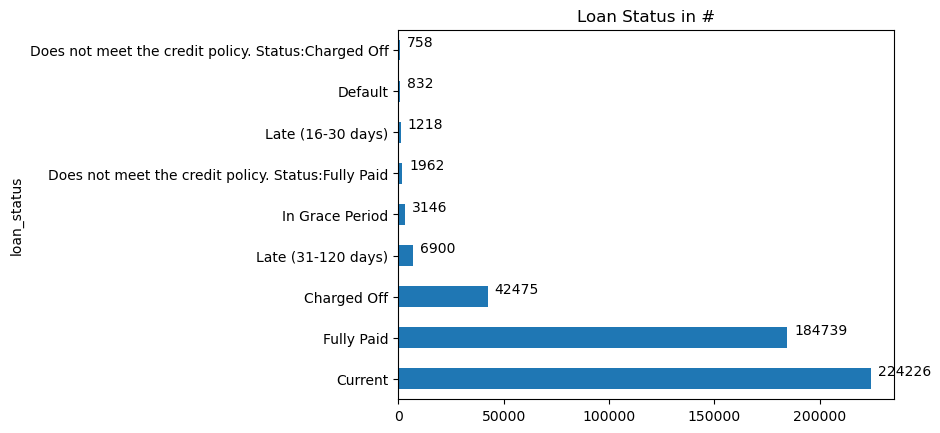

In [62]:
ax = loan_data['loan_status'].value_counts().plot(kind='barh')

for p in ax.patches:
        ax.annotate(str(p.get_width()), (p.get_x() + p.get_width(), p.get_y()), xytext=(5, 10), textcoords='offset points')

# Show the plot
plt.title("Loan Status in #")
plt.show()
    

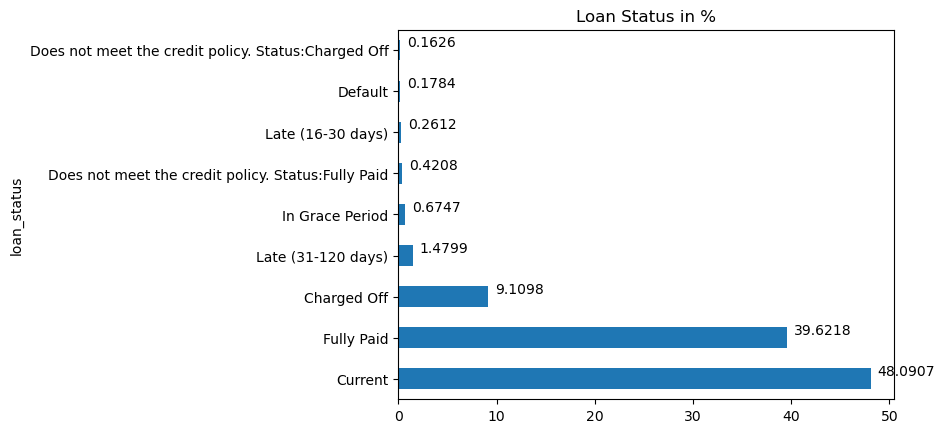

In [63]:
ax = (round(loan_data['loan_status'].value_counts() / loan_data['loan_status'].count()*100, 4)).plot(kind = 'barh')
# We divide the number of observations for each unique value of a variable by the total number of observations.
# Thus, we get the proportion of observations for each unique value of a variable.
for p in ax.patches:
        ax.annotate(str(p.get_width()), (p.get_x() + p.get_width(), p.get_y()), xytext=(5, 10), textcoords='offset points')

# Show the plot
plt.title("Loan Status in %")
plt.show()

In [64]:
# Good/ Bad Definition
loan_data['good_bad'] = np.where(loan_data['loan_status'].isin(['Charged Off', 'Default',
                                                       'Does not meet the credit policy. Status:Charged Off',
                                                       'Late (31-120 days)']), 0, 1)
# We create a new variable that has the value of '0' if a condition is met, and the value of '1' if it is not met.

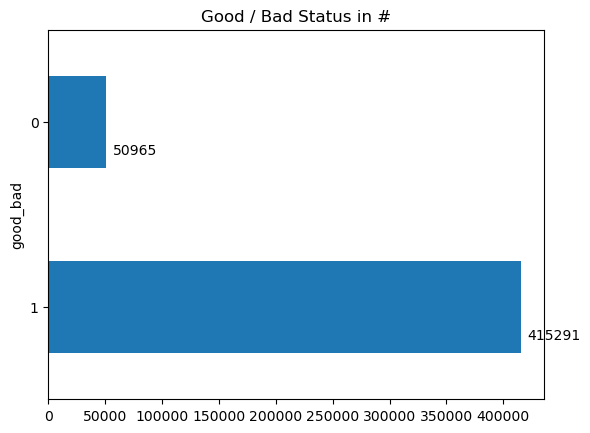

In [65]:
ax = loan_data['good_bad'].value_counts().plot(kind='barh')

for p in ax.patches:
    ax.annotate(str(p.get_width()), (p.get_x() + p.get_width(), p.get_y()), xytext=(5, 10), textcoords='offset points')
    
plt.title("Good / Bad Status in #")
plt.show()
    

We have selected `Good` as `1` and `bad` as `0`

#### Splitting Data

In [66]:
from sklearn.model_selection import train_test_split
# Imports the libraries we need.

In [67]:
X_train, X_test, y_train, y_test = train_test_split(loan_data.drop('good_bad', axis = 1), loan_data['good_bad'], test_size=0.2, random_state=42)
# We split two dataframes with inputs and targets, each into a train and test dataframe, and store them in variables.
# This time we set the size of the test dataset to be 20%.
# Respectively, the size of the train dataset becomes 80%.
# We also set a specific random state.
# This would allow us to perform the exact same split multimple times.
# This means, to assign the exact same observations to the train and test datasets.

In [68]:
print("The rows and columns of X_train :\t", X_train.shape)
print("The rows and columns of X_test :\t", X_test.shape)
print("The rows and columns of y_train:\t", y_train.shape)
print("The rows and columns of y_test: \t", y_test.shape)

The rows and columns of X_train :	 (373004, 207)
The rows and columns of X_test :	 (93252, 207)
The rows and columns of y_train:	 (373004,)
The rows and columns of y_test: 	 (93252,)


#### Data Preparation for Train set

In [79]:
#####
df_inputs_prepr = X_train
df_targets_prepr = y_train

In [80]:
df_inputs_prepr['grade'].unique()

array(['B', 'D', 'F', 'A', 'C', 'E', 'G'], dtype=object)

In [74]:
# WoE function for discrete unordered variables
def woe_discrete(df, discrete_variabe_name, good_bad_variable_df):
    df = pd.concat([df[discrete_variabe_name], good_bad_variable_df], axis = 1)
    df = pd.concat([df.groupby(df.columns.values[0], as_index = False)[df.columns.values[1]].count(),
                    df.groupby(df.columns.values[0], as_index = False)[df.columns.values[1]].mean()], axis = 1)
    df = df.iloc[:, [0, 1, 3]]
    df.columns = [df.columns.values[0], 'n_obs', 'prop_good']
    df['prop_n_obs'] = df['n_obs'] / df['n_obs'].sum()
    df['n_good'] = df['prop_good'] * df['n_obs']
    df['n_bad'] = (1 - df['prop_good']) * df['n_obs']
    df['prop_n_good'] = df['n_good'] / df['n_good'].sum()
    df['prop_n_bad'] = df['n_bad'] / df['n_bad'].sum()
    df['WoE'] = np.log(df['prop_n_good'] / df['prop_n_bad'])
    df = df.sort_values(['WoE'])
    df = df.reset_index(drop = True)
    df['diff_prop_good'] = df['prop_good'].diff().abs()
    df['diff_WoE'] = df['WoE'].diff().abs()
    df['IV'] = (df['prop_n_good'] - df['prop_n_bad']) * df['WoE']
    df['IV'] = df['IV'].sum()
    return df
# Here we combine all of the operations above in a function.
# The function takes 3 arguments: a dataframe, a string, and a dataframe. The function returns a dataframe as a result.

In [81]:
# 'grade'
df_temp = woe_discrete(df_inputs_prepr, 'grade', df_targets_prepr)
# We execute the function we defined with the necessary arguments: a dataframe, a string, and a dataframe.
# We store the result in a dataframe.
df_temp

,grade,n_obs,prop_good,prop_n_obs,n_good,n_bad,prop_n_good,prop_n_bad,WoE,diff_prop_good,diff_WoE,IV
0,G,2644,0.729955,0.007088,1930.0,714.0,0.005810,0.017490,-1.102042,NaN,NaN,0.292094
1,F,10565,0.759016,0.028324,8019.0,2546.0,0.024140,0.062367,-0.949144,0.029061,0.152898,0.292094
2,E,28753,0.804507,0.077085,23132.0,5621.0,0.069637,0.137692,-0.681727,0.045492,0.267417,0.292094
3,D,61537,0.845199,0.164977,52011.0,9526.0,0.156574,0.233349,-0.399004,0.040691,0.282723,0.292094
4,C,100106,0.885222,0.268378,88616.0,11490.0,0.266770,0.281459,-0.053599,0.040023,0.345405,0.292094
5,B,109526,0.921224,0.293632,100898.0,8628.0,0.303744,0.211351,0.362663,0.036003,0.416262,0.292094
6,A,59873,0.961619,0.160516,57575.0,2298.0,0.173324,0.056292,1.124615,0.040395,0.761952,0.292094


In [82]:
import matplotlib.pyplot as plt
import seaborn as sns
# Imports the libraries we need.
sns.set()
# We set the default style of the graphs to the seaborn style. 

In [83]:
# Below we define a function that takes 2 arguments: a dataframe and a number.
# The number parameter has a default value of 0.
# This means that if we call the function and omit the number parameter, it will be executed with it having a value of 0.
# The function displays a graph.

def plot_by_woe(df_WoE, rotation_of_x_axis_labels=0):
    x = np.array(df_WoE.iloc[:, 0].apply(str))
    # Turns the values of the column with index 0 to strings, makes an array from these strings, and passes it to variable x.
    y = df_WoE['WoE']
    # Selects a column with label 'WoE' and passes it to variable y.
    
    plt.figure(figsize=(18, 6))
    # Sets the graph size to width 18 x height 6.
    plt.plot(x, y, marker='o', linestyle='--', color='k')
    # Plots the datapoints with coordiantes variable x on the x-axis and variable y on the y-axis.
    # Sets the marker for each datapoint to a circle, the style line between the points to dashed, and the color to black.
    plt.xlabel(df_WoE.columns[0])
    # Names the x-axis with the name of the column with index 0.
    plt.ylabel('Weight of Evidence')
    # Names the y-axis 'Weight of Evidence'.
    plt.title('Weight of Evidence by ' + df_WoE.columns[0])
    # Names the grapth 'Weight of Evidence by ' the name of the column with index 0.
    
    for i, j in zip(x, y):
        plt.annotate(f'{j:.2f}', (i, j), textcoords='offset points', xytext=(0, 10), ha='center')
    # put the values of weight of evidence against each data coordinates
    
    plt.xticks(rotation=rotation_of_x_axis_labels)
    # Rotates the labels of the x-axis a predefined number of degrees.
    plt.show()

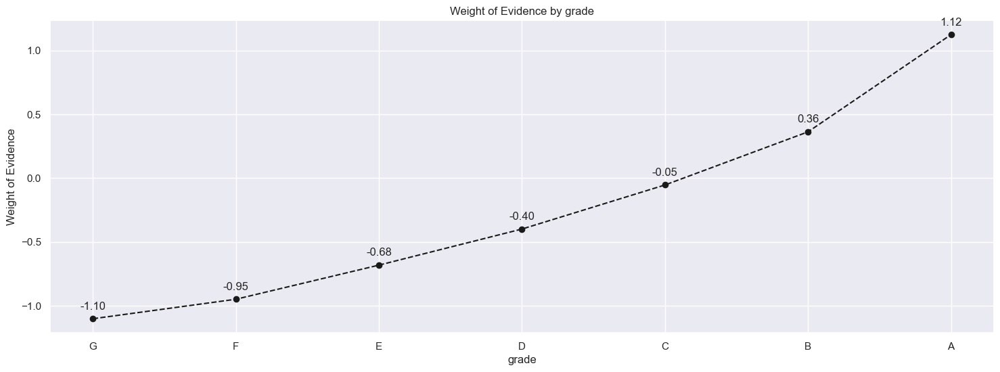

In [84]:
plot_by_woe(df_temp)
# We execute the function we defined with the necessary arguments: a dataframe.
# We omit the number argument, which means the function will use its default value, 0.

In [98]:
# Sort the DataFrame by the 'WoE' column in ascending order
df_sorted = df_temp.sort_values(by='WoE')

# Select the first row (minimum WoE)
min_WoE_row = df_sorted.iloc[0]

# Get the 'grade' value with the minimum WoE
min_WoE_grade = min_WoE_row['grade']

print("Grade with Minimum WoE:", "'grade:"+min_WoE_grade+"'")

Grade with Minimum WoE: 'grade:G'


In [102]:
# 'home_ownership'
df_temp = woe_discrete(df_inputs_prepr, 'home_ownership', df_targets_prepr)
# We calculate weight of evidence.
df_temp

,home_ownership,n_obs,prop_good,prop_n_obs,n_good,n_bad,prop_n_good,prop_n_bad,WoE,diff_prop_good,diff_WoE,IV
0,OTHER,137,0.788321,0.000367,108.0,29.0,0.000325,0.000710,-0.781599,NaN,NaN,0.022167
1,NONE,36,0.861111,0.000097,31.0,5.0,0.000093,0.000122,-0.271885,0.072790,0.509714,0.022167
2,RENT,150709,0.873644,0.404041,131666.0,19043.0,0.396368,0.466477,-0.162866,0.012533,0.109020,0.022167
3,OWN,33338,0.890455,0.089377,29686.0,3652.0,0.089367,0.089459,-0.001034,0.016811,0.161832,0.022167
4,MORTGAGE,188784,0.904155,0.506118,170690.0,18094.0,0.513846,0.443231,0.147834,0.013700,0.148868,0.022167


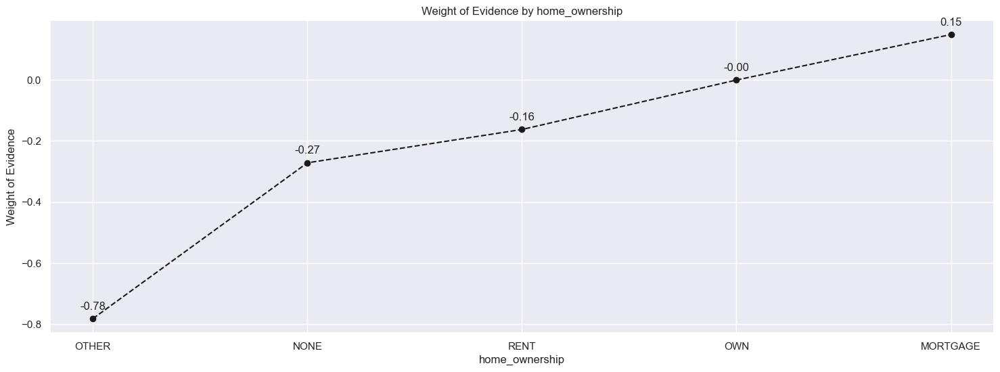

In [103]:
plot_by_woe(df_temp)
# We plot the weight of evidence values.

In [104]:
# Sort the DataFrame by the 'WoE' column in ascending order
df_sorted = df_temp.sort_values(by='WoE')

# Select the first row (minimum WoE)
min_WoE_row = df_sorted.iloc[0]

# Get the 'grade' value with the minimum WoE
min_WoE_grade = min_WoE_row['home_ownership']

print("Grade with Minimum WoE:", "'home_ownership:"+min_WoE_grade+"'")

Grade with Minimum WoE: 'home_ownership:OTHER'


In [105]:
# There are many categories with very few observations and many categories with very different "good" %.
# Therefore, we create a new discrete variable where we combine some of the categories.
# 'OTHERS' and 'NONE' are riskiest but are very few. 'RENT' is the next riskiest.
# 'ANY' are least risky but are too few. Conceptually, they belong to the same category. Also, their inclusion would not change anything.
# We combine them in one category, 'RENT_OTHER_NONE_ANY'.
# We end up with 3 categories: 'RENT_OTHER_NONE_ANY', 'OWN', 'MORTGAGE'.

df_inputs_prepr['home_ownership:RENT_OTHER_NONE_ANY'] = sum([df_inputs_prepr['home_ownership:RENT'], df_inputs_prepr['home_ownership:OTHER'],
                                                      df_inputs_prepr['home_ownership:NONE'],df_inputs_prepr['home_ownership:ANY']])
# 'RENT_OTHER_NONE_ANY' will be the reference category.

# Alternatively:
#loan_data.loc['home_ownership' in ['RENT', 'OTHER', 'NONE', 'ANY'], 'home_ownership:RENT_OTHER_NONE_ANY'] = 1
#loan_data.loc['home_ownership' not in ['RENT', 'OTHER', 'NONE', 'ANY'], 'home_ownership:RENT_OTHER_NONE_ANY'] = 0
#loan_data.loc['loan_status' not in ['OWN'], 'home_ownership:OWN'] = 1
#loan_data.loc['loan_status' not in ['OWN'], 'home_ownership:OWN'] = 0
#loan_data.loc['loan_status' not in ['MORTGAGE'], 'home_ownership:MORTGAGE'] = 1
#loan_data.loc['loan_status' not in ['MORTGAGE'], 'home_ownership:MORTGAGE'] = 0

In [106]:
# 'addr_state'
df_inputs_prepr['addr_state'].unique()


array(['TX', 'VA', 'AZ', 'NJ', 'IL', 'RI', 'NY', 'PA', 'OH', 'CA', 'WI',
       'AR', 'MN', 'UT', 'LA', 'OK', 'FL', 'HI', 'AL', 'IN', 'NC', 'MA',
       'KY', 'KS', 'NV', 'MI', 'OR', 'SC', 'CT', 'TN', 'GA', 'MO', 'VT',
       'WA', 'WV', 'CO', 'MD', 'AK', 'NM', 'MT', 'DC', 'NH', 'MS', 'DE',
       'SD', 'WY', 'IA', 'ID', 'NE', 'ME'], dtype=object)

In [107]:
print("The total unique states are:\t", len(df_inputs_prepr['addr_state'].unique()))

The total unique states are:	 50


In [108]:
df_temp = woe_discrete(df_inputs_prepr, 'addr_state', df_targets_prepr)
# We calculate weight of evidence.
df_temp

,addr_state,n_obs,prop_good,prop_n_obs,n_good,n_bad,prop_n_good,prop_n_bad,WoE,diff_prop_good,diff_WoE,IV
0,NE,12,0.500000,0.000032,6.0,6.0,0.000018,0.000147,-2.096434,NaN,NaN,inf
1,IA,13,0.769231,0.000035,10.0,3.0,0.000030,0.000073,-0.892462,0.269231,1.203973,inf
2,NV,5203,0.862387,0.013949,4487.0,716.0,0.013508,0.017539,-0.261175,0.093156,0.631287,inf
3,HI,1987,0.869653,0.005327,1728.0,259.0,0.005202,0.006344,-0.198542,0.007266,0.062632,inf
4,FL,25358,0.874872,0.067983,22185.0,3173.0,0.066786,0.077726,-0.151695,0.005219,0.046847,inf
5,AL,4747,0.875922,0.012726,4158.0,589.0,0.012517,0.014428,-0.142071,0.001050,0.009624,inf
6,NM,2071,0.879285,0.005552,1821.0,250.0,0.005482,0.006124,-0.110754,0.003364,0.031317,inf
7,LA,4355,0.882893,0.011675,3845.0,510.0,0.011575,0.012493,-0.076316,0.003608,0.034438,inf
8,NY,32111,0.883031,0.086088,28355.0,3756.0,0.085360,0.092007,-0.074986,0.000138,0.001331,inf
9,OK,3261,0.884085,0.008743,2883.0,378.0,0.008679,0.009259,-0.064742,0.001054,0.010244,inf


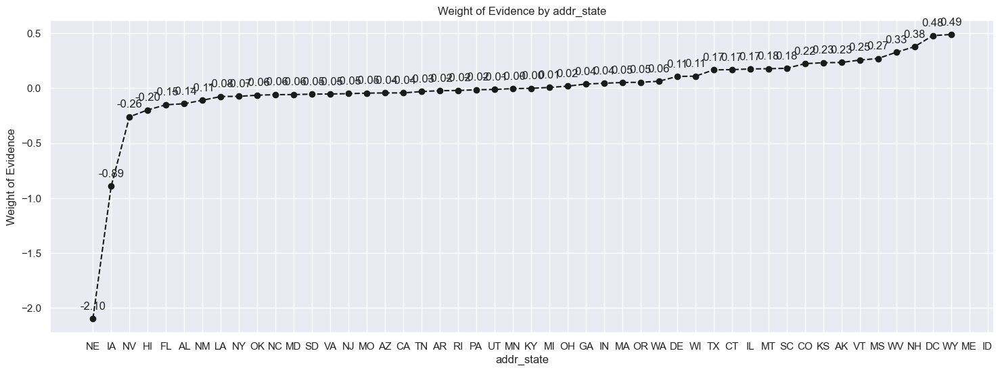

In [109]:
plot_by_woe(df_temp)
# We plot the weight of evidence values.

In [110]:
if ['addr_state:ND'] in df_inputs_prepr.columns.values:
    pass
else:
    df_inputs_prepr['addr_state:ND'] = 0

In [111]:
df_temp.iloc[2: -2, : ]

,addr_state,n_obs,prop_good,prop_n_obs,n_good,n_bad,prop_n_good,prop_n_bad,WoE,diff_prop_good,diff_WoE,IV
2,NV,5203,0.862387,0.013949,4487.0,716.0,0.013508,0.017539,-0.261175,0.093156,0.631287,inf
3,HI,1987,0.869653,0.005327,1728.0,259.0,0.005202,0.006344,-0.198542,0.007266,0.062632,inf
4,FL,25358,0.874872,0.067983,22185.0,3173.0,0.066786,0.077726,-0.151695,0.005219,0.046847,inf
5,AL,4747,0.875922,0.012726,4158.0,589.0,0.012517,0.014428,-0.142071,0.001050,0.009624,inf
6,NM,2071,0.879285,0.005552,1821.0,250.0,0.005482,0.006124,-0.110754,0.003364,0.031317,inf
7,LA,4355,0.882893,0.011675,3845.0,510.0,0.011575,0.012493,-0.076316,0.003608,0.034438,inf
8,NY,32111,0.883031,0.086088,28355.0,3756.0,0.085360,0.092007,-0.074986,0.000138,0.001331,inf
9,OK,3261,0.884085,0.008743,2883.0,378.0,0.008679,0.009259,-0.064742,0.001054,0.010244,inf
10,NC,10184,0.884623,0.027303,9009.0,1175.0,0.027121,0.028783,-0.059478,0.000538,0.005263,inf
11,MD,8784,0.884677,0.023549,7771.0,1013.0,0.023394,0.024814,-0.058952,0.000054,0.000527,inf


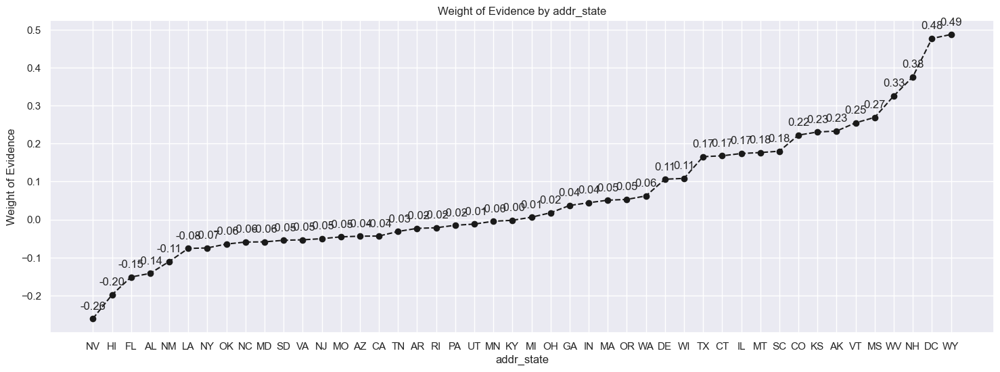

In [112]:
plot_by_woe(df_temp.iloc[2: -2, : ])
# We plot the weight of evidence values.

In [113]:
df_temp.iloc[6: -6, : ]

,addr_state,n_obs,prop_good,prop_n_obs,n_good,n_bad,prop_n_good,prop_n_bad,WoE,diff_prop_good,diff_WoE,IV
6,NM,2071,0.879285,0.005552,1821.0,250.0,0.005482,0.006124,-0.110754,0.003364,0.031317,inf
7,LA,4355,0.882893,0.011675,3845.0,510.0,0.011575,0.012493,-0.076316,0.003608,0.034438,inf
8,NY,32111,0.883031,0.086088,28355.0,3756.0,0.085360,0.092007,-0.074986,0.000138,0.001331,inf
9,OK,3261,0.884085,0.008743,2883.0,378.0,0.008679,0.009259,-0.064742,0.001054,0.010244,inf
10,NC,10184,0.884623,0.027303,9009.0,1175.0,0.027121,0.028783,-0.059478,0.000538,0.005263,inf
11,MD,8784,0.884677,0.023549,7771.0,1013.0,0.023394,0.024814,-0.058952,0.000054,0.000527,inf
12,SD,792,0.885101,0.002123,701.0,91.0,0.002110,0.002229,-0.054786,0.000424,0.004166,inf
13,VA,11440,0.885227,0.030670,10127.0,1313.0,0.030486,0.032163,-0.053544,0.000126,0.001242,inf
14,NJ,14309,0.885527,0.038362,12671.0,1638.0,0.038145,0.040124,-0.050594,0.000299,0.002949,inf
15,MO,6036,0.886017,0.016182,5348.0,688.0,0.016100,0.016853,-0.045745,0.000491,0.004849,inf


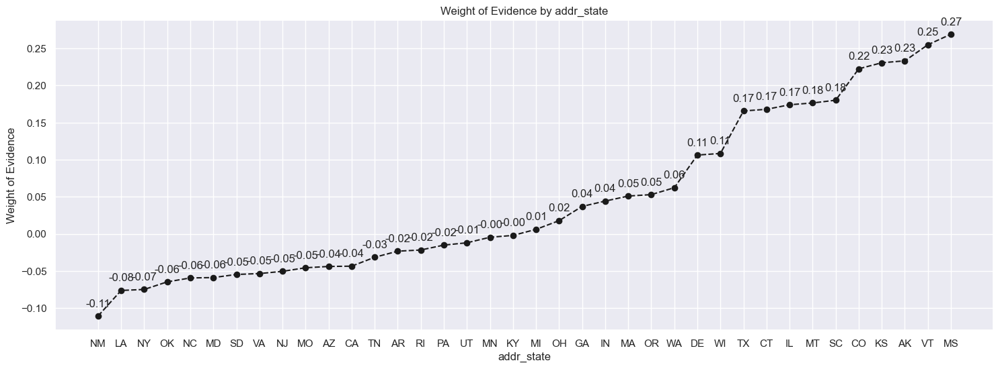

In [114]:
plot_by_woe(df_temp.iloc[6: -6, : ])
# We plot the weight of evidence values.

In [115]:
# We create the following categories:
# 'ND' 'NE' 'IA' NV' 'FL' 'HI' 'AL'
# 'NM' 'VA'
# 'NY'
# 'OK' 'TN' 'MO' 'LA' 'MD' 'NC'
# 'CA'
# 'UT' 'KY' 'AZ' 'NJ'
# 'AR' 'MI' 'PA' 'OH' 'MN'
# 'RI' 'MA' 'DE' 'SD' 'IN'
# 'GA' 'WA' 'OR'
# 'WI' 'MT'
# 'TX'
# 'IL' 'CT'
# 'KS' 'SC' 'CO' 'VT' 'AK' 'MS'
# 'WV' 'NH' 'WY' 'DC' 'ME' 'ID'

# 'IA_NV_HI_ID_AL_FL' will be the reference category.

df_inputs_prepr['addr_state:ND_NE_IA_NV_FL_HI_AL'] = sum([df_inputs_prepr['addr_state:ND'], df_inputs_prepr['addr_state:NE'],
                                              df_inputs_prepr['addr_state:IA'], df_inputs_prepr['addr_state:NV'],
                                              df_inputs_prepr['addr_state:FL'], df_inputs_prepr['addr_state:HI'],
                                                          df_inputs_prepr['addr_state:AL']])

df_inputs_prepr['addr_state:NM_VA'] = sum([df_inputs_prepr['addr_state:NM'], df_inputs_prepr['addr_state:VA']])

df_inputs_prepr['addr_state:OK_TN_MO_LA_MD_NC'] = sum([df_inputs_prepr['addr_state:OK'], df_inputs_prepr['addr_state:TN'],
                                              df_inputs_prepr['addr_state:MO'], df_inputs_prepr['addr_state:LA'],
                                              df_inputs_prepr['addr_state:MD'], df_inputs_prepr['addr_state:NC']])

df_inputs_prepr['addr_state:UT_KY_AZ_NJ'] = sum([df_inputs_prepr['addr_state:UT'], df_inputs_prepr['addr_state:KY'],
                                              df_inputs_prepr['addr_state:AZ'], df_inputs_prepr['addr_state:NJ']])

df_inputs_prepr['addr_state:AR_MI_PA_OH_MN'] = sum([df_inputs_prepr['addr_state:AR'], df_inputs_prepr['addr_state:MI'],
                                              df_inputs_prepr['addr_state:PA'], df_inputs_prepr['addr_state:OH'],
                                              df_inputs_prepr['addr_state:MN']])

df_inputs_prepr['addr_state:RI_MA_DE_SD_IN'] = sum([df_inputs_prepr['addr_state:RI'], df_inputs_prepr['addr_state:MA'],
                                              df_inputs_prepr['addr_state:DE'], df_inputs_prepr['addr_state:SD'],
                                              df_inputs_prepr['addr_state:IN']])

df_inputs_prepr['addr_state:GA_WA_OR'] = sum([df_inputs_prepr['addr_state:GA'], df_inputs_prepr['addr_state:WA'],
                                              df_inputs_prepr['addr_state:OR']])

df_inputs_prepr['addr_state:WI_MT'] = sum([df_inputs_prepr['addr_state:WI'], df_inputs_prepr['addr_state:MT']])

df_inputs_prepr['addr_state:IL_CT'] = sum([df_inputs_prepr['addr_state:IL'], df_inputs_prepr['addr_state:CT']])

df_inputs_prepr['addr_state:KS_SC_CO_VT_AK_MS'] = sum([df_inputs_prepr['addr_state:KS'], df_inputs_prepr['addr_state:SC'],
                                              df_inputs_prepr['addr_state:CO'], df_inputs_prepr['addr_state:VT'],
                                              df_inputs_prepr['addr_state:AK'], df_inputs_prepr['addr_state:MS']])

df_inputs_prepr['addr_state:WV_NH_WY_DC_ME_ID'] = sum([df_inputs_prepr['addr_state:WV'], df_inputs_prepr['addr_state:NH'],
                                              df_inputs_prepr['addr_state:WY'], df_inputs_prepr['addr_state:DC'],
                                              df_inputs_prepr['addr_state:ME'], df_inputs_prepr['addr_state:ID']])

In [116]:
# 'verification_status'
df_temp = woe_discrete(df_inputs_prepr, 'verification_status', df_targets_prepr)
# We calculate weight of evidence.
df_temp

,verification_status,n_obs,prop_good,prop_n_obs,n_good,n_bad,prop_n_good,prop_n_bad,WoE,diff_prop_good,diff_WoE,IV
0,Verified,134479,0.872605,0.360530,117347.0,17132.0,0.353262,0.419665,-0.172247,NaN,NaN,0.020585
1,Source Verified,119926,0.895661,0.321514,107413.0,12513.0,0.323357,0.306518,0.053479,0.023056,0.225726,0.020585
2,Not Verified,118599,0.905750,0.317956,107421.0,11178.0,0.323381,0.273816,0.166374,0.010089,0.112895,0.020585


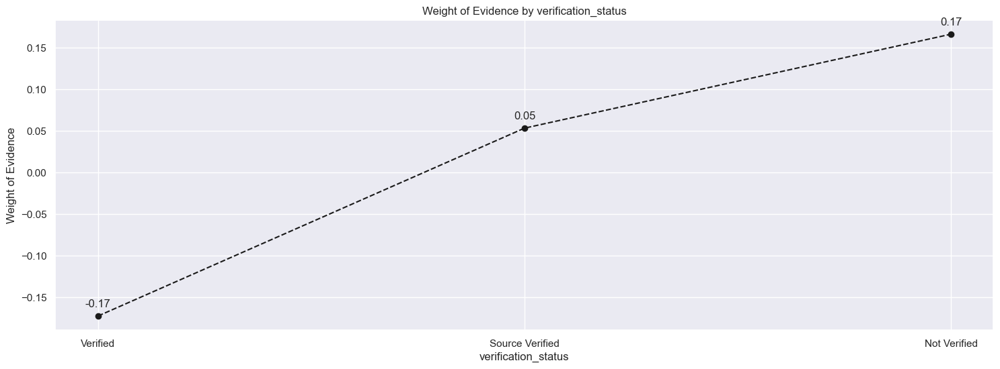

In [117]:
plot_by_woe(df_temp)
# We plot the weight of evidence values.

In [118]:
# 'purpose'
df_temp = woe_discrete(df_inputs_prepr, 'purpose', df_targets_prepr)
# We calculate weight of evidence.
df_temp

,purpose,n_obs,prop_good,prop_n_obs,n_good,n_bad,prop_n_good,prop_n_bad,WoE,diff_prop_good,diff_WoE,IV
0,small_business,5617,0.783692,0.015059,4402.0,1215.0,0.013252,0.029763,-0.809119,NaN,NaN,0.037671
1,educational,332,0.804217,0.000890,267.0,65.0,0.000804,0.001592,-0.683573,0.020525,0.125546,0.037671
2,moving,2382,0.848866,0.006386,2022.0,360.0,0.006087,0.008819,-0.370696,0.044650,0.312877,0.037671
3,renewable_energy,288,0.850694,0.000772,245.0,43.0,0.000738,0.001053,-0.356376,0.001828,0.014320,0.037671
4,house,1795,0.859610,0.004812,1543.0,252.0,0.004645,0.006173,-0.284380,0.008916,0.071997,0.037671
5,other,18979,0.861584,0.050881,16352.0,2627.0,0.049226,0.064351,-0.267927,0.001974,0.016453,0.037671
6,medical,3679,0.865181,0.009863,3183.0,496.0,0.009582,0.012150,-0.237431,0.003597,0.030496,0.037671
7,wedding,1889,0.878242,0.005064,1659.0,230.0,0.004994,0.005634,-0.120543,0.013062,0.116887,0.037671
8,debt_consolidation,219203,0.886256,0.587669,194270.0,24933.0,0.584832,0.610759,-0.043378,0.008014,0.077166,0.037671
9,vacation,1987,0.886764,0.005327,1762.0,225.0,0.005304,0.005512,-0.038330,0.000508,0.005048,0.037671


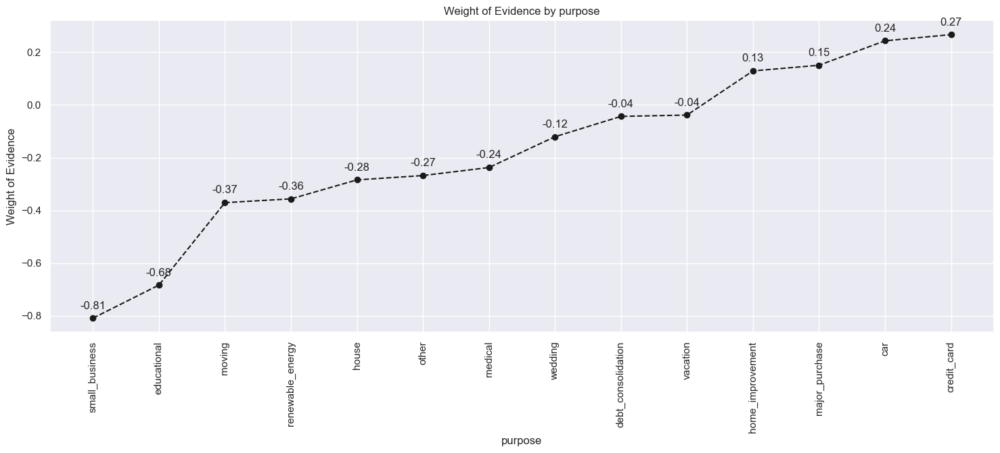

In [120]:
plot_by_woe(df_temp, 90)
# We plot the weight of evidence values.

In [121]:
# We combine 'educational', 'small_business', 'wedding', 'renewable_energy', 'moving', 'house' in one category: 'educ__sm_b__wedd__ren_en__mov__house'.
# We combine 'other', 'medical', 'vacation' in one category: 'oth__med__vacation'.
# We combine 'major_purchase', 'car', 'home_improvement' in one category: 'major_purch__car__home_impr'.
# We leave 'debt_consolidtion' in a separate category.
# We leave 'credit_card' in a separate category.
# 'educ__sm_b__wedd__ren_en__mov__house' will be the reference category.
df_inputs_prepr['purpose:educ__sm_b__wedd__ren_en__mov__house'] = sum([df_inputs_prepr['purpose:educational'], df_inputs_prepr['purpose:small_business'],
                                                                 df_inputs_prepr['purpose:wedding'], df_inputs_prepr['purpose:renewable_energy'],
                                                                 df_inputs_prepr['purpose:moving'], df_inputs_prepr['purpose:house']])
df_inputs_prepr['purpose:oth__med__vacation'] = sum([df_inputs_prepr['purpose:other'], df_inputs_prepr['purpose:medical'],
                                             df_inputs_prepr['purpose:vacation']])
df_inputs_prepr['purpose:major_purch__car__home_impr'] = sum([df_inputs_prepr['purpose:major_purchase'], df_inputs_prepr['purpose:car'],
                                                        df_inputs_prepr['purpose:home_improvement']])

In [122]:
# 'initial_list_status'
df_temp = woe_discrete(df_inputs_prepr, 'initial_list_status', df_targets_prepr)
df_temp

,initial_list_status,n_obs,prop_good,prop_n_obs,n_good,n_bad,prop_n_good,prop_n_bad,WoE,diff_prop_good,diff_WoE,IV
0,f,242536,0.879577,0.650224,213329.0,29207.0,0.642207,0.715455,-0.108007,NaN,NaN,0.024689
1,w,130468,0.910967,0.349776,118852.0,11616.0,0.357793,0.284545,0.229061,0.03139,0.337068,0.024689


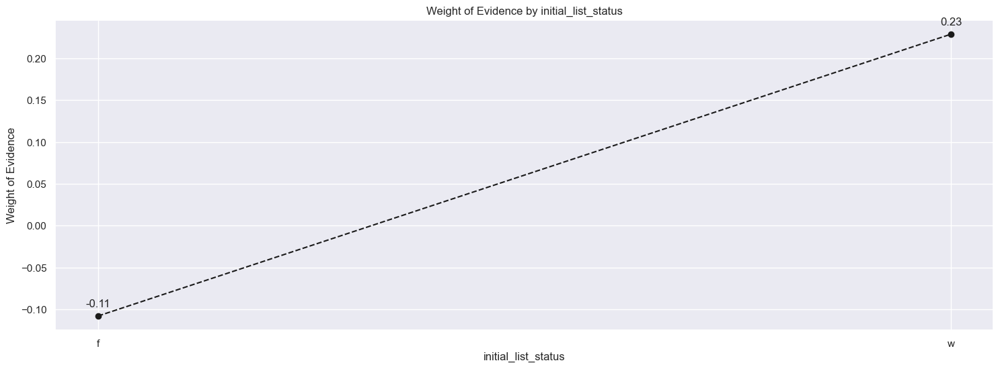

In [123]:
plot_by_woe(df_temp)
# We plot the weight of evidence values.

#### Preprocessing Continuous Variables: Automating Calculations and Visualizing Results

In [124]:
# WoE function for ordered discrete and continuous variables
def woe_ordered_continuous(df, OC_variabe_name, good_bad_variable_df):
    df = pd.concat([df[OC_variabe_name], good_bad_variable_df], axis = 1)
    df = pd.concat([df.groupby(df.columns.values[0], as_index = False)[df.columns.values[1]].count(),
                    df.groupby(df.columns.values[0], as_index = False)[df.columns.values[1]].mean()], axis = 1)
    df = df.iloc[:, [0, 1, 3]]
    df.columns = [df.columns.values[0], 'n_obs', 'prop_good']
    df['prop_n_obs'] = df['n_obs'] / df['n_obs'].sum()
    df['n_good'] = df['prop_good'] * df['n_obs']
    df['n_bad'] = (1 - df['prop_good']) * df['n_obs']
    df['prop_n_good'] = df['n_good'] / df['n_good'].sum()
    df['prop_n_bad'] = df['n_bad'] / df['n_bad'].sum()
    df['WoE'] = np.log(df['prop_n_good'] / df['prop_n_bad'])
    df['diff_prop_good'] = df['prop_good'].diff().abs()
    df['diff_WoE'] = df['WoE'].diff().abs()
    df['IV'] = (df['prop_n_good'] - df['prop_n_bad']) * df['WoE']
    df['IV'] = df['IV'].sum()
    return df
# Here we define a function similar to the one above, ...
# ... with one slight difference: we order the results by the values of a different column.
# The function takes 3 arguments: a dataframe, a string, and a dataframe. The function returns a dataframe as a result.

#### Preprocessing Continuous Variables: Creating Dummy Variables

In [125]:
# term
df_inputs_prepr['term_int'].unique()
# There are only two unique values, 36 and 60.

array([36, 60], dtype=int64)

In [126]:
df_temp = woe_ordered_continuous(df_inputs_prepr, 'term_int', df_targets_prepr)
# We calculate weight of evidence.
df_temp

,term_int,n_obs,prop_good,prop_n_obs,n_good,n_bad,prop_n_good,prop_n_bad,WoE,diff_prop_good,diff_WoE,IV
0,36,270312,0.90289,0.724689,244062.0,26250.0,0.734726,0.64302,0.133322,NaN,NaN,0.039455
1,60,102692,0.85809,0.275311,88119.0,14573.0,0.265274,0.35698,-0.296917,0.0448,0.430239,0.039455


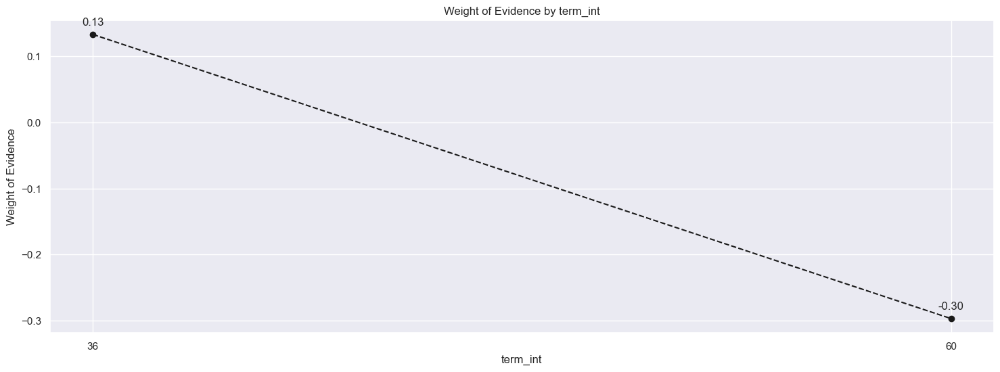

In [127]:
plot_by_woe(df_temp)
# We plot the weight of evidence values.

In [128]:
# Leave as is.
# '60' will be the reference category.
df_inputs_prepr['term:36'] = np.where((df_inputs_prepr['term_int'] == 36), 1, 0)
df_inputs_prepr['term:60'] = np.where((df_inputs_prepr['term_int'] == 60), 1, 0)

In [129]:
# emp_length_int
df_inputs_prepr['emp_length_int'].unique()
# Has only 11 levels: from 0 to 10. Hence, we turn it into a factor with 11 levels.

array([10,  2,  4,  0,  3,  8,  7,  6,  9,  5,  1], dtype=int64)

In [130]:
df_temp = woe_ordered_continuous(df_inputs_prepr, 'emp_length_int', df_targets_prepr)
# We calculate weight of evidence.
df_temp

,emp_length_int,n_obs,prop_good,prop_n_obs,n_good,n_bad,prop_n_good,prop_n_bad,WoE,diff_prop_good,diff_WoE,IV
0,0,45861,0.875210,0.122950,40138.0,5723.0,0.120832,0.140191,-0.148604,NaN,NaN,0.006846
1,1,23656,0.887217,0.063420,20988.0,2668.0,0.063182,0.065355,-0.033813,0.012007,0.114791,0.006846
2,2,33187,0.890409,0.088972,29550.0,3637.0,0.088958,0.089092,-0.001510,0.003192,0.032303,0.006846
3,3,29273,0.891299,0.078479,26091.0,3182.0,0.078545,0.077946,0.007646,0.000890,0.009156,0.006846
4,4,22522,0.890285,0.060380,20051.0,2471.0,0.060362,0.060530,-0.002778,0.001014,0.010424,0.006846
5,5,24589,0.884867,0.065922,21758.0,2831.0,0.065500,0.069348,-0.057083,0.005418,0.054305,0.006846
6,6,20980,0.884128,0.056246,18549.0,2431.0,0.055840,0.059550,-0.064321,0.000739,0.007238,0.006846
7,7,20861,0.888212,0.055927,18529.0,2332.0,0.055780,0.057125,-0.023824,0.004085,0.040498,0.006846
8,8,17978,0.890422,0.048198,16008.0,1970.0,0.048191,0.048257,-0.001379,0.002209,0.022444,0.006846
9,9,14356,0.886041,0.038488,12720.0,1636.0,0.038292,0.040075,-0.045513,0.004381,0.044134,0.006846


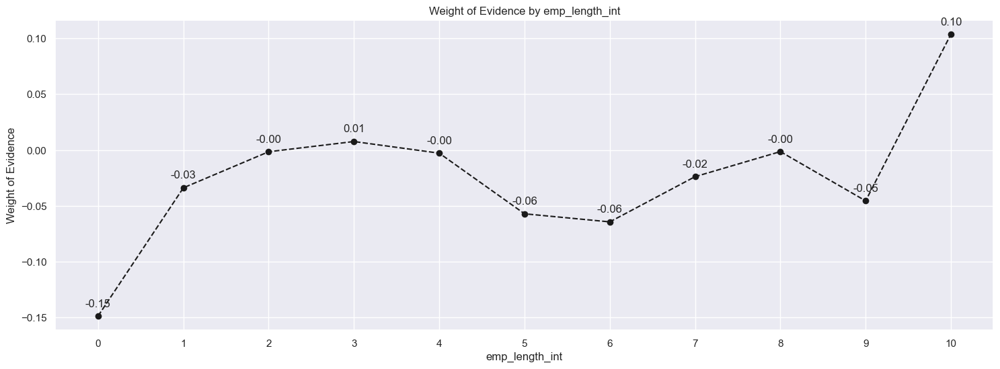

In [131]:
plot_by_woe(df_temp)
# We plot the weight of evidence values.

In [132]:
# We create the following categories: '0', '1', '2 - 4', '5 - 6', '7 - 9', '10'
# '0' will be the reference category
df_inputs_prepr['emp_length:0'] = np.where(df_inputs_prepr['emp_length_int'].isin([0]), 1, 0)
df_inputs_prepr['emp_length:1'] = np.where(df_inputs_prepr['emp_length_int'].isin([1]), 1, 0)
df_inputs_prepr['emp_length:2-4'] = np.where(df_inputs_prepr['emp_length_int'].isin(range(2, 5)), 1, 0)
df_inputs_prepr['emp_length:5-6'] = np.where(df_inputs_prepr['emp_length_int'].isin(range(5, 7)), 1, 0)
df_inputs_prepr['emp_length:7-9'] = np.where(df_inputs_prepr['emp_length_int'].isin(range(7, 10)), 1, 0)
df_inputs_prepr['emp_length:10'] = np.where(df_inputs_prepr['emp_length_int'].isin([10]), 1, 0)

In [133]:
df_inputs_prepr['mths_since_issue_d'].unique()

array([ 45,  44,  51,  53, 113,  50,  63,  71,  49,  48,  41,  43,  52,
        47,  38,  40,  87,  76,  37,  62,  65,  55,  42,  58,  46,  89,
        64,  69,  79,  39,  36,  91,  73,  56,  61,  74,  54,  88,  81,
        82, 103,  83,  72,  59, 101,  68,  70,  57,  85,  60,  92,  77,
        84,  86,  90, 116,  93,  67,  95,  78,  75,  66,  80,  96,  94,
        98, 104, 125, 105, 118, 110, 119, 114,  97, 102, 106, 100, 122,
       121, 108, 117, 120, 124,  99, 115, 112, 109, 123, 107, 111, 126],
      dtype=int64)

In [134]:
df_inputs_prepr['mths_since_issue_d_factor'] = pd.cut(df_inputs_prepr['mths_since_issue_d'], 50)
# Here we do fine-classing: using the 'cut' method, we split the variable into 50 categories by its values.

In [135]:
df_inputs_prepr['mths_since_issue_d_factor']

431128      (43.2, 45.0]
413015      (43.2, 45.0]
90236       (50.4, 52.2]
122060      (52.2, 54.0]
41491     (111.6, 113.4]
               ...      
259207     (35.91, 37.8]
365867      (41.4, 43.2]
131961      (52.2, 54.0]
146896      (55.8, 57.6]
121987      (52.2, 54.0]
Name: mths_since_issue_d_factor, Length: 373004, dtype: category
Categories (50, interval[float64, right]): [(35.91, 37.8] < (37.8, 39.6] < (39.6, 41.4] < (41.4, 43.2] ... (118.8, 120.6] < (120.6, 122.4] < (122.4, 124.2] < (124.2, 126.0]]

In [136]:
# mths_since_issue_d
df_temp = woe_ordered_continuous(df_inputs_prepr, 'mths_since_issue_d_factor', df_targets_prepr)
# We calculate weight of evidence.
df_temp

C:\Users\dcgzb\AppData\Local\Temp\ipykernel_10772\1881610760.py:4: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  df = pd.concat([df.groupby(df.columns.values[0], as_index = False)[df.columns.values[1]].count(),
C:\Users\dcgzb\AppData\Local\Temp\ipykernel_10772\1881610760.py:5: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  df.groupby(df.columns.values[0], as_index = False)[df.columns.values[1]].mean()], axis = 1)


,mths_since_issue_d_factor,n_obs,prop_good,prop_n_obs,n_good,n_bad,prop_n_good,prop_n_bad,WoE,diff_prop_good,diff_WoE,IV
0,"(35.91, 37.8]",28296,0.943738,0.075860,26704.0,1592.0,0.080390,0.038998,0.723388,NaN,NaN,0.117636
1,"(37.8, 39.6]",39562,0.928492,0.106063,36733.0,2829.0,0.110581,0.069299,0.467318,0.015246,0.256070,0.117636
2,"(39.6, 41.4]",38495,0.918873,0.103203,35372.0,3123.0,0.106484,0.076501,0.330692,0.009619,0.136626,0.117636
3,"(41.4, 43.2]",28946,0.908727,0.077602,26304.0,2642.0,0.079186,0.064718,0.201750,0.010146,0.128942,0.117636
4,"(43.2, 45.0]",28419,0.901685,0.076190,25625.0,2794.0,0.077142,0.068442,0.119660,0.007041,0.082091,0.117636
5,"(45.0, 46.8]",12161,0.897459,0.032603,10914.0,1247.0,0.032856,0.030547,0.072871,0.004226,0.046788,0.117636
6,"(46.8, 48.6]",24509,0.895712,0.065707,21953.0,2556.0,0.066087,0.062612,0.054026,0.001747,0.018845,0.117636
7,"(48.6, 50.4]",22960,0.888545,0.061554,20401.0,2559.0,0.061415,0.062685,-0.020467,0.007166,0.074493,0.117636
8,"(50.4, 52.2]",20595,0.879777,0.055214,18119.0,2476.0,0.054546,0.060652,-0.106118,0.008769,0.085651,0.117636
9,"(52.2, 54.0]",18298,0.868674,0.049056,15895.0,2403.0,0.047850,0.058864,-0.207148,0.011102,0.101030,0.117636


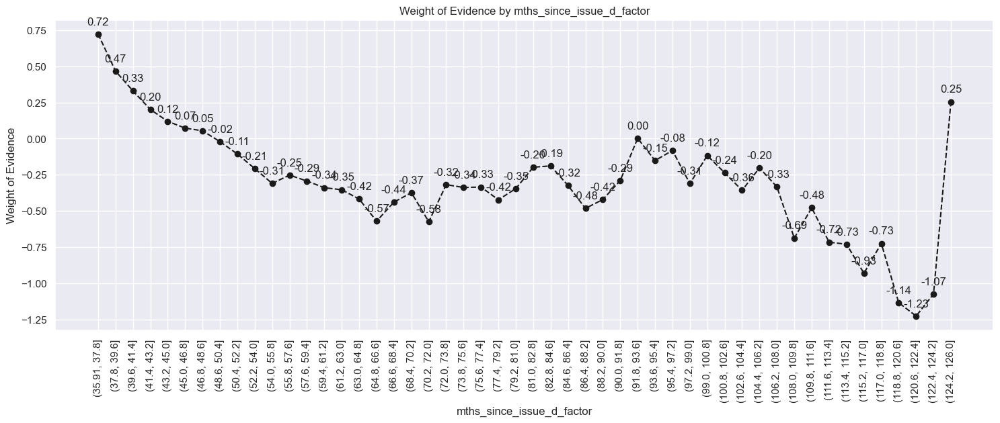

In [137]:
plot_by_woe(df_temp, 90)
# We plot the weight of evidence values.
# We have to rotate the labels because we cannot read them otherwise.

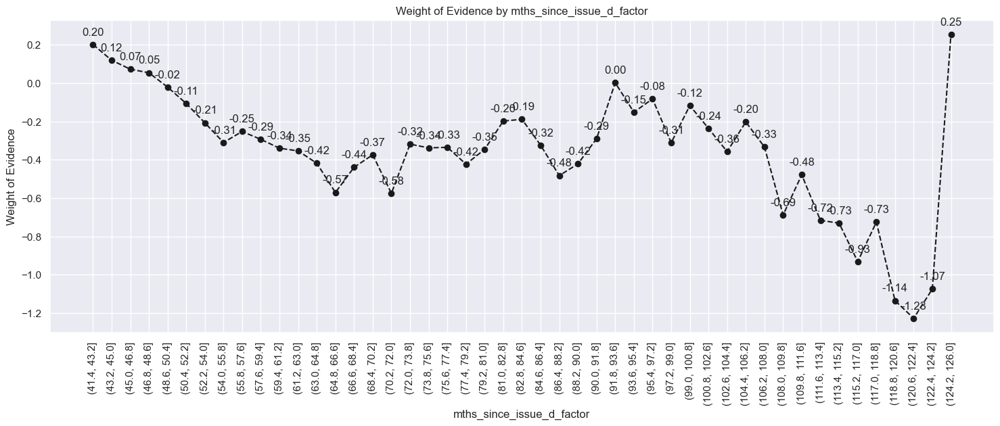

In [138]:
plot_by_woe(df_temp.iloc[3: , : ], 90)
# We plot the weight of evidence values.

In [141]:
# We create the following categories:
# < 38, 38 - 39, 40 - 41, 42 - 48, 49 - 52, 53 - 64, 65 - 84, > 84.
df_inputs_prepr['mths_since_issue_d:<38'] = np.where(df_inputs_prepr['mths_since_issue_d'].isin(range(38)), 1, 0)
df_inputs_prepr['mths_since_issue_d:38-39'] = np.where(df_inputs_prepr['mths_since_issue_d'].isin(range(38, 40)), 1, 0)
df_inputs_prepr['mths_since_issue_d:40-41'] = np.where(df_inputs_prepr['mths_since_issue_d'].isin(range(40, 42)), 1, 0)
df_inputs_prepr['mths_since_issue_d:42-48'] = np.where(df_inputs_prepr['mths_since_issue_d'].isin(range(42, 49)), 1, 0)
df_inputs_prepr['mths_since_issue_d:49-52'] = np.where(df_inputs_prepr['mths_since_issue_d'].isin(range(49, 53)), 1, 0)
df_inputs_prepr['mths_since_issue_d:53-64'] = np.where(df_inputs_prepr['mths_since_issue_d'].isin(range(53, 65)), 1, 0)
df_inputs_prepr['mths_since_issue_d:65-84'] = np.where(df_inputs_prepr['mths_since_issue_d'].isin(range(65, 85)), 1, 0)
df_inputs_prepr['mths_since_issue_d:>84'] = np.where(df_inputs_prepr['mths_since_issue_d'].isin(range(85, int(df_inputs_prepr['mths_since_issue_d'].max()))), 1, 0)

In [140]:
# int_rate
df_inputs_prepr['int_rate_factor'] = pd.cut(df_inputs_prepr['int_rate'], 50)
# Here we do fine-classing: using the 'cut' method, we split the variable into 50 categories by its values.

In [142]:
df_temp = woe_ordered_continuous(df_inputs_prepr, 'int_rate_factor', df_targets_prepr)
# We calculate weight of evidence.
df_temp

C:\Users\dcgzb\AppData\Local\Temp\ipykernel_10772\1881610760.py:4: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  df = pd.concat([df.groupby(df.columns.values[0], as_index = False)[df.columns.values[1]].count(),
C:\Users\dcgzb\AppData\Local\Temp\ipykernel_10772\1881610760.py:5: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  df.groupby(df.columns.values[0], as_index = False)[df.columns.values[1]].mean()], axis = 1)


,int_rate_factor,n_obs,prop_good,prop_n_obs,n_good,n_bad,prop_n_good,prop_n_bad,WoE,diff_prop_good,diff_WoE,IV
0,"(5.399, 5.833]",785,0.961783,0.002105,755.0,30.0,0.002273,0.000735,1.129086,NaN,NaN,0.348189
1,"(5.833, 6.246]",8459,0.979076,0.022678,8282.0,177.0,0.024932,0.004336,1.749256,0.017292,0.620170,0.348189
2,"(6.246, 6.658]",7809,0.971571,0.020935,7587.0,222.0,0.022840,0.005438,1.435080,0.007504,0.314176,0.348189
3,"(6.658, 7.071]",1842,0.973941,0.004938,1794.0,48.0,0.005401,0.001176,1.524568,0.002370,0.089488,0.348189
4,"(7.071, 7.484]",3134,0.976388,0.008402,3060.0,74.0,0.009212,0.001813,1.625671,0.002447,0.101103,0.348189
5,"(7.484, 7.897]",12655,0.964441,0.033927,12205.0,450.0,0.036742,0.011023,1.203919,0.011947,0.421752,0.348189
6,"(7.897, 8.31]",9706,0.949104,0.026021,9212.0,494.0,0.027732,0.012101,0.829292,0.015337,0.374627,0.348189
7,"(8.31, 8.722]",6663,0.966532,0.017863,6440.0,223.0,0.019387,0.005463,1.266678,0.017428,0.437385,0.348189
8,"(8.722, 9.135]",9526,0.938274,0.025539,8938.0,588.0,0.026907,0.014404,0.624906,0.028257,0.641772,0.348189
9,"(9.135, 9.548]",6667,0.965952,0.017874,6440.0,227.0,0.019387,0.005561,1.248899,0.027678,0.623994,0.348189


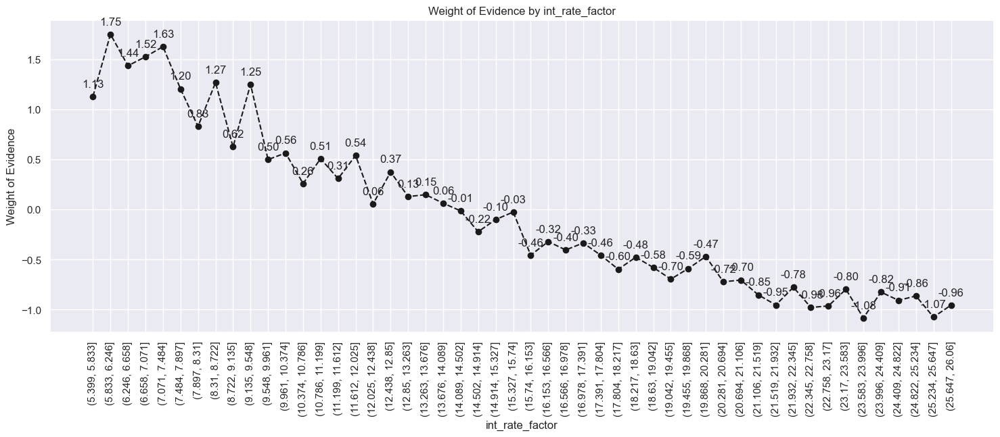

In [144]:
plot_by_woe(df_temp, 90)
# We plot the weight of evidence values.

In [145]:
df_inputs_prepr['int_rate:<9.548'] = np.where((df_inputs_prepr['int_rate'] <= 9.548), 1, 0)
df_inputs_prepr['int_rate:9.548-12.025'] = np.where((df_inputs_prepr['int_rate'] > 9.548) & (df_inputs_prepr['int_rate'] <= 12.025), 1, 0)
df_inputs_prepr['int_rate:12.025-15.74'] = np.where((df_inputs_prepr['int_rate'] > 12.025) & (df_inputs_prepr['int_rate'] <= 15.74), 1, 0)
df_inputs_prepr['int_rate:15.74-20.281'] = np.where((df_inputs_prepr['int_rate'] > 15.74) & (df_inputs_prepr['int_rate'] <= 20.281), 1, 0)
df_inputs_prepr['int_rate:>20.281'] = np.where((df_inputs_prepr['int_rate'] > 20.281), 1, 0)

In [146]:
# funded_amnt
df_inputs_prepr['funded_amnt_factor'] = pd.cut(df_inputs_prepr['funded_amnt'], 50)
# Here we do fine-classing: using the 'cut' method, we split the variable into 50 categories by its values.
df_temp = woe_ordered_continuous(df_inputs_prepr, 'funded_amnt_factor', df_targets_prepr)
# We calculate weight of evidence.
df_temp

C:\Users\dcgzb\AppData\Local\Temp\ipykernel_10772\1881610760.py:4: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  df = pd.concat([df.groupby(df.columns.values[0], as_index = False)[df.columns.values[1]].count(),
C:\Users\dcgzb\AppData\Local\Temp\ipykernel_10772\1881610760.py:5: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  df.groupby(df.columns.values[0], as_index = False)[df.columns.values[1]].mean()], axis = 1)


,funded_amnt_factor,n_obs,prop_good,prop_n_obs,n_good,n_bad,prop_n_good,prop_n_bad,WoE,diff_prop_good,diff_WoE,IV
0,"(465.5, 1190.0]",1215,0.900412,0.003257,1094.0,121.0,0.003293,0.002964,0.105371,NaN,NaN,0.013331
1,"(1190.0, 1880.0]",3046,0.901510,0.008166,2746.0,300.0,0.008267,0.007349,0.117684,0.001099,0.012313,0.013331
2,"(1880.0, 2570.0]",6028,0.892170,0.016161,5378.0,650.0,0.016190,0.015922,0.016665,0.009340,0.101019,0.013331
3,"(2570.0, 3260.0]",7214,0.889520,0.019340,6417.0,797.0,0.019318,0.019523,-0.010583,0.002649,0.027248,0.013331
4,"(3260.0, 3950.0]",4787,0.894088,0.012834,4280.0,507.0,0.012885,0.012419,0.036763,0.004568,0.047346,0.013331
5,"(3950.0, 4640.0]",9096,0.889292,0.024386,8089.0,1007.0,0.024351,0.024667,-0.012905,0.004796,0.049668,0.013331
6,"(4640.0, 5330.0]",15872,0.892137,0.042552,14160.0,1712.0,0.042627,0.041937,0.016324,0.002845,0.029229,0.013331
7,"(5330.0, 6020.0]",17064,0.904477,0.045747,15434.0,1630.0,0.046463,0.039928,0.151559,0.012340,0.135234,0.013331
8,"(6020.0, 6710.0]",6890,0.887518,0.018472,6115.0,775.0,0.018409,0.018984,-0.030797,0.016959,0.182356,0.013331
9,"(6710.0, 7400.0]",11790,0.897625,0.031608,10583.0,1207.0,0.031859,0.029567,0.074677,0.010107,0.105474,0.013331


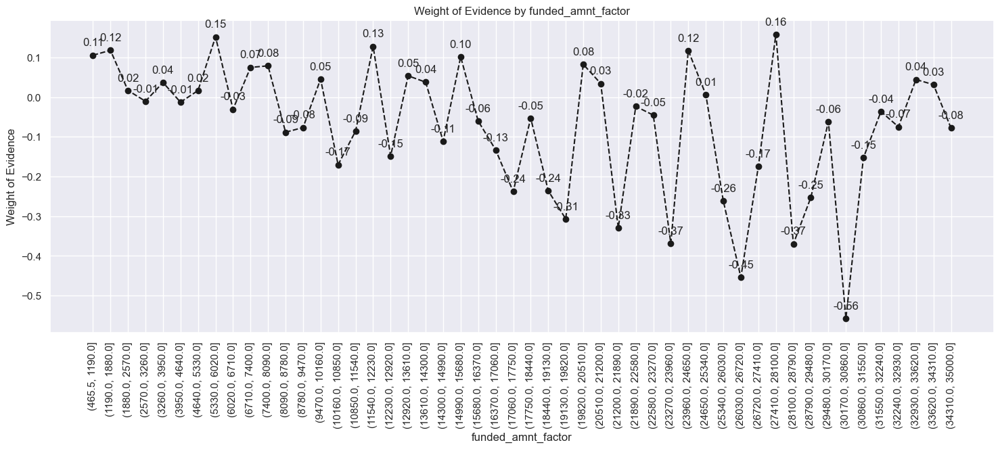

In [148]:
plot_by_woe(df_temp, 90)
# We plot the weight of evidence values.

In [149]:
# mths_since_earliest_cr_line
df_inputs_prepr['mths_since_earliest_cr_line_factor'] = pd.cut(df_inputs_prepr['mths_since_earliest_cr_line'], 50)
# Here we do fine-classing: using the 'cut' method, we split the variable into 50 categories by its values.
df_temp = woe_ordered_continuous(df_inputs_prepr, 'mths_since_earliest_cr_line_factor', df_targets_prepr)
# We calculate weight of evidence.
df_temp

C:\Users\dcgzb\AppData\Local\Temp\ipykernel_10772\1881610760.py:4: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  df = pd.concat([df.groupby(df.columns.values[0], as_index = False)[df.columns.values[1]].count(),
C:\Users\dcgzb\AppData\Local\Temp\ipykernel_10772\1881610760.py:5: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  df.groupby(df.columns.values[0], as_index = False)[df.columns.values[1]].mean()], axis = 1)


,mths_since_earliest_cr_line_factor,n_obs,prop_good,prop_n_obs,n_good,n_bad,prop_n_good,prop_n_bad,WoE,diff_prop_good,diff_WoE,IV
0,"(72.21, 88.8]",1785,0.905882,0.004785,1617.0,168.0,0.004868,0.004115,0.167930,NaN,NaN,inf
1,"(88.8, 104.6]",3491,0.858493,0.009359,2997.0,494.0,0.009022,0.012101,-0.293603,0.047389,0.461532,inf
2,"(104.6, 120.4]",7028,0.867672,0.018842,6098.0,930.0,0.018357,0.022781,-0.215903,0.009179,0.077700,inf
3,"(120.4, 136.2]",15088,0.862739,0.040450,13017.0,2071.0,0.039186,0.050731,-0.258210,0.004934,0.042307,inf
4,"(136.2, 152.0]",17576,0.875114,0.047120,15381.0,2195.0,0.046303,0.053769,-0.149483,0.012375,0.108726,inf
5,"(152.0, 167.8]",20009,0.878555,0.053643,17579.0,2430.0,0.052920,0.059525,-0.117621,0.003441,0.031863,inf
6,"(167.8, 183.6]",28353,0.888336,0.076013,25187.0,3166.0,0.075823,0.077554,-0.022575,0.009782,0.095045,inf
7,"(183.6, 199.4]",33804,0.884185,0.090626,29889.0,3915.0,0.089978,0.095902,-0.063759,0.004151,0.041184,inf
8,"(199.4, 215.2]",36686,0.884833,0.098353,32461.0,4225.0,0.097721,0.103496,-0.057414,0.000648,0.006345,inf
9,"(215.2, 231.0]",35348,0.887603,0.094766,31375.0,3973.0,0.094452,0.097323,-0.029944,0.002770,0.027470,inf


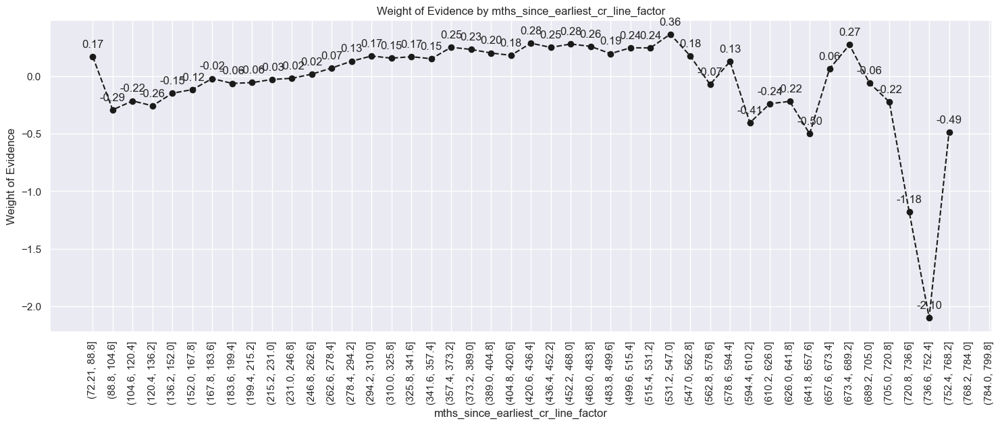

In [150]:
plot_by_woe(df_temp, 90)
# We plot the weight of evidence values.

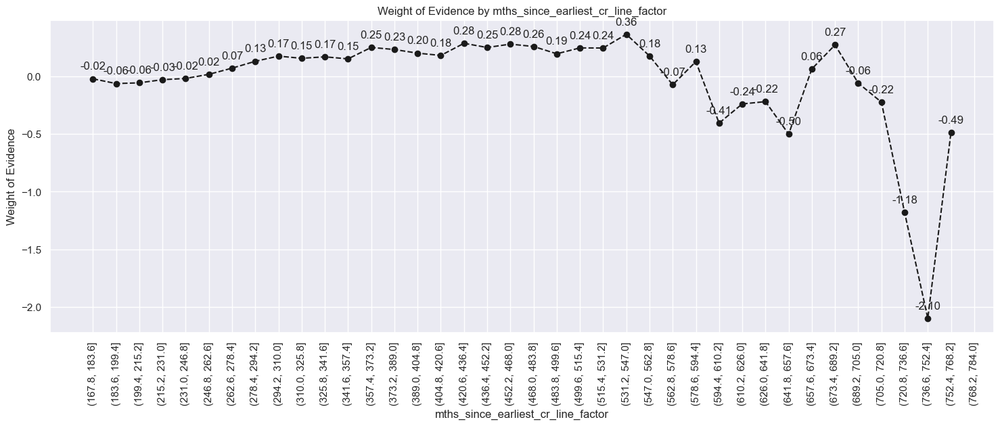

In [151]:
plot_by_woe(df_temp.iloc[6: , : ], 90)
# We plot the weight of evidence values.

In [152]:
# We create the following categories:
# < 140, # 141 - 164, # 165 - 247, # 248 - 270, # 271 - 352, # > 352
df_inputs_prepr['mths_since_earliest_cr_line:<140'] = np.where(df_inputs_prepr['mths_since_earliest_cr_line'].isin(range(140)), 1, 0)
df_inputs_prepr['mths_since_earliest_cr_line:141-164'] = np.where(df_inputs_prepr['mths_since_earliest_cr_line'].isin(range(140, 165)), 1, 0)
df_inputs_prepr['mths_since_earliest_cr_line:165-247'] = np.where(df_inputs_prepr['mths_since_earliest_cr_line'].isin(range(165, 248)), 1, 0)
df_inputs_prepr['mths_since_earliest_cr_line:248-270'] = np.where(df_inputs_prepr['mths_since_earliest_cr_line'].isin(range(248, 271)), 1, 0)
df_inputs_prepr['mths_since_earliest_cr_line:271-352'] = np.where(df_inputs_prepr['mths_since_earliest_cr_line'].isin(range(271, 353)), 1, 0)
df_inputs_prepr['mths_since_earliest_cr_line:>352'] = np.where(df_inputs_prepr['mths_since_earliest_cr_line'].isin(range(353, int(df_inputs_prepr['mths_since_earliest_cr_line'].max()))), 1, 0)

In [153]:
# delinq_2yrs
df_temp = woe_ordered_continuous(df_inputs_prepr, 'delinq_2yrs', df_targets_prepr)
# We calculate weight of evidence.
df_temp

,delinq_2yrs,n_obs,prop_good,prop_n_obs,n_good,n_bad,prop_n_good,prop_n_bad,WoE,diff_prop_good,diff_WoE,IV
0,0.0,306378,0.890129,0.821380,272716.0,33662.0,0.820986,0.824584,-0.004373,NaN,NaN,inf
1,1.0,44879,0.894472,0.120318,40143.0,4736.0,0.120847,0.116013,0.040821,0.004343,0.045194,inf
2,2.0,13105,0.889279,0.035134,11654.0,1451.0,0.035083,0.035544,-0.013038,0.005193,0.053859,inf
3,3.0,4578,0.885976,0.012273,4056.0,522.0,0.012210,0.012787,-0.046149,0.003302,0.033112,inf
4,4.0,1923,0.892876,0.005155,1717.0,206.0,0.005169,0.005046,0.024023,0.006899,0.070173,inf
5,5.0,970,0.883505,0.002601,857.0,113.0,0.002580,0.002768,-0.070384,0.009371,0.094408,inf
6,6.0,505,0.895050,0.001354,452.0,53.0,0.001361,0.001298,0.046956,0.011544,0.117340,inf
7,7.0,268,0.873134,0.000718,234.0,34.0,0.000704,0.000833,-0.167474,0.021915,0.214430,inf
8,8.0,146,0.890411,0.000391,130.0,16.0,0.000391,0.000392,-0.001489,0.017277,0.165985,inf
9,9.0,93,0.913978,0.000249,85.0,8.0,0.000256,0.000196,0.266775,0.023568,0.268264,inf


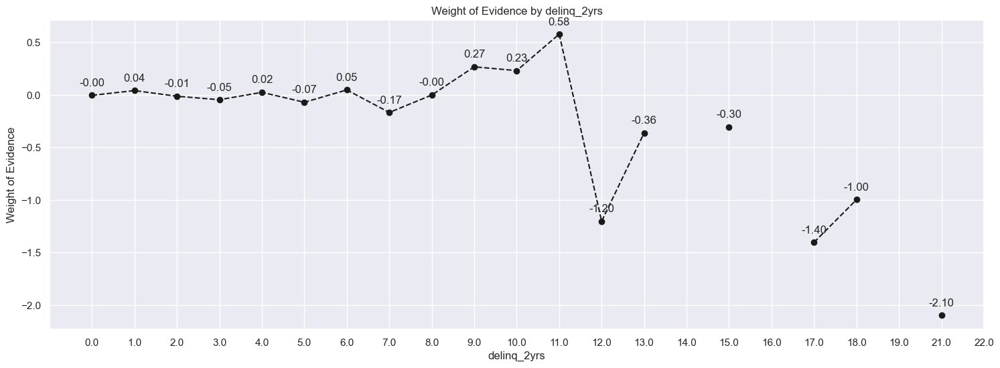

In [154]:
plot_by_woe(df_temp)
# We plot the weight of evidence values.

In [155]:
# Categories: 0, 1-3, >=4
df_inputs_prepr['delinq_2yrs:0'] = np.where((df_inputs_prepr['delinq_2yrs'] == 0), 1, 0)
df_inputs_prepr['delinq_2yrs:1-3'] = np.where((df_inputs_prepr['delinq_2yrs'] >= 1) & (df_inputs_prepr['delinq_2yrs'] <= 3), 1, 0)
df_inputs_prepr['delinq_2yrs:>=4'] = np.where((df_inputs_prepr['delinq_2yrs'] >= 9), 1, 0)

In [156]:
# inq_last_6mths
df_temp = woe_ordered_continuous(df_inputs_prepr, 'inq_last_6mths', df_targets_prepr)
# We calculate weight of evidence.
df_temp

F:\anaconda3\envs\Udemycreditriskmodel\lib\site-packages\pandas\core\arraylike.py:396: RuntimeWarning: divide by zero encountered in log
  result = getattr(ufunc, method)(*inputs, **kwargs)


,inq_last_6mths,n_obs,prop_good,prop_n_obs,n_good,n_bad,prop_n_good,prop_n_bad,WoE,diff_prop_good,diff_WoE,IV
0,0.0,193106,0.908356,0.517705,175409.0,17697.0,0.528052,0.433506,0.197291,NaN,NaN,inf
1,1.0,104092,0.884160,0.279064,92034.0,12058.0,0.277060,0.295373,-0.064005,0.024196,0.261296,inf
2,2.0,46371,0.864635,0.124318,40094.0,6277.0,0.120699,0.153761,-0.242100,0.019525,0.178095,inf
3,3.0,20142,0.840830,0.053999,16936.0,3206.0,0.050984,0.078534,-0.432017,0.023805,0.189917,inf
4,4.0,5751,0.849591,0.015418,4886.0,865.0,0.014709,0.021189,-0.365035,0.008761,0.066982,inf
5,5.0,2217,0.825891,0.005944,1831.0,386.0,0.005512,0.009455,-0.539654,0.023701,0.174620,inf
6,6.0,954,0.779874,0.002558,744.0,210.0,0.002240,0.005144,-0.831501,0.046017,0.291847,inf
7,7.0,160,0.681250,0.000429,109.0,51.0,0.000328,0.001249,-1.336912,0.098624,0.505411,inf
8,8.0,101,0.653465,0.000271,66.0,35.0,0.000199,0.000857,-1.462128,0.027785,0.125216,inf
9,9.0,42,0.690476,0.000113,29.0,13.0,0.000087,0.000318,-1.294088,0.037011,0.168040,inf


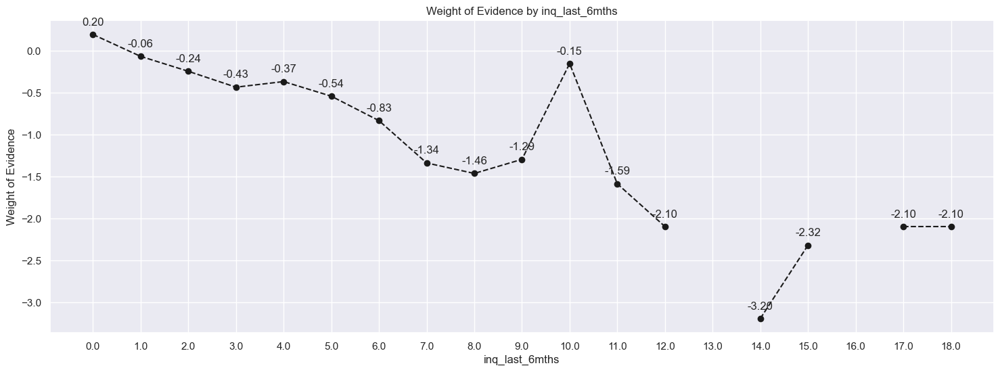

In [159]:
plot_by_woe(df_temp)
# We plot the weight of evidence values.

In [158]:
# Categories: 0, 1 - 2, 3 - 6, > 6
df_inputs_prepr['inq_last_6mths:0'] = np.where((df_inputs_prepr['inq_last_6mths'] == 0), 1, 0)
df_inputs_prepr['inq_last_6mths:1-2'] = np.where((df_inputs_prepr['inq_last_6mths'] >= 1) & (df_inputs_prepr['inq_last_6mths'] <= 2), 1, 0)
df_inputs_prepr['inq_last_6mths:3-6'] = np.where((df_inputs_prepr['inq_last_6mths'] >= 3) & (df_inputs_prepr['inq_last_6mths'] <= 6), 1, 0)
df_inputs_prepr['inq_last_6mths:>6'] = np.where((df_inputs_prepr['inq_last_6mths'] > 6), 1, 0)

In [160]:
# open_acc
df_temp = woe_ordered_continuous(df_inputs_prepr, 'open_acc', df_targets_prepr)
# We calculate weight of evidence.
df_temp

F:\anaconda3\envs\Udemycreditriskmodel\lib\site-packages\pandas\core\arraylike.py:396: RuntimeWarning: divide by zero encountered in log
  result = getattr(ufunc, method)(*inputs, **kwargs)


,open_acc,n_obs,prop_good,prop_n_obs,n_good,n_bad,prop_n_good,prop_n_bad,WoE,diff_prop_good,diff_WoE,IV
0,0.0,5,0.400000,0.000013,2.0,3.0,0.000006,0.000073,-2.501899,NaN,NaN,inf
1,1.0,116,0.887931,0.000311,103.0,13.0,0.000310,0.000318,-0.026655,0.487931,2.475245,inf
2,2.0,1431,0.845563,0.003836,1210.0,221.0,0.003643,0.005414,-0.396221,0.042368,0.369567,inf
3,3.0,4433,0.870065,0.011885,3857.0,576.0,0.011611,0.014110,-0.194897,0.024503,0.201324,inf
4,4.0,10007,0.890976,0.026828,8916.0,1091.0,0.026841,0.026725,0.004318,0.020911,0.199215,inf
5,5.0,17125,0.888526,0.045911,15216.0,1909.0,0.045806,0.046763,-0.020666,0.002451,0.024985,inf
6,6.0,24671,0.892019,0.066141,22007.0,2664.0,0.066250,0.065257,0.015097,0.003493,0.035764,inf
7,7.0,30036,0.889932,0.080525,26730.0,3306.0,0.080468,0.080984,-0.006387,0.002087,0.021484,inf
8,8.0,33410,0.892906,0.089570,29832.0,3578.0,0.089806,0.087647,0.024343,0.002974,0.030730,inf
9,9.0,35245,0.889346,0.094490,31345.0,3900.0,0.094361,0.095534,-0.012356,0.003560,0.036699,inf


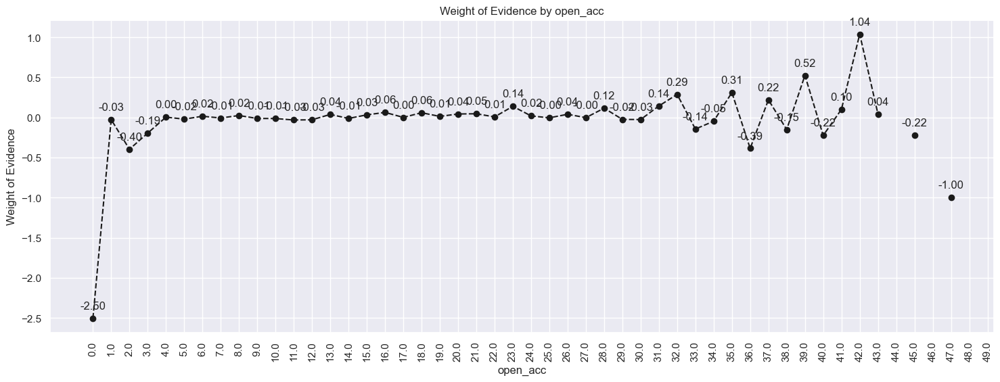

In [161]:
plot_by_woe(df_temp, 90)
# We plot the weight of evidence values.

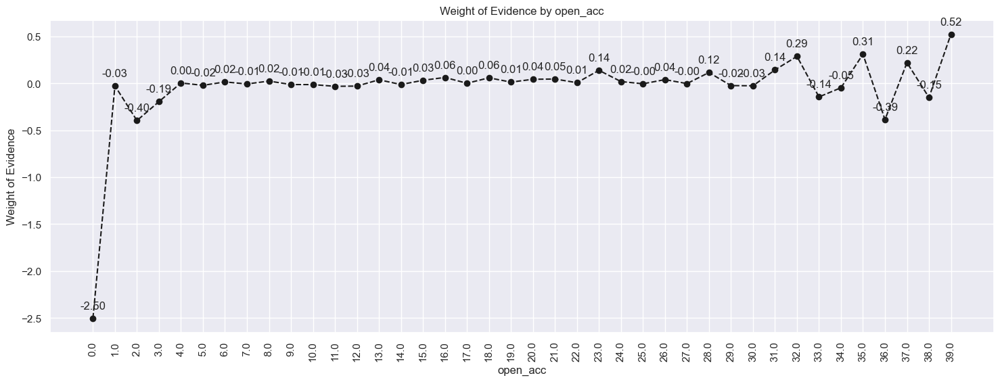

In [162]:
plot_by_woe(df_temp.iloc[ : 40, :], 90)
# We plot the weight of evidence values.

In [163]:
# Categories: '0', '1-3', '4-12', '13-17', '18-22', '23-25', '26-30', '>30'
df_inputs_prepr['open_acc:0'] = np.where((df_inputs_prepr['open_acc'] == 0), 1, 0)
df_inputs_prepr['open_acc:1-3'] = np.where((df_inputs_prepr['open_acc'] >= 1) & (df_inputs_prepr['open_acc'] <= 3), 1, 0)
df_inputs_prepr['open_acc:4-12'] = np.where((df_inputs_prepr['open_acc'] >= 4) & (df_inputs_prepr['open_acc'] <= 12), 1, 0)
df_inputs_prepr['open_acc:13-17'] = np.where((df_inputs_prepr['open_acc'] >= 13) & (df_inputs_prepr['open_acc'] <= 17), 1, 0)
df_inputs_prepr['open_acc:18-22'] = np.where((df_inputs_prepr['open_acc'] >= 18) & (df_inputs_prepr['open_acc'] <= 22), 1, 0)
df_inputs_prepr['open_acc:23-25'] = np.where((df_inputs_prepr['open_acc'] >= 23) & (df_inputs_prepr['open_acc'] <= 25), 1, 0)
df_inputs_prepr['open_acc:26-30'] = np.where((df_inputs_prepr['open_acc'] >= 26) & (df_inputs_prepr['open_acc'] <= 30), 1, 0)
df_inputs_prepr['open_acc:>=31'] = np.where((df_inputs_prepr['open_acc'] >= 31), 1, 0)

In [164]:
# pub_rec
df_temp = woe_ordered_continuous(df_inputs_prepr, 'pub_rec', df_targets_prepr)
# We calculate weight of evidence.
df_temp

,pub_rec,n_obs,prop_good,prop_n_obs,n_good,n_bad,prop_n_good,prop_n_bad,WoE,diff_prop_good,diff_WoE,IV
0,0.0,323850,0.889770,0.868221,288152.0,35698.0,0.867455,0.874458,-0.008041,NaN,NaN,inf
1,1.0,42502,0.893629,0.113945,37981.0,4521.0,0.114338,0.110746,0.031918,0.003859,0.039959,inf
2,2.0,4477,0.906187,0.012003,4057.0,420.0,0.012213,0.010288,0.171510,0.012559,0.139592,inf
3,3.0,1296,0.912037,0.003474,1182.0,114.0,0.003558,0.002793,0.242330,0.005850,0.070820,inf
4,4.0,418,0.921053,0.001121,385.0,33.0,0.001159,0.000808,0.360301,0.009016,0.117971,inf
5,5.0,221,0.909502,0.000592,201.0,20.0,0.000605,0.000490,0.211138,0.011550,0.149163,inf
6,6.0,115,0.930435,0.000308,107.0,8.0,0.000322,0.000196,0.496953,0.020933,0.285815,inf
7,7.0,57,0.912281,0.000153,52.0,5.0,0.000157,0.000122,0.245371,0.018154,0.251581,inf
8,8.0,24,0.958333,0.000064,23.0,1.0,0.000069,0.000024,1.039060,0.046053,0.793688,inf
9,9.0,14,0.785714,0.000038,11.0,3.0,0.000033,0.000073,-0.797151,0.172619,1.836211,inf


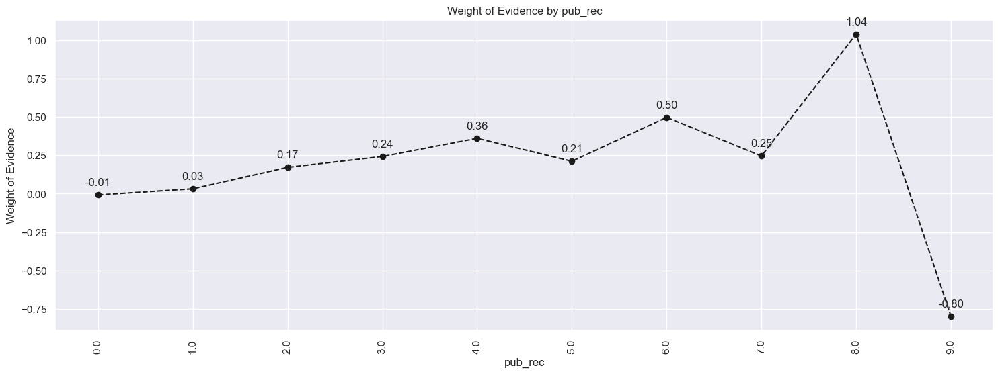

In [165]:
plot_by_woe(df_temp, 90)
# We plot the weight of evidence values.

In [166]:
# Categories '0-2', '3-4', '>=5'
df_inputs_prepr['pub_rec:0-2'] = np.where((df_inputs_prepr['pub_rec'] >= 0) & (df_inputs_prepr['pub_rec'] <= 2), 1, 0)
df_inputs_prepr['pub_rec:3-4'] = np.where((df_inputs_prepr['pub_rec'] >= 3) & (df_inputs_prepr['pub_rec'] <= 4), 1, 0)
df_inputs_prepr['pub_rec:>=5'] = np.where((df_inputs_prepr['pub_rec'] >= 5), 1, 0)

In [167]:
# total_acc
df_inputs_prepr['total_acc_factor'] = pd.cut(df_inputs_prepr['total_acc'], 50)
# Here we do fine-classing: using the 'cut' method, we split the variable into 50 categories by its values.
df_temp = woe_ordered_continuous(df_inputs_prepr, 'total_acc_factor', df_targets_prepr)
# We calculate weight of evidence.
df_temp

C:\Users\dcgzb\AppData\Local\Temp\ipykernel_10772\1881610760.py:4: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  df = pd.concat([df.groupby(df.columns.values[0], as_index = False)[df.columns.values[1]].count(),
C:\Users\dcgzb\AppData\Local\Temp\ipykernel_10772\1881610760.py:5: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  df.groupby(df.columns.values[0], as_index = False)[df.columns.values[1]].mean()], axis = 1)


,total_acc_factor,n_obs,prop_good,prop_n_obs,n_good,n_bad,prop_n_good,prop_n_bad,WoE,diff_prop_good,diff_WoE,IV
0,"(0.845, 4.1]",1613,0.834470,0.004324,1346.0,267.0,0.004052,0.006540,-0.478791,NaN,NaN,inf
1,"(4.1, 7.2]",8617,0.867239,0.023102,7473.0,1144.0,0.022497,0.028023,-0.219669,0.032769,0.259122,inf
2,"(7.2, 10.3]",18463,0.872935,0.049498,16117.0,2346.0,0.048519,0.057468,-0.169271,0.005696,0.050397,inf
3,"(10.3, 13.4]",28257,0.880844,0.075755,24890.0,3367.0,0.074929,0.082478,-0.095990,0.007909,0.073281,inf
4,"(13.4, 16.5]",35625,0.882498,0.095508,31439.0,4186.0,0.094644,0.102540,-0.080131,0.001655,0.015860,inf
5,"(16.5, 19.6]",39701,0.888844,0.106436,35288.0,4413.0,0.106231,0.108101,-0.017446,0.006346,0.062685,inf
6,"(19.6, 22.7]",40968,0.890036,0.109833,36463.0,4505.0,0.109768,0.110354,-0.005324,0.001192,0.012122,inf
7,"(22.7, 25.8]",39036,0.891792,0.104653,34812.0,4224.0,0.104798,0.103471,0.012745,0.001756,0.018069,inf
8,"(25.8, 28.9]",34856,0.897980,0.093447,31300.0,3556.0,0.094226,0.087108,0.078547,0.006188,0.065802,inf
9,"(28.9, 32.0]",38487,0.895991,0.103181,34484.0,4003.0,0.103811,0.098057,0.057017,0.001989,0.021530,inf


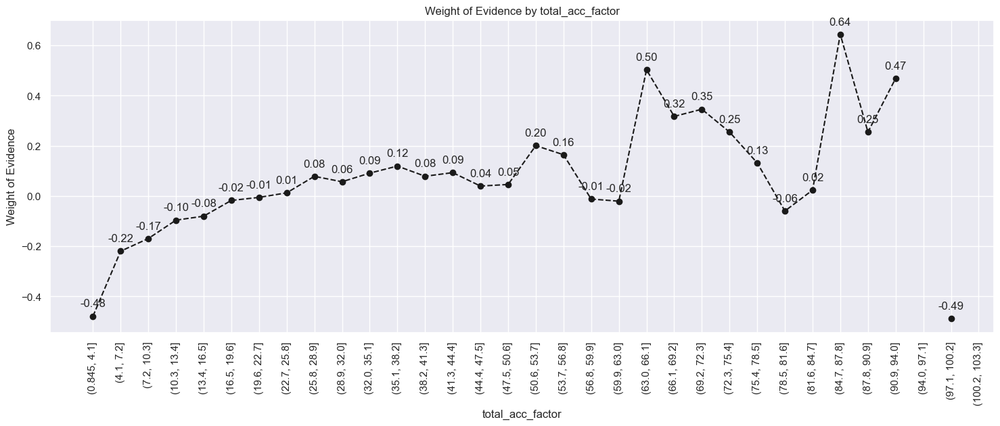

In [168]:
plot_by_woe(df_temp, 90)
# We plot the weight of evidence values.

In [169]:
# Categories: '<=27', '28-51', '>51'
df_inputs_prepr['total_acc:<=27'] = np.where((df_inputs_prepr['total_acc'] <= 27), 1, 0)
df_inputs_prepr['total_acc:28-51'] = np.where((df_inputs_prepr['total_acc'] >= 28) & (df_inputs_prepr['total_acc'] <= 51), 1, 0)
df_inputs_prepr['total_acc:>=52'] = np.where((df_inputs_prepr['total_acc'] >= 52), 1, 0)

In [170]:
# acc_now_delinq
df_temp = woe_ordered_continuous(df_inputs_prepr, 'acc_now_delinq', df_targets_prepr)
# We calculate weight of evidence.
df_temp

,acc_now_delinq,n_obs,prop_good,prop_n_obs,n_good,n_bad,prop_n_good,prop_n_bad,WoE,diff_prop_good,diff_WoE,IV
0,0.0,371615,0.890532,0.996276,330935.0,40680.0,0.996249,0.996497,-0.000249,NaN,NaN,inf
1,1.0,1304,0.898773,0.003496,1172.0,132.0,0.003528,0.003233,0.087231,0.008241,0.087480,inf
2,2.0,70,0.885714,0.000188,62.0,8.0,0.000187,0.000196,-0.048742,0.013059,0.135972,inf
3,3.0,10,0.800000,0.000027,8.0,2.0,0.000024,0.000049,-0.710140,0.085714,0.661398,inf
4,4.0,3,1.000000,0.000008,3.0,0.0,0.000009,0.000000,inf,0.200000,inf,inf
5,5.0,2,0.500000,0.000005,1.0,1.0,0.000003,0.000024,-2.096434,0.500000,inf,inf


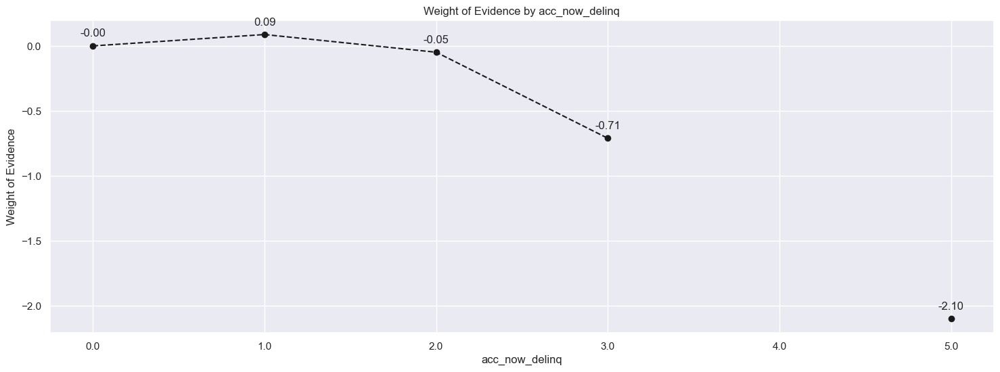

In [172]:
plot_by_woe(df_temp)
# We plot the weight of evidence values.

In [173]:
# Categories: '0', '>=1'
df_inputs_prepr['acc_now_delinq:0'] = np.where((df_inputs_prepr['acc_now_delinq'] == 0), 1, 0)
df_inputs_prepr['acc_now_delinq:>=1'] = np.where((df_inputs_prepr['acc_now_delinq'] >= 1), 1, 0)

In [174]:
# total_rev_hi_lim
df_inputs_prepr['total_rev_hi_lim_factor'] = pd.cut(df_inputs_prepr['total_rev_hi_lim'], 2000)
# Here we do fine-classing: using the 'cut' method, we split the variable into 2000 categories by its values.
df_temp = woe_ordered_continuous(df_inputs_prepr, 'total_rev_hi_lim_factor', df_targets_prepr)
# We calculate weight of evidence.
df_temp

C:\Users\dcgzb\AppData\Local\Temp\ipykernel_10772\1881610760.py:4: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  df = pd.concat([df.groupby(df.columns.values[0], as_index = False)[df.columns.values[1]].count(),
C:\Users\dcgzb\AppData\Local\Temp\ipykernel_10772\1881610760.py:5: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  df.groupby(df.columns.values[0], as_index = False)[df.columns.values[1]].mean()], axis = 1)
F:\anaconda3\envs\Udemycreditriskmodel\lib\site-packages\pandas\core\arraylike.py:396: RuntimeWarning: divide by zero encountered in log
  result = getattr(ufunc, method)(*inputs, **kwargs)


,total_rev_hi_lim_factor,n_obs,prop_good,prop_n_obs,n_good,n_bad,prop_n_good,prop_n_bad,WoE,diff_prop_good,diff_WoE,IV
0,"(-9999.999, 5000.0]",19472,0.865756,0.052203,16858.0,2614.0,0.050749,0.064033,-0.232491,NaN,NaN,inf
1,"(5000.0, 9999.999]",52633,0.875078,0.141106,46058.0,6575.0,0.138653,0.161061,-0.149807,0.009322,0.082683,inf
2,"(9999.999, 14999.998]",59509,0.879648,0.159540,52347.0,7162.0,0.157586,0.175440,-0.107329,0.004570,0.042478,inf
3,"(14999.998, 19999.998]",51517,0.878758,0.138114,45271.0,6246.0,0.136284,0.153002,-0.115709,0.000890,0.008380,inf
4,"(19999.998, 24999.997]",41537,0.886776,0.111358,36834.0,4703.0,0.110885,0.115205,-0.038214,0.008017,0.077495,inf
...,...,...,...,...,...,...,...,...,...,...,...,...
1995,"(9974999.002, 9979999.002]",0,NaN,0.000000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,inf
1996,"(9979999.002, 9984999.002]",0,NaN,0.000000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,inf
1997,"(9984999.002, 9989999.001]",0,NaN,0.000000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,inf
1998,"(9989999.001, 9994999.0]",0,NaN,0.000000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,inf


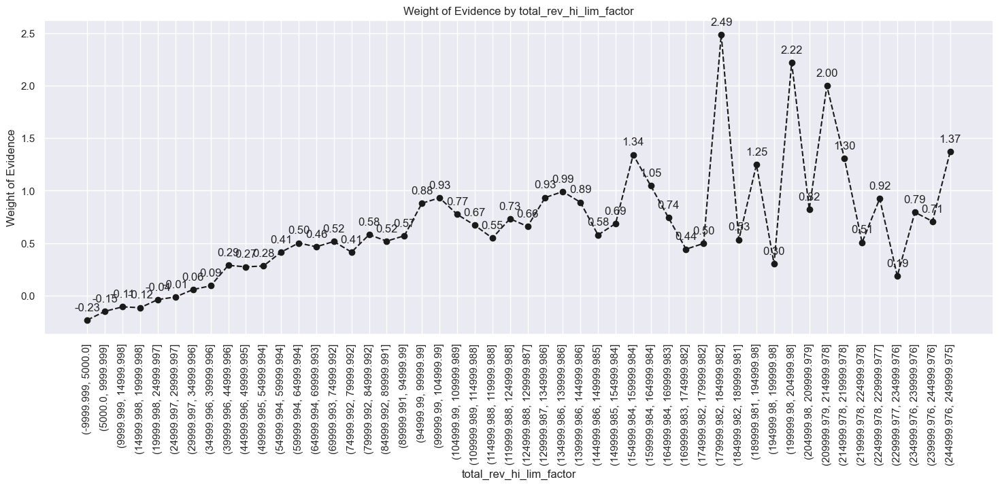

In [175]:
plot_by_woe(df_temp.iloc[: 50, : ], 90)
# We plot the weight of evidence values.

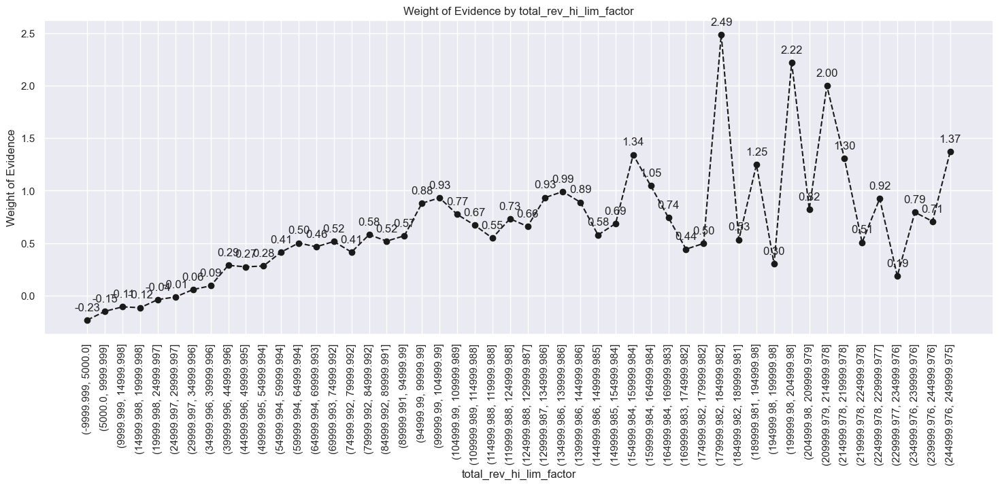

In [176]:
plot_by_woe(df_temp.iloc[: 50, : ], 90)

In [177]:
# Categories
# '<=5K', '5K-10K', '10K-20K', '20K-30K', '30K-40K', '40K-55K', '55K-95K', '>95K'
df_inputs_prepr['total_rev_hi_lim:<=5K'] = np.where((df_inputs_prepr['total_rev_hi_lim'] <= 5000), 1, 0)
df_inputs_prepr['total_rev_hi_lim:5K-10K'] = np.where((df_inputs_prepr['total_rev_hi_lim'] > 5000) & (df_inputs_prepr['total_rev_hi_lim'] <= 10000), 1, 0)
df_inputs_prepr['total_rev_hi_lim:10K-20K'] = np.where((df_inputs_prepr['total_rev_hi_lim'] > 10000) & (df_inputs_prepr['total_rev_hi_lim'] <= 20000), 1, 0)
df_inputs_prepr['total_rev_hi_lim:20K-30K'] = np.where((df_inputs_prepr['total_rev_hi_lim'] > 20000) & (df_inputs_prepr['total_rev_hi_lim'] <= 30000), 1, 0)
df_inputs_prepr['total_rev_hi_lim:30K-40K'] = np.where((df_inputs_prepr['total_rev_hi_lim'] > 30000) & (df_inputs_prepr['total_rev_hi_lim'] <= 40000), 1, 0)
df_inputs_prepr['total_rev_hi_lim:40K-55K'] = np.where((df_inputs_prepr['total_rev_hi_lim'] > 40000) & (df_inputs_prepr['total_rev_hi_lim'] <= 55000), 1, 0)
df_inputs_prepr['total_rev_hi_lim:55K-95K'] = np.where((df_inputs_prepr['total_rev_hi_lim'] > 55000) & (df_inputs_prepr['total_rev_hi_lim'] <= 95000), 1, 0)
df_inputs_prepr['total_rev_hi_lim:>95K'] = np.where((df_inputs_prepr['total_rev_hi_lim'] > 95000), 1, 0)

In [178]:
# installment
df_inputs_prepr['installment_factor'] = pd.cut(df_inputs_prepr['installment'], 50)
# Here we do fine-classing: using the 'cut' method, we split the variable into 50 categories by its values.
df_temp = woe_ordered_continuous(df_inputs_prepr, 'installment_factor', df_targets_prepr)
# We calculate weight of evidence.
df_temp

C:\Users\dcgzb\AppData\Local\Temp\ipykernel_10772\1881610760.py:4: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  df = pd.concat([df.groupby(df.columns.values[0], as_index = False)[df.columns.values[1]].count(),
C:\Users\dcgzb\AppData\Local\Temp\ipykernel_10772\1881610760.py:5: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  df.groupby(df.columns.values[0], as_index = False)[df.columns.values[1]].mean()], axis = 1)


,installment_factor,n_obs,prop_good,prop_n_obs,n_good,n_bad,prop_n_good,prop_n_bad,WoE,diff_prop_good,diff_WoE,IV
0,"(14.276, 43.556]",1820,0.900000,0.004879,1638.0,182.0,0.004931,0.004458,0.100790,NaN,NaN,0.012519
1,"(43.556, 71.443]",4853,0.897383,0.013011,4355.0,498.0,0.013110,0.012199,0.072045,0.002617,0.028745,0.012519
2,"(71.443, 99.329]",6786,0.891689,0.018193,6051.0,735.0,0.018216,0.018005,0.011674,0.005694,0.060371,0.012519
3,"(99.329, 127.216]",9154,0.890212,0.024541,8149.0,1005.0,0.024532,0.024618,-0.003527,0.001477,0.015201,0.012519
4,"(127.216, 155.102]",10164,0.895415,0.027249,9101.0,1063.0,0.027398,0.026039,0.050855,0.005203,0.054382,0.012519
5,"(155.102, 182.988]",16725,0.894469,0.044839,14960.0,1765.0,0.045036,0.043235,0.040795,0.000946,0.010060,0.012519
6,"(182.988, 210.875]",17034,0.904250,0.045667,15403.0,1631.0,0.046369,0.039953,0.148935,0.009781,0.108140,0.012519
7,"(210.875, 238.761]",15088,0.898860,0.040450,13562.0,1526.0,0.040827,0.037381,0.088187,0.005390,0.060747,0.012519
8,"(238.761, 266.648]",18839,0.901322,0.050506,16980.0,1859.0,0.051117,0.045538,0.115563,0.002462,0.027376,0.012519
9,"(266.648, 294.534]",20213,0.891209,0.054190,18014.0,2199.0,0.054229,0.053867,0.006712,0.010113,0.108851,0.012519


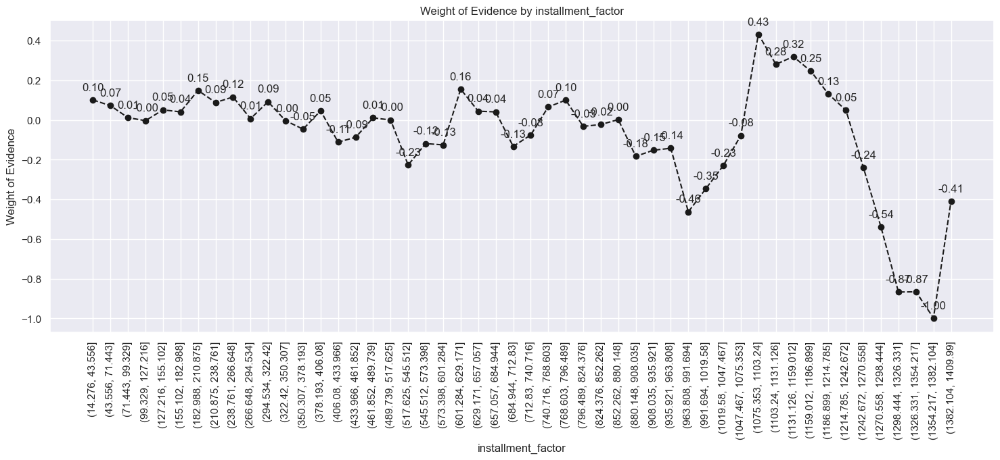

In [179]:
plot_by_woe(df_temp, 90)
# We plot the weight of evidence values.

In [180]:
# annual_inc
df_inputs_prepr['annual_inc_factor'] = pd.cut(df_inputs_prepr['annual_inc'], 50)
# Here we do fine-classing: using the 'cut' method, we split the variable into 50 categories by its values.
df_temp = woe_ordered_continuous(df_inputs_prepr, 'annual_inc_factor', df_targets_prepr)
# We calculate weight of evidence.
df_temp

C:\Users\dcgzb\AppData\Local\Temp\ipykernel_10772\1881610760.py:4: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  df = pd.concat([df.groupby(df.columns.values[0], as_index = False)[df.columns.values[1]].count(),
C:\Users\dcgzb\AppData\Local\Temp\ipykernel_10772\1881610760.py:5: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  df.groupby(df.columns.values[0], as_index = False)[df.columns.values[1]].mean()], axis = 1)


,annual_inc_factor,n_obs,prop_good,prop_n_obs,n_good,n_bad,prop_n_good,prop_n_bad,WoE,diff_prop_good,diff_WoE,IV
0,"(-5602.104, 151858.08]",356645,0.888870,0.956143,317011.0,39634.0,0.954332,0.970874,-0.017185,NaN,NaN,inf
1,"(151858.08, 301820.16]",14732,0.927030,0.039496,13657.0,1075.0,0.041113,0.026333,0.445497,0.038160,0.462682,inf
2,"(301820.16, 451782.24]",1100,0.929091,0.002949,1022.0,78.0,0.003077,0.001911,0.476374,0.002061,0.030876,inf
3,"(451782.24, 601744.32]",306,0.941176,0.000820,288.0,18.0,0.000867,0.000441,0.676154,0.012086,0.199781,inf
4,"(601744.32, 751706.4]",92,0.891304,0.000247,82.0,10.0,0.000247,0.000245,0.007700,0.049872,0.668455,inf
5,"(751706.4, 901668.48]",61,0.885246,0.000164,54.0,7.0,0.000163,0.000171,-0.053360,0.006058,0.061060,inf
6,"(901668.48, 1051630.56]",24,0.958333,0.000064,23.0,1.0,0.000069,0.000024,1.039060,0.073087,1.092420,inf
7,"(1051630.56, 1201592.64]",17,1.000000,0.000046,17.0,0.0,0.000051,0.000000,inf,0.041667,inf,inf
8,"(1201592.64, 1351554.72]",7,1.000000,0.000019,7.0,0.0,0.000021,0.000000,inf,0.000000,NaN,inf
9,"(1351554.72, 1501516.8]",6,1.000000,0.000016,6.0,0.0,0.000018,0.000000,inf,0.000000,NaN,inf


In [181]:
df_inputs_prepr['annual_inc_factor'] = pd.cut(df_inputs_prepr['annual_inc'], 100)
# Here we do fine-classing: using the 'cut' method, we split the variable into 100 categories by its values.
df_temp = woe_ordered_continuous(df_inputs_prepr, 'annual_inc_factor', df_targets_prepr)
# We calculate weight of evidence.
df_temp

C:\Users\dcgzb\AppData\Local\Temp\ipykernel_10772\1881610760.py:4: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  df = pd.concat([df.groupby(df.columns.values[0], as_index = False)[df.columns.values[1]].count(),
C:\Users\dcgzb\AppData\Local\Temp\ipykernel_10772\1881610760.py:5: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  df.groupby(df.columns.values[0], as_index = False)[df.columns.values[1]].mean()], axis = 1)


,annual_inc_factor,n_obs,prop_good,prop_n_obs,n_good,n_bad,prop_n_good,prop_n_bad,WoE,diff_prop_good,diff_WoE,IV
0,"(-5602.104, 76877.04]",245231,0.877214,0.657449,215120.0,30111.0,0.647599,0.737599,-0.130129,NaN,NaN,inf
1,"(76877.04, 151858.08]",111414,0.914526,0.298694,101891.0,9523.0,0.306733,0.233275,0.273759,0.037312,0.403888,inf
2,"(151858.08, 226839.12]",11857,0.927469,0.031788,10997.0,860.0,0.033105,0.021067,0.452011,0.012943,0.178252,inf
3,"(226839.12, 301820.16]",2875,0.925217,0.007708,2660.0,215.0,0.008008,0.005267,0.419009,0.002252,0.033002,inf
4,"(301820.16, 376801.2]",697,0.921090,0.001869,642.0,55.0,0.001933,0.001347,0.360821,0.004127,0.058188,inf
5,"(376801.2, 451782.24]",403,0.942928,0.001080,380.0,23.0,0.001144,0.000563,0.708243,0.021838,0.347422,inf
6,"(451782.24, 526763.28]",195,0.953846,0.000523,186.0,9.0,0.000560,0.000220,0.932088,0.010918,0.223845,inf
7,"(526763.28, 601744.32]",111,0.918919,0.000298,102.0,9.0,0.000307,0.000220,0.331314,0.034927,0.600774,inf
8,"(601744.32, 676725.36]",42,0.880952,0.000113,37.0,5.0,0.000111,0.000122,-0.094954,0.037967,0.426268,inf
9,"(676725.36, 751706.4]",50,0.900000,0.000134,45.0,5.0,0.000135,0.000122,0.100790,0.019048,0.195745,inf


In [182]:
# Initial examination shows that there are too few individuals with large income and too many with small income.
# Hence, we are going to have one category for more than 150K, and we are going to apply our approach to determine
# the categories of everyone with 140k or less.
df_inputs_prepr_temp = df_inputs_prepr.loc[df_inputs_prepr['annual_inc'] <= 140000, : ]
#loan_data_temp = loan_data_temp.reset_index(drop = True)
#df_inputs_prepr_temp

In [183]:
df_inputs_prepr_temp["annual_inc_factor"] = pd.cut(df_inputs_prepr_temp['annual_inc'], 50)
# Here we do fine-classing: using the 'cut' method, we split the variable into 50 categories by its values.
df_temp = woe_ordered_continuous(df_inputs_prepr_temp, 'annual_inc_factor', df_targets_prepr[df_inputs_prepr_temp.index])
# We calculate weight of evidence.
df_temp

C:\Users\dcgzb\AppData\Local\Temp\ipykernel_10772\2604529898.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_inputs_prepr_temp["annual_inc_factor"] = pd.cut(df_inputs_prepr_temp['annual_inc'], 50)
C:\Users\dcgzb\AppData\Local\Temp\ipykernel_10772\1881610760.py:4: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  df = pd.concat([df.groupby(df.columns.values[0], as_index = False)[df.columns.values[1]].count(),
C:\Users\dcgzb\AppData\Local\Temp\ipykernel_10772\1881610760.py:5: FutureWarning: The default of observed=False is deprecated and will be changed to 

,annual_inc_factor,n_obs,prop_good,prop_n_obs,n_good,n_bad,prop_n_good,prop_n_bad,WoE,diff_prop_good,diff_WoE,IV
0,"(1757.896, 4658.08]",12,0.750000,0.000034,9.0,3.0,0.000029,0.000077,-0.975335,NaN,NaN,0.050402
1,"(4658.08, 7420.16]",35,0.771429,0.000100,27.0,8.0,0.000087,0.000204,-0.857552,0.021429,0.117783,0.050402
2,"(7420.16, 10182.24]",299,0.866221,0.000852,259.0,40.0,0.000831,0.001021,-0.205998,0.094792,0.651553,0.050402
3,"(10182.24, 12944.32]",547,0.822669,0.001558,450.0,97.0,0.001443,0.002475,-0.539410,0.043552,0.333412,0.050402
4,"(12944.32, 15706.4]",1218,0.830049,0.003470,1011.0,207.0,0.003242,0.005282,-0.487971,0.007380,0.051440,0.050402
5,"(15706.4, 18468.48]",1538,0.844603,0.004382,1299.0,239.0,0.004166,0.006098,-0.381061,0.014554,0.106910,0.050402
6,"(18468.48, 21230.56]",2926,0.852016,0.008336,2493.0,433.0,0.007995,0.011048,-0.323443,0.007413,0.057618,0.050402
7,"(21230.56, 23992.64]",2544,0.845519,0.007248,2151.0,393.0,0.006898,0.010028,-0.374069,0.006498,0.050626,0.050402
8,"(23992.64, 26754.72]",7053,0.849426,0.020093,5991.0,1062.0,0.019213,0.027097,-0.343843,0.003907,0.030226,0.050402
9,"(26754.72, 29516.8]",5640,0.855674,0.016068,4826.0,814.0,0.015477,0.020770,-0.294134,0.006248,0.049708,0.050402


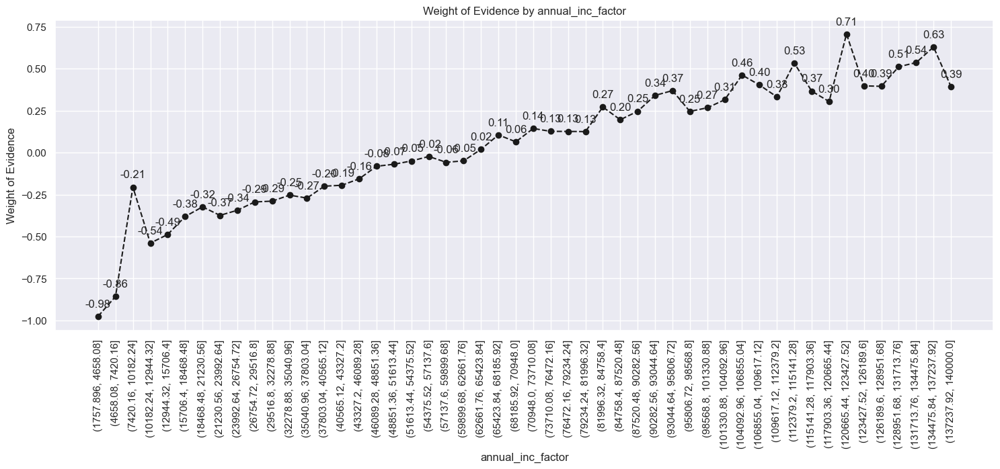

In [184]:
plot_by_woe(df_temp, 90)
# We plot the weight of evidence values.

In [185]:
# WoE is monotonically decreasing with income, so we split income in 10 equal categories, each with width of 15k.
df_inputs_prepr['annual_inc:<20K'] = np.where((df_inputs_prepr['annual_inc'] <= 20000), 1, 0)
df_inputs_prepr['annual_inc:20K-30K'] = np.where((df_inputs_prepr['annual_inc'] > 20000) & (df_inputs_prepr['annual_inc'] <= 30000), 1, 0)
df_inputs_prepr['annual_inc:30K-40K'] = np.where((df_inputs_prepr['annual_inc'] > 30000) & (df_inputs_prepr['annual_inc'] <= 40000), 1, 0)
df_inputs_prepr['annual_inc:40K-50K'] = np.where((df_inputs_prepr['annual_inc'] > 40000) & (df_inputs_prepr['annual_inc'] <= 50000), 1, 0)
df_inputs_prepr['annual_inc:50K-60K'] = np.where((df_inputs_prepr['annual_inc'] > 50000) & (df_inputs_prepr['annual_inc'] <= 60000), 1, 0)
df_inputs_prepr['annual_inc:60K-70K'] = np.where((df_inputs_prepr['annual_inc'] > 60000) & (df_inputs_prepr['annual_inc'] <= 70000), 1, 0)
df_inputs_prepr['annual_inc:70K-80K'] = np.where((df_inputs_prepr['annual_inc'] > 70000) & (df_inputs_prepr['annual_inc'] <= 80000), 1, 0)
df_inputs_prepr['annual_inc:80K-90K'] = np.where((df_inputs_prepr['annual_inc'] > 80000) & (df_inputs_prepr['annual_inc'] <= 90000), 1, 0)
df_inputs_prepr['annual_inc:90K-100K'] = np.where((df_inputs_prepr['annual_inc'] > 90000) & (df_inputs_prepr['annual_inc'] <= 100000), 1, 0)
df_inputs_prepr['annual_inc:100K-120K'] = np.where((df_inputs_prepr['annual_inc'] > 100000) & (df_inputs_prepr['annual_inc'] <= 120000), 1, 0)
df_inputs_prepr['annual_inc:120K-140K'] = np.where((df_inputs_prepr['annual_inc'] > 120000) & (df_inputs_prepr['annual_inc'] <= 140000), 1, 0)
df_inputs_prepr['annual_inc:>140K'] = np.where((df_inputs_prepr['annual_inc'] > 140000), 1, 0)

In [186]:
# mths_since_last_delinq
# We have to create one category for missing values and do fine and coarse classing for the rest.
df_inputs_prepr_temp = df_inputs_prepr[pd.notnull(df_inputs_prepr['mths_since_last_delinq'])]
df_inputs_prepr_temp['mths_since_last_delinq_factor'] = pd.cut(df_inputs_prepr_temp['mths_since_last_delinq'], 50)
df_temp = woe_ordered_continuous(df_inputs_prepr_temp, 'mths_since_last_delinq_factor', df_targets_prepr[df_inputs_prepr_temp.index])
# We calculate weight of evidence.
df_temp

C:\Users\dcgzb\AppData\Local\Temp\ipykernel_10772\1373989647.py:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_inputs_prepr_temp['mths_since_last_delinq_factor'] = pd.cut(df_inputs_prepr_temp['mths_since_last_delinq'], 50)
C:\Users\dcgzb\AppData\Local\Temp\ipykernel_10772\1881610760.py:4: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  df = pd.concat([df.groupby(df.columns.values[0], as_index = False)[df.columns.values[1]].count(),
C:\Users\dcgzb\AppData\Local\Temp\ipykernel_10772\1881610760.py:5: FutureWarning: The default of observed=False is deprecated

,mths_since_last_delinq_factor,n_obs,prop_good,prop_n_obs,n_good,n_bad,prop_n_good,prop_n_bad,WoE,diff_prop_good,diff_WoE,IV
0,"(-0.188, 3.76]",5346,0.872989,0.030945,4667.0,679.0,0.030268,0.036560,-0.188867,NaN,NaN,inf
1,"(3.76, 7.52]",11110,0.887489,0.064309,9860.0,1250.0,0.063948,0.067306,-0.051175,0.014500,0.137692,inf
2,"(7.52, 11.28]",13358,0.894520,0.077321,11949.0,1409.0,0.077496,0.075867,0.021250,0.007031,0.072425,inf
3,"(11.28, 15.04]",13104,0.889728,0.075851,11659.0,1445.0,0.075615,0.077805,-0.028548,0.004792,0.049798,inf
4,"(15.04, 18.8]",9362,0.894040,0.054191,8370.0,992.0,0.054284,0.053414,0.016168,0.004311,0.044717,inf
5,"(18.8, 22.56]",11643,0.894872,0.067394,10419.0,1224.0,0.067573,0.065906,0.024989,0.000833,0.008821,inf
6,"(22.56, 26.32]",10882,0.897813,0.062989,9770.0,1112.0,0.063364,0.059875,0.056639,0.002940,0.031649,inf
7,"(26.32, 30.08]",10584,0.893896,0.061264,9461.0,1123.0,0.061360,0.060467,0.014657,0.003916,0.041982,inf
8,"(30.08, 33.84]",7565,0.900991,0.043789,6816.0,749.0,0.044206,0.040330,0.091772,0.007095,0.077115,inf
9,"(33.84, 37.6]",9710,0.897425,0.056205,8714.0,996.0,0.056515,0.053629,0.052421,0.003566,0.039350,inf


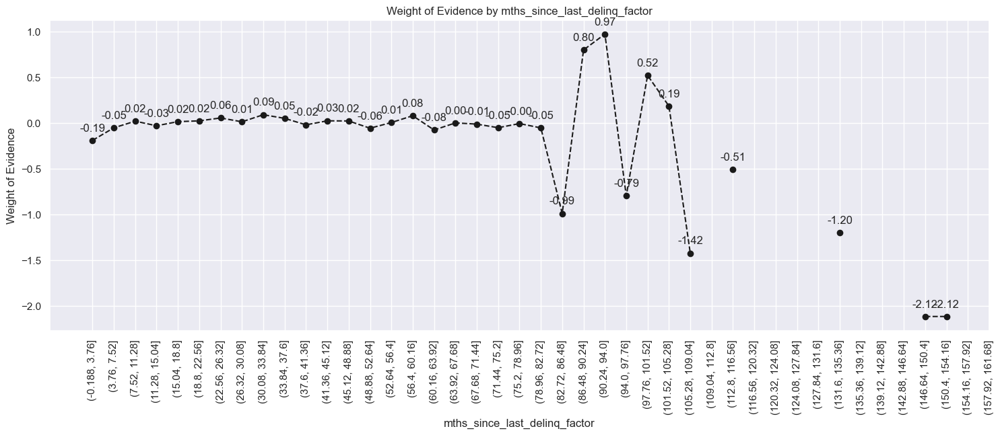

In [187]:
plot_by_woe(df_temp, 90)
# We plot the weight of evidence values.

In [188]:
# Categories: Missing, 0-3, 4-30, 31-56, >=57
df_inputs_prepr['mths_since_last_delinq:Missing'] = np.where((df_inputs_prepr['mths_since_last_delinq'].isnull()), 1, 0)
df_inputs_prepr['mths_since_last_delinq:0-3'] = np.where((df_inputs_prepr['mths_since_last_delinq'] >= 0) & (df_inputs_prepr['mths_since_last_delinq'] <= 3), 1, 0)
df_inputs_prepr['mths_since_last_delinq:4-30'] = np.where((df_inputs_prepr['mths_since_last_delinq'] >= 4) & (df_inputs_prepr['mths_since_last_delinq'] <= 30), 1, 0)
df_inputs_prepr['mths_since_last_delinq:31-56'] = np.where((df_inputs_prepr['mths_since_last_delinq'] >= 31) & (df_inputs_prepr['mths_since_last_delinq'] <= 56), 1, 0)
df_inputs_prepr['mths_since_last_delinq:>=57'] = np.where((df_inputs_prepr['mths_since_last_delinq'] >= 57), 1, 0)

In [189]:
# dti
df_inputs_prepr['dti_factor'] = pd.cut(df_inputs_prepr['dti'], 100)
# Here we do fine-classing: using the 'cut' method, we split the variable into 100 categories by its values.
df_temp = woe_ordered_continuous(df_inputs_prepr, 'dti_factor', df_targets_prepr)
# We calculate weight of evidence.
df_temp

C:\Users\dcgzb\AppData\Local\Temp\ipykernel_10772\1881610760.py:4: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  df = pd.concat([df.groupby(df.columns.values[0], as_index = False)[df.columns.values[1]].count(),
C:\Users\dcgzb\AppData\Local\Temp\ipykernel_10772\1881610760.py:5: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  df.groupby(df.columns.values[0], as_index = False)[df.columns.values[1]].mean()], axis = 1)


,dti_factor,n_obs,prop_good,prop_n_obs,n_good,n_bad,prop_n_good,prop_n_bad,WoE,diff_prop_good,diff_WoE,IV
0,"(-0.04, 0.4]",737,0.879240,0.001976,648.0,89.0,0.001951,0.002180,-0.111180,NaN,NaN,0.029126
1,"(0.4, 0.8]",795,0.915723,0.002131,728.0,67.0,0.002192,0.001641,0.289174,0.036483,0.400354,0.029126
2,"(0.8, 1.2]",926,0.890929,0.002483,825.0,101.0,0.002484,0.002474,0.003829,0.024795,0.285346,0.029126
3,"(1.2, 1.6]",1061,0.901037,0.002844,956.0,105.0,0.002878,0.002572,0.112363,0.010108,0.108535,0.029126
4,"(1.6, 2.0]",1195,0.903766,0.003204,1080.0,115.0,0.003251,0.002817,0.143350,0.002729,0.030987,0.029126
5,"(2.0, 2.399]",1314,0.914003,0.003523,1201.0,113.0,0.003615,0.002768,0.267088,0.010237,0.123738,0.029126
6,"(2.399, 2.799]",1521,0.914530,0.004078,1391.0,130.0,0.004187,0.003184,0.273809,0.000527,0.006722,0.029126
7,"(2.799, 3.199]",1698,0.905771,0.004552,1538.0,160.0,0.004630,0.003919,0.166630,0.008758,0.107179,0.029126
8,"(3.199, 3.599]",1961,0.905150,0.005257,1775.0,186.0,0.005343,0.004556,0.159375,0.000621,0.007255,0.029126
9,"(3.599, 3.999]",2217,0.915201,0.005944,2029.0,188.0,0.006108,0.004605,0.282422,0.010050,0.123047,0.029126


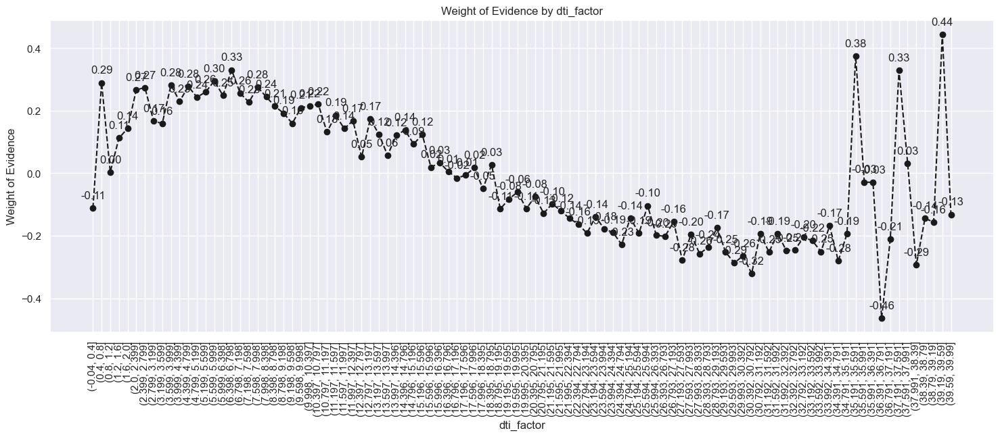

In [191]:
plot_by_woe(df_temp, 90)
# We plot the weight of evidence values.

In [192]:
# Similarly to income, initial examination shows that most values are lower than 200.
# Hence, we are going to have one category for more than 35, and we are going to apply our approach to determine
# the categories of everyone with 150k or less.
df_inputs_prepr_temp = df_inputs_prepr.loc[df_inputs_prepr['dti'] <= 35, : ]

In [193]:
df_inputs_prepr_temp['dti_factor'] = pd.cut(df_inputs_prepr_temp['dti'], 50)
# Here we do fine-classing: using the 'cut' method, we split the variable into 50 categories by its values.
df_temp = woe_ordered_continuous(df_inputs_prepr_temp, 'dti_factor', df_targets_prepr[df_inputs_prepr_temp.index])
# We calculate weight of evidence.
df_temp

C:\Users\dcgzb\AppData\Local\Temp\ipykernel_10772\337294594.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_inputs_prepr_temp['dti_factor'] = pd.cut(df_inputs_prepr_temp['dti'], 50)
C:\Users\dcgzb\AppData\Local\Temp\ipykernel_10772\1881610760.py:4: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  df = pd.concat([df.groupby(df.columns.values[0], as_index = False)[df.columns.values[1]].count(),
C:\Users\dcgzb\AppData\Local\Temp\ipykernel_10772\1881610760.py:5: FutureWarning: The default of observed=False is deprecated and will be changed to True in a futur

,dti_factor,n_obs,prop_good,prop_n_obs,n_good,n_bad,prop_n_good,prop_n_bad,WoE,diff_prop_good,diff_WoE,IV
0,"(-0.035, 0.7]",1348,0.892433,0.003642,1203.0,145.0,0.003649,0.003581,0.019021,NaN,NaN,0.027992
1,"(0.7, 1.4]",1668,0.893885,0.004506,1491.0,177.0,0.004523,0.004371,0.034234,0.001452,0.015213,0.027992
2,"(1.4, 2.1]",2019,0.911838,0.005455,1841.0,178.0,0.005585,0.004395,0.239462,0.017953,0.205228,0.027992
3,"(2.1, 2.8]",2556,0.911972,0.006905,2331.0,225.0,0.007071,0.005556,0.241133,0.000134,0.001672,0.027992
4,"(2.8, 3.5]",3167,0.907799,0.008556,2875.0,292.0,0.008721,0.007210,0.190235,0.004173,0.050898,0.027992
5,"(3.5, 4.2]",3853,0.912276,0.010409,3515.0,338.0,0.010663,0.008346,0.244930,0.004477,0.054695,0.027992
6,"(4.2, 4.9]",4552,0.911907,0.012298,4151.0,401.0,0.012592,0.009902,0.240324,0.000369,0.004606,0.027992
7,"(4.9, 5.6]",5296,0.913142,0.014308,4836.0,460.0,0.014670,0.011359,0.255798,0.001235,0.015474,0.027992
8,"(5.6, 6.3]",5957,0.913715,0.016093,5443.0,514.0,0.016511,0.012692,0.263044,0.000573,0.007246,0.027992
9,"(6.3, 7.0]",6458,0.916692,0.017447,5920.0,538.0,0.017958,0.013285,0.301414,0.002978,0.038371,0.027992


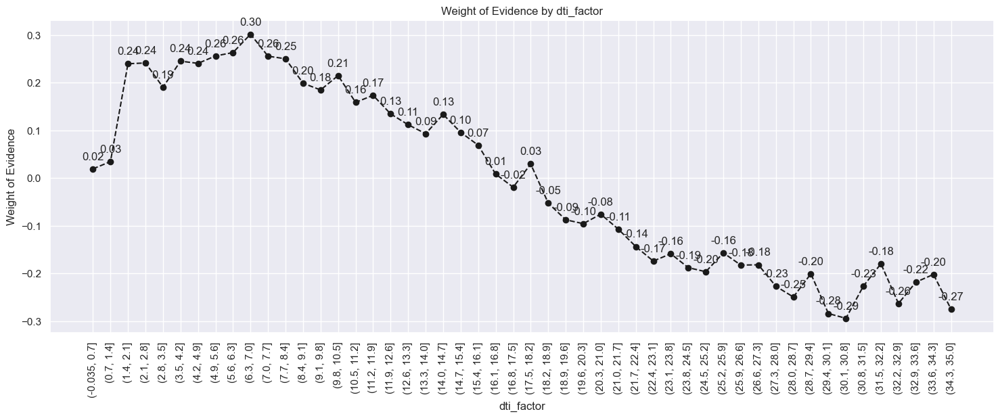

In [194]:
plot_by_woe(df_temp, 90)
# We plot the weight of evidence values.

In [195]:
# Categories:
df_inputs_prepr['dti:<=1.4'] = np.where((df_inputs_prepr['dti'] <= 1.4), 1, 0)
df_inputs_prepr['dti:1.4-3.5'] = np.where((df_inputs_prepr['dti'] > 1.4) & (df_inputs_prepr['dti'] <= 3.5), 1, 0)
df_inputs_prepr['dti:3.5-7.7'] = np.where((df_inputs_prepr['dti'] > 3.5) & (df_inputs_prepr['dti'] <= 7.7), 1, 0)
df_inputs_prepr['dti:7.7-10.5'] = np.where((df_inputs_prepr['dti'] > 7.7) & (df_inputs_prepr['dti'] <= 10.5), 1, 0)
df_inputs_prepr['dti:10.5-16.1'] = np.where((df_inputs_prepr['dti'] > 10.5) & (df_inputs_prepr['dti'] <= 16.1), 1, 0)
df_inputs_prepr['dti:16.1-20.3'] = np.where((df_inputs_prepr['dti'] > 16.1) & (df_inputs_prepr['dti'] <= 20.3), 1, 0)
df_inputs_prepr['dti:20.3-21.7'] = np.where((df_inputs_prepr['dti'] > 20.3) & (df_inputs_prepr['dti'] <= 21.7), 1, 0)
df_inputs_prepr['dti:21.7-22.4'] = np.where((df_inputs_prepr['dti'] > 21.7) & (df_inputs_prepr['dti'] <= 22.4), 1, 0)
df_inputs_prepr['dti:22.4-35'] = np.where((df_inputs_prepr['dti'] > 22.4) & (df_inputs_prepr['dti'] <= 35), 1, 0)
df_inputs_prepr['dti:>35'] = np.where((df_inputs_prepr['dti'] > 35), 1, 0)

C:\Users\dcgzb\AppData\Local\Temp\ipykernel_10772\284476014.py:6: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_inputs_prepr['dti:10.5-16.1'] = np.where((df_inputs_prepr['dti'] > 10.5) & (df_inputs_prepr['dti'] <= 16.1), 1, 0)
C:\Users\dcgzb\AppData\Local\Temp\ipykernel_10772\284476014.py:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_inputs_prepr['dti:16.1-20.3'] = np.where((df_inputs_prepr['dti'] > 16.1) & (df_inputs_prepr['dti'] <= 20.3), 1, 0)
C:\Users\dcgzb\AppData\Local\Temp\ipykernel_10772\284476014.py:8: Performa

In [196]:
# mths_since_last_record
# We have to create one category for missing values and do fine and coarse classing for the rest.
df_inputs_prepr_temp = df_inputs_prepr[pd.notnull(df_inputs_prepr['mths_since_last_record'])]
#sum(loan_data_temp['mths_since_last_record'].isnull())
df_inputs_prepr_temp['mths_since_last_record_factor'] = pd.cut(df_inputs_prepr_temp['mths_since_last_record'], 50)
# Here we do fine-classing: using the 'cut' method, we split the variable into 50 categories by its values.
df_temp = woe_ordered_continuous(df_inputs_prepr_temp, 'mths_since_last_record_factor', df_targets_prepr[df_inputs_prepr_temp.index])
# We calculate weight of evidence.
df_temp

C:\Users\dcgzb\AppData\Local\Temp\ipykernel_10772\3035104871.py:5: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_inputs_prepr_temp['mths_since_last_record_factor'] = pd.cut(df_inputs_prepr_temp['mths_since_last_record'], 50)
C:\Users\dcgzb\AppData\Local\Temp\ipykernel_10772\3035104871.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_inputs_prepr_temp['mths_since_last_record_factor'] = pd.cut(df_inputs_prepr_temp['mths_since_last_record'], 50)
C:\Users\dcgzb\AppData\Local\Temp\ipykernel_10772\1881610760.py:4: 

,mths_since_last_record_factor,n_obs,prop_good,prop_n_obs,n_good,n_bad,prop_n_good,prop_n_bad,WoE,diff_prop_good,diff_WoE,IV
0,"(-0.121, 2.42]",1080,0.762963,0.021518,824.0,256.0,0.018387,0.047610,-0.951397,NaN,NaN,0.083569
1,"(2.42, 4.84]",80,0.887500,0.001594,71.0,9.0,0.001584,0.001674,-0.054935,0.124537,0.896462,0.083569
2,"(4.84, 7.26]",181,0.911602,0.003606,165.0,16.0,0.003682,0.002976,0.212967,0.024102,0.267901,0.083569
3,"(7.26, 9.68]",173,0.913295,0.003447,158.0,15.0,0.003526,0.002790,0.234155,0.001693,0.021188,0.083569
4,"(9.68, 12.1]",284,0.904930,0.005658,257.0,27.0,0.005735,0.005021,0.132849,0.008365,0.101306,0.083569
5,"(12.1, 14.52]",189,0.899471,0.003766,170.0,19.0,0.003793,0.003534,0.070969,0.005459,0.061880,0.083569
6,"(14.52, 16.94]",196,0.923469,0.003905,181.0,15.0,0.004039,0.002790,0.370057,0.023998,0.299087,0.083569
7,"(16.94, 19.36]",332,0.897590,0.006615,298.0,34.0,0.006650,0.006323,0.050343,0.025879,0.319714,0.083569
8,"(19.36, 21.78]",296,0.935811,0.005897,277.0,19.0,0.006181,0.003534,0.559189,0.038220,0.508846,0.083569
9,"(21.78, 24.2]",450,0.900000,0.008966,405.0,45.0,0.009037,0.008369,0.076835,0.035811,0.482354,0.083569


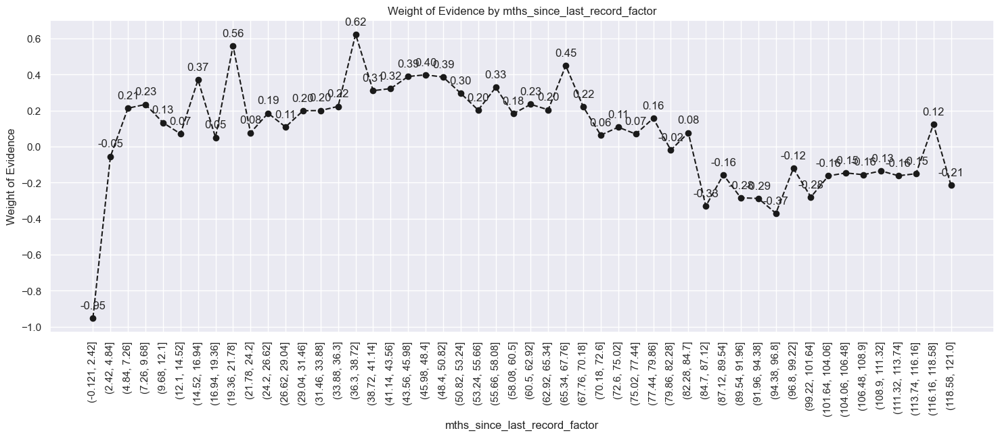

In [197]:
plot_by_woe(df_temp, 90)
# We plot the weight of evidence values.

In [198]:
# Categories: 'Missing', '0-2', '3-20', '21-31', '32-80', '81-86', '>86'
df_inputs_prepr['mths_since_last_record:Missing'] = np.where((df_inputs_prepr['mths_since_last_record'].isnull()), 1, 0)
df_inputs_prepr['mths_since_last_record:0-2'] = np.where((df_inputs_prepr['mths_since_last_record'] >= 0) & (df_inputs_prepr['mths_since_last_record'] <= 2), 1, 0)
df_inputs_prepr['mths_since_last_record:3-20'] = np.where((df_inputs_prepr['mths_since_last_record'] >= 3) & (df_inputs_prepr['mths_since_last_record'] <= 20), 1, 0)
df_inputs_prepr['mths_since_last_record:21-31'] = np.where((df_inputs_prepr['mths_since_last_record'] >= 21) & (df_inputs_prepr['mths_since_last_record'] <= 31), 1, 0)
df_inputs_prepr['mths_since_last_record:32-80'] = np.where((df_inputs_prepr['mths_since_last_record'] >= 32) & (df_inputs_prepr['mths_since_last_record'] <= 80), 1, 0)
df_inputs_prepr['mths_since_last_record:81-86'] = np.where((df_inputs_prepr['mths_since_last_record'] >= 81) & (df_inputs_prepr['mths_since_last_record'] <= 86), 1, 0)
df_inputs_prepr['mths_since_last_record:>86'] = np.where((df_inputs_prepr['mths_since_last_record'] > 86), 1, 0)

C:\Users\dcgzb\AppData\Local\Temp\ipykernel_10772\1059239224.py:2: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_inputs_prepr['mths_since_last_record:Missing'] = np.where((df_inputs_prepr['mths_since_last_record'].isnull()), 1, 0)
C:\Users\dcgzb\AppData\Local\Temp\ipykernel_10772\1059239224.py:3: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_inputs_prepr['mths_since_last_record:0-2'] = np.where((df_inputs_prepr['mths_since_last_record'] >= 0) & (df_inputs_prepr['mths_since_last_record'] <= 2), 1, 0)
C:\Users\dcgzb\AppData\

In [199]:
#####
X_train = df_inputs_prepr
#####
# loan_data_inputs_test = df_inputs_prepr

In [201]:
X_train.to_csv('X_train.csv')
y_train.to_csv('y_train.csv')

#### Preprocessing the Test Dataset

In [202]:
df_inputs_prepr = X_test
df_targets_prepr = y_test

In [203]:
# 'grade'
df_temp = woe_discrete(df_inputs_prepr, 'grade', df_targets_prepr)
# We execute the function we defined with the necessary arguments: a dataframe, a string, and a dataframe.
# We store the result in a dataframe.
df_temp

,grade,n_obs,prop_good,prop_n_obs,n_good,n_bad,prop_n_good,prop_n_bad,WoE,diff_prop_good,diff_WoE,IV
0,G,678,0.690265,0.007271,468.0,210.0,0.005631,0.020706,-1.302119,NaN,NaN,0.286378
1,F,2664,0.757508,0.028568,2018.0,646.0,0.024281,0.063696,-0.964417,0.067242,0.337702,0.286378
2,E,7003,0.808225,0.075098,5660.0,1343.0,0.068103,0.132420,-0.664962,0.050718,0.299455,0.286378
3,D,15350,0.848795,0.164608,13029.0,2321.0,0.156768,0.228850,-0.378300,0.040570,0.286662,0.286378
4,C,25181,0.885072,0.270032,22287.0,2894.0,0.268163,0.285348,-0.062116,0.036277,0.316184,0.286378
5,B,27393,0.922243,0.293752,25263.0,2130.0,0.303971,0.210018,0.369739,0.037171,0.431855,0.286378
6,A,14983,0.960088,0.160672,14385.0,598.0,0.173084,0.058963,1.076871,0.037845,0.707132,0.286378


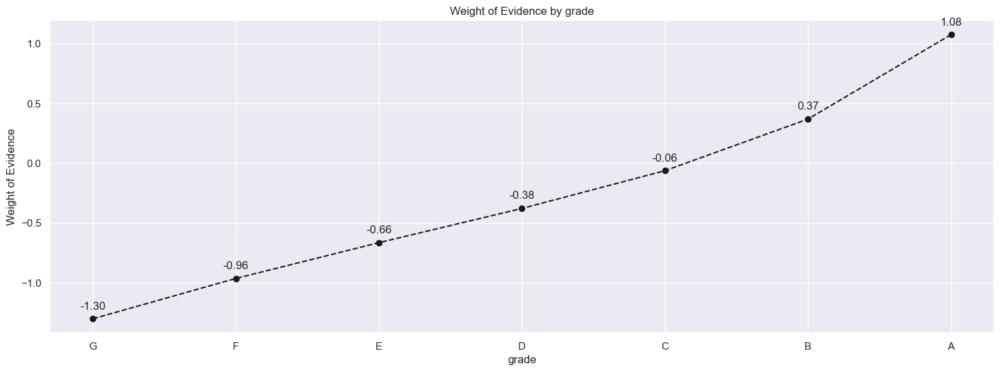

In [204]:
plot_by_woe(df_temp)

In [205]:
# 'home_ownership'
df_temp = woe_discrete(df_inputs_prepr, 'home_ownership', df_targets_prepr)
# We calculate weight of evidence.
df_temp

,home_ownership,n_obs,prop_good,prop_n_obs,n_good,n_bad,prop_n_good,prop_n_bad,WoE,diff_prop_good,diff_WoE,IV
0,NONE,10,0.700000,0.000107,7.0,3.0,0.000084,0.000296,-1.256182,NaN,NaN,inf
1,OTHER,45,0.800000,0.000483,36.0,9.0,0.000433,0.000887,-0.717185,0.100000,0.538997,inf
2,RENT,37747,0.874904,0.404785,33025.0,4722.0,0.397365,0.465589,-0.158447,0.074904,0.558738,inf
3,OWN,8365,0.896832,0.089703,7502.0,863.0,0.090266,0.085092,0.059030,0.021928,0.217478,inf
4,MORTGAGE,47084,0.903470,0.504911,42539.0,4545.0,0.511840,0.448136,0.132914,0.006638,0.073883,inf
5,ANY,1,1.000000,0.000011,1.0,0.0,0.000012,0.000000,inf,0.096530,inf,inf


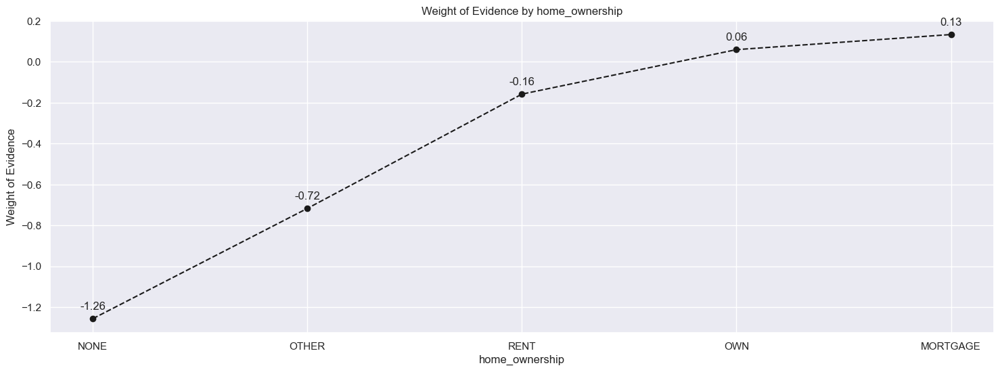

In [206]:
plot_by_woe(df_temp)
# We plot the weight of evidence values.

In [207]:
# There are many categories with very few observations and many categories with very different "good" %.
# Therefore, we create a new discrete variable where we combine some of the categories.
# 'OTHERS' and 'NONE' are riskiest but are very few. 'RENT' is the next riskiest.
# 'ANY' are least risky but are too few. Conceptually, they belong to the same category. Also, their inclusion would not change anything.
# We combine them in one category, 'RENT_OTHER_NONE_ANY'.
# We end up with 3 categories: 'RENT_OTHER_NONE_ANY', 'OWN', 'MORTGAGE'.

df_inputs_prepr['home_ownership:RENT_OTHER_NONE_ANY'] = sum([df_inputs_prepr['home_ownership:RENT'], df_inputs_prepr['home_ownership:OTHER'],
                                                      df_inputs_prepr['home_ownership:NONE'],df_inputs_prepr['home_ownership:ANY']])
# 'RENT_OTHER_NONE_ANY' will be the reference category.

# Alternatively:
#loan_data.loc['home_ownership' in ['RENT', 'OTHER', 'NONE', 'ANY'], 'home_ownership:RENT_OTHER_NONE_ANY'] = 1
#loan_data.loc['home_ownership' not in ['RENT', 'OTHER', 'NONE', 'ANY'], 'home_ownership:RENT_OTHER_NONE_ANY'] = 0
#loan_data.loc['loan_status' not in ['OWN'], 'home_ownership:OWN'] = 1
#loan_data.loc['loan_status' not in ['OWN'], 'home_ownership:OWN'] = 0
#loan_data.loc['loan_status' not in ['MORTGAGE'], 'home_ownership:MORTGAGE'] = 1
#loan_data.loc['loan_status' not in ['MORTGAGE'], 'home_ownership:MORTGAGE'] = 0

In [208]:
# 'addr_state'
df_inputs_prepr['addr_state'].unique()

array(['VA', 'HI', 'CO', 'OH', 'TX', 'WA', 'NC', 'CA', 'MA', 'IL', 'GA',
       'KY', 'IN', 'MD', 'FL', 'UT', 'NJ', 'LA', 'NY', 'NH', 'TN', 'WV',
       'OR', 'MN', 'AZ', 'WI', 'CT', 'PA', 'MI', 'MT', 'NM', 'MO', 'DC',
       'AL', 'OK', 'NV', 'SC', 'KS', 'SD', 'AK', 'WY', 'RI', 'AR', 'VT',
       'DE', 'MS', 'IA', 'ME', 'ID', 'NE'], dtype=object)

In [209]:
print("The total unique states are:\t", len(df_inputs_prepr['addr_state'].unique()))

The total unique states are:	 50


In [210]:
df_temp = woe_discrete(df_inputs_prepr, 'addr_state', df_targets_prepr)
# We calculate weight of evidence.
df_temp

F:\anaconda3\envs\Udemycreditriskmodel\lib\site-packages\pandas\core\arraylike.py:396: RuntimeWarning: divide by zero encountered in log
  result = getattr(ufunc, method)(*inputs, **kwargs)


,addr_state,n_obs,prop_good,prop_n_obs,n_good,n_bad,prop_n_good,prop_n_bad,WoE,diff_prop_good,diff_WoE,IV
0,NE,2,0.000000,0.000021,0.0,2.0,0.000000,0.000197,-inf,NaN,NaN,inf
1,ID,3,0.666667,0.000032,2.0,1.0,0.000024,0.000099,-1.410333,0.666667,inf,inf
2,DE,247,0.858300,0.002649,212.0,35.0,0.002551,0.003451,-0.302242,0.191633,1.108091,inf
3,NV,1316,0.864742,0.014112,1138.0,178.0,0.013693,0.017551,-0.248236,0.006442,0.054006,inf
4,FL,6277,0.873666,0.067312,5484.0,793.0,0.065985,0.078190,-0.169713,0.008924,0.078523,inf
5,AL,1106,0.878843,0.011860,972.0,134.0,0.011695,0.013212,-0.121964,0.005177,0.047749,inf
6,MI,2280,0.878947,0.024450,2004.0,276.0,0.024113,0.027214,-0.120980,0.000105,0.000984,inf
7,MO,1471,0.880354,0.015774,1295.0,176.0,0.015582,0.017354,-0.107698,0.001406,0.013282,inf
8,NY,8122,0.883649,0.087097,7177.0,945.0,0.086355,0.093177,-0.076028,0.003296,0.031670,inf
9,LA,1133,0.885260,0.012150,1003.0,130.0,0.012068,0.012818,-0.060263,0.001611,0.015765,inf


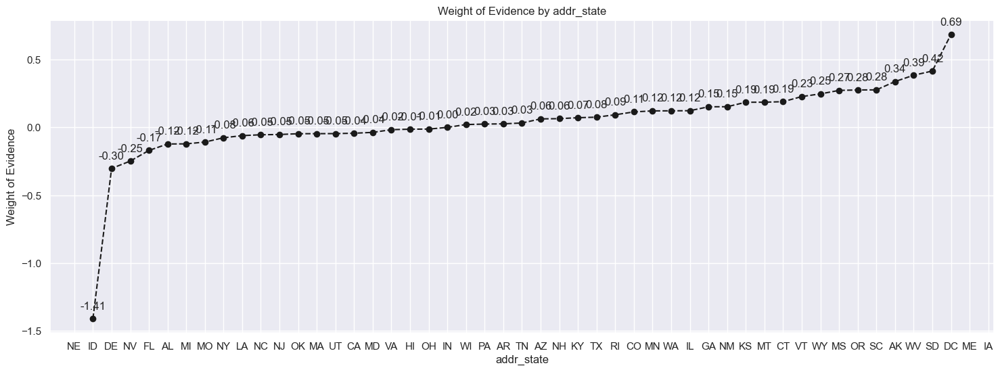

In [211]:
plot_by_woe(df_temp)
# We plot the weight of evidence values.

In [212]:
if ['addr_state:ND'] in df_inputs_prepr.columns.values:
    pass
else:
    df_inputs_prepr['addr_state:ND'] = 0

In [213]:
df_temp.iloc[2: -2, : ]

,addr_state,n_obs,prop_good,prop_n_obs,n_good,n_bad,prop_n_good,prop_n_bad,WoE,diff_prop_good,diff_WoE,IV
2,DE,247,0.858300,0.002649,212.0,35.0,0.002551,0.003451,-0.302242,0.191633,1.108091,inf
3,NV,1316,0.864742,0.014112,1138.0,178.0,0.013693,0.017551,-0.248236,0.006442,0.054006,inf
4,FL,6277,0.873666,0.067312,5484.0,793.0,0.065985,0.078190,-0.169713,0.008924,0.078523,inf
5,AL,1106,0.878843,0.011860,972.0,134.0,0.011695,0.013212,-0.121964,0.005177,0.047749,inf
6,MI,2280,0.878947,0.024450,2004.0,276.0,0.024113,0.027214,-0.120980,0.000105,0.000984,inf
7,MO,1471,0.880354,0.015774,1295.0,176.0,0.015582,0.017354,-0.107698,0.001406,0.013282,inf
8,NY,8122,0.883649,0.087097,7177.0,945.0,0.086355,0.093177,-0.076028,0.003296,0.031670,inf
9,LA,1133,0.885260,0.012150,1003.0,130.0,0.012068,0.012818,-0.060263,0.001611,0.015765,inf
10,NC,2498,0.885909,0.026788,2213.0,285.0,0.026627,0.028101,-0.053865,0.000648,0.006399,inf
11,NJ,3749,0.886103,0.040203,3322.0,427.0,0.039971,0.042102,-0.051942,0.000194,0.001923,inf


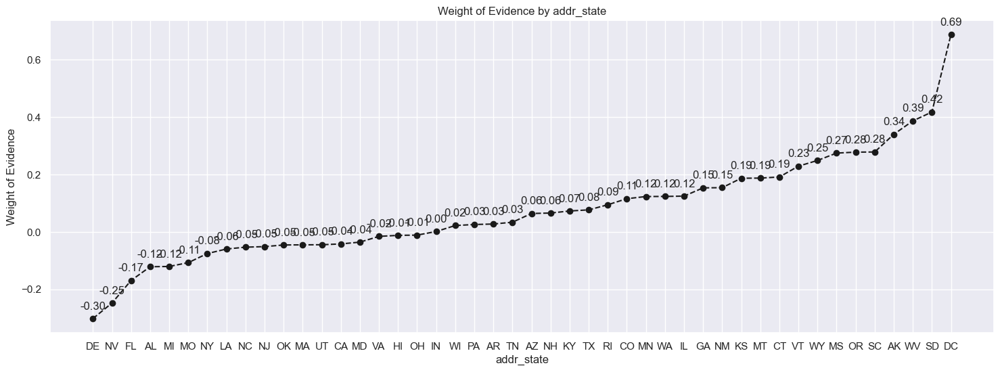

In [214]:
plot_by_woe(df_temp.iloc[2: -2, : ])
# We plot the weight of evidence values.

In [215]:
df_temp.iloc[6: -6, : ]

,addr_state,n_obs,prop_good,prop_n_obs,n_good,n_bad,prop_n_good,prop_n_bad,WoE,diff_prop_good,diff_WoE,IV
6,MI,2280,0.878947,0.024450,2004.0,276.0,0.024113,0.027214,-0.120980,0.000105,0.000984,inf
7,MO,1471,0.880354,0.015774,1295.0,176.0,0.015582,0.017354,-0.107698,0.001406,0.013282,inf
8,NY,8122,0.883649,0.087097,7177.0,945.0,0.086355,0.093177,-0.076028,0.003296,0.031670,inf
9,LA,1133,0.885260,0.012150,1003.0,130.0,0.012068,0.012818,-0.060263,0.001611,0.015765,inf
10,NC,2498,0.885909,0.026788,2213.0,285.0,0.026627,0.028101,-0.053865,0.000648,0.006399,inf
11,NJ,3749,0.886103,0.040203,3322.0,427.0,0.039971,0.042102,-0.051942,0.000194,0.001923,inf
12,OK,856,0.886682,0.009179,759.0,97.0,0.009132,0.009564,-0.046189,0.000579,0.005753,inf
13,MA,2260,0.886726,0.024235,2004.0,256.0,0.024113,0.025242,-0.045757,0.000043,0.000432,inf
14,UT,680,0.886765,0.007292,603.0,77.0,0.007255,0.007592,-0.045368,0.000039,0.000389,inf
15,CA,14236,0.887047,0.152662,12628.0,1608.0,0.151943,0.158549,-0.042554,0.000282,0.002814,inf


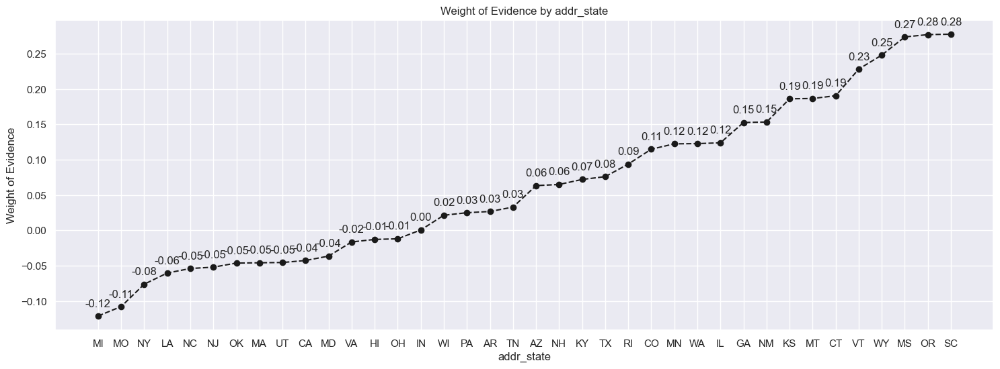

In [216]:
plot_by_woe(df_temp.iloc[6: -6, : ])
# We plot the weight of evidence values.

In [218]:
# We create the following categories:
# 'ND' 'NE' 'IA' NV' 'FL' 'HI' 'AL'
# 'NM' 'VA'
# 'NY'
# 'OK' 'TN' 'MO' 'LA' 'MD' 'NC'
# 'CA'
# 'UT' 'KY' 'AZ' 'NJ'
# 'AR' 'MI' 'PA' 'OH' 'MN'
# 'RI' 'MA' 'DE' 'SD' 'IN'
# 'GA' 'WA' 'OR'
# 'WI' 'MT'
# 'TX'
# 'IL' 'CT'
# 'KS' 'SC' 'CO' 'VT' 'AK' 'MS'
# 'WV' 'NH' 'WY' 'DC' 'ME' 'ID'

# 'IA_NV_HI_ID_AL_FL' will be the reference category.

df_inputs_prepr['addr_state:ND_NE_IA_NV_FL_HI_AL'] = sum([df_inputs_prepr['addr_state:ND'], df_inputs_prepr['addr_state:NE'],
                                              df_inputs_prepr['addr_state:IA'], df_inputs_prepr['addr_state:NV'],
                                              df_inputs_prepr['addr_state:FL'], df_inputs_prepr['addr_state:HI'],
                                                          df_inputs_prepr['addr_state:AL']])

df_inputs_prepr['addr_state:NM_VA'] = sum([df_inputs_prepr['addr_state:NM'], df_inputs_prepr['addr_state:VA']])

df_inputs_prepr['addr_state:OK_TN_MO_LA_MD_NC'] = sum([df_inputs_prepr['addr_state:OK'], df_inputs_prepr['addr_state:TN'],
                                              df_inputs_prepr['addr_state:MO'], df_inputs_prepr['addr_state:LA'],
                                              df_inputs_prepr['addr_state:MD'], df_inputs_prepr['addr_state:NC']])

df_inputs_prepr['addr_state:UT_KY_AZ_NJ'] = sum([df_inputs_prepr['addr_state:UT'], df_inputs_prepr['addr_state:KY'],
                                              df_inputs_prepr['addr_state:AZ'], df_inputs_prepr['addr_state:NJ']])

df_inputs_prepr['addr_state:AR_MI_PA_OH_MN'] = sum([df_inputs_prepr['addr_state:AR'], df_inputs_prepr['addr_state:MI'],
                                              df_inputs_prepr['addr_state:PA'], df_inputs_prepr['addr_state:OH'],
                                              df_inputs_prepr['addr_state:MN']])

df_inputs_prepr['addr_state:RI_MA_DE_SD_IN'] = sum([df_inputs_prepr['addr_state:RI'], df_inputs_prepr['addr_state:MA'],
                                              df_inputs_prepr['addr_state:DE'], df_inputs_prepr['addr_state:SD'],
                                              df_inputs_prepr['addr_state:IN']])

df_inputs_prepr['addr_state:GA_WA_OR'] = sum([df_inputs_prepr['addr_state:GA'], df_inputs_prepr['addr_state:WA'],
                                              df_inputs_prepr['addr_state:OR']])

df_inputs_prepr['addr_state:WI_MT'] = sum([df_inputs_prepr['addr_state:WI'], df_inputs_prepr['addr_state:MT']])

df_inputs_prepr['addr_state:IL_CT'] = sum([df_inputs_prepr['addr_state:IL'], df_inputs_prepr['addr_state:CT']])

df_inputs_prepr['addr_state:KS_SC_CO_VT_AK_MS'] = sum([df_inputs_prepr['addr_state:KS'], df_inputs_prepr['addr_state:SC'],
                                              df_inputs_prepr['addr_state:CO'], df_inputs_prepr['addr_state:VT'],
                                              df_inputs_prepr['addr_state:AK'], df_inputs_prepr['addr_state:MS']])

df_inputs_prepr['addr_state:WV_NH_WY_DC_ME_ID'] = sum([df_inputs_prepr['addr_state:WV'], df_inputs_prepr['addr_state:NH'],
                                              df_inputs_prepr['addr_state:WY'], df_inputs_prepr['addr_state:DC'],
                                              df_inputs_prepr['addr_state:ME'], df_inputs_prepr['addr_state:ID']])

In [219]:
# 'verification_status'
df_temp = woe_discrete(df_inputs_prepr, 'verification_status', df_targets_prepr)
# We calculate weight of evidence.
df_temp

,verification_status,n_obs,prop_good,prop_n_obs,n_good,n_bad,prop_n_good,prop_n_bad,WoE,diff_prop_good,diff_WoE,IV
0,Verified,33576,0.872736,0.360057,29303.0,4273.0,0.352581,0.421317,-0.178106,NaN,NaN,0.021851
1,Source Verified,30067,0.896764,0.322427,26963.0,3104.0,0.324425,0.306054,0.058294,0.024027,0.236400,0.021851
2,Not Verified,29609,0.906616,0.317516,26844.0,2765.0,0.322994,0.272629,0.169522,0.009852,0.111228,0.021851


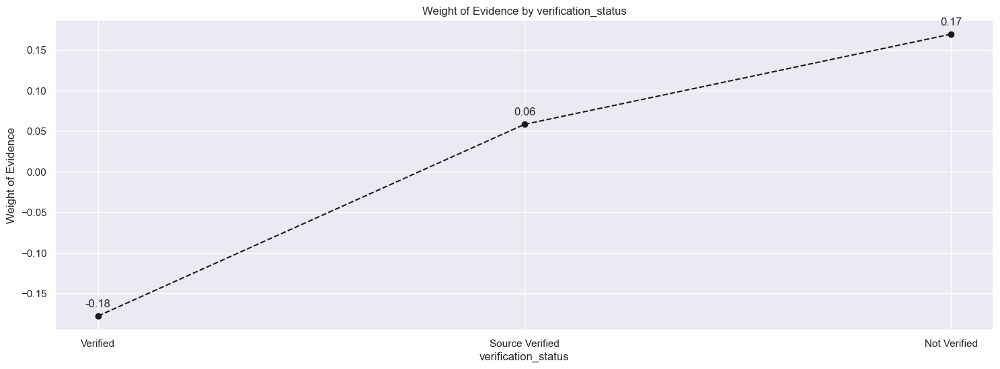

In [220]:
plot_by_woe(df_temp)
# We plot the weight of evidence values.

In [221]:
# 'purpose'
df_temp = woe_discrete(df_inputs_prepr, 'purpose', df_targets_prepr)
# We calculate weight of evidence.
df_temp

,purpose,n_obs,prop_good,prop_n_obs,n_good,n_bad,prop_n_good,prop_n_bad,WoE,diff_prop_good,diff_WoE,IV
0,educational,90,0.744444,0.000965,67.0,23.0,0.000806,0.002268,-1.034281,NaN,NaN,0.034996
1,small_business,1396,0.786533,0.014970,1098.0,298.0,0.013211,0.029383,-0.799328,0.042089,0.234954,0.034996
2,renewable_energy,63,0.825397,0.000676,52.0,11.0,0.000626,0.001085,-0.550131,0.038864,0.249196,0.034996
3,moving,612,0.841503,0.006563,515.0,97.0,0.006197,0.009564,-0.434024,0.016106,0.116107,0.034996
4,house,474,0.860759,0.005083,408.0,66.0,0.004909,0.006508,-0.281867,0.019256,0.152157,0.034996
5,other,4683,0.863549,0.050219,4044.0,639.0,0.048658,0.063005,-0.258395,0.002790,0.023473,0.034996
6,vacation,500,0.864000,0.005362,432.0,68.0,0.005198,0.006705,-0.254562,0.000451,0.003833,0.034996
7,medical,923,0.869989,0.009898,803.0,120.0,0.009662,0.011832,-0.202617,0.005989,0.051945,0.034996
8,wedding,454,0.878855,0.004869,399.0,55.0,0.004801,0.005423,-0.121852,0.008865,0.080765,0.034996
9,debt_consolidation,54991,0.888418,0.589703,48855.0,6136.0,0.587835,0.605009,-0.028796,0.009563,0.093055,0.034996


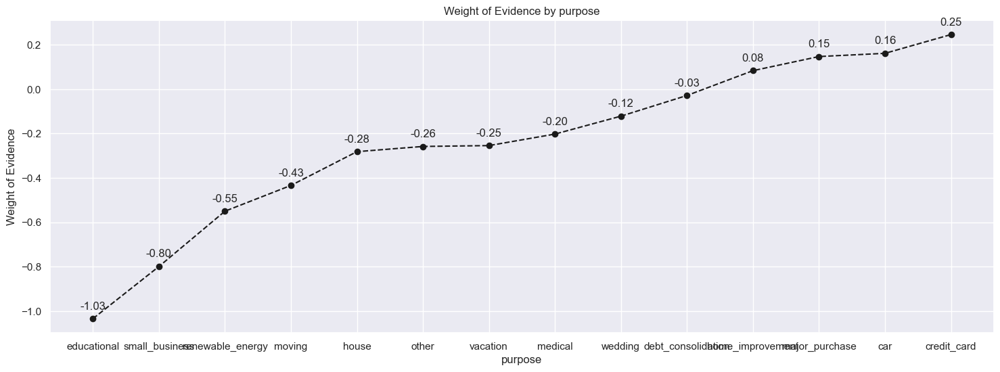

In [222]:
plot_by_woe(df_temp)
# We plot the weight of evidence values.

In [223]:
# We combine 'educational', 'small_business', 'wedding', 'renewable_energy', 'moving', 'house' in one category: 'educ__sm_b__wedd__ren_en__mov__house'.
# We combine 'other', 'medical', 'vacation' in one category: 'oth__med__vacation'.
# We combine 'major_purchase', 'car', 'home_improvement' in one category: 'major_purch__car__home_impr'.
# We leave 'debt_consolidtion' in a separate category.
# We leave 'credit_card' in a separate category.
# 'educ__sm_b__wedd__ren_en__mov__house' will be the reference category.
df_inputs_prepr['purpose:educ__sm_b__wedd__ren_en__mov__house'] = sum([df_inputs_prepr['purpose:educational'], df_inputs_prepr['purpose:small_business'],
                                                                 df_inputs_prepr['purpose:wedding'], df_inputs_prepr['purpose:renewable_energy'],
                                                                 df_inputs_prepr['purpose:moving'], df_inputs_prepr['purpose:house']])
df_inputs_prepr['purpose:oth__med__vacation'] = sum([df_inputs_prepr['purpose:other'], df_inputs_prepr['purpose:medical'],
                                             df_inputs_prepr['purpose:vacation']])
df_inputs_prepr['purpose:major_purch__car__home_impr'] = sum([df_inputs_prepr['purpose:major_purchase'], df_inputs_prepr['purpose:car'],
                                                        df_inputs_prepr['purpose:home_improvement']])

In [224]:
# 'initial_list_status'
df_temp = woe_discrete(df_inputs_prepr, 'initial_list_status', df_targets_prepr)
df_temp

,initial_list_status,n_obs,prop_good,prop_n_obs,n_good,n_bad,prop_n_good,prop_n_bad,WoE,diff_prop_good,diff_WoE,IV
0,f,60440,0.880146,0.648136,53196.0,7244.0,0.640067,0.714258,-0.109670,NaN,NaN,0.025261
1,w,32812,0.911679,0.351864,29914.0,2898.0,0.359933,0.285742,0.230826,0.031533,0.340496,0.025261


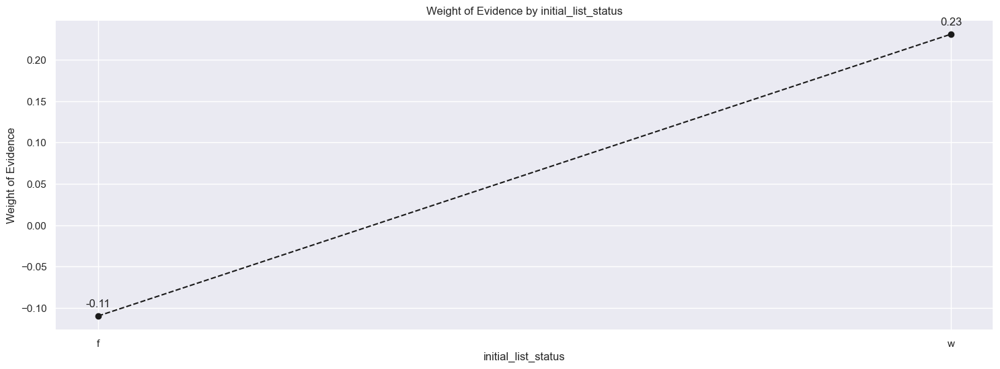

In [225]:
plot_by_woe(df_temp)
# We plot the weight of evidence values.

In [226]:
# WoE function for ordered discrete and continuous variables
def woe_ordered_continuous(df, OC_variabe_name, good_bad_variable_df):
    df = pd.concat([df[OC_variabe_name], good_bad_variable_df], axis = 1)
    df = pd.concat([df.groupby(df.columns.values[0], as_index = False)[df.columns.values[1]].count(),
                    df.groupby(df.columns.values[0], as_index = False)[df.columns.values[1]].mean()], axis = 1)
    df = df.iloc[:, [0, 1, 3]]
    df.columns = [df.columns.values[0], 'n_obs', 'prop_good']
    df['prop_n_obs'] = df['n_obs'] / df['n_obs'].sum()
    df['n_good'] = df['prop_good'] * df['n_obs']
    df['n_bad'] = (1 - df['prop_good']) * df['n_obs']
    df['prop_n_good'] = df['n_good'] / df['n_good'].sum()
    df['prop_n_bad'] = df['n_bad'] / df['n_bad'].sum()
    df['WoE'] = np.log(df['prop_n_good'] / df['prop_n_bad'])
    df['diff_prop_good'] = df['prop_good'].diff().abs()
    df['diff_WoE'] = df['WoE'].diff().abs()
    df['IV'] = (df['prop_n_good'] - df['prop_n_bad']) * df['WoE']
    df['IV'] = df['IV'].sum()
    return df
# Here we define a function similar to the one above, ...
# ... with one slight difference: we order the results by the values of a different column.
# The function takes 3 arguments: a dataframe, a string, and a dataframe. The function returns a dataframe as a result.

In [227]:
# term
df_inputs_prepr['term_int'].unique()
# There are only two unique values, 36 and 60.

array([36, 60], dtype=int64)

In [228]:
df_temp = woe_ordered_continuous(df_inputs_prepr, 'term_int', df_targets_prepr)
# We calculate weight of evidence.
df_temp

,term_int,n_obs,prop_good,prop_n_obs,n_good,n_bad,prop_n_good,prop_n_bad,WoE,diff_prop_good,diff_WoE,IV
0,36,67612,0.903020,0.725046,61055.0,6557.0,0.734629,0.646519,0.127762,NaN,NaN,0.036518
1,60,25640,0.860179,0.274954,22055.0,3585.0,0.265371,0.353481,-0.286699,0.042841,0.414461,0.036518


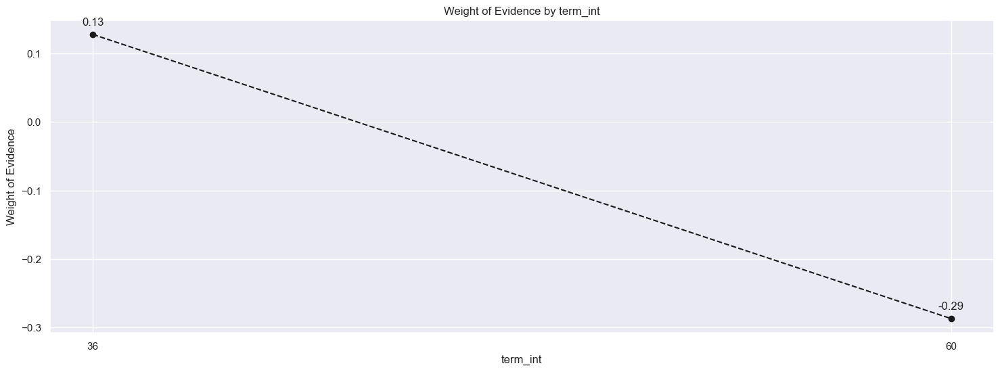

In [229]:
plot_by_woe(df_temp)
# We plot the weight of evidence values.

In [230]:
# Leave as is.
# '60' will be the reference category.
df_inputs_prepr['term:36'] = np.where((df_inputs_prepr['term_int'] == 36), 1, 0)
df_inputs_prepr['term:60'] = np.where((df_inputs_prepr['term_int'] == 60), 1, 0)

In [231]:
# emp_length_int
df_inputs_prepr['emp_length_int'].unique()
# Has only 11 levels: from 0 to 10. Hence, we turn it into a factor with 11 levels.

array([10,  0,  8,  2,  6,  1,  4,  3,  7,  5,  9], dtype=int64)

In [232]:
df_temp = woe_ordered_continuous(df_inputs_prepr, 'emp_length_int', df_targets_prepr)
# We calculate weight of evidence.
df_temp

,emp_length_int,n_obs,prop_good,prop_n_obs,n_good,n_bad,prop_n_good,prop_n_bad,WoE,diff_prop_good,diff_WoE,IV
0,0,11394,0.879147,0.122185,10017.0,1377.0,0.120527,0.135772,-0.119103,NaN,NaN,0.006527
1,1,5963,0.891833,0.063945,5318.0,645.0,0.063987,0.063597,0.006122,0.012686,0.125226,0.006527
2,2,8185,0.889554,0.087773,7281.0,904.0,0.087607,0.089134,-0.017286,0.002279,0.023408,0.006527
3,3,7321,0.887310,0.078508,6496.0,825.0,0.078161,0.081345,-0.039921,0.002244,0.022636,0.006527
4,4,5501,0.890929,0.058991,4901.0,600.0,0.058970,0.059160,-0.003215,0.003618,0.036706,0.006527
5,5,6185,0.885691,0.066326,5478.0,707.0,0.065913,0.069710,-0.056015,0.005238,0.052800,0.006527
6,6,5131,0.877802,0.055023,4504.0,627.0,0.054193,0.061822,-0.131705,0.007890,0.075690,0.006527
7,7,5319,0.890393,0.057039,4736.0,583.0,0.056985,0.057484,-0.008719,0.012591,0.122986,0.006527
8,8,4417,0.887933,0.047366,3922.0,495.0,0.047190,0.048807,-0.033681,0.002460,0.024962,0.006527
9,9,3531,0.895497,0.037865,3162.0,369.0,0.038046,0.036383,0.044684,0.007564,0.078364,0.006527


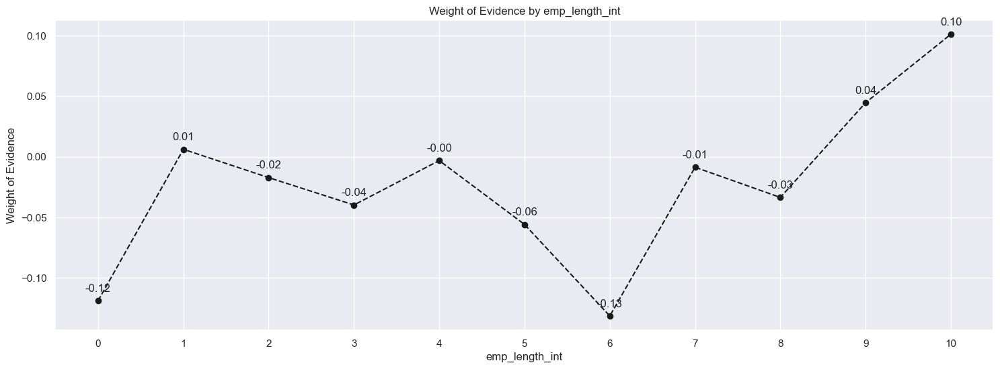

In [233]:
plot_by_woe(df_temp)
# We plot the weight of evidence values.

In [234]:
# We create the following categories: '0', '1', '2 - 4', '5 - 6', '7 - 9', '10'
# '0' will be the reference category
df_inputs_prepr['emp_length:0'] = np.where(df_inputs_prepr['emp_length_int'].isin([0]), 1, 0)
df_inputs_prepr['emp_length:1'] = np.where(df_inputs_prepr['emp_length_int'].isin([1]), 1, 0)
df_inputs_prepr['emp_length:2-4'] = np.where(df_inputs_prepr['emp_length_int'].isin(range(2, 5)), 1, 0)
df_inputs_prepr['emp_length:5-6'] = np.where(df_inputs_prepr['emp_length_int'].isin(range(5, 7)), 1, 0)
df_inputs_prepr['emp_length:7-9'] = np.where(df_inputs_prepr['emp_length_int'].isin(range(7, 10)), 1, 0)
df_inputs_prepr['emp_length:10'] = np.where(df_inputs_prepr['emp_length_int'].isin([10]), 1, 0)

In [235]:
df_inputs_prepr['mths_since_issue_d'].unique()

array([ 48,  50,  52,  53,  43,  56,  44,  37,  45,  41,  38,  49,  40,
        92,  61,  88,  46,  65,  55,  47,  66,  67,  59,  78,  79,  71,
        72,  42,  51,  84,  81, 114,  58,  63,  39,  36,  57,  75,  74,
        60,  54,  96,  69,  95,  68,  62, 116,  83,  77,  70, 118,  85,
        64,  76,  87,  86,  80,  98, 105,  99,  97,  91,  89, 102,  90,
       107,  93,  73,  82, 108, 106,  94, 104, 100, 101, 109, 124, 125,
       103, 117, 113, 122, 115, 111, 112, 110, 123, 119, 121, 120],
      dtype=int64)

In [236]:
df_inputs_prepr['mths_since_issue_d_factor'] = pd.cut(df_inputs_prepr['mths_since_issue_d'], 50)
# Here we do fine-classing: using the 'cut' method, we split the variable into 50 categories by its values.

In [237]:
df_inputs_prepr['mths_since_issue_d_factor']

53955      (46.68, 48.46]
73769      (48.46, 50.24]
101802     (50.24, 52.02]
122556      (52.02, 53.8]
390263     (41.34, 43.12]
               ...       
269680     (37.78, 39.56]
242227    (35.911, 37.78]
333181     (39.56, 41.34]
211785     (64.48, 66.26]
401723      (43.12, 44.9]
Name: mths_since_issue_d_factor, Length: 93252, dtype: category
Categories (50, interval[float64, right]): [(35.911, 37.78] < (37.78, 39.56] < (39.56, 41.34] < (41.34, 43.12] ... (117.88, 119.66] < (119.66, 121.44] < (121.44, 123.22] < (123.22, 125.0]]

In [238]:
# mths_since_issue_d
df_temp = woe_ordered_continuous(df_inputs_prepr, 'mths_since_issue_d_factor', df_targets_prepr)
# We calculate weight of evidence.
df_temp

C:\Users\dcgzb\AppData\Local\Temp\ipykernel_10772\1881610760.py:4: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  df = pd.concat([df.groupby(df.columns.values[0], as_index = False)[df.columns.values[1]].count(),
C:\Users\dcgzb\AppData\Local\Temp\ipykernel_10772\1881610760.py:5: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  df.groupby(df.columns.values[0], as_index = False)[df.columns.values[1]].mean()], axis = 1)


,mths_since_issue_d_factor,n_obs,prop_good,prop_n_obs,n_good,n_bad,prop_n_good,prop_n_bad,WoE,diff_prop_good,diff_WoE,IV
0,"(35.911, 37.78]",7065,0.939844,0.075762,6640.0,425.0,0.079894,0.041905,0.645298,NaN,NaN,0.108994
1,"(37.78, 39.56]",9826,0.930083,0.105370,9139.0,687.0,0.109963,0.067738,0.484492,0.009761,0.160806,0.108994
2,"(39.56, 41.34]",9625,0.913558,0.103215,8793.0,832.0,0.105800,0.082035,0.254399,0.016525,0.230093,0.108994
3,"(41.34, 43.12]",7332,0.908620,0.078626,6662.0,670.0,0.080159,0.066062,0.193417,0.004939,0.060981,0.108994
4,"(43.12, 44.9]",3795,0.904348,0.040696,3432.0,363.0,0.041295,0.035792,0.143016,0.004272,0.050402,0.108994
5,"(44.9, 46.68]",6478,0.902285,0.069468,5845.0,633.0,0.070328,0.062414,0.119392,0.002063,0.023624,0.108994
6,"(46.68, 48.46]",6139,0.902916,0.065832,5543.0,596.0,0.066695,0.058766,0.126571,0.000631,0.007179,0.108994
7,"(48.46, 50.24]",5830,0.885077,0.062519,5160.0,670.0,0.062086,0.066062,-0.062066,0.017839,0.188636,0.108994
8,"(50.24, 52.02]",5066,0.881958,0.054326,4468.0,598.0,0.053760,0.058963,-0.092374,0.003119,0.030309,0.108994
9,"(52.02, 53.8]",2314,0.874244,0.024814,2023.0,291.0,0.024341,0.028693,-0.164466,0.007714,0.072092,0.108994


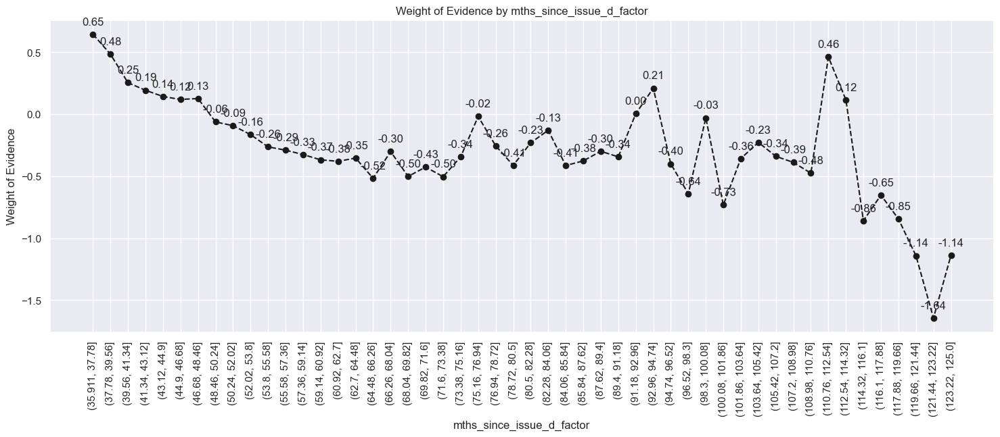

In [239]:
plot_by_woe(df_temp, 90)
# We plot the weight of evidence values.
# We have to rotate the labels because we cannot read them otherwise.

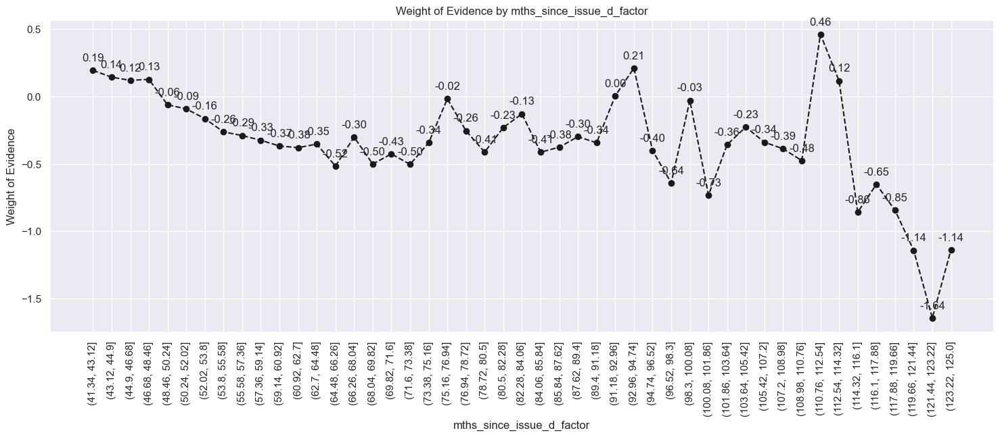

In [240]:
plot_by_woe(df_temp.iloc[3: , : ], 90)
# We plot the weight of evidence values.

In [241]:
# We create the following categories:
# < 38, 38 - 39, 40 - 41, 42 - 48, 49 - 52, 53 - 64, 65 - 84, > 84.
df_inputs_prepr['mths_since_issue_d:<38'] = np.where(df_inputs_prepr['mths_since_issue_d'].isin(range(38)), 1, 0)
df_inputs_prepr['mths_since_issue_d:38-39'] = np.where(df_inputs_prepr['mths_since_issue_d'].isin(range(38, 40)), 1, 0)
df_inputs_prepr['mths_since_issue_d:40-41'] = np.where(df_inputs_prepr['mths_since_issue_d'].isin(range(40, 42)), 1, 0)
df_inputs_prepr['mths_since_issue_d:42-48'] = np.where(df_inputs_prepr['mths_since_issue_d'].isin(range(42, 49)), 1, 0)
df_inputs_prepr['mths_since_issue_d:49-52'] = np.where(df_inputs_prepr['mths_since_issue_d'].isin(range(49, 53)), 1, 0)
df_inputs_prepr['mths_since_issue_d:53-64'] = np.where(df_inputs_prepr['mths_since_issue_d'].isin(range(53, 65)), 1, 0)
df_inputs_prepr['mths_since_issue_d:65-84'] = np.where(df_inputs_prepr['mths_since_issue_d'].isin(range(65, 85)), 1, 0)
df_inputs_prepr['mths_since_issue_d:>84'] = np.where(df_inputs_prepr['mths_since_issue_d'].isin(range(85, int(df_inputs_prepr['mths_since_issue_d'].max()))), 1, 0)

In [242]:
# int_rate
df_inputs_prepr['int_rate_factor'] = pd.cut(df_inputs_prepr['int_rate'], 50)
# Here we do fine-classing: using the 'cut' method, we split the variable into 50 categories by its values.

In [243]:
df_temp = woe_ordered_continuous(df_inputs_prepr, 'int_rate_factor', df_targets_prepr)
# We calculate weight of evidence.
df_temp

C:\Users\dcgzb\AppData\Local\Temp\ipykernel_10772\1881610760.py:4: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  df = pd.concat([df.groupby(df.columns.values[0], as_index = False)[df.columns.values[1]].count(),
C:\Users\dcgzb\AppData\Local\Temp\ipykernel_10772\1881610760.py:5: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  df.groupby(df.columns.values[0], as_index = False)[df.columns.values[1]].mean()], axis = 1)


,int_rate_factor,n_obs,prop_good,prop_n_obs,n_good,n_bad,prop_n_good,prop_n_bad,WoE,diff_prop_good,diff_WoE,IV
0,"(5.399, 5.833]",198,0.969697,0.002123,192.0,6.0,0.002310,0.000592,1.362256,NaN,NaN,0.352317
1,"(5.833, 6.246]",2086,0.985139,0.022369,2055.0,31.0,0.024726,0.003057,2.090564,0.015442,0.728308,0.352317
2,"(6.246, 6.658]",1991,0.971873,0.021351,1935.0,56.0,0.023282,0.005522,1.439031,0.013266,0.651533,0.352317
3,"(6.658, 7.071]",451,0.946785,0.004836,427.0,24.0,0.005138,0.002366,0.775250,0.025089,0.663781,0.352317
4,"(7.071, 7.484]",809,0.981459,0.008675,794.0,15.0,0.009554,0.001479,1.865553,0.034674,1.090303,0.352317
5,"(7.484, 7.897]",3167,0.957057,0.033962,3031.0,136.0,0.036470,0.013410,1.000513,0.024401,0.865040,0.352317
6,"(7.897, 8.31]",2409,0.951847,0.025833,2293.0,116.0,0.027590,0.011438,0.880546,0.005210,0.119967,0.352317
7,"(8.31, 8.722]",1609,0.960845,0.017254,1546.0,63.0,0.018602,0.006212,1.096812,0.008998,0.216265,0.352317
8,"(8.722, 9.135]",2395,0.938622,0.025683,2248.0,147.0,0.027048,0.014494,0.623884,0.022223,0.472928,0.352317
9,"(9.135, 9.548]",1601,0.968145,0.017169,1550.0,51.0,0.018650,0.005029,1.310705,0.029523,0.686821,0.352317


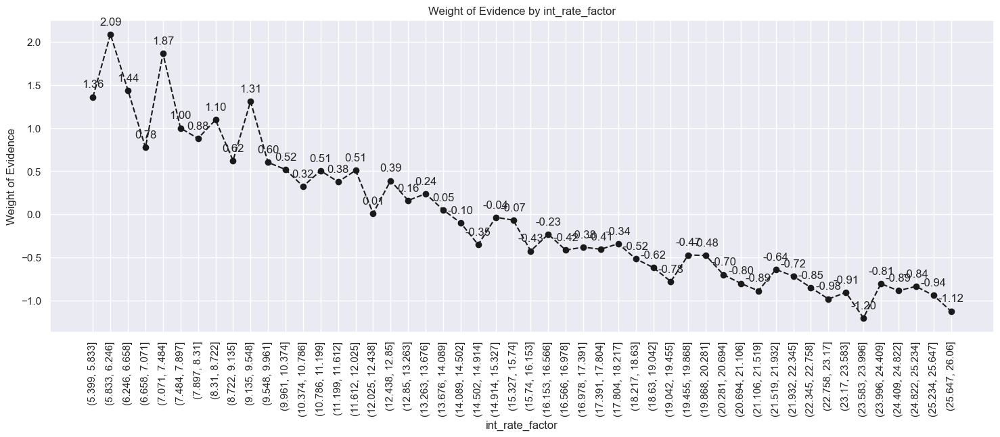

In [244]:
plot_by_woe(df_temp, 90)
# We plot the weight of evidence values.

In [245]:
df_inputs_prepr['int_rate:<9.548'] = np.where((df_inputs_prepr['int_rate'] <= 9.548), 1, 0)
df_inputs_prepr['int_rate:9.548-12.025'] = np.where((df_inputs_prepr['int_rate'] > 9.548) & (df_inputs_prepr['int_rate'] <= 12.025), 1, 0)
df_inputs_prepr['int_rate:12.025-15.74'] = np.where((df_inputs_prepr['int_rate'] > 12.025) & (df_inputs_prepr['int_rate'] <= 15.74), 1, 0)
df_inputs_prepr['int_rate:15.74-20.281'] = np.where((df_inputs_prepr['int_rate'] > 15.74) & (df_inputs_prepr['int_rate'] <= 20.281), 1, 0)
df_inputs_prepr['int_rate:>20.281'] = np.where((df_inputs_prepr['int_rate'] > 20.281), 1, 0)

In [246]:
# funded_amnt
df_inputs_prepr['funded_amnt_factor'] = pd.cut(df_inputs_prepr['funded_amnt'], 50)
# Here we do fine-classing: using the 'cut' method, we split the variable into 50 categories by its values.
df_temp = woe_ordered_continuous(df_inputs_prepr, 'funded_amnt_factor', df_targets_prepr)
# We calculate weight of evidence.
df_temp

C:\Users\dcgzb\AppData\Local\Temp\ipykernel_10772\1881610760.py:4: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  df = pd.concat([df.groupby(df.columns.values[0], as_index = False)[df.columns.values[1]].count(),
C:\Users\dcgzb\AppData\Local\Temp\ipykernel_10772\1881610760.py:5: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  df.groupby(df.columns.values[0], as_index = False)[df.columns.values[1]].mean()], axis = 1)


,funded_amnt_factor,n_obs,prop_good,prop_n_obs,n_good,n_bad,prop_n_good,prop_n_bad,WoE,diff_prop_good,diff_WoE,IV
0,"(465.5, 1190.0]",325,0.898462,0.003485,292.0,33.0,0.003513,0.003254,0.076766,NaN,NaN,0.020889
1,"(1190.0, 1880.0]",779,0.906290,0.008354,706.0,73.0,0.008495,0.007198,0.165676,0.007829,0.088910,0.020889
2,"(1880.0, 2570.0]",1499,0.906604,0.016075,1359.0,140.0,0.016352,0.013804,0.169382,0.000314,0.003706,0.020889
3,"(2570.0, 3260.0]",1846,0.892199,0.019796,1647.0,199.0,0.019817,0.019621,0.009926,0.014405,0.159456,0.020889
4,"(3260.0, 3950.0]",1207,0.881524,0.012943,1064.0,143.0,0.012802,0.014100,-0.096534,0.010675,0.106460,0.020889
5,"(3950.0, 4640.0]",2224,0.889388,0.023849,1978.0,246.0,0.023800,0.024256,-0.018970,0.007864,0.077564,0.020889
6,"(4640.0, 5330.0]",3983,0.898067,0.042712,3577.0,406.0,0.043039,0.040032,0.072447,0.008678,0.091417,0.020889
7,"(5330.0, 6020.0]",4358,0.912804,0.046734,3978.0,380.0,0.047864,0.037468,0.244883,0.014737,0.172437,0.020889
8,"(6020.0, 6710.0]",1738,0.882624,0.018638,1534.0,204.0,0.018457,0.020114,-0.085966,0.030180,0.330849,0.020889
9,"(6710.0, 7400.0]",2895,0.894991,0.031045,2591.0,304.0,0.031176,0.029974,0.039292,0.012368,0.125257,0.020889


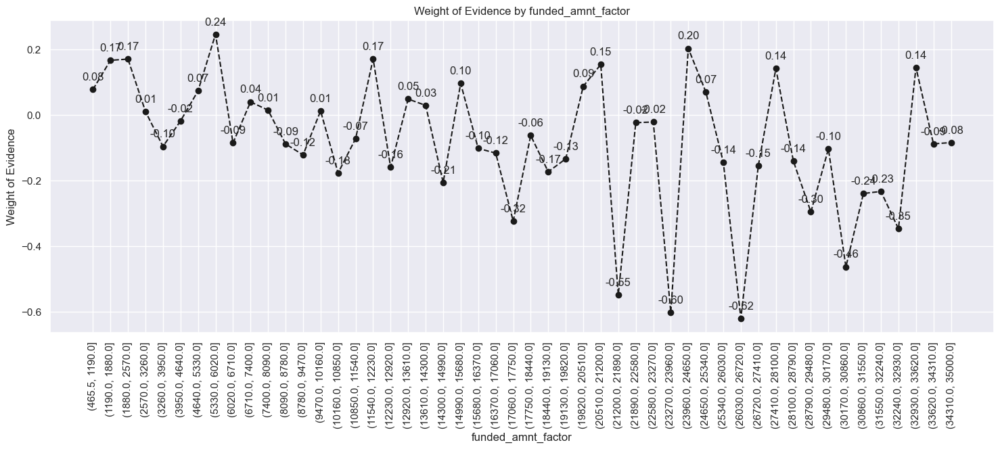

In [247]:
plot_by_woe(df_temp, 90)
# We plot the weight of evidence values.

In [248]:
# mths_since_earliest_cr_line
df_inputs_prepr['mths_since_earliest_cr_line_factor'] = pd.cut(df_inputs_prepr['mths_since_earliest_cr_line'], 50)
# Here we do fine-classing: using the 'cut' method, we split the variable into 50 categories by its values.
df_temp = woe_ordered_continuous(df_inputs_prepr, 'mths_since_earliest_cr_line_factor', df_targets_prepr)
# We calculate weight of evidence.
df_temp

C:\Users\dcgzb\AppData\Local\Temp\ipykernel_10772\1881610760.py:4: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  df = pd.concat([df.groupby(df.columns.values[0], as_index = False)[df.columns.values[1]].count(),
C:\Users\dcgzb\AppData\Local\Temp\ipykernel_10772\1881610760.py:5: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  df.groupby(df.columns.values[0], as_index = False)[df.columns.values[1]].mean()], axis = 1)
F:\anaconda3\envs\Udemycreditriskmodel\lib\site-packages\pandas\core\arraylike.py:396: RuntimeWarning: divide by zero encountered in log
  result = getattr(ufunc, method)(*inputs, **kwargs)


,mths_since_earliest_cr_line_factor,n_obs,prop_good,prop_n_obs,n_good,n_bad,prop_n_good,prop_n_bad,WoE,diff_prop_good,diff_WoE,IV
0,"(73.187, 90.26]",562,0.903915,0.006027,508.0,54.0,0.006112,0.005324,0.138018,NaN,NaN,inf
1,"(90.26, 106.52]",878,0.864465,0.009415,759.0,119.0,0.009132,0.011733,-0.250602,0.039450,0.388619,inf
2,"(106.52, 122.78]",2020,0.870792,0.021662,1759.0,261.0,0.021165,0.025735,-0.195499,0.006327,0.055102,inf
3,"(122.78, 139.04]",4077,0.867059,0.043720,3535.0,542.0,0.042534,0.053441,-0.228277,0.003733,0.032778,inf
4,"(139.04, 155.3]",4518,0.878486,0.048449,3969.0,549.0,0.047756,0.054131,-0.125309,0.011427,0.102968,inf
5,"(155.3, 171.56]",6043,0.883667,0.064803,5340.0,703.0,0.064252,0.069316,-0.075856,0.005181,0.049453,inf
6,"(171.56, 187.82]",7060,0.884561,0.075709,6245.0,815.0,0.075141,0.080359,-0.067132,0.000894,0.008724,inf
7,"(187.82, 204.08]",9349,0.885656,0.100255,8280.0,1069.0,0.099627,0.105403,-0.056360,0.001095,0.010771,inf
8,"(204.08, 220.34]",9721,0.888592,0.104244,8638.0,1083.0,0.103935,0.106784,-0.027044,0.002935,0.029317,inf
9,"(220.34, 236.6]",7608,0.887355,0.081585,6751.0,857.0,0.081230,0.084500,-0.039472,0.001236,0.012428,inf


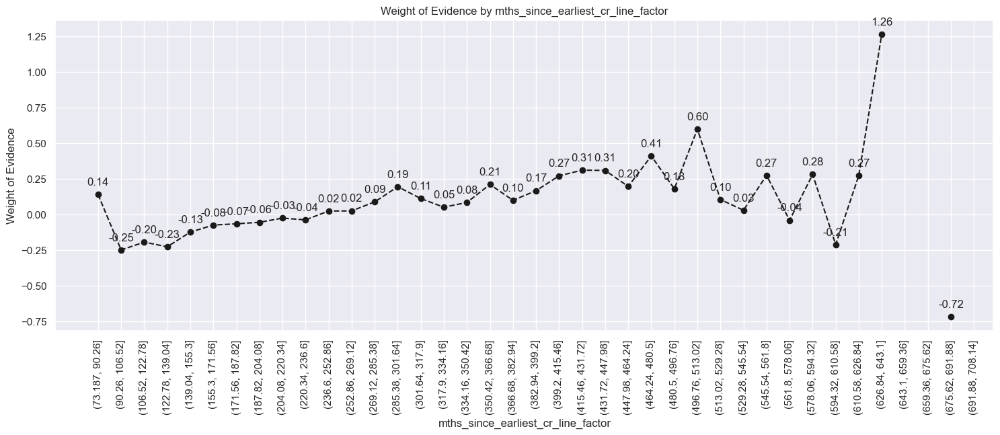

In [249]:
plot_by_woe(df_temp, 90)
# We plot the weight of evidence values.

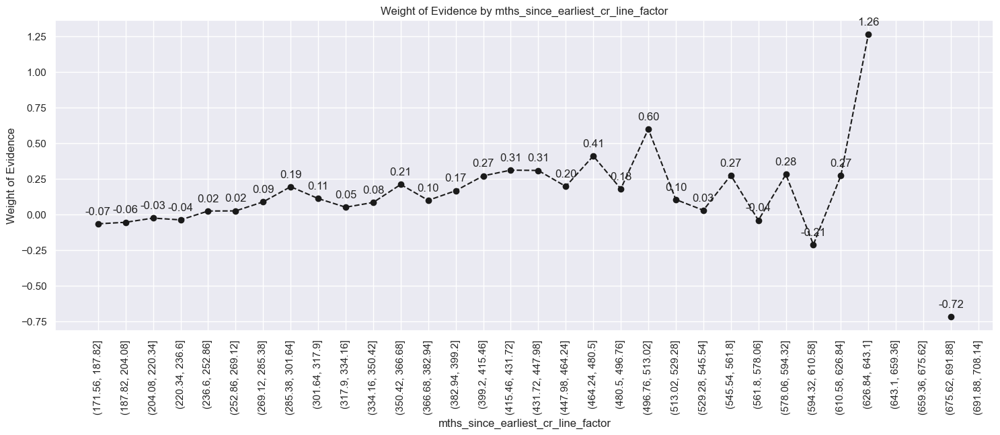

In [250]:
plot_by_woe(df_temp.iloc[6: , : ], 90)
# We plot the weight of evidence values.

In [251]:
# We create the following categories:
# < 140, # 141 - 164, # 165 - 247, # 248 - 270, # 271 - 352, # > 352
df_inputs_prepr['mths_since_earliest_cr_line:<140'] = np.where(df_inputs_prepr['mths_since_earliest_cr_line'].isin(range(140)), 1, 0)
df_inputs_prepr['mths_since_earliest_cr_line:141-164'] = np.where(df_inputs_prepr['mths_since_earliest_cr_line'].isin(range(140, 165)), 1, 0)
df_inputs_prepr['mths_since_earliest_cr_line:165-247'] = np.where(df_inputs_prepr['mths_since_earliest_cr_line'].isin(range(165, 248)), 1, 0)
df_inputs_prepr['mths_since_earliest_cr_line:248-270'] = np.where(df_inputs_prepr['mths_since_earliest_cr_line'].isin(range(248, 271)), 1, 0)
df_inputs_prepr['mths_since_earliest_cr_line:271-352'] = np.where(df_inputs_prepr['mths_since_earliest_cr_line'].isin(range(271, 353)), 1, 0)
df_inputs_prepr['mths_since_earliest_cr_line:>352'] = np.where(df_inputs_prepr['mths_since_earliest_cr_line'].isin(range(353, int(df_inputs_prepr['mths_since_earliest_cr_line'].max()))), 1, 0)

In [252]:
# delinq_2yrs
df_temp = woe_ordered_continuous(df_inputs_prepr, 'delinq_2yrs', df_targets_prepr)
# We calculate weight of evidence.
df_temp

F:\anaconda3\envs\Udemycreditriskmodel\lib\site-packages\pandas\core\arraylike.py:396: RuntimeWarning: divide by zero encountered in log
  result = getattr(ufunc, method)(*inputs, **kwargs)


,delinq_2yrs,n_obs,prop_good,prop_n_obs,n_good,n_bad,prop_n_good,prop_n_bad,WoE,diff_prop_good,diff_WoE,IV
0,0.0,76576,0.892421,0.821173,68338.0,8238.0,0.822260,0.812266,0.012229,NaN,NaN,inf
1,1.0,11345,0.885588,0.121660,10047.0,1298.0,0.120888,0.127983,-0.057030,0.006832,0.069259,inf
2,2.0,3205,0.883931,0.034369,2833.0,372.0,0.034087,0.036679,-0.073282,0.001657,0.016252,inf
3,3.0,1106,0.882459,0.011860,976.0,130.0,0.011743,0.012818,-0.087552,0.001472,0.014270,inf
4,4.0,455,0.909890,0.004879,414.0,41.0,0.004981,0.004043,0.208814,0.027431,0.296366,inf
5,5.0,266,0.906015,0.002852,241.0,25.0,0.002900,0.002465,0.162441,0.003875,0.046373,inf
6,6.0,124,0.887097,0.001330,110.0,14.0,0.001324,0.001380,-0.042057,0.018918,0.204498,inf
7,7.0,78,0.871795,0.000836,68.0,10.0,0.000818,0.000986,-0.186557,0.015302,0.144500,inf
8,8.0,31,0.967742,0.000332,30.0,1.0,0.000361,0.000099,1.297718,0.095947,1.484275,inf
9,9.0,18,0.833333,0.000193,15.0,3.0,0.000180,0.000296,-0.494042,0.134409,1.791759,inf


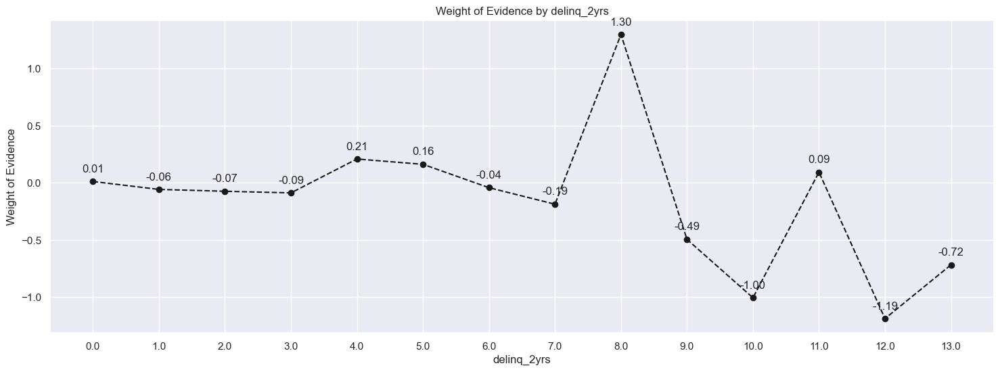

In [253]:
plot_by_woe(df_temp)
# We plot the weight of evidence values.

In [254]:
# Categories: 0, 1-3, >=4
df_inputs_prepr['delinq_2yrs:0'] = np.where((df_inputs_prepr['delinq_2yrs'] == 0), 1, 0)
df_inputs_prepr['delinq_2yrs:1-3'] = np.where((df_inputs_prepr['delinq_2yrs'] >= 1) & (df_inputs_prepr['delinq_2yrs'] <= 3), 1, 0)
df_inputs_prepr['delinq_2yrs:>=4'] = np.where((df_inputs_prepr['delinq_2yrs'] >= 9), 1, 0)

In [255]:
# inq_last_6mths
df_temp = woe_ordered_continuous(df_inputs_prepr, 'inq_last_6mths', df_targets_prepr)
# We calculate weight of evidence.
df_temp

F:\anaconda3\envs\Udemycreditriskmodel\lib\site-packages\pandas\core\arraylike.py:396: RuntimeWarning: divide by zero encountered in log
  result = getattr(ufunc, method)(*inputs, **kwargs)


,inq_last_6mths,n_obs,prop_good,prop_n_obs,n_good,n_bad,prop_n_good,prop_n_bad,WoE,diff_prop_good,diff_WoE,IV
0,0.0,48392,0.910254,0.518938,44049.0,4343.0,0.530008,0.428219,0.213257,NaN,NaN,inf
1,1.0,26056,0.885554,0.279415,23074.0,2982.0,0.277632,0.294025,-0.057368,0.024700,0.270625,inf
2,2.0,11454,0.859438,0.122828,9844.0,1610.0,0.118445,0.158746,-0.292852,0.026116,0.235484,inf
3,3.0,4984,0.841693,0.053447,4195.0,789.0,0.050475,0.077795,-0.432598,0.017744,0.139746,inf
4,4.0,1490,0.836913,0.015978,1247.0,243.0,0.015004,0.023960,-0.468045,0.004781,0.035448,inf
5,5.0,551,0.838475,0.005909,462.0,89.0,0.005559,0.008775,-0.456551,0.001563,0.011494,inf
6,6.0,234,0.799145,0.002509,187.0,47.0,0.002250,0.004634,-0.722519,0.039330,0.265968,inf
7,7.0,35,0.514286,0.000375,18.0,17.0,0.000217,0.001676,-2.046321,0.284860,1.323803,inf
8,8.0,21,0.476190,0.000225,10.0,11.0,0.000120,0.001085,-2.198790,0.038095,0.152469,inf
9,9.0,8,0.375000,0.000086,3.0,5.0,0.000036,0.000493,-2.614305,0.101190,0.415515,inf


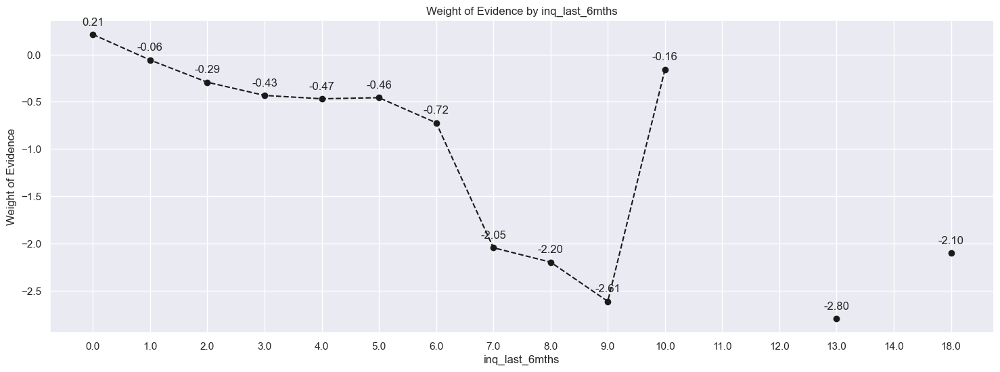

In [256]:
plot_by_woe(df_temp)
# We plot the weight of evidence values.

In [257]:
# Categories: 0, 1 - 2, 3 - 6, > 6
df_inputs_prepr['inq_last_6mths:0'] = np.where((df_inputs_prepr['inq_last_6mths'] == 0), 1, 0)
df_inputs_prepr['inq_last_6mths:1-2'] = np.where((df_inputs_prepr['inq_last_6mths'] >= 1) & (df_inputs_prepr['inq_last_6mths'] <= 2), 1, 0)
df_inputs_prepr['inq_last_6mths:3-6'] = np.where((df_inputs_prepr['inq_last_6mths'] >= 3) & (df_inputs_prepr['inq_last_6mths'] <= 6), 1, 0)
df_inputs_prepr['inq_last_6mths:>6'] = np.where((df_inputs_prepr['inq_last_6mths'] > 6), 1, 0)

In [258]:
# open_acc
df_temp = woe_ordered_continuous(df_inputs_prepr, 'open_acc', df_targets_prepr)
# We calculate weight of evidence.
df_temp

F:\anaconda3\envs\Udemycreditriskmodel\lib\site-packages\pandas\core\arraylike.py:396: RuntimeWarning: divide by zero encountered in log
  result = getattr(ufunc, method)(*inputs, **kwargs)


,open_acc,n_obs,prop_good,prop_n_obs,n_good,n_bad,prop_n_good,prop_n_bad,WoE,diff_prop_good,diff_WoE,IV
0,0.0,2,0.500000,0.000021,1.0,1.0,0.000012,0.000099,-2.103480,NaN,NaN,inf
1,1.0,26,0.807692,0.000279,21.0,5.0,0.000253,0.000493,-0.668395,0.307692,1.435085,inf
2,2.0,359,0.838440,0.003850,301.0,58.0,0.003622,0.005719,-0.456813,0.030748,0.211583,inf
3,3.0,1067,0.866917,0.011442,925.0,142.0,0.011130,0.014001,-0.229513,0.028476,0.227299,inf
4,4.0,2581,0.894227,0.027678,2308.0,273.0,0.027770,0.026918,0.031185,0.027310,0.260698,inf
5,5.0,4419,0.902014,0.047388,3986.0,433.0,0.047961,0.042694,0.116326,0.007787,0.085141,inf
6,6.0,6166,0.892151,0.066122,5501.0,665.0,0.066189,0.065569,0.009418,0.009864,0.106908,inf
7,7.0,7566,0.893339,0.081135,6759.0,807.0,0.081326,0.079570,0.021827,0.001188,0.012408,inf
8,8.0,8483,0.886007,0.090969,7516.0,967.0,0.090434,0.095346,-0.052889,0.007331,0.074716,inf
9,9.0,8774,0.887623,0.094089,7788.0,986.0,0.093707,0.097219,-0.036797,0.001615,0.016092,inf


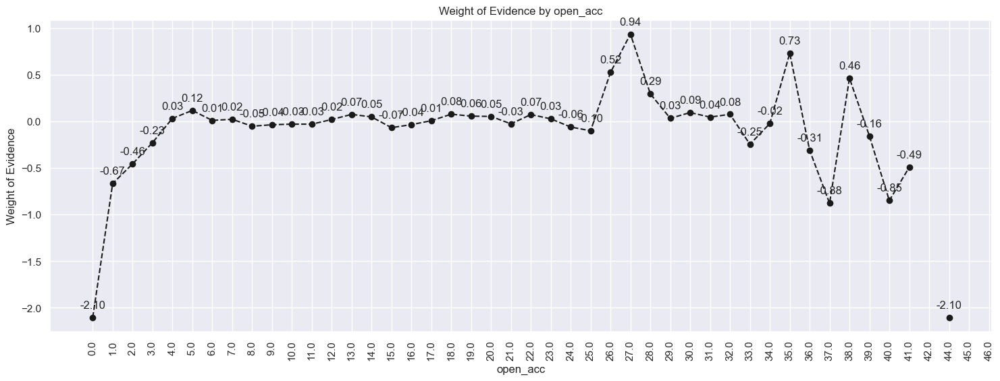

In [259]:
plot_by_woe(df_temp, 90)
# We plot the weight of evidence values.

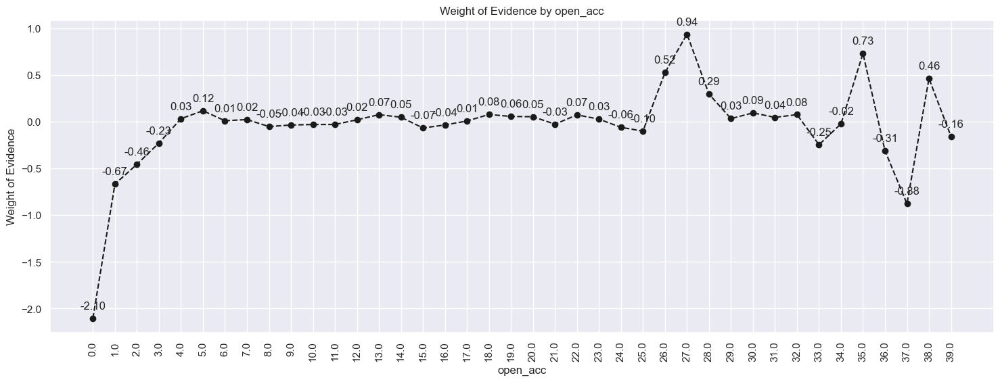

In [260]:
plot_by_woe(df_temp.iloc[ : 40, :], 90)
# We plot the weight of evidence values.

In [261]:
# Categories: '0', '1-3', '4-12', '13-17', '18-22', '23-25', '26-30', '>30'
df_inputs_prepr['open_acc:0'] = np.where((df_inputs_prepr['open_acc'] == 0), 1, 0)
df_inputs_prepr['open_acc:1-3'] = np.where((df_inputs_prepr['open_acc'] >= 1) & (df_inputs_prepr['open_acc'] <= 3), 1, 0)
df_inputs_prepr['open_acc:4-12'] = np.where((df_inputs_prepr['open_acc'] >= 4) & (df_inputs_prepr['open_acc'] <= 12), 1, 0)
df_inputs_prepr['open_acc:13-17'] = np.where((df_inputs_prepr['open_acc'] >= 13) & (df_inputs_prepr['open_acc'] <= 17), 1, 0)
df_inputs_prepr['open_acc:18-22'] = np.where((df_inputs_prepr['open_acc'] >= 18) & (df_inputs_prepr['open_acc'] <= 22), 1, 0)
df_inputs_prepr['open_acc:23-25'] = np.where((df_inputs_prepr['open_acc'] >= 23) & (df_inputs_prepr['open_acc'] <= 25), 1, 0)
df_inputs_prepr['open_acc:26-30'] = np.where((df_inputs_prepr['open_acc'] >= 26) & (df_inputs_prepr['open_acc'] <= 30), 1, 0)
df_inputs_prepr['open_acc:>=31'] = np.where((df_inputs_prepr['open_acc'] >= 31), 1, 0)

In [262]:
# pub_rec
df_temp = woe_ordered_continuous(df_inputs_prepr, 'pub_rec', df_targets_prepr)
# We calculate weight of evidence.
df_temp

,pub_rec,n_obs,prop_good,prop_n_obs,n_good,n_bad,prop_n_good,prop_n_bad,WoE,diff_prop_good,diff_WoE,IV
0,0.0,81043,0.889861,0.869075,72117.0,8926.0,0.867730,0.880103,-0.014158,NaN,NaN,inf
1,1.0,10549,0.900370,0.113124,9498.0,1051.0,0.114282,0.103628,0.097859,0.010509,0.112018,inf
2,2.0,1147,0.892764,0.012300,1024.0,123.0,0.012321,0.012128,0.015808,0.007606,0.082052,inf
3,3.0,315,0.933333,0.003378,294.0,21.0,0.003537,0.002071,0.535578,0.040570,0.519770,inf
4,4.0,102,0.862745,0.001094,88.0,14.0,0.001059,0.001380,-0.265200,0.070588,0.800778,inf
5,5.0,55,0.909091,0.000590,50.0,5.0,0.000602,0.000493,0.199105,0.046346,0.464306,inf
6,6.0,21,0.904762,0.000225,19.0,2.0,0.000229,0.000197,0.147812,0.004329,0.051293,inf
7,7.0,5,1.000000,0.000054,5.0,0.0,0.000060,0.000000,inf,0.095238,inf,inf
8,8.0,5,1.000000,0.000054,5.0,0.0,0.000060,0.000000,inf,0.000000,NaN,inf
9,9.0,2,1.000000,0.000021,2.0,0.0,0.000024,0.000000,inf,0.000000,NaN,inf


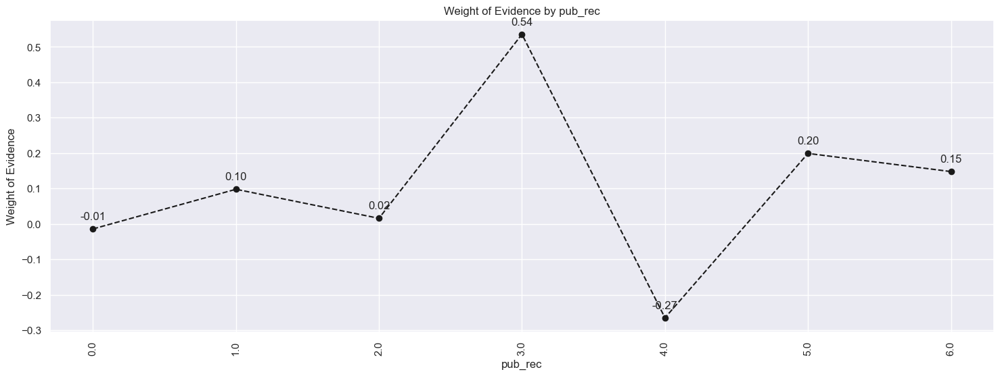

In [263]:
plot_by_woe(df_temp, 90)
# We plot the weight of evidence values.

In [264]:
# Categories '0-2', '3-4', '>=5'
df_inputs_prepr['pub_rec:0-2'] = np.where((df_inputs_prepr['pub_rec'] >= 0) & (df_inputs_prepr['pub_rec'] <= 2), 1, 0)
df_inputs_prepr['pub_rec:3-4'] = np.where((df_inputs_prepr['pub_rec'] >= 3) & (df_inputs_prepr['pub_rec'] <= 4), 1, 0)
df_inputs_prepr['pub_rec:>=5'] = np.where((df_inputs_prepr['pub_rec'] >= 5), 1, 0)

In [265]:
# total_acc
df_inputs_prepr['total_acc_factor'] = pd.cut(df_inputs_prepr['total_acc'], 50)
# Here we do fine-classing: using the 'cut' method, we split the variable into 50 categories by its values.
df_temp = woe_ordered_continuous(df_inputs_prepr, 'total_acc_factor', df_targets_prepr)
# We calculate weight of evidence.
df_temp

C:\Users\dcgzb\AppData\Local\Temp\ipykernel_10772\1881610760.py:4: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  df = pd.concat([df.groupby(df.columns.values[0], as_index = False)[df.columns.values[1]].count(),
C:\Users\dcgzb\AppData\Local\Temp\ipykernel_10772\1881610760.py:5: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  df.groupby(df.columns.values[0], as_index = False)[df.columns.values[1]].mean()], axis = 1)


,total_acc_factor,n_obs,prop_good,prop_n_obs,n_good,n_bad,prop_n_good,prop_n_bad,WoE,diff_prop_good,diff_WoE,IV
0,"(0.883, 3.34]",114,0.754386,0.001222,86.0,28.0,0.001035,0.002761,-0.981337,NaN,NaN,inf
1,"(3.34, 5.68]",847,0.861865,0.009083,730.0,117.0,0.008784,0.011536,-0.272609,0.107479,0.708728,inf
2,"(5.68, 8.02]",2972,0.875168,0.031871,2601.0,371.0,0.031296,0.036581,-0.156031,0.013303,0.116579,inf
3,"(8.02, 10.36]",3371,0.885494,0.036149,2985.0,386.0,0.035916,0.038060,-0.057962,0.010326,0.098068,inf
4,"(10.36, 12.7]",4418,0.877320,0.047377,3876.0,542.0,0.046637,0.053441,-0.136187,0.008174,0.078225,inf
5,"(12.7, 15.04]",8447,0.889783,0.090583,7516.0,931.0,0.090434,0.091796,-0.014950,0.012463,0.121237,inf
6,"(15.04, 17.38]",6408,0.884207,0.068717,5666.0,742.0,0.068175,0.073161,-0.070590,0.005576,0.055641,inf
7,"(17.38, 19.72]",6627,0.886827,0.071065,5877.0,750.0,0.070714,0.073950,-0.044751,0.002619,0.025839,inf
8,"(19.72, 22.06]",10220,0.892074,0.109596,9117.0,1103.0,0.109698,0.108756,0.008627,0.005248,0.053379,inf
9,"(22.06, 24.4]",6663,0.883086,0.071452,5884.0,779.0,0.070798,0.076809,-0.081499,0.008989,0.090126,inf


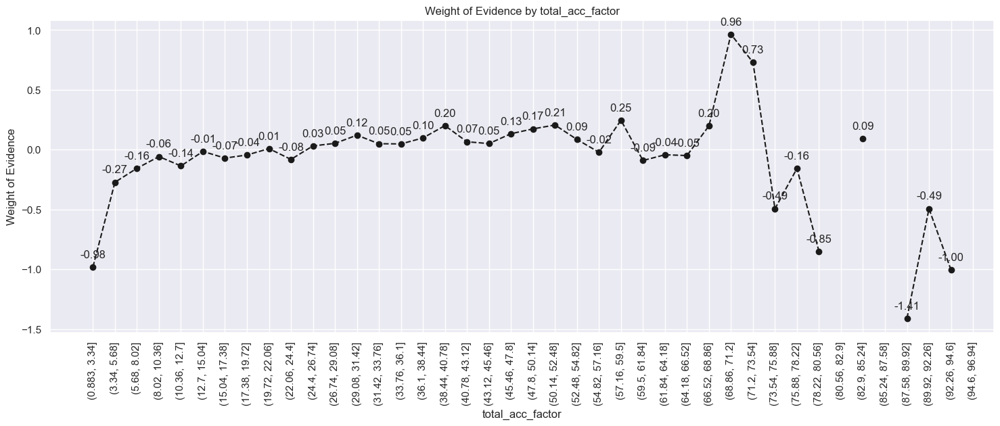

In [266]:
plot_by_woe(df_temp, 90)
# We plot the weight of evidence values.

In [267]:
# Categories: '<=27', '28-51', '>51'
df_inputs_prepr['total_acc:<=27'] = np.where((df_inputs_prepr['total_acc'] <= 27), 1, 0)
df_inputs_prepr['total_acc:28-51'] = np.where((df_inputs_prepr['total_acc'] >= 28) & (df_inputs_prepr['total_acc'] <= 51), 1, 0)
df_inputs_prepr['total_acc:>=52'] = np.where((df_inputs_prepr['total_acc'] >= 52), 1, 0)

In [268]:
# acc_now_delinq
df_temp = woe_ordered_continuous(df_inputs_prepr, 'acc_now_delinq', df_targets_prepr)
# We calculate weight of evidence.
df_temp

,acc_now_delinq,n_obs,prop_good,prop_n_obs,n_good,n_bad,prop_n_good,prop_n_bad,WoE,diff_prop_good,diff_WoE,IV
0,0.0,92909,0.891291,0.996322,82809.0,10100.0,0.996378,0.995859,0.000522,NaN,NaN,inf
1,1.0,319,0.871473,0.003421,278.0,41.0,0.003345,0.004043,-0.189431,0.019818,0.189952,inf
2,2.0,22,0.954545,0.000236,21.0,1.0,0.000253,0.000099,0.941043,0.083072,1.130473,inf
3,3.0,1,1.000000,0.000011,1.0,0.0,0.000012,0.000000,inf,0.045455,inf,inf
4,4.0,1,1.000000,0.000011,1.0,0.0,0.000012,0.000000,inf,0.000000,NaN,inf


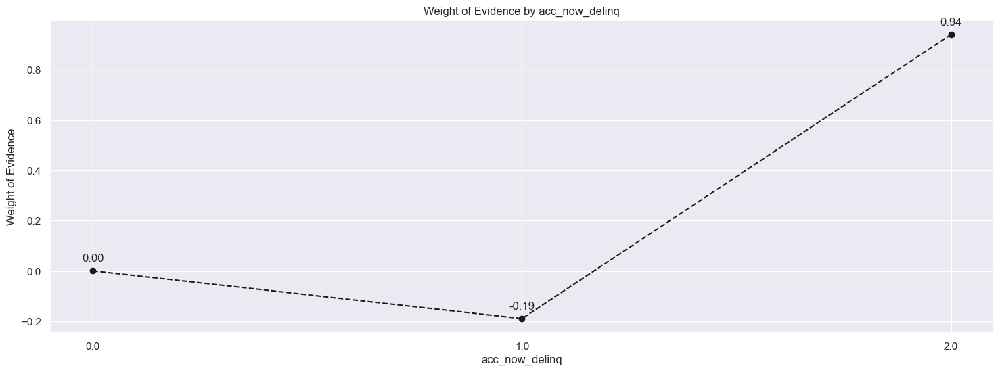

In [269]:
plot_by_woe(df_temp)
# We plot the weight of evidence values.

In [270]:
# Categories: '0', '>=1'
df_inputs_prepr['acc_now_delinq:0'] = np.where((df_inputs_prepr['acc_now_delinq'] == 0), 1, 0)
df_inputs_prepr['acc_now_delinq:>=1'] = np.where((df_inputs_prepr['acc_now_delinq'] >= 1), 1, 0)

In [271]:
# total_rev_hi_lim
df_inputs_prepr['total_rev_hi_lim_factor'] = pd.cut(df_inputs_prepr['total_rev_hi_lim'], 2000)
# Here we do fine-classing: using the 'cut' method, we split the variable into 2000 categories by its values.
df_temp = woe_ordered_continuous(df_inputs_prepr, 'total_rev_hi_lim_factor', df_targets_prepr)
# We calculate weight of evidence.
df_temp

C:\Users\dcgzb\AppData\Local\Temp\ipykernel_10772\1881610760.py:4: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  df = pd.concat([df.groupby(df.columns.values[0], as_index = False)[df.columns.values[1]].count(),
C:\Users\dcgzb\AppData\Local\Temp\ipykernel_10772\1881610760.py:5: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  df.groupby(df.columns.values[0], as_index = False)[df.columns.values[1]].mean()], axis = 1)


,total_rev_hi_lim_factor,n_obs,prop_good,prop_n_obs,n_good,n_bad,prop_n_good,prop_n_bad,WoE,diff_prop_good,diff_WoE,IV
0,"(-9999.999, 5000.0]",4823,0.863570,0.051720,4165.0,658.0,0.050114,0.064879,-0.258213,NaN,NaN,inf
1,"(5000.0, 9999.999]",13295,0.877473,0.142571,11666.0,1629.0,0.140368,0.160619,-0.134768,0.013902,0.123446,inf
2,"(9999.999, 14999.998]",14847,0.882939,0.159214,13109.0,1738.0,0.157731,0.171367,-0.082916,0.005467,0.051852,inf
3,"(14999.998, 19999.998]",12742,0.875451,0.136641,11155.0,1587.0,0.134220,0.156478,-0.153437,0.007488,0.070522,inf
4,"(19999.998, 24999.997]",10458,0.887168,0.112148,9278.0,1180.0,0.111635,0.116348,-0.041348,0.011716,0.112089,inf
...,...,...,...,...,...,...,...,...,...,...,...,...
1995,"(9974999.002, 9979999.002]",0,NaN,0.000000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,inf
1996,"(9979999.002, 9984999.002]",0,NaN,0.000000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,inf
1997,"(9984999.002, 9989999.001]",0,NaN,0.000000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,inf
1998,"(9989999.001, 9994999.0]",0,NaN,0.000000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,inf


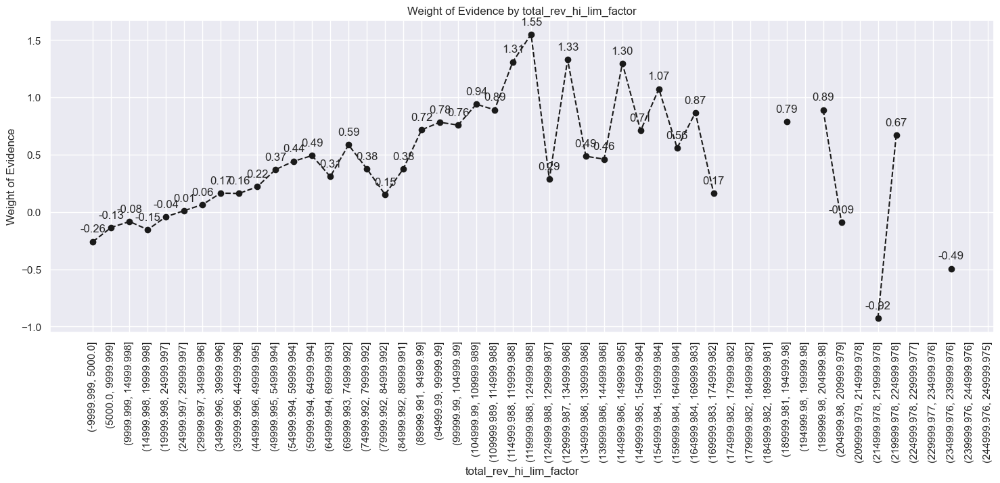

In [272]:
plot_by_woe(df_temp.iloc[: 50, : ], 90)
# We plot the weight of evidence values.

In [273]:
# Categories
# '<=5K', '5K-10K', '10K-20K', '20K-30K', '30K-40K', '40K-55K', '55K-95K', '>95K'
df_inputs_prepr['total_rev_hi_lim:<=5K'] = np.where((df_inputs_prepr['total_rev_hi_lim'] <= 5000), 1, 0)
df_inputs_prepr['total_rev_hi_lim:5K-10K'] = np.where((df_inputs_prepr['total_rev_hi_lim'] > 5000) & (df_inputs_prepr['total_rev_hi_lim'] <= 10000), 1, 0)
df_inputs_prepr['total_rev_hi_lim:10K-20K'] = np.where((df_inputs_prepr['total_rev_hi_lim'] > 10000) & (df_inputs_prepr['total_rev_hi_lim'] <= 20000), 1, 0)
df_inputs_prepr['total_rev_hi_lim:20K-30K'] = np.where((df_inputs_prepr['total_rev_hi_lim'] > 20000) & (df_inputs_prepr['total_rev_hi_lim'] <= 30000), 1, 0)
df_inputs_prepr['total_rev_hi_lim:30K-40K'] = np.where((df_inputs_prepr['total_rev_hi_lim'] > 30000) & (df_inputs_prepr['total_rev_hi_lim'] <= 40000), 1, 0)
df_inputs_prepr['total_rev_hi_lim:40K-55K'] = np.where((df_inputs_prepr['total_rev_hi_lim'] > 40000) & (df_inputs_prepr['total_rev_hi_lim'] <= 55000), 1, 0)
df_inputs_prepr['total_rev_hi_lim:55K-95K'] = np.where((df_inputs_prepr['total_rev_hi_lim'] > 55000) & (df_inputs_prepr['total_rev_hi_lim'] <= 95000), 1, 0)
df_inputs_prepr['total_rev_hi_lim:>95K'] = np.where((df_inputs_prepr['total_rev_hi_lim'] > 95000), 1, 0)

In [274]:
# installment
df_inputs_prepr['installment_factor'] = pd.cut(df_inputs_prepr['installment'], 50)
# Here we do fine-classing: using the 'cut' method, we split the variable into 50 categories by its values.
df_temp = woe_ordered_continuous(df_inputs_prepr, 'installment_factor', df_targets_prepr)
# We calculate weight of evidence.
df_temp

C:\Users\dcgzb\AppData\Local\Temp\ipykernel_10772\1881610760.py:4: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  df = pd.concat([df.groupby(df.columns.values[0], as_index = False)[df.columns.values[1]].count(),
C:\Users\dcgzb\AppData\Local\Temp\ipykernel_10772\1881610760.py:5: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  df.groupby(df.columns.values[0], as_index = False)[df.columns.values[1]].mean()], axis = 1)


,installment_factor,n_obs,prop_good,prop_n_obs,n_good,n_bad,prop_n_good,prop_n_bad,WoE,diff_prop_good,diff_WoE,IV
0,"(14.368, 43.607]",472,0.896186,0.005062,423.0,49.0,0.005090,0.004831,0.052072,NaN,NaN,0.021235
1,"(43.607, 71.455]",1235,0.904453,0.013244,1117.0,118.0,0.013440,0.011635,0.144237,0.008267,0.092165,0.021235
2,"(71.455, 99.302]",1760,0.901136,0.018874,1586.0,174.0,0.019083,0.017156,0.106435,0.003317,0.037802,0.021235
3,"(99.302, 127.15]",2283,0.896189,0.024482,2046.0,237.0,0.024618,0.023368,0.052102,0.004947,0.054333,0.021235
4,"(127.15, 154.997]",2470,0.889879,0.026487,2198.0,272.0,0.026447,0.026819,-0.013979,0.006311,0.066081,0.021235
5,"(154.997, 182.844]",4229,0.896902,0.045350,3793.0,436.0,0.045638,0.042990,0.059790,0.007024,0.073769,0.021235
6,"(182.844, 210.692]",4301,0.907231,0.046122,3902.0,399.0,0.046950,0.039341,0.176803,0.010329,0.117013,0.021235
7,"(210.692, 238.539]",3715,0.907402,0.039838,3371.0,344.0,0.040561,0.033918,0.178843,0.000172,0.002040,0.021235
8,"(238.539, 266.387]",4661,0.900665,0.049983,4198.0,463.0,0.050511,0.045652,0.101157,0.006737,0.077687,0.021235
9,"(266.387, 294.234]",4881,0.888957,0.052342,4339.0,542.0,0.052208,0.053441,-0.023347,0.011708,0.124503,0.021235


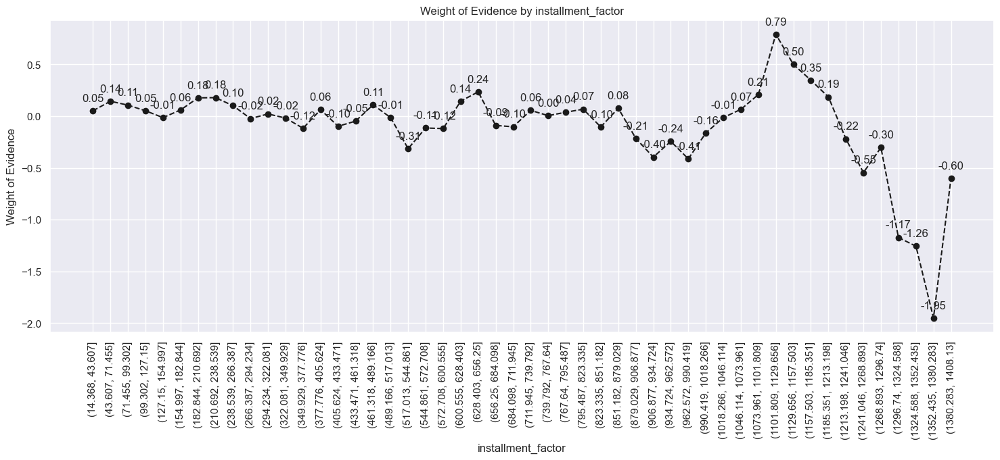

In [276]:
plot_by_woe(df_temp, 90)
# We plot the weight of evidence values.

In [277]:
# annual_inc
df_inputs_prepr['annual_inc_factor'] = pd.cut(df_inputs_prepr['annual_inc'], 50)
# Here we do fine-classing: using the 'cut' method, we split the variable into 50 categories by its values.
df_temp = woe_ordered_continuous(df_inputs_prepr, 'annual_inc_factor', df_targets_prepr)
# We calculate weight of evidence.
df_temp

C:\Users\dcgzb\AppData\Local\Temp\ipykernel_10772\1881610760.py:4: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  df = pd.concat([df.groupby(df.columns.values[0], as_index = False)[df.columns.values[1]].count(),
C:\Users\dcgzb\AppData\Local\Temp\ipykernel_10772\1881610760.py:5: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  df.groupby(df.columns.values[0], as_index = False)[df.columns.values[1]].mean()], axis = 1)


,annual_inc_factor,n_obs,prop_good,prop_n_obs,n_good,n_bad,prop_n_good,prop_n_bad,WoE,diff_prop_good,diff_WoE,IV
0,"(-3137.778, 146755.56]",88210,0.889264,0.945931,78442.0,9768.0,0.943833,0.963124,-0.020232,NaN,NaN,inf
1,"(146755.56, 289511.12]",4521,0.923689,0.048482,4176.0,345.0,0.050247,0.034017,0.390085,0.034425,0.410317,inf
2,"(289511.12, 432266.68]",382,0.942408,0.004096,360.0,22.0,0.004332,0.002169,0.691582,0.018719,0.301497,inf
3,"(432266.68, 575022.24]",71,0.929577,0.000761,66.0,5.0,0.000794,0.000493,0.476737,0.012831,0.214845,inf
4,"(575022.24, 717777.8]",31,0.967742,0.000332,30.0,1.0,0.000361,0.000099,1.297718,0.038164,0.820981,inf
5,"(717777.8, 860533.36]",13,1.000000,0.000139,13.0,0.0,0.000156,0.000000,inf,0.032258,inf,inf
6,"(860533.36, 1003288.92]",11,1.000000,0.000118,11.0,0.0,0.000132,0.000000,inf,0.000000,NaN,inf
7,"(1003288.92, 1146044.48]",2,1.000000,0.000021,2.0,0.0,0.000024,0.000000,inf,0.000000,NaN,inf
8,"(1146044.48, 1288800.04]",5,0.800000,0.000054,4.0,1.0,0.000048,0.000099,-0.717185,0.200000,inf,inf
9,"(1288800.04, 1431555.6]",1,1.000000,0.000011,1.0,0.0,0.000012,0.000000,inf,0.200000,inf,inf


In [278]:
# Initial examination shows that there are too few individuals with large income and too many with small income.
# Hence, we are going to have one category for more than 150K, and we are going to apply our approach to determine
# the categories of everyone with 140k or less.
df_inputs_prepr_temp = df_inputs_prepr.loc[df_inputs_prepr['annual_inc'] <= 140000, : ]
#loan_data_temp = loan_data_temp.reset_index(drop = True)
#df_inputs_prepr_temp

In [280]:
df_inputs_prepr_temp["annual_inc_factor"] = pd.cut(df_inputs_prepr_temp['annual_inc'], 50)
# Here we do fine-classing: using the 'cut' method, we split the variable into 50 categories by its values.
df_temp = woe_ordered_continuous(df_inputs_prepr_temp, 'annual_inc_factor', df_targets_prepr[df_inputs_prepr_temp.index])
# We calculate weight of evidence.
df_temp

C:\Users\dcgzb\AppData\Local\Temp\ipykernel_10772\2604529898.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_inputs_prepr_temp["annual_inc_factor"] = pd.cut(df_inputs_prepr_temp['annual_inc'], 50)
C:\Users\dcgzb\AppData\Local\Temp\ipykernel_10772\1881610760.py:4: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  df = pd.concat([df.groupby(df.columns.values[0], as_index = False)[df.columns.values[1]].count(),
C:\Users\dcgzb\AppData\Local\Temp\ipykernel_10772\1881610760.py:5: FutureWarning: The default of observed=False is deprecated and will be changed to 

,annual_inc_factor,n_obs,prop_good,prop_n_obs,n_good,n_bad,prop_n_good,prop_n_bad,WoE,diff_prop_good,diff_WoE,IV
0,"(3864.0, 6720.0]",9,1.000000,0.000103,9.0,0.0,0.000115,0.000000,inf,NaN,NaN,inf
1,"(6720.0, 9440.0]",36,0.888889,0.000410,32.0,4.0,0.000410,0.000411,-0.002118,0.111111,inf,inf
2,"(9440.0, 12160.0]",134,0.768657,0.001528,103.0,31.0,0.001321,0.003187,-0.880818,0.120232,0.878700,inf
3,"(12160.0, 14880.0]",184,0.809783,0.002098,149.0,35.0,0.001911,0.003598,-0.632961,0.041126,0.247856,inf
4,"(14880.0, 17600.0]",349,0.865330,0.003979,302.0,47.0,0.003872,0.004831,-0.221280,0.055547,0.411681,inf
5,"(17600.0, 20320.0]",704,0.866477,0.008026,610.0,94.0,0.007822,0.009663,-0.211395,0.001148,0.009885,inf
6,"(20320.0, 23040.0]",785,0.825478,0.008949,648.0,137.0,0.008309,0.014083,-0.527650,0.041000,0.316254,inf
7,"(23040.0, 25760.0]",1417,0.869442,0.016154,1232.0,185.0,0.015797,0.019017,-0.185521,0.043965,0.342129,inf
8,"(25760.0, 28480.0]",1352,0.853550,0.015413,1154.0,198.0,0.014797,0.020354,-0.318837,0.015892,0.133316,inf
9,"(28480.0, 31200.0]",2634,0.868641,0.030028,2288.0,346.0,0.029337,0.035567,-0.192565,0.015091,0.126272,inf


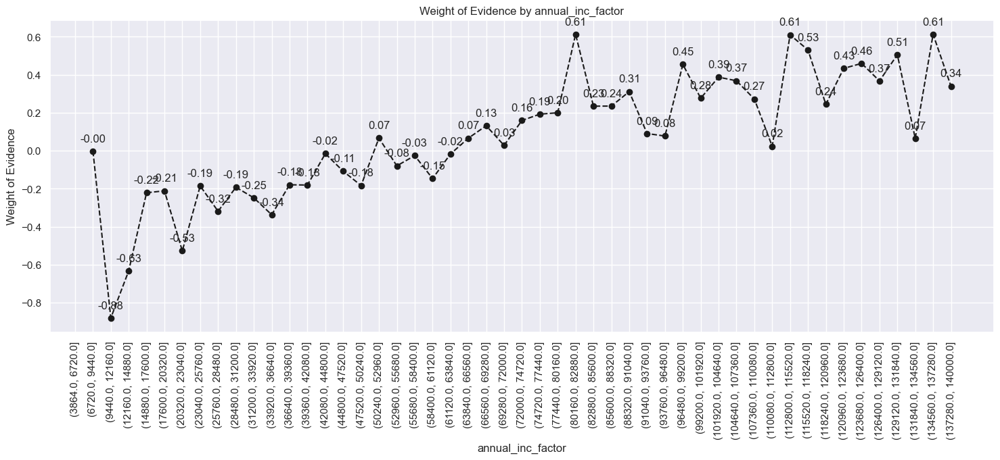

In [281]:
plot_by_woe(df_temp, 90)
# We plot the weight of evidence values.

In [282]:
# WoE is monotonically decreasing with income, so we split income in 10 equal categories, each with width of 15k.
df_inputs_prepr['annual_inc:<20K'] = np.where((df_inputs_prepr['annual_inc'] <= 20000), 1, 0)
df_inputs_prepr['annual_inc:20K-30K'] = np.where((df_inputs_prepr['annual_inc'] > 20000) & (df_inputs_prepr['annual_inc'] <= 30000), 1, 0)
df_inputs_prepr['annual_inc:30K-40K'] = np.where((df_inputs_prepr['annual_inc'] > 30000) & (df_inputs_prepr['annual_inc'] <= 40000), 1, 0)
df_inputs_prepr['annual_inc:40K-50K'] = np.where((df_inputs_prepr['annual_inc'] > 40000) & (df_inputs_prepr['annual_inc'] <= 50000), 1, 0)
df_inputs_prepr['annual_inc:50K-60K'] = np.where((df_inputs_prepr['annual_inc'] > 50000) & (df_inputs_prepr['annual_inc'] <= 60000), 1, 0)
df_inputs_prepr['annual_inc:60K-70K'] = np.where((df_inputs_prepr['annual_inc'] > 60000) & (df_inputs_prepr['annual_inc'] <= 70000), 1, 0)
df_inputs_prepr['annual_inc:70K-80K'] = np.where((df_inputs_prepr['annual_inc'] > 70000) & (df_inputs_prepr['annual_inc'] <= 80000), 1, 0)
df_inputs_prepr['annual_inc:80K-90K'] = np.where((df_inputs_prepr['annual_inc'] > 80000) & (df_inputs_prepr['annual_inc'] <= 90000), 1, 0)
df_inputs_prepr['annual_inc:90K-100K'] = np.where((df_inputs_prepr['annual_inc'] > 90000) & (df_inputs_prepr['annual_inc'] <= 100000), 1, 0)
df_inputs_prepr['annual_inc:100K-120K'] = np.where((df_inputs_prepr['annual_inc'] > 100000) & (df_inputs_prepr['annual_inc'] <= 120000), 1, 0)
df_inputs_prepr['annual_inc:120K-140K'] = np.where((df_inputs_prepr['annual_inc'] > 120000) & (df_inputs_prepr['annual_inc'] <= 140000), 1, 0)
df_inputs_prepr['annual_inc:>140K'] = np.where((df_inputs_prepr['annual_inc'] > 140000), 1, 0)

In [283]:
# mths_since_last_delinq
# We have to create one category for missing values and do fine and coarse classing for the rest.
df_inputs_prepr_temp = df_inputs_prepr[pd.notnull(df_inputs_prepr['mths_since_last_delinq'])]
df_inputs_prepr_temp['mths_since_last_delinq_factor'] = pd.cut(df_inputs_prepr_temp['mths_since_last_delinq'], 50)
df_temp = woe_ordered_continuous(df_inputs_prepr_temp, 'mths_since_last_delinq_factor', df_targets_prepr[df_inputs_prepr_temp.index])
# We calculate weight of evidence.
df_temp

C:\Users\dcgzb\AppData\Local\Temp\ipykernel_10772\1373989647.py:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_inputs_prepr_temp['mths_since_last_delinq_factor'] = pd.cut(df_inputs_prepr_temp['mths_since_last_delinq'], 50)
C:\Users\dcgzb\AppData\Local\Temp\ipykernel_10772\1881610760.py:4: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  df = pd.concat([df.groupby(df.columns.values[0], as_index = False)[df.columns.values[1]].count(),
C:\Users\dcgzb\AppData\Local\Temp\ipykernel_10772\1881610760.py:5: FutureWarning: The default of observed=False is deprecated

,mths_since_last_delinq_factor,n_obs,prop_good,prop_n_obs,n_good,n_bad,prop_n_good,prop_n_bad,WoE,diff_prop_good,diff_WoE,IV
0,"(-0.159, 3.18]",1279,0.862392,0.029624,1103.0,176.0,0.028678,0.037351,-0.264253,NaN,NaN,inf
1,"(3.18, 6.36]",1892,0.881607,0.043823,1668.0,224.0,0.043367,0.047538,-0.091824,0.019214,0.172430,inf
2,"(6.36, 9.54]",2584,0.886223,0.059851,2290.0,294.0,0.059539,0.062394,-0.046831,0.004616,0.044993,inf
3,"(9.54, 12.72]",2454,0.889568,0.056840,2183.0,271.0,0.056757,0.057513,-0.013222,0.003345,0.033609,inf
4,"(12.72, 15.9]",2569,0.874659,0.059503,2247.0,322.0,0.058421,0.068336,-0.156759,0.014909,0.143537,inf
5,"(15.9, 19.08]",3038,0.891705,0.070366,2709.0,329.0,0.070433,0.069822,0.008719,0.017046,0.165477,inf
6,"(19.08, 22.26]",2181,0.889959,0.050517,1941.0,240.0,0.050465,0.050934,-0.009239,0.001746,0.017957,inf
7,"(22.26, 25.44]",2023,0.886802,0.046857,1794.0,229.0,0.046643,0.048599,-0.041077,0.003157,0.031839,inf
8,"(25.44, 28.62]",2048,0.896973,0.047436,1837.0,211.0,0.047761,0.044779,0.064473,0.010171,0.105550,inf
9,"(28.62, 31.8]",1934,0.901758,0.044795,1744.0,190.0,0.045343,0.040323,0.117354,0.004785,0.052882,inf


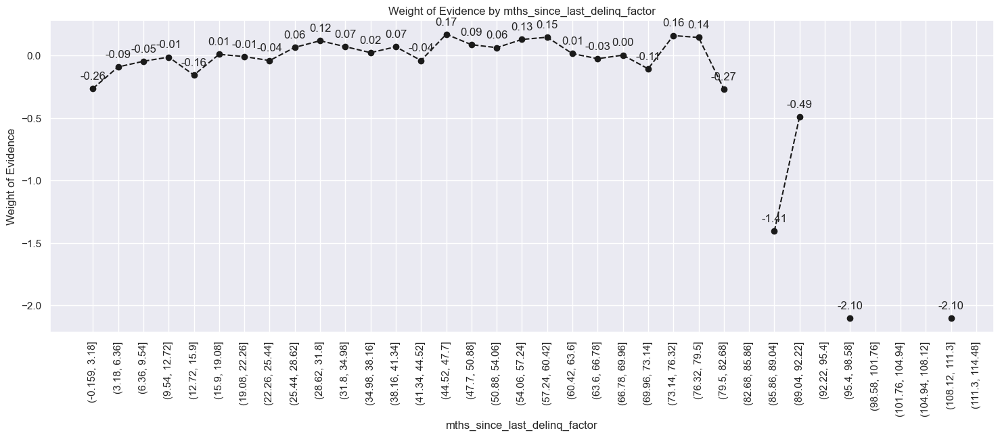

In [284]:
plot_by_woe(df_temp, 90)
# We plot the weight of evidence values.

In [285]:
# Categories: Missing, 0-3, 4-30, 31-56, >=57
df_inputs_prepr['mths_since_last_delinq:Missing'] = np.where((df_inputs_prepr['mths_since_last_delinq'].isnull()), 1, 0)
df_inputs_prepr['mths_since_last_delinq:0-3'] = np.where((df_inputs_prepr['mths_since_last_delinq'] >= 0) & (df_inputs_prepr['mths_since_last_delinq'] <= 3), 1, 0)
df_inputs_prepr['mths_since_last_delinq:4-30'] = np.where((df_inputs_prepr['mths_since_last_delinq'] >= 4) & (df_inputs_prepr['mths_since_last_delinq'] <= 30), 1, 0)
df_inputs_prepr['mths_since_last_delinq:31-56'] = np.where((df_inputs_prepr['mths_since_last_delinq'] >= 31) & (df_inputs_prepr['mths_since_last_delinq'] <= 56), 1, 0)
df_inputs_prepr['mths_since_last_delinq:>=57'] = np.where((df_inputs_prepr['mths_since_last_delinq'] >= 57), 1, 0)

In [286]:
# dti
df_inputs_prepr['dti_factor'] = pd.cut(df_inputs_prepr['dti'], 100)
# Here we do fine-classing: using the 'cut' method, we split the variable into 100 categories by its values.
df_temp = woe_ordered_continuous(df_inputs_prepr, 'dti_factor', df_targets_prepr)
# We calculate weight of evidence.
df_temp

C:\Users\dcgzb\AppData\Local\Temp\ipykernel_10772\1881610760.py:4: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  df = pd.concat([df.groupby(df.columns.values[0], as_index = False)[df.columns.values[1]].count(),
C:\Users\dcgzb\AppData\Local\Temp\ipykernel_10772\1881610760.py:5: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  df.groupby(df.columns.values[0], as_index = False)[df.columns.values[1]].mean()], axis = 1)


,dti_factor,n_obs,prop_good,prop_n_obs,n_good,n_bad,prop_n_good,prop_n_bad,WoE,diff_prop_good,diff_WoE,IV
0,"(-0.04, 0.4]",194,0.881443,0.002080,171.0,23.0,0.002058,0.002268,-0.097310,NaN,NaN,0.037511
1,"(0.4, 0.8]",197,0.898477,0.002113,177.0,20.0,0.002130,0.001972,0.076938,0.017034,0.174248,0.037511
2,"(0.8, 1.2]",215,0.916279,0.002306,197.0,18.0,0.002370,0.001775,0.289352,0.017802,0.212415,0.037511
3,"(1.2, 1.6]",237,0.886076,0.002542,210.0,27.0,0.002527,0.002662,-0.052209,0.030203,0.341561,0.037511
4,"(1.6, 2.0]",292,0.886986,0.003131,259.0,33.0,0.003116,0.003254,-0.043159,0.000910,0.009050,0.037511
5,"(2.0, 2.399]",347,0.925072,0.003721,321.0,26.0,0.003862,0.002564,0.409865,0.038086,0.453024,0.037511
6,"(2.399, 2.799]",383,0.924282,0.004107,354.0,29.0,0.004259,0.002859,0.398521,0.000790,0.011344,0.037511
7,"(2.799, 3.199]",440,0.902273,0.004718,397.0,43.0,0.004777,0.004240,0.119256,0.022009,0.279265,0.037511
8,"(3.199, 3.599]",448,0.915179,0.004804,410.0,38.0,0.004933,0.003747,0.275091,0.012906,0.155835,0.037511
9,"(3.599, 3.999]",543,0.898711,0.005823,488.0,55.0,0.005872,0.005423,0.079502,0.016468,0.195589,0.037511


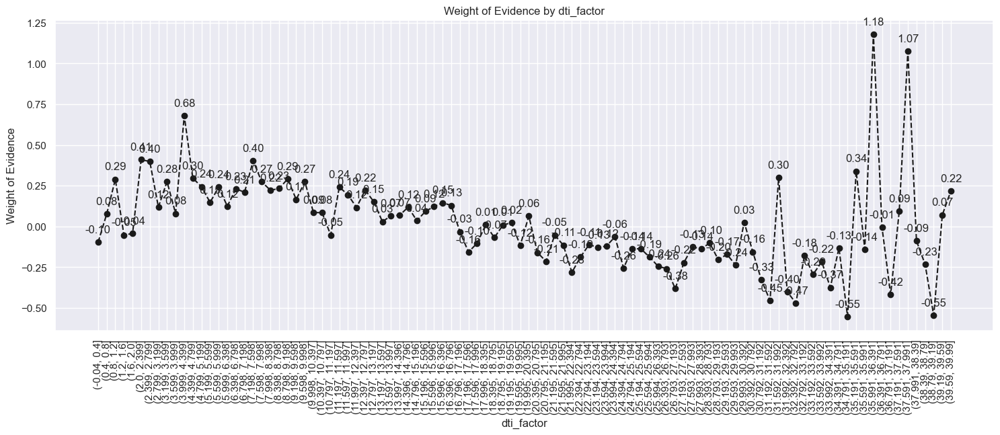

In [288]:
plot_by_woe(df_temp, 90)
# We plot the weight of evidence values.

In [289]:
# Similarly to income, initial examination shows that most values are lower than 200.
# Hence, we are going to have one category for more than 35, and we are going to apply our approach to determine
# the categories of everyone with 150k or less.
df_inputs_prepr_temp = df_inputs_prepr.loc[df_inputs_prepr['dti'] <= 35, : ]

In [290]:
df_inputs_prepr_temp['dti_factor'] = pd.cut(df_inputs_prepr_temp['dti'], 50)
# Here we do fine-classing: using the 'cut' method, we split the variable into 50 categories by its values.
df_temp = woe_ordered_continuous(df_inputs_prepr_temp, 'dti_factor', df_targets_prepr[df_inputs_prepr_temp.index])
# We calculate weight of evidence.
df_temp

C:\Users\dcgzb\AppData\Local\Temp\ipykernel_10772\337294594.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_inputs_prepr_temp['dti_factor'] = pd.cut(df_inputs_prepr_temp['dti'], 50)
C:\Users\dcgzb\AppData\Local\Temp\ipykernel_10772\1881610760.py:4: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  df = pd.concat([df.groupby(df.columns.values[0], as_index = False)[df.columns.values[1]].count(),
C:\Users\dcgzb\AppData\Local\Temp\ipykernel_10772\1881610760.py:5: FutureWarning: The default of observed=False is deprecated and will be changed to True in a futur

,dti_factor,n_obs,prop_good,prop_n_obs,n_good,n_bad,prop_n_good,prop_n_bad,WoE,diff_prop_good,diff_WoE,IV
0,"(-0.035, 0.7]",345,0.892754,0.003729,308.0,37.0,0.003736,0.003675,0.016301,NaN,NaN,0.031815
1,"(0.7, 1.4]",385,0.898701,0.004162,346.0,39.0,0.004197,0.003874,0.079996,0.005948,0.063695,0.031815
2,"(1.4, 2.1]",503,0.898608,0.005437,452.0,51.0,0.005482,0.005066,0.078976,0.000093,0.001021,0.031815
3,"(2.1, 2.8]",645,0.920930,0.006972,594.0,51.0,0.007205,0.005066,0.352173,0.022322,0.273197,0.031815
4,"(2.8, 3.5]",778,0.906170,0.008410,705.0,73.0,0.008551,0.007251,0.164858,0.014761,0.187315,0.031815
5,"(3.5, 4.2]",958,0.916493,0.010355,878.0,80.0,0.010649,0.007947,0.292739,0.010323,0.127882,0.031815
6,"(4.2, 4.9]",1183,0.921386,0.012787,1090.0,93.0,0.013221,0.009238,0.358453,0.004894,0.065714,0.031815
7,"(4.9, 5.6]",1385,0.909747,0.014971,1260.0,125.0,0.015283,0.012417,0.207672,0.011639,0.150780,0.031815
8,"(5.6, 6.3]",1461,0.908966,0.015792,1328.0,133.0,0.016108,0.013211,0.198199,0.000781,0.009473,0.031815
9,"(6.3, 7.0]",1745,0.908309,0.018862,1585.0,160.0,0.019225,0.015894,0.190285,0.000657,0.007914,0.031815


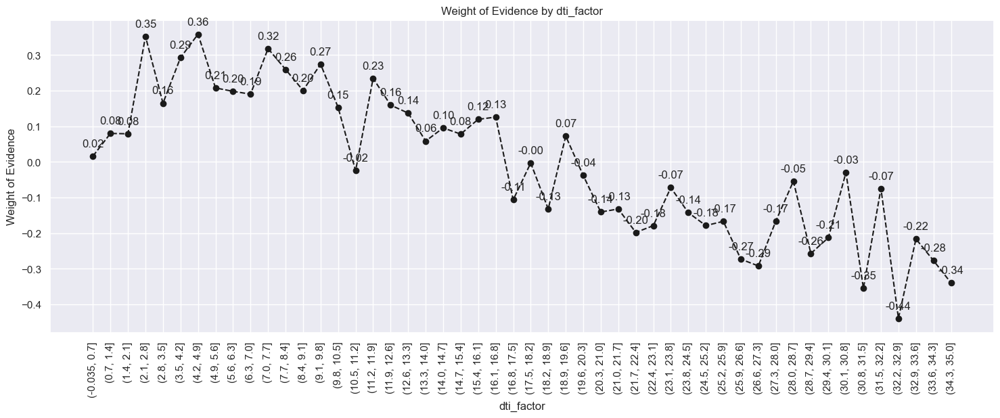

In [291]:
plot_by_woe(df_temp, 90)
# We plot the weight of evidence values.

In [292]:
# Categories:
df_inputs_prepr['dti:<=1.4'] = np.where((df_inputs_prepr['dti'] <= 1.4), 1, 0)
df_inputs_prepr['dti:1.4-3.5'] = np.where((df_inputs_prepr['dti'] > 1.4) & (df_inputs_prepr['dti'] <= 3.5), 1, 0)
df_inputs_prepr['dti:3.5-7.7'] = np.where((df_inputs_prepr['dti'] > 3.5) & (df_inputs_prepr['dti'] <= 7.7), 1, 0)
df_inputs_prepr['dti:7.7-10.5'] = np.where((df_inputs_prepr['dti'] > 7.7) & (df_inputs_prepr['dti'] <= 10.5), 1, 0)
df_inputs_prepr['dti:10.5-16.1'] = np.where((df_inputs_prepr['dti'] > 10.5) & (df_inputs_prepr['dti'] <= 16.1), 1, 0)
df_inputs_prepr['dti:16.1-20.3'] = np.where((df_inputs_prepr['dti'] > 16.1) & (df_inputs_prepr['dti'] <= 20.3), 1, 0)
df_inputs_prepr['dti:20.3-21.7'] = np.where((df_inputs_prepr['dti'] > 20.3) & (df_inputs_prepr['dti'] <= 21.7), 1, 0)
df_inputs_prepr['dti:21.7-22.4'] = np.where((df_inputs_prepr['dti'] > 21.7) & (df_inputs_prepr['dti'] <= 22.4), 1, 0)
df_inputs_prepr['dti:22.4-35'] = np.where((df_inputs_prepr['dti'] > 22.4) & (df_inputs_prepr['dti'] <= 35), 1, 0)
df_inputs_prepr['dti:>35'] = np.where((df_inputs_prepr['dti'] > 35), 1, 0)

C:\Users\dcgzb\AppData\Local\Temp\ipykernel_10772\284476014.py:6: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_inputs_prepr['dti:10.5-16.1'] = np.where((df_inputs_prepr['dti'] > 10.5) & (df_inputs_prepr['dti'] <= 16.1), 1, 0)
C:\Users\dcgzb\AppData\Local\Temp\ipykernel_10772\284476014.py:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_inputs_prepr['dti:16.1-20.3'] = np.where((df_inputs_prepr['dti'] > 16.1) & (df_inputs_prepr['dti'] <= 20.3), 1, 0)
C:\Users\dcgzb\AppData\Local\Temp\ipykernel_10772\284476014.py:8: Performa

In [293]:
# mths_since_last_record
# We have to create one category for missing values and do fine and coarse classing for the rest.
df_inputs_prepr_temp = df_inputs_prepr[pd.notnull(df_inputs_prepr['mths_since_last_record'])]
#sum(loan_data_temp['mths_since_last_record'].isnull())
df_inputs_prepr_temp['mths_since_last_record_factor'] = pd.cut(df_inputs_prepr_temp['mths_since_last_record'], 50)
# Here we do fine-classing: using the 'cut' method, we split the variable into 50 categories by its values.
df_temp = woe_ordered_continuous(df_inputs_prepr_temp, 'mths_since_last_record_factor', df_targets_prepr[df_inputs_prepr_temp.index])
# We calculate weight of evidence.
df_temp

C:\Users\dcgzb\AppData\Local\Temp\ipykernel_10772\3035104871.py:5: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_inputs_prepr_temp['mths_since_last_record_factor'] = pd.cut(df_inputs_prepr_temp['mths_since_last_record'], 50)
C:\Users\dcgzb\AppData\Local\Temp\ipykernel_10772\3035104871.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_inputs_prepr_temp['mths_since_last_record_factor'] = pd.cut(df_inputs_prepr_temp['mths_since_last_record'], 50)
C:\Users\dcgzb\AppData\Local\Temp\ipykernel_10772\1881610760.py:4: 

,mths_since_last_record_factor,n_obs,prop_good,prop_n_obs,n_good,n_bad,prop_n_good,prop_n_bad,WoE,diff_prop_good,diff_WoE,IV
0,"(-0.129, 2.58]",250,0.748000,0.020085,187.0,63.0,0.016741,0.049334,-1.080744,NaN,NaN,inf
1,"(2.58, 5.16]",23,0.956522,0.001848,22.0,1.0,0.001970,0.000783,0.922324,0.208522,2.003069,inf
2,"(5.16, 7.74]",30,0.900000,0.002410,27.0,3.0,0.002417,0.002349,0.028507,0.056522,0.893818,inf
3,"(7.74, 10.32]",49,0.877551,0.003937,43.0,6.0,0.003850,0.004699,-0.199277,0.022449,0.227784,inf
4,"(10.32, 12.9]",50,0.900000,0.004017,45.0,5.0,0.004029,0.003915,0.028507,0.022449,0.227784,inf
5,"(12.9, 15.48]",95,0.905263,0.007632,86.0,9.0,0.007699,0.007048,0.088405,0.005263,0.059898,inf
6,"(15.48, 18.06]",97,0.927835,0.007793,90.0,7.0,0.008057,0.005482,0.385181,0.022572,0.296777,inf
7,"(18.06, 20.64]",57,0.947368,0.004579,54.0,3.0,0.004834,0.002349,0.721654,0.019533,0.336472,inf
8,"(20.64, 23.22]",97,0.896907,0.007793,87.0,10.0,0.007789,0.007831,-0.005395,0.050461,0.727049,inf
9,"(23.22, 25.8]",71,0.901408,0.005704,64.0,7.0,0.005730,0.005482,0.044255,0.004501,0.049650,inf


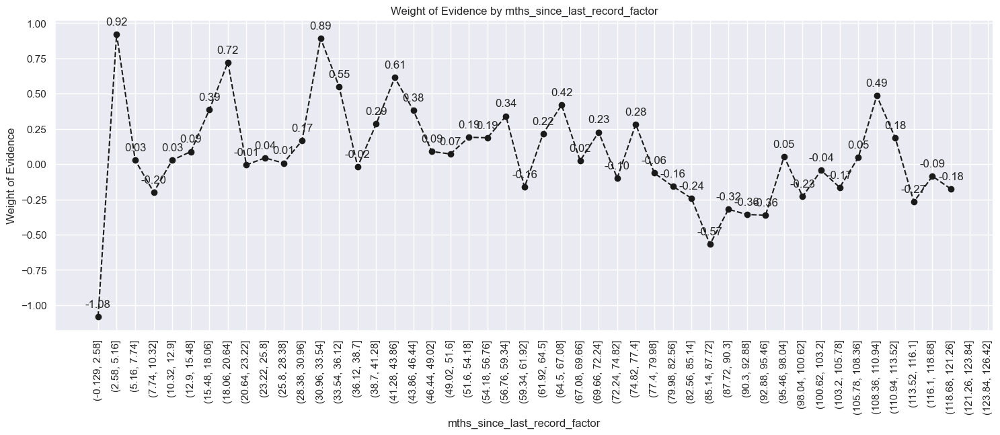

In [294]:
plot_by_woe(df_temp, 90)
# We plot the weight of evidence values.

In [295]:
# Categories: 'Missing', '0-2', '3-20', '21-31', '32-80', '81-86', '>86'
df_inputs_prepr['mths_since_last_record:Missing'] = np.where((df_inputs_prepr['mths_since_last_record'].isnull()), 1, 0)
df_inputs_prepr['mths_since_last_record:0-2'] = np.where((df_inputs_prepr['mths_since_last_record'] >= 0) & (df_inputs_prepr['mths_since_last_record'] <= 2), 1, 0)
df_inputs_prepr['mths_since_last_record:3-20'] = np.where((df_inputs_prepr['mths_since_last_record'] >= 3) & (df_inputs_prepr['mths_since_last_record'] <= 20), 1, 0)
df_inputs_prepr['mths_since_last_record:21-31'] = np.where((df_inputs_prepr['mths_since_last_record'] >= 21) & (df_inputs_prepr['mths_since_last_record'] <= 31), 1, 0)
df_inputs_prepr['mths_since_last_record:32-80'] = np.where((df_inputs_prepr['mths_since_last_record'] >= 32) & (df_inputs_prepr['mths_since_last_record'] <= 80), 1, 0)
df_inputs_prepr['mths_since_last_record:81-86'] = np.where((df_inputs_prepr['mths_since_last_record'] >= 81) & (df_inputs_prepr['mths_since_last_record'] <= 86), 1, 0)
df_inputs_prepr['mths_since_last_record:>86'] = np.where((df_inputs_prepr['mths_since_last_record'] > 86), 1, 0)

C:\Users\dcgzb\AppData\Local\Temp\ipykernel_10772\1059239224.py:2: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_inputs_prepr['mths_since_last_record:Missing'] = np.where((df_inputs_prepr['mths_since_last_record'].isnull()), 1, 0)
C:\Users\dcgzb\AppData\Local\Temp\ipykernel_10772\1059239224.py:3: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_inputs_prepr['mths_since_last_record:0-2'] = np.where((df_inputs_prepr['mths_since_last_record'] >= 0) & (df_inputs_prepr['mths_since_last_record'] <= 2), 1, 0)
C:\Users\dcgzb\AppData\

In [297]:
X_test = df_inputs_prepr

In [298]:
X_test.to_csv('X_test.csv')
y_test.to_csv('y_test.csv')

In [299]:
X_test.shape


(93252, 324)

## Model Building

In [300]:
loan_data_inputs_train = pd.read_csv('X_train.csv', index_col = 0, low_memory=False)
loan_data_targets_train = pd.read_csv('y_train.csv', index_col = 0,  low_memory=False)
loan_data_inputs_test = pd.read_csv('X_test.csv', index_col = 0, low_memory=False)
loan_data_targets_test = pd.read_csv('y_test.csv', index_col = 0,  low_memory=False)

In [301]:
loan_data_inputs_train.shape

(373004, 324)

In [302]:
loan_data_targets_train.shape

(373004, 1)

In [303]:
loan_data_inputs_test.shape

(93252, 324)

In [304]:
loan_data_targets_test.shape

(93252, 1)

### Selecting the Features

In [305]:
# Here we select a limited set of input variables in a new dataframe.
inputs_train_with_ref_cat = loan_data_inputs_train.loc[: , ['grade:A',
'grade:B',
'grade:C',
'grade:D',
'grade:E',
'grade:F',
'grade:G',
'home_ownership:RENT_OTHER_NONE_ANY',
'home_ownership:OWN',
'home_ownership:MORTGAGE',
'addr_state:ND_NE_IA_NV_FL_HI_AL',
'addr_state:NM_VA',
'addr_state:NY',
'addr_state:OK_TN_MO_LA_MD_NC',
'addr_state:CA',
'addr_state:UT_KY_AZ_NJ',
'addr_state:AR_MI_PA_OH_MN',
'addr_state:RI_MA_DE_SD_IN',
'addr_state:GA_WA_OR',
'addr_state:WI_MT',
'addr_state:TX',
'addr_state:IL_CT',
'addr_state:KS_SC_CO_VT_AK_MS',
'addr_state:WV_NH_WY_DC_ME_ID',
'verification_status:Not Verified',
'verification_status:Source Verified',
'verification_status:Verified',
'purpose:educ__sm_b__wedd__ren_en__mov__house',
'purpose:credit_card',
'purpose:debt_consolidation',
'purpose:oth__med__vacation',
'purpose:major_purch__car__home_impr',
'initial_list_status:f',
'initial_list_status:w',
'term:36',
'term:60',
'emp_length:0',
'emp_length:1',
'emp_length:2-4',
'emp_length:5-6',
'emp_length:7-9',
'emp_length:10',
'mths_since_issue_d:<38',
'mths_since_issue_d:38-39',
'mths_since_issue_d:40-41',
'mths_since_issue_d:42-48',
'mths_since_issue_d:49-52',
'mths_since_issue_d:53-64',
'mths_since_issue_d:65-84',
'mths_since_issue_d:>84',
'int_rate:<9.548',
'int_rate:9.548-12.025',
'int_rate:12.025-15.74',
'int_rate:15.74-20.281',
'int_rate:>20.281',
'mths_since_earliest_cr_line:<140',
'mths_since_earliest_cr_line:141-164',
'mths_since_earliest_cr_line:165-247',
'mths_since_earliest_cr_line:248-270',
'mths_since_earliest_cr_line:271-352',
'mths_since_earliest_cr_line:>352',
'delinq_2yrs:0',
'delinq_2yrs:1-3',
'delinq_2yrs:>=4',
'inq_last_6mths:0',
'inq_last_6mths:1-2',
'inq_last_6mths:3-6',
'inq_last_6mths:>6',
'open_acc:0',
'open_acc:1-3',
'open_acc:4-12',
'open_acc:13-17',
'open_acc:18-22',
'open_acc:23-25',
'open_acc:26-30',
'open_acc:>=31',
'pub_rec:0-2',
'pub_rec:3-4',
'pub_rec:>=5',
'total_acc:<=27',
'total_acc:28-51',
'total_acc:>=52',
'acc_now_delinq:0',
'acc_now_delinq:>=1',
'total_rev_hi_lim:<=5K',
'total_rev_hi_lim:5K-10K',
'total_rev_hi_lim:10K-20K',
'total_rev_hi_lim:20K-30K',
'total_rev_hi_lim:30K-40K',
'total_rev_hi_lim:40K-55K',
'total_rev_hi_lim:55K-95K',
'total_rev_hi_lim:>95K',
'annual_inc:<20K',
'annual_inc:20K-30K',
'annual_inc:30K-40K',
'annual_inc:40K-50K',
'annual_inc:50K-60K',
'annual_inc:60K-70K',
'annual_inc:70K-80K',
'annual_inc:80K-90K',
'annual_inc:90K-100K',
'annual_inc:100K-120K',
'annual_inc:120K-140K',
'annual_inc:>140K',
'dti:<=1.4',
'dti:1.4-3.5',
'dti:3.5-7.7',
'dti:7.7-10.5',
'dti:10.5-16.1',
'dti:16.1-20.3',
'dti:20.3-21.7',
'dti:21.7-22.4',
'dti:22.4-35',
'dti:>35',
'mths_since_last_delinq:Missing',
'mths_since_last_delinq:0-3',
'mths_since_last_delinq:4-30',
'mths_since_last_delinq:31-56',
'mths_since_last_delinq:>=57',
'mths_since_last_record:Missing',
'mths_since_last_record:0-2',
'mths_since_last_record:3-20',
'mths_since_last_record:21-31',
'mths_since_last_record:32-80',
'mths_since_last_record:81-86',
'mths_since_last_record:>86',
]]

In [306]:
# Here we store the names of the reference category dummy variables in a list.
ref_categories = ['grade:G',
'home_ownership:RENT_OTHER_NONE_ANY',
'addr_state:ND_NE_IA_NV_FL_HI_AL',
'verification_status:Verified',
'purpose:educ__sm_b__wedd__ren_en__mov__house',
'initial_list_status:f',
'term:60',
'emp_length:0',
'mths_since_issue_d:>84',
'int_rate:>20.281',
'mths_since_earliest_cr_line:<140',
'delinq_2yrs:>=4',
'inq_last_6mths:>6',
'open_acc:0',
'pub_rec:0-2',
'total_acc:<=27',
'acc_now_delinq:0',
'total_rev_hi_lim:<=5K',
'annual_inc:<20K',
'dti:>35',
'mths_since_last_delinq:0-3',
'mths_since_last_record:0-2']

In [307]:
inputs_train = inputs_train_with_ref_cat.drop(ref_categories, axis = 1)
# From the dataframe with input variables, we drop the variables with variable names in the list with reference categories. 
inputs_train.head()

,grade:A,grade:B,grade:C,grade:D,grade:E,grade:F,home_ownership:OWN,home_ownership:MORTGAGE,addr_state:NM_VA,addr_state:NY,addr_state:OK_TN_MO_LA_MD_NC,addr_state:CA,addr_state:UT_KY_AZ_NJ,addr_state:AR_MI_PA_OH_MN,addr_state:RI_MA_DE_SD_IN,addr_state:GA_WA_OR,addr_state:WI_MT,addr_state:TX,addr_state:IL_CT,addr_state:KS_SC_CO_VT_AK_MS,addr_state:WV_NH_WY_DC_ME_ID,verification_status:Not Verified,verification_status:Source Verified,purpose:credit_card,purpose:debt_consolidation,purpose:oth__med__vacation,purpose:major_purch__car__home_impr,initial_list_status:w,term:36,emp_length:1,emp_length:2-4,emp_length:5-6,emp_length:7-9,emp_length:10,mths_since_issue_d:<38,mths_since_issue_d:38-39,mths_since_issue_d:40-41,mths_since_issue_d:42-48,mths_since_issue_d:49-52,mths_since_issue_d:53-64,mths_since_issue_d:65-84,int_rate:<9.548,int_rate:9.548-12.025,int_rate:12.025-15.74,int_rate:15.74-20.281,mths_since_earliest_cr_line:141-164,mths_since_earliest_cr_line:165-247,mths_since_earliest_cr_line:248-270,mths_since_earliest_cr_line:271-352,mths_since_earliest_cr_line:>352,delinq_2yrs:0,delinq_2yrs:1-3,inq_last_6mths:0,inq_last_6mths:1-2,inq_last_6mths:3-6,open_acc:1-3,open_acc:4-12,open_acc:13-17,open_acc:18-22,open_acc:23-25,open_acc:26-30,open_acc:>=31,pub_rec:3-4,pub_rec:>=5,total_acc:28-51,total_acc:>=52,acc_now_delinq:>=1,total_rev_hi_lim:5K-10K,total_rev_hi_lim:10K-20K,total_rev_hi_lim:20K-30K,total_rev_hi_lim:30K-40K,total_rev_hi_lim:40K-55K,total_rev_hi_lim:55K-95K,total_rev_hi_lim:>95K,annual_inc:20K-30K,annual_inc:30K-40K,annual_inc:40K-50K,annual_inc:50K-60K,annual_inc:60K-70K,annual_inc:70K-80K,annual_inc:80K-90K,annual_inc:90K-100K,annual_inc:100K-120K,annual_inc:120K-140K,annual_inc:>140K,dti:<=1.4,dti:1.4-3.5,dti:3.5-7.7,dti:7.7-10.5,dti:10.5-16.1,dti:16.1-20.3,dti:20.3-21.7,dti:21.7-22.4,dti:22.4-35,mths_since_last_delinq:Missing,mths_since_last_delinq:4-30,mths_since_last_delinq:31-56,mths_since_last_delinq:>=57,mths_since_last_record:Missing,mths_since_last_record:3-20,mths_since_last_record:21-31,mths_since_last_record:32-80,mths_since_last_record:81-86,mths_since_last_record:>86
431128,False,True,False,False,False,False,False,True,0,False,0,False,0,0,0,0,0,True,0,0,0,False,True,False,True,0,0,False,1,0,0,0,0,1,0,0,0,1,0,0,0,0,1,0,0,0,0,0,1,0,1,0,0,1,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,1,0,1,0,0,0,0,0
413015,False,False,False,True,False,False,False,False,1,False,0,False,0,0,0,0,0,False,0,0,0,False,False,False,True,0,0,True,0,0,1,0,0,0,0,0,0,1,0,0,0,0,0,0,1,1,0,0,0,0,1,0,1,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,1,0,0,0,1,0,0,0,1,0,0,0,0,0
90236,False,False,False,False,False,True,False,True,0,False,0,False,1,0,0,0,0,False,0,0,0,False,False,False,True,0,0,True,0,0,0,0,0,1,0,0,0,0,1,0,0,0,0,0,0,0,0,1,0,0,0,1,0,1,0,0,1,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,1,0,0,1,0,0,0,0,0
122060,False,True,False,False,False,False,False,False,0,False,0,False,1,0,0,0,0,False,0,0,0,True,False,False,True,0,0,True,1,0,1,0,0,0,0,0,0,0,0,1,0,0,0,1,0,1,0,0,0,0,1,0,1,0,0,0,1,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,1,0,0,1,0,0,0,0,0
41491,False,True,False,False,False,False,False,True,0,False,0,False,0,0,0,0,0,False,1,0,0,True,False,False,False,1,0,False,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,1,0,0,0,1,0,0,0,1,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,1,0,0,0,1,0,0,0,0,0


### PD Model Estimation

#### Logistic Regression

In [308]:
from sklearn.linear_model import LogisticRegression
from sklearn import metrics

In [309]:
reg = LogisticRegression()
# We create an instance of an object from the 'LogisticRegression' class.

In [310]:
pd.options.display.max_rows = None
# Sets the pandas dataframe options to display all columns/ rows.

In [311]:
reg.fit(inputs_train, loan_data_targets_train)
# Estimates the coefficients of the object from the 'LogisticRegression' class
# with inputs (independent variables) contained in the first dataframe
# and targets (dependent variables) contained in the second dataframe.

F:\anaconda3\envs\Udemycreditriskmodel\lib\site-packages\sklearn\utils\validation.py:1184: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
F:\anaconda3\envs\Udemycreditriskmodel\lib\site-packages\sklearn\linear_model\_logistic.py:460: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


LogisticRegression()

In [312]:
reg.intercept_
# Displays the intercept contain in the estimated ("fitted") object from the 'LogisticRegression' class.

array([-1.40703316])

In [313]:
reg.coef_
# Displays the coefficients contained in the estimated ("fitted") object from the 'LogisticRegression' class.

array([[ 1.09294644e+00,  8.59977501e-01,  6.62230494e-01,
         4.80972470e-01,  3.16396664e-01,  1.63005293e-01,
         7.22245120e-02,  1.09199320e-01,  5.17106578e-02,
         6.31831309e-02,  6.96049774e-02,  7.75255570e-02,
         7.92945822e-02,  1.48318889e-01,  1.20015105e-01,
         1.77973785e-01,  2.71360688e-01,  2.62822652e-01,
         2.89539879e-01,  3.43727864e-01,  5.24350854e-01,
         8.78158561e-02, -1.23341014e-02,  3.25582526e-01,
         2.00626057e-01,  2.20152280e-01,  2.88127818e-01,
         4.97652481e-02,  7.71121379e-02,  1.13625160e-01,
         1.37521480e-01,  1.03203136e-01,  7.37578350e-02,
         1.36064062e-01,  1.11058253e+00,  8.82459090e-01,
         8.02985783e-01,  5.65143984e-01,  4.20327251e-01,
         1.75713639e-01, -7.95431865e-02,  9.32349400e-01,
         5.84875694e-01,  3.29795864e-01,  1.22597942e-01,
         6.21055347e-02,  3.48654808e-02,  6.71528525e-02,
         1.16961727e-01,  1.12108216e-01,  8.44326567e-0

In [314]:
feature_name = inputs_train.columns.values
# Stores the names of the columns of a dataframe in a variable.

In [315]:
summary_table = pd.DataFrame(columns = ['Feature name'], data = feature_name)
# Creates a dataframe with a column titled 'Feature name' and row values contained in the 'feature_name' variable.
summary_table['Coefficients'] = np.transpose(reg.coef_)
# Creates a new column in the dataframe, called 'Coefficients',
# with row values the transposed coefficients from the 'LogisticRegression' object.
summary_table.index = summary_table.index + 1
# Increases the index of every row of the dataframe with 1.
summary_table.loc[0] = ['Intercept', reg.intercept_[0]]
# Assigns values of the row with index 0 of the dataframe.
summary_table = summary_table.sort_index()
# Sorts the dataframe by index.
summary_table

,Feature name,Coefficients
0,Intercept,-1.407033
1,grade:A,1.092946
2,grade:B,0.859978
3,grade:C,0.662230
4,grade:D,0.480972
5,grade:E,0.316397
6,grade:F,0.163005
7,home_ownership:OWN,0.072225
8,home_ownership:MORTGAGE,0.109199
9,addr_state:NM_VA,0.051711


#### Build a Logistic Regression Model with P-Values

In [316]:
# P values for sklearn logistic regression.

# Class to display p-values for logistic regression in sklearn.

from sklearn import linear_model
import scipy.stats as stat

class LogisticRegression_with_p_values:
    
    def __init__(self,*args,**kwargs):#,**kwargs):
        self.model = linear_model.LogisticRegression(*args,**kwargs)#,**args)

    def fit(self,X,y):
        self.model.fit(X,y)
        
        #### Get p-values for the fitted model ####
        denom = (2.0 * (1.0 + np.cosh(self.model.decision_function(X))))
        denom = np.tile(denom,(X.shape[1],1)).T
        F_ij = np.dot((X.astype(np.float64) / denom).T, X.astype(np.float64))  # Ensure X is of dtype float64
        Cramer_Rao = np.linalg.inv(F_ij)
        # F_ij = np.dot((X / denom).T,X) ## Fisher Information Matrix
        # Cramer_Rao = np.linalg.inv(F_ij) ## Inverse Information Matrix
        sigma_estimates = np.sqrt(np.diagonal(Cramer_Rao))
        z_scores = self.model.coef_[0] / sigma_estimates # z-score for eaach model coefficient
        p_values = [stat.norm.sf(abs(x)) * 2 for x in z_scores] ### two tailed test for p-values
        
        self.coef_ = self.model.coef_
        self.intercept_ = self.model.intercept_
        self.p_values = p_values

In [317]:
reg = LogisticRegression_with_p_values()
# We create an instance of an object from the newly created 'LogisticRegression_with_p_values()' class.

In [318]:
pd.set_option('display.max_rows', None)

In [319]:
reg.fit(inputs_train, loan_data_targets_train)
# Estimates the coefficients of the object from the 'LogisticRegression' class
# with inputs (independent variables) contained in the first dataframe
# and targets (dependent variables) contained in the second dataframe.

F:\anaconda3\envs\Udemycreditriskmodel\lib\site-packages\sklearn\utils\validation.py:1184: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
F:\anaconda3\envs\Udemycreditriskmodel\lib\site-packages\sklearn\linear_model\_logistic.py:460: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


In [320]:
# Same as above.
summary_table = pd.DataFrame(columns = ['Feature name'], data = feature_name)
summary_table['Coefficients'] = np.transpose(reg.coef_)
summary_table.index = summary_table.index + 1
summary_table.loc[0] = ['Intercept', reg.intercept_[0]]
summary_table = summary_table.sort_index()
summary_table

,Feature name,Coefficients
0,Intercept,-1.407033
1,grade:A,1.092946
2,grade:B,0.859978
3,grade:C,0.662230
4,grade:D,0.480972
5,grade:E,0.316397
6,grade:F,0.163005
7,home_ownership:OWN,0.072225
8,home_ownership:MORTGAGE,0.109199
9,addr_state:NM_VA,0.051711


In [321]:
# This is a list.
p_values = reg.p_values
# We take the result of the newly added method 'p_values' and store it in a variable 'p_values'.

In [322]:
# Add the intercept for completeness.
p_values = np.append(np.nan, np.array(p_values))
# We add the value 'NaN' in the beginning of the variable with p-values.

In [323]:
summary_table['p_values'] = p_values
# In the 'summary_table' dataframe, we add a new column, called 'p_values', containing the values from the 'p_values' variable.

In [324]:
summary_table['significant'] = np.where(summary_table['p_values'] < 0.05, 'True', 'False')
summary_table.sample(5)

,Feature name,Coefficients,p_values,significant
48,mths_since_earliest_cr_line:248-270,0.067153,1.234102e-02,True
100,mths_since_last_record:3-20,0.432079,5.890733e-04,True
31,emp_length:2-4,0.137521,2.900340e-13,True
86,dti:<=1.4,0.263426,2.906226e-03,True
76,annual_inc:30K-40K,0.030165,4.624318e-01,False


In [325]:
# Extract the characters before ':' and group by them
summary_table['Group'] = summary_table['Feature name'].str.split(':').str[0]
summary_table.sample(5)

,Feature name,Coefficients,p_values,significant,Group
67,acc_now_delinq:>=1,0.160869,1.226737e-01,False,acc_now_delinq
18,addr_state:TX,0.262823,7.205242e-24,True,addr_state
65,total_acc:28-51,-0.038129,7.258610e-03,True,total_acc
77,annual_inc:40K-50K,0.130544,1.497500e-03,True,annual_inc
93,dti:21.7-22.4,0.139002,4.317972e-02,True,dti


In [326]:
# Count the 'True' values for each group
group_counts = summary_table.groupby('Group')['significant'].sum().reset_index()
group_counts.sample(5)

,Group,significant
2,addr_state,FalseTrueTrueTrueTrueTrueTrueTrueTrueTrueTrueT...
11,int_rate,TrueTrueTrueTrue
21,total_rev_hi_lim,FalseFalseFalseFalseFalseFalseTrue
15,mths_since_last_record,TrueTrueTrueTrueTrueTrue
7,grade,TrueTrueTrueTrueTrueTrue


In [327]:
group_counts['trueornot'] = np.where(group_counts['significant'].str.contains('True'), 1 ,0)
group_counts.sample(5)

,Group,significant,trueornot
18,purpose,TrueTrueTrueTrue,1
16,open_acc,FalseFalseFalseFalseFalseFalseFalse,0
6,emp_length,TrueTrueTrueTrueTrue,1
15,mths_since_last_record,TrueTrueTrueTrueTrueTrue,1
14,mths_since_last_delinq,FalseTrueTrueFalse,1


In [328]:
summary_tab = summary_table.merge(group_counts, left_on='Group', right_on='Group', how='left')
summary_tab.sample(5)

,Feature name,Coefficients,p_values,significant_x,Group,significant_y,trueornot
59,open_acc:18-22,-0.176317,0.293109,False,open_acc,FalseFalseFalseFalseFalseFalseFalse,0
64,pub_rec:>=5,0.044455,0.802416,False,pub_rec,FalseFalse,0
86,dti:<=1.4,0.263426,0.002906,True,dti,TrueTrueTrueTrueTrueTrueTrueTrueFalse,1
103,mths_since_last_record:81-86,0.290970,0.006593,True,mths_since_last_record,TrueTrueTrueTrueTrueTrue,1
70,total_rev_hi_lim:20K-30K,0.010861,0.678883,False,total_rev_hi_lim,FalseFalseFalseFalseFalseFalseTrue,1


In [329]:
# summary_tab.drop(columns=['significant_y'], inplace=True)
summary_tab.rename(columns={'significant_x':'significant'}, inplace = True)


In [330]:
summary_tab

,Feature name,Coefficients,p_values,significant,Group,significant_y,trueornot
0,Intercept,-1.407033,NaN,False,Intercept,False,0
1,grade:A,1.092946,7.785961e-33,True,grade,TrueTrueTrueTrueTrueTrue,1
2,grade:B,0.859978,9.170083e-45,True,grade,TrueTrueTrueTrueTrueTrue,1
3,grade:C,0.662230,2.132510e-31,True,grade,TrueTrueTrueTrueTrueTrue,1
4,grade:D,0.480972,5.205226e-19,True,grade,TrueTrueTrueTrueTrueTrue,1
5,grade:E,0.316397,5.820160e-11,True,grade,TrueTrueTrueTrueTrueTrue,1
6,grade:F,0.163005,1.231920e-03,True,grade,TrueTrueTrueTrueTrueTrue,1
7,home_ownership:OWN,0.072225,3.171764e-04,True,home_ownership,TrueTrue,1
8,home_ownership:MORTGAGE,0.109199,8.724547e-18,True,home_ownership,TrueTrue,1
9,addr_state:NM_VA,0.051711,1.060834e-01,False,addr_state,FalseTrueTrueTrueTrueTrueTrueTrueTrueTrueTrueT...,1


In [331]:
# Group by 'Group' and count 'True' and 'False' in 'significant' column
grouped_counts = summary_tab.groupby(['Group', 'significant'])['Feature name'].count().unstack(fill_value=0)

# Rename columns for clarity
grouped_counts.columns = ['False_count', 'True_count']

# Reset the index to make 'Group' a regular column
grouped_counts = grouped_counts.reset_index()

In [332]:
grouped_counts

,Group,False_count,True_count
0,Intercept,1,0
1,acc_now_delinq,1,0
2,addr_state,1,12
3,annual_inc,2,9
4,delinq_2yrs,2,0
5,dti,1,8
6,emp_length,0,5
7,grade,0,6
8,home_ownership,0,2
9,initial_list_status,0,1


In [333]:
summary_tab = summary_tab.merge(grouped_counts, left_on='Group', right_on='Group', how='left')
summary_tab

,Feature name,Coefficients,p_values,significant,Group,significant_y,trueornot,False_count,True_count
0,Intercept,-1.407033,NaN,False,Intercept,False,0,1,0
1,grade:A,1.092946,7.785961e-33,True,grade,TrueTrueTrueTrueTrueTrue,1,0,6
2,grade:B,0.859978,9.170083e-45,True,grade,TrueTrueTrueTrueTrueTrue,1,0,6
3,grade:C,0.662230,2.132510e-31,True,grade,TrueTrueTrueTrueTrueTrue,1,0,6
4,grade:D,0.480972,5.205226e-19,True,grade,TrueTrueTrueTrueTrueTrue,1,0,6
5,grade:E,0.316397,5.820160e-11,True,grade,TrueTrueTrueTrueTrueTrue,1,0,6
6,grade:F,0.163005,1.231920e-03,True,grade,TrueTrueTrueTrueTrueTrue,1,0,6
7,home_ownership:OWN,0.072225,3.171764e-04,True,home_ownership,TrueTrue,1,0,2
8,home_ownership:MORTGAGE,0.109199,8.724547e-18,True,home_ownership,TrueTrue,1,0,2
9,addr_state:NM_VA,0.051711,1.060834e-01,False,addr_state,FalseTrueTrueTrueTrueTrueTrueTrueTrueTrueTrueT...,1,1,12


In [334]:
grouped_counts = summary_tab.groupby('Group')['Feature name'].count()
# Rename columns for clarity
grouped_counts.columns = ['groupcount']
# Reset the index to make 'Group' a regular column
grouped_counts = grouped_counts.reset_index()
grouped_counts.rename(columns={'Feature name':'groupcount'}, inplace = True)
grouped_counts

,Group,groupcount
0,Intercept,1
1,acc_now_delinq,1
2,addr_state,13
3,annual_inc,11
4,delinq_2yrs,2
5,dti,9
6,emp_length,5
7,grade,6
8,home_ownership,2
9,initial_list_status,1


In [335]:
summary_tab = summary_tab.merge(grouped_counts, left_on='Group', right_on='Group', how='left')
summary_tab

,Feature name,Coefficients,p_values,significant,Group,significant_y,trueornot,False_count,True_count,groupcount
0,Intercept,-1.407033,NaN,False,Intercept,False,0,1,0,1
1,grade:A,1.092946,7.785961e-33,True,grade,TrueTrueTrueTrueTrueTrue,1,0,6,6
2,grade:B,0.859978,9.170083e-45,True,grade,TrueTrueTrueTrueTrueTrue,1,0,6,6
3,grade:C,0.662230,2.132510e-31,True,grade,TrueTrueTrueTrueTrueTrue,1,0,6,6
4,grade:D,0.480972,5.205226e-19,True,grade,TrueTrueTrueTrueTrueTrue,1,0,6,6
5,grade:E,0.316397,5.820160e-11,True,grade,TrueTrueTrueTrueTrueTrue,1,0,6,6
6,grade:F,0.163005,1.231920e-03,True,grade,TrueTrueTrueTrueTrueTrue,1,0,6,6
7,home_ownership:OWN,0.072225,3.171764e-04,True,home_ownership,TrueTrue,1,0,2,2
8,home_ownership:MORTGAGE,0.109199,8.724547e-18,True,home_ownership,TrueTrue,1,0,2,2
9,addr_state:NM_VA,0.051711,1.060834e-01,False,addr_state,FalseTrueTrueTrueTrueTrueTrueTrueTrueTrueTrueT...,1,1,12,13


In [336]:
summary_tab.columns

Index(['Feature name', 'Coefficients', 'p_values', 'significant', 'Group',
       'significant_y', 'trueornot', 'False_count', 'True_count',
       'groupcount'],
      dtype='object')

In [337]:
summary_tab[summary_tab['Group']=='total_rev_hi_lim']

,Feature name,Coefficients,p_values,significant,Group,significant_y,trueornot,False_count,True_count,groupcount
68,total_rev_hi_lim:5K-10K,0.022258,0.365149,False,total_rev_hi_lim,FalseFalseFalseFalseFalseFalseTrue,1,6,1,7
69,total_rev_hi_lim:10K-20K,0.008220,0.730401,False,total_rev_hi_lim,FalseFalseFalseFalseFalseFalseTrue,1,6,1,7
70,total_rev_hi_lim:20K-30K,0.010861,0.678883,False,total_rev_hi_lim,FalseFalseFalseFalseFalseFalseTrue,1,6,1,7
71,total_rev_hi_lim:30K-40K,0.000499,0.986460,False,total_rev_hi_lim,FalseFalseFalseFalseFalseFalseTrue,1,6,1,7
72,total_rev_hi_lim:40K-55K,0.054228,0.092618,False,total_rev_hi_lim,FalseFalseFalseFalseFalseFalseTrue,1,6,1,7
73,total_rev_hi_lim:55K-95K,0.063685,0.077096,False,total_rev_hi_lim,FalseFalseFalseFalseFalseFalseTrue,1,6,1,7
74,total_rev_hi_lim:>95K,0.193820,0.000611,True,total_rev_hi_lim,FalseFalseFalseFalseFalseFalseTrue,1,6,1,7


In [338]:
summary_tab['selectioncriteria'] = np.where(round(summary_tab['True_count']/summary_tab['groupcount'], 2) < 0.2, 0, 1)
summary_tab

,Feature name,Coefficients,p_values,significant,Group,significant_y,trueornot,False_count,True_count,groupcount,selectioncriteria
0,Intercept,-1.407033,NaN,False,Intercept,False,0,1,0,1,0
1,grade:A,1.092946,7.785961e-33,True,grade,TrueTrueTrueTrueTrueTrue,1,0,6,6,1
2,grade:B,0.859978,9.170083e-45,True,grade,TrueTrueTrueTrueTrueTrue,1,0,6,6,1
3,grade:C,0.662230,2.132510e-31,True,grade,TrueTrueTrueTrueTrueTrue,1,0,6,6,1
4,grade:D,0.480972,5.205226e-19,True,grade,TrueTrueTrueTrueTrueTrue,1,0,6,6,1
5,grade:E,0.316397,5.820160e-11,True,grade,TrueTrueTrueTrueTrueTrue,1,0,6,6,1
6,grade:F,0.163005,1.231920e-03,True,grade,TrueTrueTrueTrueTrueTrue,1,0,6,6,1
7,home_ownership:OWN,0.072225,3.171764e-04,True,home_ownership,TrueTrue,1,0,2,2,1
8,home_ownership:MORTGAGE,0.109199,8.724547e-18,True,home_ownership,TrueTrue,1,0,2,2,1
9,addr_state:NM_VA,0.051711,1.060834e-01,False,addr_state,FalseTrueTrueTrueTrueTrueTrueTrueTrueTrueTrueT...,1,1,12,13,1


In [339]:
print("The total rows in summary_tab table is:\t",len(summary_tab))
print("The total rows in summary_tab table where the selectioncriteria is 1:\t", len(summary_tab[summary_tab['selectioncriteria'] == 1]))
print("The total rows in summary_tab table where the selectioncriteria is 0:\t", len(summary_tab[summary_tab['selectioncriteria'] == 0]))

The total rows in summary_tab table is:	 105
The total rows in summary_tab table where the selectioncriteria is 1:	 85
The total rows in summary_tab table where the selectioncriteria is 0:	 20


In [340]:
print("The columns to exclude after first iterations are:\t",summary_tab['Feature name'][summary_tab['selectioncriteria'] == 0].unique())

The columns to exclude after first iterations are:	 ['Intercept' 'delinq_2yrs:0' 'delinq_2yrs:1-3' 'open_acc:1-3'
 'open_acc:4-12' 'open_acc:13-17' 'open_acc:18-22' 'open_acc:23-25'
 'open_acc:26-30' 'open_acc:>=31' 'pub_rec:3-4' 'pub_rec:>=5'
 'acc_now_delinq:>=1' 'total_rev_hi_lim:5K-10K' 'total_rev_hi_lim:10K-20K'
 'total_rev_hi_lim:20K-30K' 'total_rev_hi_lim:30K-40K'
 'total_rev_hi_lim:40K-55K' 'total_rev_hi_lim:55K-95K'
 'total_rev_hi_lim:>95K']


In [341]:
print("The columns to include after first iterations are:\t",summary_tab['Feature name'][summary_tab['selectioncriteria'] == 1].unique())

The columns to include after first iterations are:	 ['grade:A' 'grade:B' 'grade:C' 'grade:D' 'grade:E' 'grade:F'
 'home_ownership:OWN' 'home_ownership:MORTGAGE' 'addr_state:NM_VA'
 'addr_state:NY' 'addr_state:OK_TN_MO_LA_MD_NC' 'addr_state:CA'
 'addr_state:UT_KY_AZ_NJ' 'addr_state:AR_MI_PA_OH_MN'
 'addr_state:RI_MA_DE_SD_IN' 'addr_state:GA_WA_OR' 'addr_state:WI_MT'
 'addr_state:TX' 'addr_state:IL_CT' 'addr_state:KS_SC_CO_VT_AK_MS'
 'addr_state:WV_NH_WY_DC_ME_ID' 'verification_status:Not Verified'
 'verification_status:Source Verified' 'purpose:credit_card'
 'purpose:debt_consolidation' 'purpose:oth__med__vacation'
 'purpose:major_purch__car__home_impr' 'initial_list_status:w' 'term:36'
 'emp_length:1' 'emp_length:2-4' 'emp_length:5-6' 'emp_length:7-9'
 'emp_length:10' 'mths_since_issue_d:<38' 'mths_since_issue_d:38-39'
 'mths_since_issue_d:40-41' 'mths_since_issue_d:42-48'
 'mths_since_issue_d:49-52' 'mths_since_issue_d:53-64'
 'mths_since_issue_d:65-84' 'int_rate:<9.548' 'int_rate:9.5

In [342]:
print("The Group to exclude after first iterations are:\t",summary_tab['Group'][summary_tab['selectioncriteria'] == 0].unique())
print("The Group to include after first iterations are:\t",summary_tab['Group'][summary_tab['selectioncriteria'] == 1].unique())

The Group to exclude after first iterations are:	 ['Intercept' 'delinq_2yrs' 'open_acc' 'pub_rec' 'acc_now_delinq'
 'total_rev_hi_lim']
The Group to include after first iterations are:	 ['grade' 'home_ownership' 'addr_state' 'verification_status' 'purpose'
 'initial_list_status' 'term' 'emp_length' 'mths_since_issue_d' 'int_rate'
 'mths_since_earliest_cr_line' 'inq_last_6mths' 'total_acc' 'annual_inc'
 'dti' 'mths_since_last_delinq' 'mths_since_last_record']


In [343]:
summary_table.to_excel("Summary_logisticregressionwithpvalue.xlsx")

In [344]:
summary_tab.to_excel("Summary_logisticregressionwithpvalueandselectioncriteriadefined.xlsx", index = False)

In [345]:
# We are going to remove some features, the coefficients for all or almost all of the dummy variables for which,
# are not tatistically significant.

# We do that by specifying another list of dummy variables as reference categories, and a list of variables to remove.
# Then, we are going to drop the two datasets from the original list of dummy variables.

# Variables
inputs_train_with_ref_cat = loan_data_inputs_train.loc[: , ['grade:A',
'grade:B',
'grade:C',
'grade:D',
'grade:E',
'grade:F',
'grade:G',
'home_ownership:RENT_OTHER_NONE_ANY',
'home_ownership:OWN',
'home_ownership:MORTGAGE',
'addr_state:ND_NE_IA_NV_FL_HI_AL',
'addr_state:NM_VA',
'addr_state:NY',
'addr_state:OK_TN_MO_LA_MD_NC',
'addr_state:CA',
'addr_state:UT_KY_AZ_NJ',
'addr_state:AR_MI_PA_OH_MN',
'addr_state:RI_MA_DE_SD_IN',
'addr_state:GA_WA_OR',
'addr_state:WI_MT',
'addr_state:TX',
'addr_state:IL_CT',
'addr_state:KS_SC_CO_VT_AK_MS',
'addr_state:WV_NH_WY_DC_ME_ID',
'verification_status:Not Verified',
'verification_status:Source Verified',
'verification_status:Verified',
'purpose:educ__sm_b__wedd__ren_en__mov__house',
'purpose:credit_card',
'purpose:debt_consolidation',
'purpose:oth__med__vacation',
'purpose:major_purch__car__home_impr',
'initial_list_status:f',
'initial_list_status:w',
'term:36',
'term:60',
'emp_length:0',
'emp_length:1',
'emp_length:2-4',
'emp_length:5-6',
'emp_length:7-9',
'emp_length:10',
'mths_since_issue_d:<38',
'mths_since_issue_d:38-39',
'mths_since_issue_d:40-41',
'mths_since_issue_d:42-48',
'mths_since_issue_d:49-52',
'mths_since_issue_d:53-64',
'mths_since_issue_d:65-84',
'mths_since_issue_d:>84',
'int_rate:<9.548',
'int_rate:9.548-12.025',
'int_rate:12.025-15.74',
'int_rate:15.74-20.281',
'int_rate:>20.281',
'mths_since_earliest_cr_line:<140',
'mths_since_earliest_cr_line:141-164',
'mths_since_earliest_cr_line:165-247',
'mths_since_earliest_cr_line:248-270',
'mths_since_earliest_cr_line:271-352',
'mths_since_earliest_cr_line:>352',
'inq_last_6mths:0',
'inq_last_6mths:1-2',
'inq_last_6mths:3-6',
'inq_last_6mths:>6',
'acc_now_delinq:0',
'acc_now_delinq:>=1',
'annual_inc:<20K',
'annual_inc:20K-30K',
'annual_inc:30K-40K',
'annual_inc:40K-50K',
'annual_inc:50K-60K',
'annual_inc:60K-70K',
'annual_inc:70K-80K',
'annual_inc:80K-90K',
'annual_inc:90K-100K',
'annual_inc:100K-120K',
'annual_inc:120K-140K',
'annual_inc:>140K',
'dti:<=1.4',
'dti:1.4-3.5',
'dti:3.5-7.7',
'dti:7.7-10.5',
'dti:10.5-16.1',
'dti:16.1-20.3',
'dti:20.3-21.7',
'dti:21.7-22.4',
'dti:22.4-35',
'dti:>35',
'mths_since_last_delinq:Missing',
'mths_since_last_delinq:0-3',
'mths_since_last_delinq:4-30',
'mths_since_last_delinq:31-56',
'mths_since_last_delinq:>=57',
'mths_since_last_record:Missing',
'mths_since_last_record:0-2',
'mths_since_last_record:3-20',
'mths_since_last_record:21-31',
'mths_since_last_record:32-80',
'mths_since_last_record:81-86',
'mths_since_last_record:>86',
]]

In [346]:
ref_categories = ['grade:G',
'home_ownership:RENT_OTHER_NONE_ANY',
'addr_state:ND_NE_IA_NV_FL_HI_AL',
'verification_status:Verified',
'purpose:educ__sm_b__wedd__ren_en__mov__house',
'initial_list_status:f',
'term:60',
'emp_length:0',
'mths_since_issue_d:>84',
'int_rate:>20.281',
'mths_since_earliest_cr_line:<140',
'inq_last_6mths:>6',
'acc_now_delinq:0',
'annual_inc:<20K',
'dti:>35',
'mths_since_last_delinq:0-3',
'mths_since_last_record:0-2']

In [347]:
inputs_train = inputs_train_with_ref_cat.drop(ref_categories, axis = 1)
inputs_train.head()

,grade:A,grade:B,grade:C,grade:D,grade:E,grade:F,home_ownership:OWN,home_ownership:MORTGAGE,addr_state:NM_VA,addr_state:NY,addr_state:OK_TN_MO_LA_MD_NC,addr_state:CA,addr_state:UT_KY_AZ_NJ,addr_state:AR_MI_PA_OH_MN,addr_state:RI_MA_DE_SD_IN,addr_state:GA_WA_OR,addr_state:WI_MT,addr_state:TX,addr_state:IL_CT,addr_state:KS_SC_CO_VT_AK_MS,addr_state:WV_NH_WY_DC_ME_ID,verification_status:Not Verified,verification_status:Source Verified,purpose:credit_card,purpose:debt_consolidation,purpose:oth__med__vacation,purpose:major_purch__car__home_impr,initial_list_status:w,term:36,emp_length:1,emp_length:2-4,emp_length:5-6,emp_length:7-9,emp_length:10,mths_since_issue_d:<38,mths_since_issue_d:38-39,mths_since_issue_d:40-41,mths_since_issue_d:42-48,mths_since_issue_d:49-52,mths_since_issue_d:53-64,mths_since_issue_d:65-84,int_rate:<9.548,int_rate:9.548-12.025,int_rate:12.025-15.74,int_rate:15.74-20.281,mths_since_earliest_cr_line:141-164,mths_since_earliest_cr_line:165-247,mths_since_earliest_cr_line:248-270,mths_since_earliest_cr_line:271-352,mths_since_earliest_cr_line:>352,inq_last_6mths:0,inq_last_6mths:1-2,inq_last_6mths:3-6,acc_now_delinq:>=1,annual_inc:20K-30K,annual_inc:30K-40K,annual_inc:40K-50K,annual_inc:50K-60K,annual_inc:60K-70K,annual_inc:70K-80K,annual_inc:80K-90K,annual_inc:90K-100K,annual_inc:100K-120K,annual_inc:120K-140K,annual_inc:>140K,dti:<=1.4,dti:1.4-3.5,dti:3.5-7.7,dti:7.7-10.5,dti:10.5-16.1,dti:16.1-20.3,dti:20.3-21.7,dti:21.7-22.4,dti:22.4-35,mths_since_last_delinq:Missing,mths_since_last_delinq:4-30,mths_since_last_delinq:31-56,mths_since_last_delinq:>=57,mths_since_last_record:Missing,mths_since_last_record:3-20,mths_since_last_record:21-31,mths_since_last_record:32-80,mths_since_last_record:81-86,mths_since_last_record:>86
431128,False,True,False,False,False,False,False,True,0,False,0,False,0,0,0,0,0,True,0,0,0,False,True,False,True,0,0,False,1,0,0,0,0,1,0,0,0,1,0,0,0,0,1,0,0,0,0,0,1,0,0,1,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,1,0,1,0,0,0,0,0
413015,False,False,False,True,False,False,False,False,1,False,0,False,0,0,0,0,0,False,0,0,0,False,False,False,True,0,0,True,0,0,1,0,0,0,0,0,0,1,0,0,0,0,0,0,1,1,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,1,0,0,0,1,0,0,0,1,0,0,0,0,0
90236,False,False,False,False,False,True,False,True,0,False,0,False,1,0,0,0,0,False,0,0,0,False,False,False,True,0,0,True,0,0,0,0,0,1,0,0,0,0,1,0,0,0,0,0,0,0,0,1,0,0,0,1,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,1,0,0,1,0,0,0,0,0
122060,False,True,False,False,False,False,False,False,0,False,0,False,1,0,0,0,0,False,0,0,0,True,False,False,True,0,0,True,1,0,1,0,0,0,0,0,0,0,0,1,0,0,0,1,0,1,0,0,0,0,1,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,1,0,0,1,0,0,0,0,0
41491,False,True,False,False,False,False,False,True,0,False,0,False,0,0,0,0,0,False,1,0,0,True,False,False,False,1,0,False,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,1,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,1,0,0,0,1,0,0,0,0,0


In [348]:
# Here we run a new model.
reg2 = LogisticRegression_with_p_values()
reg2.fit(inputs_train, loan_data_targets_train)

F:\anaconda3\envs\Udemycreditriskmodel\lib\site-packages\sklearn\utils\validation.py:1184: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
F:\anaconda3\envs\Udemycreditriskmodel\lib\site-packages\sklearn\linear_model\_logistic.py:460: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


In [349]:
feature_name = inputs_train.columns.values

In [350]:
# Same as above.
summary_table = pd.DataFrame(columns = ['Feature name'], data = feature_name)
summary_table['Coefficients'] = np.transpose(reg2.coef_)
summary_table.index = summary_table.index + 1
summary_table.loc[0] = ['Intercept', reg2.intercept_[0]]
summary_table = summary_table.sort_index()
summary_table

,Feature name,Coefficients
0,Intercept,-1.461507
1,grade:A,1.095858
2,grade:B,0.855118
3,grade:C,0.657372
4,grade:D,0.478447
5,grade:E,0.315083
6,grade:F,0.162163
7,home_ownership:OWN,0.073842
8,home_ownership:MORTGAGE,0.107316
9,addr_state:NM_VA,0.058589


In [351]:
# We add the 'p_values' here, just as we did before.
p_values = reg2.p_values
p_values = np.append(np.nan,np.array(p_values))
summary_table['p_values'] = p_values
summary_table
# Here we get the results for our final PD model.

,Feature name,Coefficients,p_values
0,Intercept,-1.461507,NaN
1,grade:A,1.095858,3.634202e-33
2,grade:B,0.855118,1.366137e-44
3,grade:C,0.657372,2.622250e-31
4,grade:D,0.478447,3.818008e-19
5,grade:E,0.315083,2.867491e-11
6,grade:F,0.162163,9.976025e-04
7,home_ownership:OWN,0.073842,2.258225e-04
8,home_ownership:MORTGAGE,0.107316,2.285390e-17
9,addr_state:NM_VA,0.058589,6.696356e-02


In [352]:
import pickle 

In [353]:
pickle.dump(reg2, open('pd_model.sav', 'wb'))
# Here we export our model to a 'SAV' file with file name 'pd_model.sav'.

## PD Model Validation (Test)

### Out-of-sample validation (test)

In [354]:
# Here, from the dataframe with inputs for testing, we keep the same variables that we used in our final PD model.
inputs_test_with_ref_cat = loan_data_inputs_test.loc[: , ['grade:A',
'grade:B',
'grade:C',
'grade:D',
'grade:E',
'grade:F',
'grade:G',
'home_ownership:RENT_OTHER_NONE_ANY',
'home_ownership:OWN',
'home_ownership:MORTGAGE',
'addr_state:ND_NE_IA_NV_FL_HI_AL',
'addr_state:NM_VA',
'addr_state:NY',
'addr_state:OK_TN_MO_LA_MD_NC',
'addr_state:CA',
'addr_state:UT_KY_AZ_NJ',
'addr_state:AR_MI_PA_OH_MN',
'addr_state:RI_MA_DE_SD_IN',
'addr_state:GA_WA_OR',
'addr_state:WI_MT',
'addr_state:TX',
'addr_state:IL_CT',
'addr_state:KS_SC_CO_VT_AK_MS',
'addr_state:WV_NH_WY_DC_ME_ID',
'verification_status:Not Verified',
'verification_status:Source Verified',
'verification_status:Verified',
'purpose:educ__sm_b__wedd__ren_en__mov__house',
'purpose:credit_card',
'purpose:debt_consolidation',
'purpose:oth__med__vacation',
'purpose:major_purch__car__home_impr',
'initial_list_status:f',
'initial_list_status:w',
'term:36',
'term:60',
'emp_length:0',
'emp_length:1',
'emp_length:2-4',
'emp_length:5-6',
'emp_length:7-9',
'emp_length:10',
'mths_since_issue_d:<38',
'mths_since_issue_d:38-39',
'mths_since_issue_d:40-41',
'mths_since_issue_d:42-48',
'mths_since_issue_d:49-52',
'mths_since_issue_d:53-64',
'mths_since_issue_d:65-84',
'mths_since_issue_d:>84',
'int_rate:<9.548',
'int_rate:9.548-12.025',
'int_rate:12.025-15.74',
'int_rate:15.74-20.281',
'int_rate:>20.281',
'mths_since_earliest_cr_line:<140',
'mths_since_earliest_cr_line:141-164',
'mths_since_earliest_cr_line:165-247',
'mths_since_earliest_cr_line:248-270',
'mths_since_earliest_cr_line:271-352',
'mths_since_earliest_cr_line:>352',
'inq_last_6mths:0',
'inq_last_6mths:1-2',
'inq_last_6mths:3-6',
'inq_last_6mths:>6',
'acc_now_delinq:0',
'acc_now_delinq:>=1',
'annual_inc:<20K',
'annual_inc:20K-30K',
'annual_inc:30K-40K',
'annual_inc:40K-50K',
'annual_inc:50K-60K',
'annual_inc:60K-70K',
'annual_inc:70K-80K',
'annual_inc:80K-90K',
'annual_inc:90K-100K',
'annual_inc:100K-120K',
'annual_inc:120K-140K',
'annual_inc:>140K',
'dti:<=1.4',
'dti:1.4-3.5',
'dti:3.5-7.7',
'dti:7.7-10.5',
'dti:10.5-16.1',
'dti:16.1-20.3',
'dti:20.3-21.7',
'dti:21.7-22.4',
'dti:22.4-35',
'dti:>35',
'mths_since_last_delinq:Missing',
'mths_since_last_delinq:0-3',
'mths_since_last_delinq:4-30',
'mths_since_last_delinq:31-56',
'mths_since_last_delinq:>=57',
'mths_since_last_record:Missing',
'mths_since_last_record:0-2',
'mths_since_last_record:3-20',
'mths_since_last_record:21-31',
'mths_since_last_record:32-80',
'mths_since_last_record:81-86',
'mths_since_last_record:>86',
]]

In [355]:
# And here, in the list below, we keep the variable names for the reference categories,
# only for the variables we used in our final PD model.
ref_categories = ['grade:G',
'home_ownership:RENT_OTHER_NONE_ANY',
'addr_state:ND_NE_IA_NV_FL_HI_AL',
'verification_status:Verified',
'purpose:educ__sm_b__wedd__ren_en__mov__house',
'initial_list_status:f',
'term:60',
'emp_length:0',
'mths_since_issue_d:>84',
'int_rate:>20.281',
'mths_since_earliest_cr_line:<140',
'inq_last_6mths:>6',
'acc_now_delinq:0',
'annual_inc:<20K',
'dti:>35',
'mths_since_last_delinq:0-3',
'mths_since_last_record:0-2']

In [356]:
inputs_test = inputs_test_with_ref_cat.drop(ref_categories, axis = 1)
inputs_test.head()

,grade:A,grade:B,grade:C,grade:D,grade:E,grade:F,home_ownership:OWN,home_ownership:MORTGAGE,addr_state:NM_VA,addr_state:NY,addr_state:OK_TN_MO_LA_MD_NC,addr_state:CA,addr_state:UT_KY_AZ_NJ,addr_state:AR_MI_PA_OH_MN,addr_state:RI_MA_DE_SD_IN,addr_state:GA_WA_OR,addr_state:WI_MT,addr_state:TX,addr_state:IL_CT,addr_state:KS_SC_CO_VT_AK_MS,addr_state:WV_NH_WY_DC_ME_ID,verification_status:Not Verified,verification_status:Source Verified,purpose:credit_card,purpose:debt_consolidation,purpose:oth__med__vacation,purpose:major_purch__car__home_impr,initial_list_status:w,term:36,emp_length:1,emp_length:2-4,emp_length:5-6,emp_length:7-9,emp_length:10,mths_since_issue_d:<38,mths_since_issue_d:38-39,mths_since_issue_d:40-41,mths_since_issue_d:42-48,mths_since_issue_d:49-52,mths_since_issue_d:53-64,mths_since_issue_d:65-84,int_rate:<9.548,int_rate:9.548-12.025,int_rate:12.025-15.74,int_rate:15.74-20.281,mths_since_earliest_cr_line:141-164,mths_since_earliest_cr_line:165-247,mths_since_earliest_cr_line:248-270,mths_since_earliest_cr_line:271-352,mths_since_earliest_cr_line:>352,inq_last_6mths:0,inq_last_6mths:1-2,inq_last_6mths:3-6,acc_now_delinq:>=1,annual_inc:20K-30K,annual_inc:30K-40K,annual_inc:40K-50K,annual_inc:50K-60K,annual_inc:60K-70K,annual_inc:70K-80K,annual_inc:80K-90K,annual_inc:90K-100K,annual_inc:100K-120K,annual_inc:120K-140K,annual_inc:>140K,dti:<=1.4,dti:1.4-3.5,dti:3.5-7.7,dti:7.7-10.5,dti:10.5-16.1,dti:16.1-20.3,dti:20.3-21.7,dti:21.7-22.4,dti:22.4-35,mths_since_last_delinq:Missing,mths_since_last_delinq:4-30,mths_since_last_delinq:31-56,mths_since_last_delinq:>=57,mths_since_last_record:Missing,mths_since_last_record:3-20,mths_since_last_record:21-31,mths_since_last_record:32-80,mths_since_last_record:81-86,mths_since_last_record:>86
53955,False,True,False,False,False,False,False,True,1,False,0,False,0,0,0,0,0,False,0,0,0,False,True,False,True,0,0,False,1,0,0,0,0,1,0,0,0,1,0,0,0,0,0,1,0,0,1,0,0,0,0,1,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,1,0,0,1,0,0,0,0,0
73769,False,False,True,False,False,False,False,False,0,False,0,False,0,0,0,0,0,False,0,0,0,False,True,False,True,0,0,False,1,0,0,0,0,1,0,0,0,0,1,0,0,0,0,1,0,0,0,0,1,0,1,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,1,1,0,0,0,0,0
101802,False,False,False,True,False,False,False,False,0,False,0,False,0,0,0,0,0,False,0,1,0,True,False,False,True,0,0,False,1,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,1,0,1,0,0,0,0,1,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,1,0,0,0,1,0,0,0,0,0
122556,False,True,False,False,False,False,False,False,0,False,0,False,0,1,0,0,0,False,0,0,0,True,False,False,True,0,0,False,1,0,0,0,1,0,0,0,0,0,0,1,0,0,1,0,0,0,0,0,1,0,1,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,1,0,0,0,0,0,0,0,1,0
390263,True,False,False,False,False,False,True,False,0,False,0,False,0,0,0,0,0,True,0,0,0,True,False,False,True,0,0,False,1,0,1,0,0,0,0,0,0,1,0,0,0,1,0,0,0,0,1,0,0,0,0,1,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,1,0,0,1,0,1,0,0,0,0,0


In [357]:
y_hat_test = reg2.model.predict(inputs_test)
# Calculates the predicted values for the dependent variable (targets)
# based on the values of the independent variables (inputs) supplied as an argument.

In [358]:
y_hat_test

array([1, 1, 1, ..., 1, 1, 1], dtype=int64)

In [359]:
y_hat_test_proba = reg2.model.predict_proba(inputs_test)
# Calculates the predicted probability values for the dependent variable (targets)
# based on the values of the independent variables (inputs) supplied as an argument.

In [360]:
y_hat_test_proba
# This is an array of arrays of predicted class probabilities for all classes.
# In this case, the first value of every sub-array is the probability for the observation to belong to the first class, i.e. 0,
# and the second value is the probability for the observation to belong to the first class, i.e. 1.

array([[0.07293804, 0.92706196],
       [0.09479221, 0.90520779],
       [0.19276966, 0.80723034],
       ...,
       [0.17223462, 0.82776538],
       [0.1016232 , 0.8983768 ],
       [0.09105743, 0.90894257]])

In [361]:
y_hat_test_proba[:][:,1]
# Here we take all the arrays in the array, and from each array, we take all rows, and only the element with index 1,
# that is, the second element.
# In other words, we take only the probabilities for being 1.

array([0.92706196, 0.90520779, 0.80723034, ..., 0.82776538, 0.8983768 ,
       0.90894257])

In [362]:
y_hat_test_proba = y_hat_test_proba[: ][: , 1]
# We store these probabilities in a variable.

In [363]:
y_hat_test_proba
# This variable contains an array of probabilities of being 1.

array([0.92706196, 0.90520779, 0.80723034, ..., 0.82776538, 0.8983768 ,
       0.90894257])

In [364]:
loan_data_targets_test_temp = loan_data_targets_test

In [365]:
loan_data_targets_test_temp.reset_index(drop = True, inplace = True)
# We reset the index of a dataframe.

In [366]:
df_actual_predicted_probs = pd.concat([loan_data_targets_test_temp, pd.DataFrame(y_hat_test_proba)], axis = 1)
# Concatenates two dataframes.

In [368]:
df_actual_predicted_probs.shape

(93252, 2)

In [369]:
df_actual_predicted_probs.columns = ['loan_data_targets_test', 'y_hat_test_proba']

In [370]:
df_actual_predicted_probs.index = loan_data_inputs_test.index
# Makes the index of one dataframe equal to the index of another dataframe.

In [371]:
df_actual_predicted_probs.sample(10)

,loan_data_targets_test,y_hat_test_proba
206943,1,0.692800
254561,1,0.933521
176509,1,0.864582
7168,1,0.940886
14134,1,0.888790
265834,0,0.959682
165343,1,0.841787
204388,1,0.784102
192313,1,0.937961
134993,1,0.852976


### Accuracy and Area under the Curve`

In [372]:
tr = 0.5
# We create a new column with an indicator,
# where every observation that has predicted probability greater than the threshold has a value of 1,
# and every observation that has predicted probability lower than the threshold has a value of 0.
df_actual_predicted_probs['y_hat_test'] = np.where(df_actual_predicted_probs['y_hat_test_proba'] > tr, 1, 0)

In [373]:
pd.crosstab(df_actual_predicted_probs['loan_data_targets_test'], df_actual_predicted_probs['y_hat_test'], rownames = ['Actual'], colnames = ['Predicted'])
# Creates a cross-table where the actual values are displayed by rows and the predicted values by columns.
# This table is known as a Confusion Matrix.

Predicted,0,1
Actual,,
0,7,10135
1,4,83106


In [374]:
pd.crosstab(df_actual_predicted_probs['loan_data_targets_test'], df_actual_predicted_probs['y_hat_test'], rownames = ['Actual'], colnames = ['Predicted']) / df_actual_predicted_probs.shape[0]
# Here we divide each value of the table by the total number of observations,
# thus getting percentages, or, rates.

Predicted,0,1
Actual,,
0,0.000075,0.108684
1,0.000043,0.891198


In [375]:
print("The Accuracy of model is :\t",(pd.crosstab(df_actual_predicted_probs['loan_data_targets_test'], df_actual_predicted_probs['y_hat_test'], rownames = ['Actual'], colnames = ['Predicted']) / df_actual_predicted_probs.shape[0]).iloc[0, 0] + (pd.crosstab(df_actual_predicted_probs['loan_data_targets_test'], df_actual_predicted_probs['y_hat_test'], rownames = ['Actual'], colnames = ['Predicted']) / df_actual_predicted_probs.shape[0]).iloc[1, 1])
# Here we calculate Accuracy of the model, which is the sum of the diagonal rates.

The Accuracy of model is :	 0.8912731094239266


In [376]:
from sklearn.metrics import roc_curve, roc_auc_score

In [377]:
roc_curve(df_actual_predicted_probs['loan_data_targets_test'], df_actual_predicted_probs['y_hat_test_proba'])
# Returns the Receiver Operating Characteristic (ROC) Curve from a set of actual values and their predicted probabilities.
# As a result, we get three arrays: the false positive rates, the true positive rates, and the thresholds.

(array([0.       , 0.       , 0.       , ..., 0.9999014, 1.       ,
        1.       ]),
 array([0.00000000e+00, 1.20322464e-05, 9.62579714e-05, ...,
        9.99987968e-01, 9.99987968e-01, 1.00000000e+00]),
 array([       inf, 0.99276993, 0.99130812, ..., 0.39812943, 0.39442921,
        0.37925043]))

In [378]:
fpr, tpr, thresholds = roc_curve(df_actual_predicted_probs['loan_data_targets_test'], df_actual_predicted_probs['y_hat_test_proba'])
# Here we store each of the three arrays in a separate variable. 

In [379]:
import matplotlib.pyplot as plt
import seaborn as sns
sns.set()

Text(0.5, 1.0, 'ROC curve')

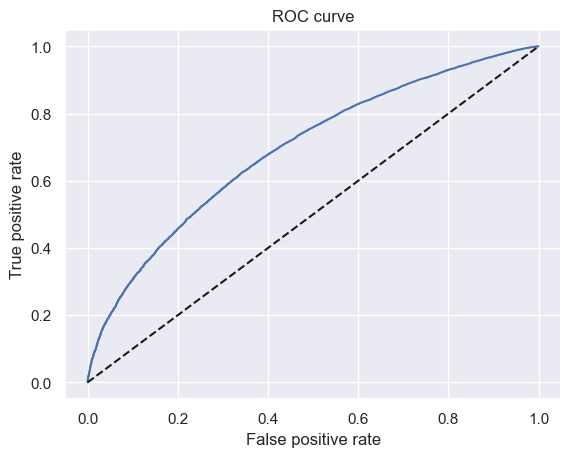

In [380]:
plt.plot(fpr, tpr)
# We plot the false positive rate along the x-axis and the true positive rate along the y-axis,
# thus plotting the ROC curve.
plt.plot(fpr, fpr, linestyle = '--', color = 'k')
# We plot a seconary diagonal line, with dashed line style and black color.
plt.xlabel('False positive rate')
# We name the x-axis "False positive rate".
plt.ylabel('True positive rate')
# We name the x-axis "True positive rate".
plt.title('ROC curve')
# We name the graph "ROC curve".

In [381]:
AUROC = roc_auc_score(df_actual_predicted_probs['loan_data_targets_test'], df_actual_predicted_probs['y_hat_test_proba'])
# Calculates the Area Under the Receiver Operating Characteristic Curve (AUROC)
# from a set of actual values and their predicted probabilities.
AUROC

0.6937510993275822

When the cutoff is 0.4

In [382]:
tr = 0.4
# We create a new column with an indicator,
# where every observation that has predicted probability greater than the threshold has a value of 1,
# and every observation that has predicted probability lower than the threshold has a value of 0.
df_actual_predicted_probs['y_hat_test'] = np.where(df_actual_predicted_probs['y_hat_test_proba'] > tr, 1, 0)

In [383]:
pd.crosstab(df_actual_predicted_probs['loan_data_targets_test'], df_actual_predicted_probs['y_hat_test'], rownames = ['Actual'], colnames = ['Predicted'])
# Creates a cross-table where the actual values are displayed by rows and the predicted values by columns.
# This table is known as a Confusion Matrix.

Predicted,0,1
Actual,,
0,1,10141
1,2,83108


In [384]:
pd.crosstab(df_actual_predicted_probs['loan_data_targets_test'], df_actual_predicted_probs['y_hat_test'], rownames = ['Actual'], colnames = ['Predicted']) / df_actual_predicted_probs.shape[0]
# Here we divide each value of the table by the total number of observations,
# thus getting percentages, or, rates.

Predicted,0,1
Actual,,
0,0.000011,0.108748
1,0.000021,0.891219


In [385]:
print("The Accuracy of model is :\t",(pd.crosstab(df_actual_predicted_probs['loan_data_targets_test'], df_actual_predicted_probs['y_hat_test'], rownames = ['Actual'], colnames = ['Predicted']) / df_actual_predicted_probs.shape[0]).iloc[0, 0] + (pd.crosstab(df_actual_predicted_probs['loan_data_targets_test'], df_actual_predicted_probs['y_hat_test'], rownames = ['Actual'], colnames = ['Predicted']) / df_actual_predicted_probs.shape[0]).iloc[1, 1])
# Here we calculate Accuracy of the model, which is the sum of the diagonal rates.

The Accuracy of model is :	 0.8912302149015571


In [386]:
from sklearn.metrics import roc_curve, roc_auc_score

In [387]:
roc_curve(df_actual_predicted_probs['loan_data_targets_test'], df_actual_predicted_probs['y_hat_test_proba'])
# Returns the Receiver Operating Characteristic (ROC) Curve from a set of actual values and their predicted probabilities.
# As a result, we get three arrays: the false positive rates, the true positive rates, and the thresholds.

(array([0.       , 0.       , 0.       , ..., 0.9999014, 1.       ,
        1.       ]),
 array([0.00000000e+00, 1.20322464e-05, 9.62579714e-05, ...,
        9.99987968e-01, 9.99987968e-01, 1.00000000e+00]),
 array([       inf, 0.99276993, 0.99130812, ..., 0.39812943, 0.39442921,
        0.37925043]))

In [388]:
fpr, tpr, thresholds = roc_curve(df_actual_predicted_probs['loan_data_targets_test'], df_actual_predicted_probs['y_hat_test_proba'])
# Here we store each of the three arrays in a separate variable. 

In [389]:
import matplotlib.pyplot as plt
import seaborn as sns
sns.set()

Text(0.5, 1.0, 'ROC curve')

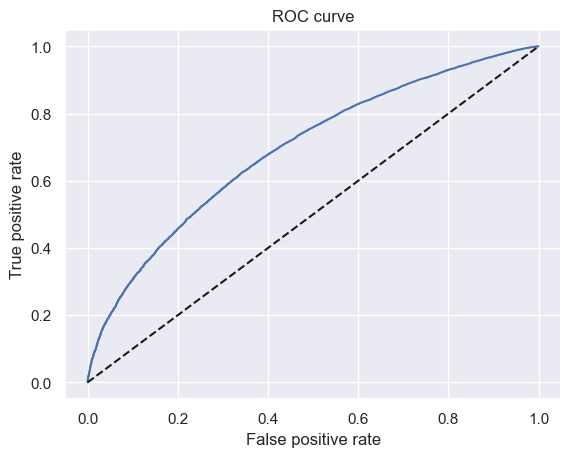

In [390]:
plt.plot(fpr, tpr)
# We plot the false positive rate along the x-axis and the true positive rate along the y-axis,
# thus plotting the ROC curve.
plt.plot(fpr, fpr, linestyle = '--', color = 'k')
# We plot a seconary diagonal line, with dashed line style and black color.
plt.xlabel('False positive rate')
# We name the x-axis "False positive rate".
plt.ylabel('True positive rate')
# We name the x-axis "True positive rate".
plt.title('ROC curve')
# We name the graph "ROC curve".

In [391]:
AUROC = roc_auc_score(df_actual_predicted_probs['loan_data_targets_test'], df_actual_predicted_probs['y_hat_test_proba'])
# Calculates the Area Under the Receiver Operating Characteristic Curve (AUROC)
# from a set of actual values and their predicted probabilities.
AUROC

0.6937510993275822

In [392]:
g=2*AUROC-1
g

0.38750219865516433

When the cutoff is 0.7

In [393]:
tr = 0.7
# We create a new column with an indicator,
# where every observation that has predicted probability greater than the threshold has a value of 1,
# and every observation that has predicted probability lower than the threshold has a value of 0.
df_actual_predicted_probs['y_hat_test'] = np.where(df_actual_predicted_probs['y_hat_test_proba'] > tr, 1, 0)

In [394]:
pd.crosstab(df_actual_predicted_probs['loan_data_targets_test'], df_actual_predicted_probs['y_hat_test'], rownames = ['Actual'], colnames = ['Predicted'])
# Creates a cross-table where the actual values are displayed by rows and the predicted values by columns.
# This table is known as a Confusion Matrix.

Predicted,0,1
Actual,,
0,587,9555
1,1208,81902


In [395]:
pd.crosstab(df_actual_predicted_probs['loan_data_targets_test'], df_actual_predicted_probs['y_hat_test'], rownames = ['Actual'], colnames = ['Predicted']) / df_actual_predicted_probs.shape[0]
# Here we divide each value of the table by the total number of observations,
# thus getting percentages, or, rates.

Predicted,0,1
Actual,,
0,0.006295,0.102464
1,0.012954,0.878287


In [396]:
print("The Accuracy of model is :\t",(pd.crosstab(df_actual_predicted_probs['loan_data_targets_test'], df_actual_predicted_probs['y_hat_test'], rownames = ['Actual'], colnames = ['Predicted']) / df_actual_predicted_probs.shape[0]).iloc[0, 0] + (pd.crosstab(df_actual_predicted_probs['loan_data_targets_test'], df_actual_predicted_probs['y_hat_test'], rownames = ['Actual'], colnames = ['Predicted']) / df_actual_predicted_probs.shape[0]).iloc[1, 1])
# Here we calculate Accuracy of the model, which is the sum of the diagonal rates.

The Accuracy of model is :	 0.8845815639342856


In [397]:
from sklearn.metrics import roc_curve, roc_auc_score

In [398]:
roc_curve(df_actual_predicted_probs['loan_data_targets_test'], df_actual_predicted_probs['y_hat_test_proba'])
# Returns the Receiver Operating Characteristic (ROC) Curve from a set of actual values and their predicted probabilities.
# As a result, we get three arrays: the false positive rates, the true positive rates, and the thresholds.

(array([0.       , 0.       , 0.       , ..., 0.9999014, 1.       ,
        1.       ]),
 array([0.00000000e+00, 1.20322464e-05, 9.62579714e-05, ...,
        9.99987968e-01, 9.99987968e-01, 1.00000000e+00]),
 array([       inf, 0.99276993, 0.99130812, ..., 0.39812943, 0.39442921,
        0.37925043]))

In [399]:
fpr, tpr, thresholds = roc_curve(df_actual_predicted_probs['loan_data_targets_test'], df_actual_predicted_probs['y_hat_test_proba'])
# Here we store each of the three arrays in a separate variable. 

In [400]:
import matplotlib.pyplot as plt
import seaborn as sns
sns.set()

Text(0.5, 1.0, 'ROC curve')

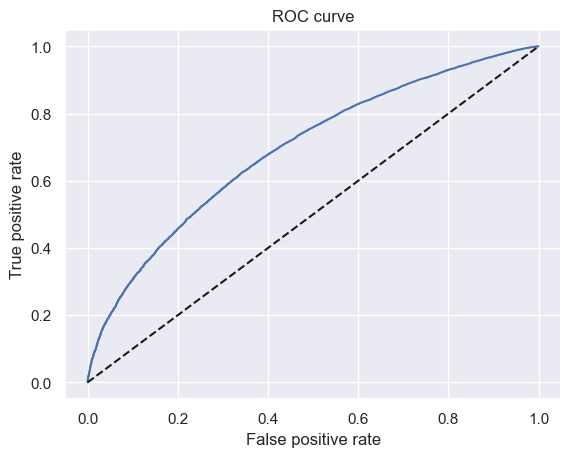

In [401]:
plt.plot(fpr, tpr)
# We plot the false positive rate along the x-axis and the true positive rate along the y-axis,
# thus plotting the ROC curve.a
plt.plot(fpr, fpr, linestyle = '--', color = 'k')
# We plot a seconary diagonal line, with dashed line style and black color.
plt.xlabel('False positive rate')
# We name the x-axis "False positive rate".
plt.ylabel('True positive rate')
# We name the x-axis "True positive rate".
plt.title('ROC curve')
# We name the graph "ROC curve".

In [402]:
AUROC = roc_auc_score(df_actual_predicted_probs['loan_data_targets_test'], df_actual_predicted_probs['y_hat_test_proba'])
# Calculates the Area Under the Receiver Operating Characteristic Curve (AUROC)
# from a set of actual values and their predicted probabilities.
AUROC

0.6937510993275822

In [403]:
g = 2*AUROC - 1
g

0.38750219865516433

When the cutoff is 0.9

In [404]:
tr = 0.9
# We create a new column with an indicator,
# where every observation that has predicted probability greater than the threshold has a value of 1,
# and every observation that has predicted probability lower than the threshold has a value of 0.
df_actual_predicted_probs['y_hat_test'] = np.where(df_actual_predicted_probs['y_hat_test_proba'] > tr, 1, 0)

In [405]:
pd.crosstab(df_actual_predicted_probs['loan_data_targets_test'], df_actual_predicted_probs['y_hat_test'], rownames = ['Actual'], colnames = ['Predicted'])
# Creates a cross-table where the actual values are displayed by rows and the predicted values by columns.
# This table is known as a Confusion Matrix.

Predicted,0,1
Actual,,
0,7173,2969
1,35844,47266


In [406]:
pd.crosstab(df_actual_predicted_probs['loan_data_targets_test'], df_actual_predicted_probs['y_hat_test'], rownames = ['Actual'], colnames = ['Predicted']) / df_actual_predicted_probs.shape[0]
# Here we divide each value of the table by the total number of observations,
# thus getting percentages, or, rates.

Predicted,0,1
Actual,,
0,0.076921,0.031838
1,0.384378,0.506863


In [407]:
print("The Accuracy of model is :\t",(pd.crosstab(df_actual_predicted_probs['loan_data_targets_test'], df_actual_predicted_probs['y_hat_test'], rownames = ['Actual'], colnames = ['Predicted']) / df_actual_predicted_probs.shape[0]).iloc[0, 0] + (pd.crosstab(df_actual_predicted_probs['loan_data_targets_test'], df_actual_predicted_probs['y_hat_test'], rownames = ['Actual'], colnames = ['Predicted']) / df_actual_predicted_probs.shape[0]).iloc[1, 1])
# Here we calculate Accuracy of the model, which is the sum of the diagonal rates.

The Accuracy of model is :	 0.583783725818213


In [408]:
from sklearn.metrics import roc_curve, roc_auc_score

In [409]:
roc_curve(df_actual_predicted_probs['loan_data_targets_test'], df_actual_predicted_probs['y_hat_test_proba'])
# Returns the Receiver Operating Characteristic (ROC) Curve from a set of actual values and their predicted probabilities.
# As a result, we get three arrays: the false positive rates, the true positive rates, and the thresholds.

(array([0.       , 0.       , 0.       , ..., 0.9999014, 1.       ,
        1.       ]),
 array([0.00000000e+00, 1.20322464e-05, 9.62579714e-05, ...,
        9.99987968e-01, 9.99987968e-01, 1.00000000e+00]),
 array([       inf, 0.99276993, 0.99130812, ..., 0.39812943, 0.39442921,
        0.37925043]))

In [410]:
fpr, tpr, thresholds = roc_curve(df_actual_predicted_probs['loan_data_targets_test'], df_actual_predicted_probs['y_hat_test_proba'])
# Here we store each of the three arrays in a separate variable. 

In [411]:
import matplotlib.pyplot as plt
import seaborn as sns
sns.set()

Text(0.5, 1.0, 'ROC curve')

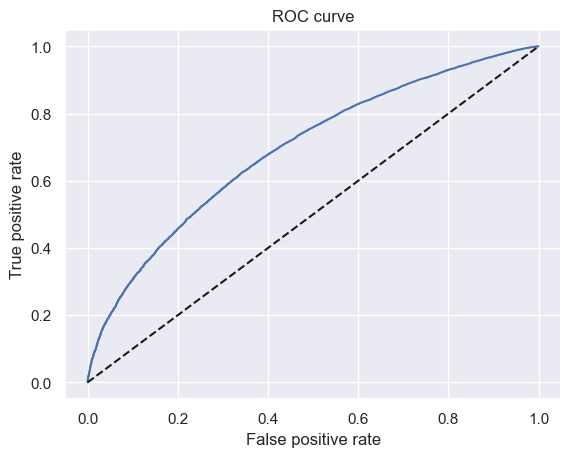

In [412]:
plt.plot(fpr, tpr)
# We plot the false positive rate along the x-axis and the true positive rate along the y-axis,
# thus plotting the ROC curve.
plt.plot(fpr, fpr, linestyle = '--', color = 'k')
# We plot a seconary diagonal line, with dashed line style and black color.
plt.xlabel('False positive rate')
# We name the x-axis "False positive rate".
plt.ylabel('True positive rate')
# We name the x-axis "True positive rate".
plt.title('ROC curve')
# We name the graph "ROC curve".

In [413]:
AUROC = roc_auc_score(df_actual_predicted_probs['loan_data_targets_test'], df_actual_predicted_probs['y_hat_test_proba'])
# Calculates the Area Under the Receiver Operating Characteristic Curve (AUROC)
# from a set of actual values and their predicted probabilities.
AUROC

0.6937510993275822

In [414]:
g = 2*AUROC - 1
g

0.38750219865516433

### Gini and Kolmogorov-Smirnov

In [415]:
df_actual_predicted_probs = df_actual_predicted_probs.sort_values('y_hat_test_proba')
# Sorts a dataframe by the values of a specific column.

In [416]:
df_actual_predicted_probs.head()

,loan_data_targets_test,y_hat_test_proba,y_hat_test
42341,1,0.379250,0
39810,0,0.394429,0
42344,1,0.398129,0
42396,0,0.453229,0
40518,0,0.454284,0


In [417]:
df_actual_predicted_probs.tail()

,loan_data_targets_test,y_hat_test_proba,y_hat_test
260907,1,0.991464,1
231463,1,0.991562,1
232642,1,0.991604,1
247902,1,0.992731,1
251159,1,0.992770,1


In [418]:
df_actual_predicted_probs = df_actual_predicted_probs.reset_index()
# We reset the index of a dataframe and overwrite it.

In [419]:
df_actual_predicted_probs.head()

,index,loan_data_targets_test,y_hat_test_proba,y_hat_test
0,42341,1,0.379250,0
1,39810,0,0.394429,0
2,42344,1,0.398129,0
3,42396,0,0.453229,0
4,40518,0,0.454284,0


In [420]:
df_actual_predicted_probs['Cumulative N Population'] = df_actual_predicted_probs.index + 1
# We calculate the cumulative number of all observations.
# We use the new index for that. Since indexing in ython starts from 0, we add 1 to each index.
df_actual_predicted_probs['Cumulative N Good'] = df_actual_predicted_probs['loan_data_targets_test'].cumsum()
# We calculate cumulative number of 'good', which is the cumulative sum of the column with actual observations.
df_actual_predicted_probs['Cumulative N Bad'] = df_actual_predicted_probs['Cumulative N Population'] - df_actual_predicted_probs['loan_data_targets_test'].cumsum()
# We calculate cumulative number of 'bad', which is
# the difference between the cumulative number of all observations and cumulative number of 'good' for each row.

In [421]:
df_actual_predicted_probs.head()

,index,loan_data_targets_test,y_hat_test_proba,y_hat_test,Cumulative N Population,Cumulative N Good,Cumulative N Bad
0,42341,1,0.379250,0,1,1,0
1,39810,0,0.394429,0,2,1,1
2,42344,1,0.398129,0,3,2,1
3,42396,0,0.453229,0,4,2,2
4,40518,0,0.454284,0,5,2,3


In [422]:
df_actual_predicted_probs['Cumulative Perc Population'] = df_actual_predicted_probs['Cumulative N Population'] / (df_actual_predicted_probs.shape[0])
# We calculate the cumulative percentage of all observations.
df_actual_predicted_probs['Cumulative Perc Good'] = df_actual_predicted_probs['Cumulative N Good'] / df_actual_predicted_probs['loan_data_targets_test'].sum()
# We calculate cumulative percentage of 'good'.
df_actual_predicted_probs['Cumulative Perc Bad'] = df_actual_predicted_probs['Cumulative N Bad'] / (df_actual_predicted_probs.shape[0] - df_actual_predicted_probs['loan_data_targets_test'].sum())
# We calculate the cumulative percentage of 'bad'.

In [423]:
df_actual_predicted_probs.head()

,index,loan_data_targets_test,y_hat_test_proba,y_hat_test,Cumulative N Population,Cumulative N Good,Cumulative N Bad,Cumulative Perc Population,Cumulative Perc Good,Cumulative Perc Bad
0,42341,1,0.379250,0,1,1,0,0.000011,0.000012,0.000000
1,39810,0,0.394429,0,2,1,1,0.000021,0.000012,0.000099
2,42344,1,0.398129,0,3,2,1,0.000032,0.000024,0.000099
3,42396,0,0.453229,0,4,2,2,0.000043,0.000024,0.000197
4,40518,0,0.454284,0,5,2,3,0.000054,0.000024,0.000296


Text(0.5, 1.0, 'Gini')

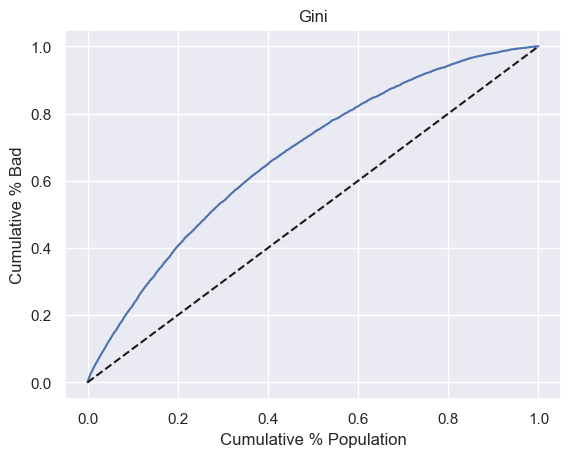

In [424]:
# Plot Gini
plt.plot(df_actual_predicted_probs['Cumulative Perc Population'], df_actual_predicted_probs['Cumulative Perc Bad'])
# We plot the cumulative percentage of all along the x-axis and the cumulative percentage 'good' along the y-axis,
# thus plotting the Gini curve.
plt.plot(df_actual_predicted_probs['Cumulative Perc Population'], df_actual_predicted_probs['Cumulative Perc Population'], linestyle = '--', color = 'k')
# We plot a seconary diagonal line, with dashed line style and black color.
plt.xlabel('Cumulative % Population')
# We name the x-axis "Cumulative % Population".
plt.ylabel('Cumulative % Bad')
# We name the y-axis "Cumulative % Bad".
plt.title('Gini')
# We name the graph "Gini".

In [425]:
Gini = AUROC * 2 - 1
# Here we calculate Gini from AUROC.
Gini

0.38750219865516433

Text(0.5, 1.0, 'Kolmogorov-Smirnov')

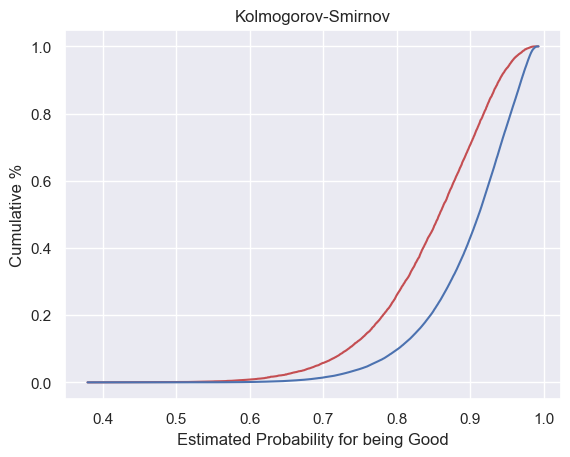

In [426]:
# Plot KS
plt.plot(df_actual_predicted_probs['y_hat_test_proba'], df_actual_predicted_probs['Cumulative Perc Bad'], color = 'r')
# We plot the predicted (estimated) probabilities along the x-axis and the cumulative percentage 'bad' along the y-axis,
# colored in red.
plt.plot(df_actual_predicted_probs['y_hat_test_proba'], df_actual_predicted_probs['Cumulative Perc Good'], color = 'b')
# We plot the predicted (estimated) probabilities along the x-axis and the cumulative percentage 'good' along the y-axis,
# colored in red.
plt.xlabel('Estimated Probability for being Good')
# We name the x-axis "Estimated Probability for being Good".
plt.ylabel('Cumulative %')
# We name the y-axis "Cumulative %".
plt.title('Kolmogorov-Smirnov')
# We name the graph "Kolmogorov-Smirnov".

In [427]:
KS = max(df_actual_predicted_probs['Cumulative Perc Bad'] - df_actual_predicted_probs['Cumulative Perc Good'])
# We calculate KS from the data. It is the maximum of the difference between the cumulative percentage of 'bad'
# and the cumulative percentage of 'good'.
KS

0.28223541912281525

In [433]:
import numpy as np
import matplotlib.pyplot as plt
from sklearn.metrics import roc_curve

def calculate_ks(y_true, y_prob):
    """
    Calculate the Kolmogorov-Smirnov (KS) statistic.

    Parameters:
    y_true: array-like, shape (n_samples,)
        True binary labels (0 or 1).
    y_prob: array-like, shape (n_samples,)
        Predicted probabilities for the positive class.

    Returns:
    ks_statistic: float
        KS statistic value.
    ks_threshold: float
        Threshold where the KS statistic is achieved.
    """
    fpr, tpr, thresholds = roc_curve(y_true, y_prob)
    ks_values = np.abs(tpr - fpr)
    ks_index = np.argmax(ks_values)
    ks_statistic = ks_values[ks_index]
    ks_threshold = thresholds[ks_index]

    return ks_statistic, ks_threshold

def plot_ks_curve(y_true, y_prob):
    """
    Plot the KS curve for a binary classification model.

    Parameters:
    y_true: array-like, shape (n_samples,)
        True binary labels (0 or 1).
    y_prob: array-like, shape (n_samples,)
        Predicted probabilities for the positive class.

    Returns:
    None
    """
    fpr, tpr, thresholds = roc_curve(y_true, y_prob)

    ks_statistic, ks_threshold = calculate_ks(y_true, y_prob)

    plt.figure(figsize=(8, 6))
    plt.plot(thresholds, tpr, label='True Positive Rate (Sensitivity)')
    plt.plot(thresholds, fpr, label='False Positive Rate')
    plt.plot(ks_threshold, tpr[np.argmax(tpr - fpr)], 'ro', label=f'Max KS (Threshold={ks_threshold:.3f})')
    plt.xlabel('Threshold')
    plt.ylabel('Rate')
    plt.title('KS Curve')
    plt.legend()
    plt.grid()
    plt.show()

# Example usage:
# Replace y_true and y_prob with your actual labels and predicted probabilities
# y_true = ...
# y_prob = ...
# ks_statistic, ks_threshold = calculate_ks(y_true, y_prob)
# print(f'KS Statistic: {ks_statistic:.4f} at Threshold={ks_threshold:.4f}')
# plot_ks_curve(y_true, y_prob)


In [434]:
y_hat_test


array([1, 1, 1, ..., 1, 1, 1], dtype=int64)

In [435]:
calculate_ks(loan_data_targets_test, y_hat_test_proba)

(0.2822354191228153, 0.8898662549952947)

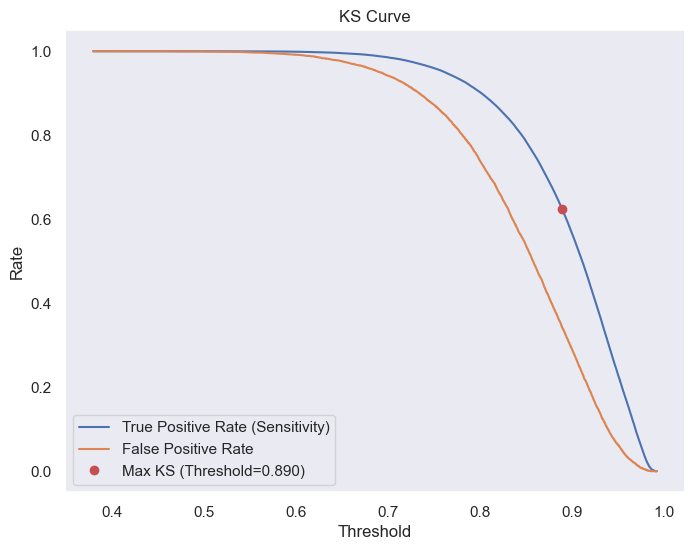

In [436]:
plot_ks_curve(loan_data_targets_test, y_hat_test_proba)

## Applying the PD Model

### Calculating PD of individual accounts

In [437]:
pd.options.display.max_columns = None
# Sets the pandas dataframe options to display all columns/ rows.

In [438]:
inputs_test_with_ref_cat.head()

,grade:A,grade:B,grade:C,grade:D,grade:E,grade:F,grade:G,home_ownership:RENT_OTHER_NONE_ANY,home_ownership:OWN,home_ownership:MORTGAGE,addr_state:ND_NE_IA_NV_FL_HI_AL,addr_state:NM_VA,addr_state:NY,addr_state:OK_TN_MO_LA_MD_NC,addr_state:CA,addr_state:UT_KY_AZ_NJ,addr_state:AR_MI_PA_OH_MN,addr_state:RI_MA_DE_SD_IN,addr_state:GA_WA_OR,addr_state:WI_MT,addr_state:TX,addr_state:IL_CT,addr_state:KS_SC_CO_VT_AK_MS,addr_state:WV_NH_WY_DC_ME_ID,verification_status:Not Verified,verification_status:Source Verified,verification_status:Verified,purpose:educ__sm_b__wedd__ren_en__mov__house,purpose:credit_card,purpose:debt_consolidation,purpose:oth__med__vacation,purpose:major_purch__car__home_impr,initial_list_status:f,initial_list_status:w,term:36,term:60,emp_length:0,emp_length:1,emp_length:2-4,emp_length:5-6,emp_length:7-9,emp_length:10,mths_since_issue_d:<38,mths_since_issue_d:38-39,mths_since_issue_d:40-41,mths_since_issue_d:42-48,mths_since_issue_d:49-52,mths_since_issue_d:53-64,mths_since_issue_d:65-84,mths_since_issue_d:>84,int_rate:<9.548,int_rate:9.548-12.025,int_rate:12.025-15.74,int_rate:15.74-20.281,int_rate:>20.281,mths_since_earliest_cr_line:<140,mths_since_earliest_cr_line:141-164,mths_since_earliest_cr_line:165-247,mths_since_earliest_cr_line:248-270,mths_since_earliest_cr_line:271-352,mths_since_earliest_cr_line:>352,inq_last_6mths:0,inq_last_6mths:1-2,inq_last_6mths:3-6,inq_last_6mths:>6,acc_now_delinq:0,acc_now_delinq:>=1,annual_inc:<20K,annual_inc:20K-30K,annual_inc:30K-40K,annual_inc:40K-50K,annual_inc:50K-60K,annual_inc:60K-70K,annual_inc:70K-80K,annual_inc:80K-90K,annual_inc:90K-100K,annual_inc:100K-120K,annual_inc:120K-140K,annual_inc:>140K,dti:<=1.4,dti:1.4-3.5,dti:3.5-7.7,dti:7.7-10.5,dti:10.5-16.1,dti:16.1-20.3,dti:20.3-21.7,dti:21.7-22.4,dti:22.4-35,dti:>35,mths_since_last_delinq:Missing,mths_since_last_delinq:0-3,mths_since_last_delinq:4-30,mths_since_last_delinq:31-56,mths_since_last_delinq:>=57,mths_since_last_record:Missing,mths_since_last_record:0-2,mths_since_last_record:3-20,mths_since_last_record:21-31,mths_since_last_record:32-80,mths_since_last_record:81-86,mths_since_last_record:>86
53955,False,True,False,False,False,False,False,0,False,True,0,1,False,0,False,0,0,0,0,0,False,0,0,0,False,True,False,0,False,True,0,0,True,False,1,0,0,0,0,0,0,1,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,1,0,0,0,0,1,0,0,1,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,1,0,0,1,0,0,0,0,0,0
73769,False,False,True,False,False,False,False,1,False,False,1,0,False,0,False,0,0,0,0,0,False,0,0,0,False,True,False,0,False,True,0,0,True,False,1,0,0,0,0,0,0,1,0,0,0,0,1,0,0,0,0,0,1,0,0,0,0,0,0,1,0,1,0,0,0,1,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,1,1,0,0,0,0,0,0
101802,False,False,False,True,False,False,False,1,False,False,0,0,False,0,False,0,0,0,0,0,False,0,1,0,True,False,False,0,False,True,0,0,True,False,1,0,1,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,1,0,0,0,1,0,0,0,0,1,0,0,1,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,1,0,0,0,0,1,0,0,0,0,0,0
122556,False,True,False,False,False,False,False,1,False,False,0,0,False,0,False,0,1,0,0,0,False,0,0,0,True,False,False,0,False,True,0,0,True,False,1,0,0,0,0,0,1,0,0,0,0,0,0,1,0,0,0,1,0,0,0,0,0,0,0,1,0,1,0,0,0,1,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,1,0
390263,True,False,False,False,False,False,False,0,True,False,0,0,False,0,False,0,0,0,0,0,True,0,0,0,True,False,False,0,False,True,0,0,True,False,1,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,1,0,0,1,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,1,0,1,0,0,0,0,0,0


In [439]:
summary_table

,Feature name,Coefficients,p_values
0,Intercept,-1.461507,NaN
1,grade:A,1.095858,3.634202e-33
2,grade:B,0.855118,1.366137e-44
3,grade:C,0.657372,2.622250e-31
4,grade:D,0.478447,3.818008e-19
5,grade:E,0.315083,2.867491e-11
6,grade:F,0.162163,9.976025e-04
7,home_ownership:OWN,0.073842,2.258225e-04
8,home_ownership:MORTGAGE,0.107316,2.285390e-17
9,addr_state:NM_VA,0.058589,6.696356e-02


In [440]:
y_hat_test_proba

array([0.92706196, 0.90520779, 0.80723034, ..., 0.82776538, 0.8983768 ,
       0.90894257])

### Creating a Scorecard

In [441]:
summary_table

,Feature name,Coefficients,p_values
0,Intercept,-1.461507,NaN
1,grade:A,1.095858,3.634202e-33
2,grade:B,0.855118,1.366137e-44
3,grade:C,0.657372,2.622250e-31
4,grade:D,0.478447,3.818008e-19
5,grade:E,0.315083,2.867491e-11
6,grade:F,0.162163,9.976025e-04
7,home_ownership:OWN,0.073842,2.258225e-04
8,home_ownership:MORTGAGE,0.107316,2.285390e-17
9,addr_state:NM_VA,0.058589,6.696356e-02


In [442]:
ref_categories

['grade:G',
 'home_ownership:RENT_OTHER_NONE_ANY',
 'addr_state:ND_NE_IA_NV_FL_HI_AL',
 'verification_status:Verified',
 'purpose:educ__sm_b__wedd__ren_en__mov__house',
 'initial_list_status:f',
 'term:60',
 'emp_length:0',
 'mths_since_issue_d:>84',
 'int_rate:>20.281',
 'mths_since_earliest_cr_line:<140',
 'inq_last_6mths:>6',
 'acc_now_delinq:0',
 'annual_inc:<20K',
 'dti:>35',
 'mths_since_last_delinq:0-3',
 'mths_since_last_record:0-2']

In [443]:
df_ref_categories = pd.DataFrame(ref_categories, columns = ['Feature name'])
# We create a new dataframe with one column. Its values are the values from the 'reference_categories' list.
# We name it 'Feature name'.
df_ref_categories['Coefficients'] = 0
# We create a second column, called 'Coefficients', which contains only 0 values.
df_ref_categories['p_values'] = np.nan
# We create a third column, called 'p_values', with contains only NaN values.
df_ref_categories

,Feature name,Coefficients,p_values
0,grade:G,0,NaN
1,home_ownership:RENT_OTHER_NONE_ANY,0,NaN
2,addr_state:ND_NE_IA_NV_FL_HI_AL,0,NaN
3,verification_status:Verified,0,NaN
4,purpose:educ__sm_b__wedd__ren_en__mov__house,0,NaN
5,initial_list_status:f,0,NaN
6,term:60,0,NaN
7,emp_length:0,0,NaN
8,mths_since_issue_d:>84,0,NaN
9,int_rate:>20.281,0,NaN


In [444]:
df_scorecard = pd.concat([summary_table, df_ref_categories])
# Concatenates two dataframes.
df_scorecard = df_scorecard.reset_index()
# We reset the index of a dataframe.
df_scorecard

,index,Feature name,Coefficients,p_values
0,0,Intercept,-1.461507,NaN
1,1,grade:A,1.095858,3.634202e-33
2,2,grade:B,0.855118,1.366137e-44
3,3,grade:C,0.657372,2.622250e-31
4,4,grade:D,0.478447,3.818008e-19
5,5,grade:E,0.315083,2.867491e-11
6,6,grade:F,0.162163,9.976025e-04
7,7,home_ownership:OWN,0.073842,2.258225e-04
8,8,home_ownership:MORTGAGE,0.107316,2.285390e-17
9,9,addr_state:NM_VA,0.058589,6.696356e-02


In [445]:
df_scorecard['Original feature name'] = df_scorecard['Feature name'].str.split(':').str[0]
# We create a new column, called 'Original feature name', which contains the value of the 'Feature name' column,
# up to the column symbol.

In [446]:
df_scorecard

,index,Feature name,Coefficients,p_values,Original feature name
0,0,Intercept,-1.461507,NaN,Intercept
1,1,grade:A,1.095858,3.634202e-33,grade
2,2,grade:B,0.855118,1.366137e-44,grade
3,3,grade:C,0.657372,2.622250e-31,grade
4,4,grade:D,0.478447,3.818008e-19,grade
5,5,grade:E,0.315083,2.867491e-11,grade
6,6,grade:F,0.162163,9.976025e-04,grade
7,7,home_ownership:OWN,0.073842,2.258225e-04,home_ownership
8,8,home_ownership:MORTGAGE,0.107316,2.285390e-17,home_ownership
9,9,addr_state:NM_VA,0.058589,6.696356e-02,addr_state


In [447]:
min_score = 300
max_score = 850

In [448]:
df_scorecard.groupby('Original feature name')['Coefficients'].min()
# Groups the data by the values of the 'Original feature name' column.
# Aggregates the data in the 'Coefficients' column, calculating their minimum.

Original feature name
Intercept                     -1.461507
acc_now_delinq                 0.000000
addr_state                     0.000000
annual_inc                    -0.047850
dti                            0.000000
emp_length                     0.000000
grade                          0.000000
home_ownership                 0.000000
initial_list_status            0.000000
inq_last_6mths                 0.000000
int_rate                       0.000000
mths_since_earliest_cr_line    0.000000
mths_since_issue_d            -0.080101
mths_since_last_delinq         0.000000
mths_since_last_record         0.000000
purpose                        0.000000
term                           0.000000
verification_status           -0.012777
Name: Coefficients, dtype: float64

In [449]:
min_sum_coef = df_scorecard.groupby('Original feature name')['Coefficients'].min().sum()
# Up to the 'min()' method everything is the same as in te line above.
# Then, we aggregate further and sum all the minimum values.
min_sum_coef

-1.6022352593301281

In [450]:
df_scorecard.groupby('Original feature name')['Coefficients'].max()
# Groups the data by the values of the 'Oriaginal feature name' column.
# Aggregates the data in the 'Coefficients' column, calculating their maximum.

Original feature name
Intercept                     -1.461507
acc_now_delinq                 0.147011
addr_state                     0.527655
annual_inc                     0.589505
dti                            0.424955
emp_length                     0.137690
grade                          1.095858
home_ownership                 0.107316
initial_list_status            0.048967
inq_last_6mths                 0.626355
int_rate                       0.938421
mths_since_earliest_cr_line    0.115619
mths_since_issue_d             1.123184
mths_since_last_delinq         0.147671
mths_since_last_record         0.564324
purpose                        0.322331
term                           0.074593
verification_status            0.085510
Name: Coefficients, dtype: float64

In [451]:
max_sum_coef = df_scorecard.groupby('Original feature name')['Coefficients'].max().sum()
# Up to the 'min()' method everything is the same as in te line above.
# Then, we aggregate further and sum all the maximum values.
max_sum_coef

5.615460768317134

In [452]:
df_scorecard['Score - Calculation'] = df_scorecard['Coefficients'] * (max_score - min_score) / (max_sum_coef - min_sum_coef)
# We multiply the value of the 'Coefficients' column by the ration of the differences between
# maximum score and minimum score and maximum sum of coefficients and minimum sum of cefficients.
df_scorecard

,index,Feature name,Coefficients,p_values,Original feature name,Score - Calculation
0,0,Intercept,-1.461507,NaN,Intercept,-111.369195
1,1,grade:A,1.095858,3.634202e-33,grade,83.506155
2,2,grade:B,0.855118,1.366137e-44,grade,65.161346
3,3,grade:C,0.657372,2.622250e-31,grade,50.092772
4,4,grade:D,0.478447,3.818008e-19,grade,36.458432
5,5,grade:E,0.315083,2.867491e-11,grade,24.009798
6,6,grade:F,0.162163,9.976025e-04,grade,12.357054
7,7,home_ownership:OWN,0.073842,2.258225e-04,home_ownership,5.626850
8,8,home_ownership:MORTGAGE,0.107316,2.285390e-17,home_ownership,8.177643
9,9,addr_state:NM_VA,0.058589,6.696356e-02,addr_state,4.464595


In [453]:
df_scorecard['Score - Calculation'][0] = ((df_scorecard['Coefficients'][0] - min_sum_coef) / (max_sum_coef - min_sum_coef)) * (max_score - min_score) + min_score
# We divide the difference of the value of the 'Coefficients' column and the minimum sum of coefficients by
# the difference of the maximum sum of coefficients and the minimum sum of coefficients.
# Then, we multiply that by the difference between the maximum score and the minimum score.
# Then, we add minimum score. 
df_scorecard

C:\Users\dcgzb\AppData\Local\Temp\ipykernel_10772\1410049194.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_scorecard['Score - Calculation'][0] = ((df_scorecard['Coefficients'][0] - min_sum_coef) / (max_sum_coef - min_sum_coef)) * (max_score - min_score) + min_score


,index,Feature name,Coefficients,p_values,Original feature name,Score - Calculation
0,0,Intercept,-1.461507,NaN,Intercept,310.723699
1,1,grade:A,1.095858,3.634202e-33,grade,83.506155
2,2,grade:B,0.855118,1.366137e-44,grade,65.161346
3,3,grade:C,0.657372,2.622250e-31,grade,50.092772
4,4,grade:D,0.478447,3.818008e-19,grade,36.458432
5,5,grade:E,0.315083,2.867491e-11,grade,24.009798
6,6,grade:F,0.162163,9.976025e-04,grade,12.357054
7,7,home_ownership:OWN,0.073842,2.258225e-04,home_ownership,5.626850
8,8,home_ownership:MORTGAGE,0.107316,2.285390e-17,home_ownership,8.177643
9,9,addr_state:NM_VA,0.058589,6.696356e-02,addr_state,4.464595


In [454]:
df_scorecard['Score - Preliminary'] = df_scorecard['Score - Calculation'].round()
# We round the values of the 'Score - Calculation' column.
df_scorecard

,index,Feature name,Coefficients,p_values,Original feature name,Score - Calculation,Score - Preliminary
0,0,Intercept,-1.461507,NaN,Intercept,310.723699,311.0
1,1,grade:A,1.095858,3.634202e-33,grade,83.506155,84.0
2,2,grade:B,0.855118,1.366137e-44,grade,65.161346,65.0
3,3,grade:C,0.657372,2.622250e-31,grade,50.092772,50.0
4,4,grade:D,0.478447,3.818008e-19,grade,36.458432,36.0
5,5,grade:E,0.315083,2.867491e-11,grade,24.009798,24.0
6,6,grade:F,0.162163,9.976025e-04,grade,12.357054,12.0
7,7,home_ownership:OWN,0.073842,2.258225e-04,home_ownership,5.626850,6.0
8,8,home_ownership:MORTGAGE,0.107316,2.285390e-17,home_ownership,8.177643,8.0
9,9,addr_state:NM_VA,0.058589,6.696356e-02,addr_state,4.464595,4.0


In [455]:
min_sum_score_prel = df_scorecard.groupby('Original feature name')['Score - Preliminary'].min().sum()
# Groups the data by the values of the 'Original feature name' column.
# Aggregates the data in the 'Coefficients' column, calculating their minimum.
# Sums all minimum values.
min_sum_score_prel

300.0

In [456]:
max_sum_score_prel = df_scorecard.groupby('Original feature name')['Score - Preliminary'].max().sum()
# Groups the data by the values of the 'Original feature name' column.
# Aggregates the data in the 'Coefficients' column, calculating their maximum.
# Sums all maximum values.
max_sum_score_prel

852.0

In [457]:
# One has to be subtracted from the maximum score for one original variable. Which one? We'll evaluate based on differences.

In [458]:
df_scorecard['Difference'] = df_scorecard['Score - Preliminary'] - df_scorecard['Score - Calculation']
df_scorecard

,index,Feature name,Coefficients,p_values,Original feature name,Score - Calculation,Score - Preliminary,Difference
0,0,Intercept,-1.461507,NaN,Intercept,310.723699,311.0,0.276301
1,1,grade:A,1.095858,3.634202e-33,grade,83.506155,84.0,0.493845
2,2,grade:B,0.855118,1.366137e-44,grade,65.161346,65.0,-0.161346
3,3,grade:C,0.657372,2.622250e-31,grade,50.092772,50.0,-0.092772
4,4,grade:D,0.478447,3.818008e-19,grade,36.458432,36.0,-0.458432
5,5,grade:E,0.315083,2.867491e-11,grade,24.009798,24.0,-0.009798
6,6,grade:F,0.162163,9.976025e-04,grade,12.357054,12.0,-0.357054
7,7,home_ownership:OWN,0.073842,2.258225e-04,home_ownership,5.626850,6.0,0.373150
8,8,home_ownership:MORTGAGE,0.107316,2.285390e-17,home_ownership,8.177643,8.0,-0.177643
9,9,addr_state:NM_VA,0.058589,6.696356e-02,addr_state,4.464595,4.0,-0.464595


In [459]:
df_scorecard[df_scorecard['Difference'] == df_scorecard['Difference'].max()]
# Find the variable and index with maximum difference
# Once we identify it we will reduce the Score-Preliminary by difference of max_score and max_sum_score_prel

,index,Feature name,Coefficients,p_values,Original feature name,Score - Calculation,Score - Preliminary,Difference
1,1,grade:A,1.095858,3.634202e-33,grade,83.506155,84.0,0.493845


In [460]:
df_scorecard['Score - Final'] = df_scorecard['Score - Preliminary']
df_scorecard['Score - Final'][1] = 82
df_scorecard

# here we do the manual adjustment to the grade:A with index 1 as we found in above cell. Original was 84, so 84-2 = 82

C:\Users\dcgzb\AppData\Local\Temp\ipykernel_10772\1365058300.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_scorecard['Score - Final'][1] = 82


,index,Feature name,Coefficients,p_values,Original feature name,Score - Calculation,Score - Preliminary,Difference,Score - Final
0,0,Intercept,-1.461507,NaN,Intercept,310.723699,311.0,0.276301,311.0
1,1,grade:A,1.095858,3.634202e-33,grade,83.506155,84.0,0.493845,82.0
2,2,grade:B,0.855118,1.366137e-44,grade,65.161346,65.0,-0.161346,65.0
3,3,grade:C,0.657372,2.622250e-31,grade,50.092772,50.0,-0.092772,50.0
4,4,grade:D,0.478447,3.818008e-19,grade,36.458432,36.0,-0.458432,36.0
5,5,grade:E,0.315083,2.867491e-11,grade,24.009798,24.0,-0.009798,24.0
6,6,grade:F,0.162163,9.976025e-04,grade,12.357054,12.0,-0.357054,12.0
7,7,home_ownership:OWN,0.073842,2.258225e-04,home_ownership,5.626850,6.0,0.373150,6.0
8,8,home_ownership:MORTGAGE,0.107316,2.285390e-17,home_ownership,8.177643,8.0,-0.177643,8.0
9,9,addr_state:NM_VA,0.058589,6.696356e-02,addr_state,4.464595,4.0,-0.464595,4.0


In [461]:
min_sum_score_prel = df_scorecard.groupby('Original feature name')['Score - Final'].min().sum()
# Groups the data by the values of the 'Original feature name' column.
# Aggregates the data in the 'Coefficients' column, calculating their minimum.
# Sums all minimum values.
min_sum_score_prel

300.0

In [462]:
max_sum_score_prel = df_scorecard.groupby('Original feature name')['Score - Final'].max().sum()
# Groups the data by the values of the 'Original feature name' column.
# Aggregates the data in the 'Coefficients' column, calculating their maximum.
# Sums all maximum values.
max_sum_score_prel

850.0

### Caclulating Credit Score

In [463]:
inputs_test_with_ref_cat.head()

,grade:A,grade:B,grade:C,grade:D,grade:E,grade:F,grade:G,home_ownership:RENT_OTHER_NONE_ANY,home_ownership:OWN,home_ownership:MORTGAGE,addr_state:ND_NE_IA_NV_FL_HI_AL,addr_state:NM_VA,addr_state:NY,addr_state:OK_TN_MO_LA_MD_NC,addr_state:CA,addr_state:UT_KY_AZ_NJ,addr_state:AR_MI_PA_OH_MN,addr_state:RI_MA_DE_SD_IN,addr_state:GA_WA_OR,addr_state:WI_MT,addr_state:TX,addr_state:IL_CT,addr_state:KS_SC_CO_VT_AK_MS,addr_state:WV_NH_WY_DC_ME_ID,verification_status:Not Verified,verification_status:Source Verified,verification_status:Verified,purpose:educ__sm_b__wedd__ren_en__mov__house,purpose:credit_card,purpose:debt_consolidation,purpose:oth__med__vacation,purpose:major_purch__car__home_impr,initial_list_status:f,initial_list_status:w,term:36,term:60,emp_length:0,emp_length:1,emp_length:2-4,emp_length:5-6,emp_length:7-9,emp_length:10,mths_since_issue_d:<38,mths_since_issue_d:38-39,mths_since_issue_d:40-41,mths_since_issue_d:42-48,mths_since_issue_d:49-52,mths_since_issue_d:53-64,mths_since_issue_d:65-84,mths_since_issue_d:>84,int_rate:<9.548,int_rate:9.548-12.025,int_rate:12.025-15.74,int_rate:15.74-20.281,int_rate:>20.281,mths_since_earliest_cr_line:<140,mths_since_earliest_cr_line:141-164,mths_since_earliest_cr_line:165-247,mths_since_earliest_cr_line:248-270,mths_since_earliest_cr_line:271-352,mths_since_earliest_cr_line:>352,inq_last_6mths:0,inq_last_6mths:1-2,inq_last_6mths:3-6,inq_last_6mths:>6,acc_now_delinq:0,acc_now_delinq:>=1,annual_inc:<20K,annual_inc:20K-30K,annual_inc:30K-40K,annual_inc:40K-50K,annual_inc:50K-60K,annual_inc:60K-70K,annual_inc:70K-80K,annual_inc:80K-90K,annual_inc:90K-100K,annual_inc:100K-120K,annual_inc:120K-140K,annual_inc:>140K,dti:<=1.4,dti:1.4-3.5,dti:3.5-7.7,dti:7.7-10.5,dti:10.5-16.1,dti:16.1-20.3,dti:20.3-21.7,dti:21.7-22.4,dti:22.4-35,dti:>35,mths_since_last_delinq:Missing,mths_since_last_delinq:0-3,mths_since_last_delinq:4-30,mths_since_last_delinq:31-56,mths_since_last_delinq:>=57,mths_since_last_record:Missing,mths_since_last_record:0-2,mths_since_last_record:3-20,mths_since_last_record:21-31,mths_since_last_record:32-80,mths_since_last_record:81-86,mths_since_last_record:>86
53955,False,True,False,False,False,False,False,0,False,True,0,1,False,0,False,0,0,0,0,0,False,0,0,0,False,True,False,0,False,True,0,0,True,False,1,0,0,0,0,0,0,1,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,1,0,0,0,0,1,0,0,1,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,1,0,0,1,0,0,0,0,0,0
73769,False,False,True,False,False,False,False,1,False,False,1,0,False,0,False,0,0,0,0,0,False,0,0,0,False,True,False,0,False,True,0,0,True,False,1,0,0,0,0,0,0,1,0,0,0,0,1,0,0,0,0,0,1,0,0,0,0,0,0,1,0,1,0,0,0,1,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,1,1,0,0,0,0,0,0
101802,False,False,False,True,False,False,False,1,False,False,0,0,False,0,False,0,0,0,0,0,False,0,1,0,True,False,False,0,False,True,0,0,True,False,1,0,1,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,1,0,0,0,1,0,0,0,0,1,0,0,1,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,1,0,0,0,0,1,0,0,0,0,0,0
122556,False,True,False,False,False,False,False,1,False,False,0,0,False,0,False,0,1,0,0,0,False,0,0,0,True,False,False,0,False,True,0,0,True,False,1,0,0,0,0,0,1,0,0,0,0,0,0,1,0,0,0,1,0,0,0,0,0,0,0,1,0,1,0,0,0,1,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,1,0
390263,True,False,False,False,False,False,False,0,True,False,0,0,False,0,False,0,0,0,0,0,True,0,0,0,True,False,False,0,False,True,0,0,True,False,1,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,1,0,0,1,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,1,0,1,0,0,0,0,0,0


In [464]:
df_scorecard

,index,Feature name,Coefficients,p_values,Original feature name,Score - Calculation,Score - Preliminary,Difference,Score - Final
0,0,Intercept,-1.461507,NaN,Intercept,310.723699,311.0,0.276301,311.0
1,1,grade:A,1.095858,3.634202e-33,grade,83.506155,84.0,0.493845,82.0
2,2,grade:B,0.855118,1.366137e-44,grade,65.161346,65.0,-0.161346,65.0
3,3,grade:C,0.657372,2.622250e-31,grade,50.092772,50.0,-0.092772,50.0
4,4,grade:D,0.478447,3.818008e-19,grade,36.458432,36.0,-0.458432,36.0
5,5,grade:E,0.315083,2.867491e-11,grade,24.009798,24.0,-0.009798,24.0
6,6,grade:F,0.162163,9.976025e-04,grade,12.357054,12.0,-0.357054,12.0
7,7,home_ownership:OWN,0.073842,2.258225e-04,home_ownership,5.626850,6.0,0.373150,6.0
8,8,home_ownership:MORTGAGE,0.107316,2.285390e-17,home_ownership,8.177643,8.0,-0.177643,8.0
9,9,addr_state:NM_VA,0.058589,6.696356e-02,addr_state,4.464595,4.0,-0.464595,4.0


In [465]:
inputs_test_with_ref_cat_w_intercept = inputs_test_with_ref_cat

In [466]:
inputs_test_with_ref_cat_w_intercept.insert(0, 'Intercept', 1)
# We insert a column in the dataframe, with an index of 0, that is, in the beginning of the dataframe.
# The name of that column is 'Intercept', and its values are 1s.

In [467]:
inputs_test_with_ref_cat_w_intercept.head()

,Intercept,grade:A,grade:B,grade:C,grade:D,grade:E,grade:F,grade:G,home_ownership:RENT_OTHER_NONE_ANY,home_ownership:OWN,home_ownership:MORTGAGE,addr_state:ND_NE_IA_NV_FL_HI_AL,addr_state:NM_VA,addr_state:NY,addr_state:OK_TN_MO_LA_MD_NC,addr_state:CA,addr_state:UT_KY_AZ_NJ,addr_state:AR_MI_PA_OH_MN,addr_state:RI_MA_DE_SD_IN,addr_state:GA_WA_OR,addr_state:WI_MT,addr_state:TX,addr_state:IL_CT,addr_state:KS_SC_CO_VT_AK_MS,addr_state:WV_NH_WY_DC_ME_ID,verification_status:Not Verified,verification_status:Source Verified,verification_status:Verified,purpose:educ__sm_b__wedd__ren_en__mov__house,purpose:credit_card,purpose:debt_consolidation,purpose:oth__med__vacation,purpose:major_purch__car__home_impr,initial_list_status:f,initial_list_status:w,term:36,term:60,emp_length:0,emp_length:1,emp_length:2-4,emp_length:5-6,emp_length:7-9,emp_length:10,mths_since_issue_d:<38,mths_since_issue_d:38-39,mths_since_issue_d:40-41,mths_since_issue_d:42-48,mths_since_issue_d:49-52,mths_since_issue_d:53-64,mths_since_issue_d:65-84,mths_since_issue_d:>84,int_rate:<9.548,int_rate:9.548-12.025,int_rate:12.025-15.74,int_rate:15.74-20.281,int_rate:>20.281,mths_since_earliest_cr_line:<140,mths_since_earliest_cr_line:141-164,mths_since_earliest_cr_line:165-247,mths_since_earliest_cr_line:248-270,mths_since_earliest_cr_line:271-352,mths_since_earliest_cr_line:>352,inq_last_6mths:0,inq_last_6mths:1-2,inq_last_6mths:3-6,inq_last_6mths:>6,acc_now_delinq:0,acc_now_delinq:>=1,annual_inc:<20K,annual_inc:20K-30K,annual_inc:30K-40K,annual_inc:40K-50K,annual_inc:50K-60K,annual_inc:60K-70K,annual_inc:70K-80K,annual_inc:80K-90K,annual_inc:90K-100K,annual_inc:100K-120K,annual_inc:120K-140K,annual_inc:>140K,dti:<=1.4,dti:1.4-3.5,dti:3.5-7.7,dti:7.7-10.5,dti:10.5-16.1,dti:16.1-20.3,dti:20.3-21.7,dti:21.7-22.4,dti:22.4-35,dti:>35,mths_since_last_delinq:Missing,mths_since_last_delinq:0-3,mths_since_last_delinq:4-30,mths_since_last_delinq:31-56,mths_since_last_delinq:>=57,mths_since_last_record:Missing,mths_since_last_record:0-2,mths_since_last_record:3-20,mths_since_last_record:21-31,mths_since_last_record:32-80,mths_since_last_record:81-86,mths_since_last_record:>86
53955,1,False,True,False,False,False,False,False,0,False,True,0,1,False,0,False,0,0,0,0,0,False,0,0,0,False,True,False,0,False,True,0,0,True,False,1,0,0,0,0,0,0,1,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,1,0,0,0,0,1,0,0,1,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,1,0,0,1,0,0,0,0,0,0
73769,1,False,False,True,False,False,False,False,1,False,False,1,0,False,0,False,0,0,0,0,0,False,0,0,0,False,True,False,0,False,True,0,0,True,False,1,0,0,0,0,0,0,1,0,0,0,0,1,0,0,0,0,0,1,0,0,0,0,0,0,1,0,1,0,0,0,1,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,1,1,0,0,0,0,0,0
101802,1,False,False,False,True,False,False,False,1,False,False,0,0,False,0,False,0,0,0,0,0,False,0,1,0,True,False,False,0,False,True,0,0,True,False,1,0,1,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,1,0,0,0,1,0,0,0,0,1,0,0,1,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,1,0,0,0,0,1,0,0,0,0,0,0
122556,1,False,True,False,False,False,False,False,1,False,False,0,0,False,0,False,0,1,0,0,0,False,0,0,0,True,False,False,0,False,True,0,0,True,False,1,0,0,0,0,0,1,0,0,0,0,0,0,1,0,0,0,1,0,0,0,0,0,0,0,1,0,1,0,0,0,1,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,1,0
390263,1,True,False,False,False,False,False,False,0,True,False,0,0,False,0,False,0,0,0,0,0,True,0,0,0,True,False,False,0,False,True,0,0,True,False,1,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,1,0,0,1,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,1,0,1,0,0,0,0,0,0


In [468]:
inputs_test_with_ref_cat_w_intercept = inputs_test_with_ref_cat_w_intercept[df_scorecard['Feature name'].values]
# Here, from the 'inputs_test_with_ref_cat_w_intercept' dataframe, we keep only the columns with column names,
# exactly equal to the row values of the 'Feature name' column from the 'df_scorecard' dataframe.

In [469]:
inputs_test_with_ref_cat_w_intercept.head()

,Intercept,grade:A,grade:B,grade:C,grade:D,grade:E,grade:F,home_ownership:OWN,home_ownership:MORTGAGE,addr_state:NM_VA,addr_state:NY,addr_state:OK_TN_MO_LA_MD_NC,addr_state:CA,addr_state:UT_KY_AZ_NJ,addr_state:AR_MI_PA_OH_MN,addr_state:RI_MA_DE_SD_IN,addr_state:GA_WA_OR,addr_state:WI_MT,addr_state:TX,addr_state:IL_CT,addr_state:KS_SC_CO_VT_AK_MS,addr_state:WV_NH_WY_DC_ME_ID,verification_status:Not Verified,verification_status:Source Verified,purpose:credit_card,purpose:debt_consolidation,purpose:oth__med__vacation,purpose:major_purch__car__home_impr,initial_list_status:w,term:36,emp_length:1,emp_length:2-4,emp_length:5-6,emp_length:7-9,emp_length:10,mths_since_issue_d:<38,mths_since_issue_d:38-39,mths_since_issue_d:40-41,mths_since_issue_d:42-48,mths_since_issue_d:49-52,mths_since_issue_d:53-64,mths_since_issue_d:65-84,int_rate:<9.548,int_rate:9.548-12.025,int_rate:12.025-15.74,int_rate:15.74-20.281,mths_since_earliest_cr_line:141-164,mths_since_earliest_cr_line:165-247,mths_since_earliest_cr_line:248-270,mths_since_earliest_cr_line:271-352,mths_since_earliest_cr_line:>352,inq_last_6mths:0,inq_last_6mths:1-2,inq_last_6mths:3-6,acc_now_delinq:>=1,annual_inc:20K-30K,annual_inc:30K-40K,annual_inc:40K-50K,annual_inc:50K-60K,annual_inc:60K-70K,annual_inc:70K-80K,annual_inc:80K-90K,annual_inc:90K-100K,annual_inc:100K-120K,annual_inc:120K-140K,annual_inc:>140K,dti:<=1.4,dti:1.4-3.5,dti:3.5-7.7,dti:7.7-10.5,dti:10.5-16.1,dti:16.1-20.3,dti:20.3-21.7,dti:21.7-22.4,dti:22.4-35,mths_since_last_delinq:Missing,mths_since_last_delinq:4-30,mths_since_last_delinq:31-56,mths_since_last_delinq:>=57,mths_since_last_record:Missing,mths_since_last_record:3-20,mths_since_last_record:21-31,mths_since_last_record:32-80,mths_since_last_record:81-86,mths_since_last_record:>86,grade:G,home_ownership:RENT_OTHER_NONE_ANY,addr_state:ND_NE_IA_NV_FL_HI_AL,verification_status:Verified,purpose:educ__sm_b__wedd__ren_en__mov__house,initial_list_status:f,term:60,emp_length:0,mths_since_issue_d:>84,int_rate:>20.281,mths_since_earliest_cr_line:<140,inq_last_6mths:>6,acc_now_delinq:0,annual_inc:<20K,dti:>35,mths_since_last_delinq:0-3,mths_since_last_record:0-2
53955,1,False,True,False,False,False,False,False,True,1,False,0,False,0,0,0,0,0,False,0,0,0,False,True,False,True,0,0,False,1,0,0,0,0,1,0,0,0,1,0,0,0,0,0,1,0,0,1,0,0,0,0,1,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,1,0,0,1,0,0,0,0,0,False,0,0,False,0,True,0,0,0,0,0,0,1,0,0,0,0
73769,1,False,False,True,False,False,False,False,False,0,False,0,False,0,0,0,0,0,False,0,0,0,False,True,False,True,0,0,False,1,0,0,0,0,1,0,0,0,0,1,0,0,0,0,1,0,0,0,0,1,0,1,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,1,1,0,0,0,0,0,False,1,1,False,0,True,0,0,0,0,0,0,1,0,0,0,0
101802,1,False,False,False,True,False,False,False,False,0,False,0,False,0,0,0,0,0,False,0,1,0,True,False,False,True,0,0,False,1,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,1,0,1,0,0,0,0,1,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,1,0,0,0,1,0,0,0,0,0,False,1,0,False,0,True,0,1,0,0,0,0,1,0,0,0,0
122556,1,False,True,False,False,False,False,False,False,0,False,0,False,0,1,0,0,0,False,0,0,0,True,False,False,True,0,0,False,1,0,0,0,1,0,0,0,0,0,0,1,0,0,1,0,0,0,0,0,1,0,1,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,1,0,0,0,0,0,0,0,1,0,False,1,0,False,0,True,0,0,0,0,0,0,1,0,0,0,0
390263,1,True,False,False,False,False,False,True,False,0,False,0,False,0,0,0,0,0,True,0,0,0,True,False,False,True,0,0,False,1,0,1,0,0,0,0,0,0,1,0,0,0,1,0,0,0,0,1,0,0,0,0,1,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,1,0,0,1,0,1,0,0,0,0,0,False,0,0,False,0,True,0,0,0,0,0,0,1,0,0,0,0


In [470]:
scorecard_scores = df_scorecard['Score - Final']

In [471]:
inputs_test_with_ref_cat_w_intercept.shape

(93252, 102)

In [472]:
scorecard_scores.shape

(102,)

In [473]:
scorecard_scores = scorecard_scores.values.reshape(102, 1)

In [474]:
scorecard_scores.shape

(102, 1)

In [475]:
y_scores = inputs_test_with_ref_cat_w_intercept.dot(scorecard_scores)
# Here we multiply the values of each row of the dataframe by the values of each column of the variable,
# which is an argument of the 'dot' method, and sum them. It's essentially the sum of the products.

In [476]:
y_scores.head()

,0
53955,615.0
73769,595.0
101802,531.0
122556,587.0
390263,688.0


### From Credit Score to PD

In [477]:
sum_coef_from_score = ((y_scores - min_score) / (max_score - min_score)) * (max_sum_coef - min_sum_coef) + min_sum_coef
# We divide the difference between the scores and the minimum score by
# the difference between the maximum score and the minimum score.
# Then, we multiply that by the difference between the maximum sum of coefficients and the minimum sum of coefficients.
# Then, we add the minimum sum of coefficients.



In [478]:
sum_coef_from_score.columns

RangeIndex(start=0, stop=1, step=1)

In [479]:
# Assuming your DataFrame is called sum_coef_from_score
sum_coef_from_score = sum_coef_from_score.rename(columns={0: 'sum_coeffrom_score'})

# Now, the column will have the name 'your_column_name'


In [480]:
print(type(sum_coef_from_score))

<class 'pandas.core.frame.DataFrame'>


In [481]:
sum_coef_from_score.head()

,sum_coeffrom_score
53955,2.531536
73769,2.269074
101802,1.429197
122556,2.16409
390263,3.489521


In [482]:
# Assuming your DataFrame is called sum_coef_from_score
column_name = 'sum_coeffrom_score'  # Replace with the actual column name
sum_coef_series = sum_coef_from_score[column_name]

# Apply a lambda function to calculate y_hat_proba_from_score for each value
y_hat_proba_from_score_series = sum_coef_series.apply(lambda value: np.exp(value) / (np.exp(value) + 1))


In [483]:
y_hat_proba_from_score_series.shape

(93252,)

### Setting Cut-offs

In [484]:
# We need the confusion matrix again.
#np.where(np.squeeze(np.array(loan_data_targets_test)) == np.where(y_hat_test_proba >= tr, 1, 0), 1, 0).sum() / loan_data_targets_test.shape[0]
tr = 0.9
df_actual_predicted_probs['y_hat_test'] = np.where(df_actual_predicted_probs['y_hat_test_proba'] > tr, 1, 0)
#df_actual_predicted_probs['loan_data_targets_test'] == np.where(df_actual_predicted_probs['y_hat_test_proba'] >= tr, 1, 0)

In [485]:
pd.crosstab(df_actual_predicted_probs['loan_data_targets_test'], df_actual_predicted_probs['y_hat_test'], rownames = ['Actual'], colnames = ['Predicted'])

Predicted,0,1
Actual,,
0,7173,2969
1,35844,47266


In [486]:
pd.crosstab(df_actual_predicted_probs['loan_data_targets_test'], df_actual_predicted_probs['y_hat_test'], rownames = ['Actual'], colnames = ['Predicted']) / df_actual_predicted_probs.shape[0]

Predicted,0,1
Actual,,
0,0.076921,0.031838
1,0.384378,0.506863


In [487]:
(pd.crosstab(df_actual_predicted_probs['loan_data_targets_test'], df_actual_predicted_probs['y_hat_test'], rownames = ['Actual'], colnames = ['Predicted']) / df_actual_predicted_probs.shape[0]).iloc[0, 0] + (pd.crosstab(df_actual_predicted_probs['loan_data_targets_test'], df_actual_predicted_probs['y_hat_test'], rownames = ['Actual'], colnames = ['Predicted']) / df_actual_predicted_probs.shape[0]).iloc[1, 1]

0.583783725818213

In [488]:
from sklearn.metrics import roc_curve, roc_auc_score

In [489]:
from sklearn.metrics import roc_curve, roc_auc_score

In [490]:
fpr, tpr, thresholds = roc_curve(df_actual_predicted_probs['loan_data_targets_test'], df_actual_predicted_probs['y_hat_test_proba'])

In [491]:
import matplotlib.pyplot as plt
import seaborn as sns
sns.set()

Text(0.5, 1.0, 'ROC curve')

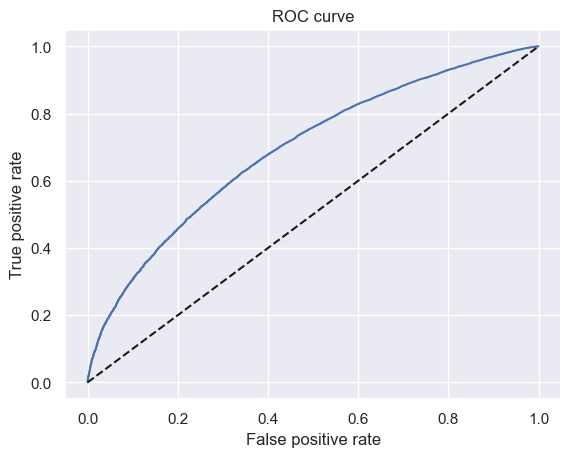

In [492]:
plt.plot(fpr, tpr)
plt.plot(fpr, fpr, linestyle = '--', color = 'k')
plt.xlabel('False positive rate')
plt.ylabel('True positive rate')
plt.title('ROC curve')

In [493]:
thresholds

array([       inf, 0.99276993, 0.99130812, ..., 0.39812943, 0.39442921,
       0.37925043])

In [494]:
thresholds.shape

(17318,)

In [495]:
df_cutoffs = pd.concat([pd.DataFrame(thresholds), pd.DataFrame(fpr), pd.DataFrame(tpr)], axis = 1)
# We concatenate 3 dataframes along the columns.

In [496]:
df_cutoffs.columns = ['thresholds', 'fpr', 'tpr']
# We name the columns of the dataframe 'thresholds', 'fpr', and 'tpr'.

In [497]:
df_cutoffs.head()

,thresholds,fpr,tpr
0,inf,0.000000,0.000000
1,0.992770,0.000000,0.000012
2,0.991308,0.000000,0.000096
3,0.991304,0.000099,0.000096
4,0.987209,0.000099,0.004283


In [498]:
df_cutoffs['thresholds'][0] = 1 - 1 / np.power(10, 16)
# Let the first threshold (the value of the thresholds column with index 0) be equal to a number, very close to 1
# but smaller than 1, say 1 - 1 / 10 ^ 16.

In [499]:
df_cutoffs['Score'] = ((np.log(df_cutoffs['thresholds'] / (1 - df_cutoffs['thresholds'])) - min_sum_coef) * ((max_score - min_score) / (max_sum_coef - min_sum_coef)) + min_score).round()
# The score corresponsing to each threshold equals:
# The the difference between the natural logarithm of the ratio of the threshold and 1 minus the threshold and
# the minimum sum of coefficients
# multiplied by
# the sum of the minimum score and the ratio of the difference between the maximum score and minimum score and 
# the difference between the maximum sum of coefficients and the minimum sum of coefficients.

In [500]:
df_cutoffs.head()

,thresholds,fpr,tpr,Score
0,1.000000,0.000000,0.000000,2049.0
1,0.992770,0.000000,0.000012,797.0
2,0.991308,0.000000,0.000096,783.0
3,0.991304,0.000099,0.000096,783.0
4,0.987209,0.000099,0.004283,753.0


In [501]:
df_cutoffs['Score'][0] = max_score

In [502]:
df_cutoffs.head()

,thresholds,fpr,tpr,Score
0,1.000000,0.000000,0.000000,850.0
1,0.992770,0.000000,0.000012,797.0
2,0.991308,0.000000,0.000096,783.0
3,0.991304,0.000099,0.000096,783.0
4,0.987209,0.000099,0.004283,753.0


In [503]:
# We define a function called 'n_approved' which assigns a value of 1 if a predicted probability
# is greater than the parameter p, which is a threshold, and a value of 0, if it is not.
# Then it sums the column.
# Thus, if given any percentage values, the function will return
# the number of rows wih estimated probabilites greater than the threshold. 
def n_approved(p):
    return np.where(df_actual_predicted_probs['y_hat_test_proba'] >= p, 1, 0).sum()

In [504]:
df_cutoffs['N Approved'] = df_cutoffs['thresholds'].apply(n_approved)
# Assuming that all credit applications above a given probability of being 'good' will be approved,
# when we apply the 'n_approved' function to a threshold, it will return the number of approved applications.
# Thus, here we calculate the number of approved appliations for al thresholds.
df_cutoffs['N Rejected'] = df_actual_predicted_probs['y_hat_test_proba'].shape[0] - df_cutoffs['N Approved']
# Then, we calculate the number of rejected applications for each threshold.
# It is the difference between the total number of applications and the approved applications for that threshold.
df_cutoffs['Approval Rate'] = df_cutoffs['N Approved'] / df_actual_predicted_probs['y_hat_test_proba'].shape[0]
# Approval rate equalts the ratio of the approved applications and all applications.
df_cutoffs['Rejection Rate'] = 1 - df_cutoffs['Approval Rate']
# Rejection rate equals one minus approval rate.

In [505]:
df_cutoffs.head()

,thresholds,fpr,tpr,Score,N Approved,N Rejected,Approval Rate,Rejection Rate
0,1.000000,0.000000,0.000000,850.0,0,93252,0.000000,1.000000
1,0.992770,0.000000,0.000012,797.0,1,93251,0.000011,0.999989
2,0.991308,0.000000,0.000096,783.0,8,93244,0.000086,0.999914
3,0.991304,0.000099,0.000096,783.0,9,93243,0.000097,0.999903
4,0.987209,0.000099,0.004283,753.0,357,92895,0.003828,0.996172


In [506]:
df_cutoffs.iloc[5000: 6200, ]
# Here we display the dataframe with cutoffs form line with index 5000 to line with index 6200.

,thresholds,fpr,tpr,Score,N Approved,N Rejected,Approval Rate,Rejection Rate
5000,0.906127,0.261684,0.533101,595.0,46960,46292,0.503582,0.496418
5001,0.906111,0.261684,0.533233,595.0,46971,46281,0.503700,0.496300
5002,0.906109,0.261783,0.533233,595.0,46972,46280,0.503710,0.496290
5003,0.906081,0.261783,0.533486,595.0,46993,46259,0.503936,0.496064
5004,0.906079,0.261881,0.533486,595.0,46994,46258,0.503946,0.496054
5005,0.906071,0.261881,0.533594,595.0,47003,46249,0.504043,0.495957
5006,0.906067,0.261980,0.533594,595.0,47004,46248,0.504054,0.495946
5007,0.906067,0.261980,0.533618,595.0,47006,46246,0.504075,0.495925
5008,0.906065,0.262078,0.533618,595.0,47007,46245,0.504086,0.495914
5009,0.906063,0.262078,0.533642,595.0,47009,46243,0.504107,0.495893


In [507]:
df_cutoffs.iloc[1000: 2000, ]
# Here we display the dataframe with cutoffs form line with index 1000 to line with index 2000.

,thresholds,fpr,tpr,Score,N Approved,N Rejected,Approval Rate,Rejection Rate
1000,0.954588,0.050779,0.202334,654.0,17331,75921,0.185851,0.814149
1001,0.954543,0.050779,0.202623,654.0,17355,75897,0.186109,0.813891
1002,0.954543,0.050878,0.202623,654.0,17356,75896,0.186119,0.813881
1003,0.954481,0.050878,0.203080,654.0,17394,75858,0.186527,0.813473
1004,0.954479,0.050976,0.203080,654.0,17395,75857,0.186538,0.813462
1005,0.954475,0.050976,0.203116,654.0,17398,75854,0.186570,0.813430
1006,0.954475,0.051075,0.203116,654.0,17399,75853,0.186580,0.813420
1007,0.954430,0.051075,0.203441,654.0,17426,75826,0.186870,0.813130
1008,0.954430,0.051173,0.203441,654.0,17427,75825,0.186881,0.813119
1009,0.954400,0.051173,0.203574,654.0,17438,75814,0.186999,0.813001


In [508]:
inputs_train_with_ref_cat.to_csv('inputs_train_with_ref_cat.csv')

In [509]:
df_scorecard.to_csv('df_scorecard.csv')

## Monitoring

In [511]:
# Import Train and Test Data.
loan_data_inputs_train = pd.read_csv('X_train.csv', index_col = 0, low_memory = False)
loan_data_targets_train = pd.read_csv('y_train.csv', index_col = 0, header = None, low_memory = False)
loan_data_inputs_test = pd.read_csv('X_test.csv', index_col = 0, low_memory = False)
loan_data_targets_test = pd.read_csv('y_test.csv', index_col = 0, header = None, low_memory = False)

In [527]:
print("The row and columns of loan_data_input_train dataset are:\t", loan_data_inputs_train.shape)
print("The row and columns of loan_data_targets_tran dataset are:\t", loan_data_targets_train.shape)
print("The rows and columns of loan_data_input_test dataset are :\t", loan_data_inputs_test.shape)
print("The rows and columns of loan_data_targets_test dataset are:\t", loan_data_targets_test.shape)

The row and columns of loan_data_input_train dataset are:	 (373004, 324)
The row and columns of loan_data_targets_tran dataset are:	 (373005, 1)
The rows and columns of loan_data_input_test dataset are :	 (93252, 324)
The rows and columns of loan_data_targets_test dataset are:	 (93253, 1)


In [528]:
# Here we import the new data.
loan_data_backup = pd.read_csv(r"F:\Learning\CreditRiskModelingInPython\Src\loan_data_2015.csv", low_memory=False)

In [529]:
print("The rows and columns of dataset loan_data_backup are:\t", loan_data_backup.shape)

The rows and columns of dataset loan_data_backup are:	 (421094, 74)


### Explore Data

In [530]:
loan_data = loan_data_backup.copy()

In [531]:
pd.options.display.max_columns = None
#pd.options.display.max_rows = None
# Sets the pandas dataframe options to display all columns/ rows.

In [532]:
loan_data.head()

,id,member_id,loan_amnt,funded_amnt,funded_amnt_inv,term,int_rate,installment,grade,sub_grade,emp_title,emp_length,home_ownership,annual_inc,verification_status,issue_d,loan_status,pymnt_plan,url,desc,purpose,title,zip_code,addr_state,dti,delinq_2yrs,earliest_cr_line,inq_last_6mths,mths_since_last_delinq,mths_since_last_record,open_acc,pub_rec,revol_bal,revol_util,total_acc,initial_list_status,out_prncp,out_prncp_inv,total_pymnt,total_pymnt_inv,total_rec_prncp,total_rec_int,total_rec_late_fee,recoveries,collection_recovery_fee,last_pymnt_d,last_pymnt_amnt,next_pymnt_d,last_credit_pull_d,collections_12_mths_ex_med,mths_since_last_major_derog,policy_code,application_type,annual_inc_joint,dti_joint,verification_status_joint,acc_now_delinq,tot_coll_amt,tot_cur_bal,open_acc_6m,open_il_6m,open_il_12m,open_il_24m,mths_since_rcnt_il,total_bal_il,il_util,open_rv_12m,open_rv_24m,max_bal_bc,all_util,total_rev_hi_lim,inq_fi,total_cu_tl,inq_last_12m
0,68444620,73334399,35000,35000,35000.0,60 months,11.99,778.38,C,C1,Foreign Service Officer,10+ years,MORTGAGE,128000.0,Source Verified,Dec-15,Issued,n,https://www.lendingclub.com/browse/loanDetail....,NaN,home_improvement,Home improvement,200xx,DC,6.46,0.0,Feb-90,0.0,46.0,NaN,17.0,0.0,14277,27.4,46.0,w,35000.0,35000.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,NaN,0.0,Jan-16,Jan-16,0.0,56.0,1,INDIVIDUAL,NaN,NaN,NaN,0.0,321.0,146867.0,1.0,11.0,0.0,0.0,28.0,35367.0,49.3,0.0,1.0,5020.0,40.1,52200.0,1.0,4.0,0.0
1,68547583,73437441,8650,8650,8650.0,36 months,5.32,260.50,A,A1,Associate Consultant,< 1 year,MORTGAGE,100000.0,Not Verified,Dec-15,Issued,n,https://www.lendingclub.com/browse/loanDetail....,NaN,credit_card,Credit card refinancing,462xx,IN,7.28,0.0,Jul-01,0.0,NaN,NaN,15.0,0.0,7158,26.7,24.0,w,8650.0,8650.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,NaN,0.0,Jan-16,Jan-16,0.0,NaN,1,INDIVIDUAL,NaN,NaN,NaN,0.0,0.0,165450.0,0.0,1.0,1.0,1.0,11.0,24041.0,88.8,0.0,3.0,3081.0,57.9,26800.0,1.0,0.0,5.0
2,67849662,72708407,4225,4225,4225.0,36 months,14.85,146.16,C,C5,mechanic,5 years,RENT,35000.0,Source Verified,Dec-15,Issued,n,https://www.lendingclub.com/browse/loanDetail....,NaN,debt_consolidation,Debt consolidation,672xx,KS,15.22,2.0,Jul-11,0.0,18.0,NaN,6.0,0.0,1058,24.6,6.0,w,4225.0,4225.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,NaN,0.0,Jan-16,Jan-16,0.0,NaN,1,INDIVIDUAL,NaN,NaN,NaN,0.0,0.0,4888.0,0.0,1.0,0.0,0.0,47.0,3830.0,21.9,0.0,0.0,367.0,22.4,4300.0,0.0,0.0,0.0
3,68506885,73396712,10000,10000,10000.0,60 months,11.99,222.40,C,C1,CARDIOVASCULAR TECH,10+ years,RENT,42500.0,Not Verified,Dec-15,Issued,n,https://www.lendingclub.com/browse/loanDetail....,NaN,debt_consolidation,Debt consolidation,460xx,IN,31.04,0.0,Dec-98,1.0,NaN,NaN,10.0,0.0,5812,40.9,23.0,w,10000.0,10000.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,NaN,0.0,Jan-16,Jan-16,0.0,NaN,1,INDIVIDUAL,NaN,NaN,NaN,0.0,0.0,41166.0,1.0,3.0,0.0,2.0,13.0,35354.0,75.5,1.0,1.0,3118.0,67.4,14200.0,1.0,1.0,1.0
4,68341763,72928789,20000,20000,20000.0,60 months,10.78,432.66,B,B4,truck driver,10+ years,MORTGAGE,63000.0,Not Verified,Dec-15,Issued,n,https://www.lendingclub.com/browse/loanDetail....,NaN,home_improvement,NaN,605xx,IL,10.78,0.0,Aug-00,0.0,NaN,NaN,6.0,0.0,7869,56.2,18.0,w,20000.0,20000.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,NaN,0.0,Jan-16,Dec-15,0.0,NaN,1,JOINT,71000.0,13.85,Not Verified,0.0,0.0,189699.0,0.0,1.0,0.0,4.0,19.0,10827.0,72.8,0.0,2.0,2081.0,64.7,14000.0,2.0,5.0,1.0


In [533]:
loan_data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 421094 entries, 0 to 421093
Data columns (total 74 columns):
 #   Column                       Non-Null Count   Dtype  
---  ------                       --------------   -----  
 0   id                           421094 non-null  int64  
 1   member_id                    421094 non-null  int64  
 2   loan_amnt                    421094 non-null  int64  
 3   funded_amnt                  421094 non-null  int64  
 4   funded_amnt_inv              421094 non-null  float64
 5   term                         421094 non-null  object 
 6   int_rate                     421094 non-null  float64
 7   installment                  421094 non-null  float64
 8   grade                        421094 non-null  object 
 9   sub_grade                    421094 non-null  object 
 10  emp_title                    397220 non-null  object 
 11  emp_length                   397277 non-null  object 
 12  home_ownership               421094 non-null  object 
 13 

### Population Stability Index: Preprocessing

### >>> The code from here to the other line starting with '>>>' is copied from the Data Preparation notebook, with minor adjustments. We have to perform the exact same data preprocessing, fine-classing, and coarse classing on the new data, in order to be able to calculate statistics for the exact same variables to the ones we used for training and testing the PD model.

#### Preprocessing few continuous variables

#### General Preprocessing

In [534]:
loan_data['emp_length'].unique()

array(['10+ years', '< 1 year', '5 years', '3 years', '4 years', nan,
       '2 years', '8 years', '9 years', '1 year', '6 years', '7 years'],
      dtype=object)

In [535]:
loan_data['emp_length_int'] = loan_data['emp_length'].str.replace('+ years', '')
loan_data['emp_length_int'] = loan_data['emp_length_int'].str.replace('< 1 year', str(0))
loan_data['emp_length_int'] = loan_data['emp_length_int'].str.replace('n/a',  str(0))
loan_data['emp_length_int'] = loan_data['emp_length_int'].str.replace(' years', '')
loan_data['emp_length_int'] = loan_data['emp_length_int'].str.replace(' year', '')
# We store the preprocessed ‘employment length’ variable in a new variable called ‘employment length int’,
# We assign the new ‘employment length int’ to be equal to the ‘employment length’ variable with the string ‘+ years’
# replaced with nothing. Next, we replace the whole string ‘less than 1 year’ with the string ‘0’.
# Then, we replace the ‘n/a’ string with the string ‘0’. Then, we replace the string ‘space years’ with nothing.
# Finally, we replace the string ‘space year’ with nothing.

In [536]:
loan_data['emp_length_int'] = pd.to_numeric(loan_data['emp_length_int'])
# Transforms the values to numeric.

In [537]:
loan_data['emp_length_int'].value_counts()

emp_length_int
10.0    141520
2.0      37497
0.0      34340
3.0      33430
1.0      27473
5.0      24930
4.0      24506
8.0      21560
7.0      18414
6.0      16838
9.0      16769
Name: count, dtype: int64

In [538]:
loan_data['earliest_cr_line_date'] = pd.to_datetime(loan_data['earliest_cr_line'], format = '%b-%y')
# Extracts the date and the time from a string variable that is in a given format.

In [539]:
# Any date which is greater then 2018-12-01 is incorrect and so we should replace the first two digitis of the year from 20 to 19

loan_data['earliest_cr_line_date'] = loan_data['earliest_cr_line_date'].apply(lambda x: x.replace(year=x.year - 100) if x.year > 2018 else x)

In [540]:
# Assume we are now in December 2018
from dateutil.relativedelta import relativedelta

def calculate_months_difference(x):
    try:
        diff = relativedelta(pd.to_datetime('2018-12-01'), x)
        months_diff = diff.years * 12 + diff.months
        return months_diff
    except Exception as e:
        return None  # Handle cases where the date conversion or calculation fails

# Assuming you have a DataFrame with a column 'earliest_cr_line_date' containing datetime values
loan_data['mths_since_earliest_cr_line'] = loan_data['earliest_cr_line_date'].apply(calculate_months_difference)

# Option 1:
# Drop rows where the calculation failed (result is None)

loan_data = loan_data.dropna(subset=['mths_since_earliest_cr_line'])

# Option 2:
# We can also fill something there to check further
#loan_data['mths_since_earliest_cr_line'].fillna(pd.to_datetime('1900-01-01'), inplace = True)

# Round the result if needed
loan_data['mths_since_earliest_cr_line'] = loan_data['mths_since_earliest_cr_line'].round()

In [541]:
loan_data['mths_since_earliest_cr_line'].describe()
# Shows some descriptive statisics for the values of a column.
# Dates from 1969 and before are not being converted well, i.e., they have become 2069 and similar,
# and negative differences are being calculated.

count    421094.000000
mean        242.586458
std          91.329014
min          73.000000
25%         180.000000
50%         224.000000
75%         290.000000
max         899.000000
Name: mths_since_earliest_cr_line, dtype: float64

In [542]:
loan_data.loc[: , ['earliest_cr_line', 'earliest_cr_line_date', 'mths_since_earliest_cr_line']][loan_data['mths_since_earliest_cr_line'] < 0]
# We take three columns from the dataframe. Then, we display them only for the rows where a variable has negative value.
# There are 2303 strange negative values.

,earliest_cr_line,earliest_cr_line_date,mths_since_earliest_cr_line


In [543]:
# We set all these negative differences to the maximum.
loan_data['mths_since_earliest_cr_line'][loan_data['mths_since_earliest_cr_line'] < 0] = loan_data['mths_since_earliest_cr_line'].max()

C:\Users\dcgzb\AppData\Local\Temp\ipykernel_10772\1880721778.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  loan_data['mths_since_earliest_cr_line'][loan_data['mths_since_earliest_cr_line'] < 0] = loan_data['mths_since_earliest_cr_line'].max()


In [544]:
min(loan_data['mths_since_earliest_cr_line'])

73

In [545]:
loan_data['term'].describe()

count         421094
unique             2
top        36 months
freq          283172
Name: term, dtype: object

In [546]:
loan_data['term_int'] = loan_data['term'].str.replace(' months', '')

In [547]:
type(loan_data['term_int'])
type(loan_data['term_int'][25])

str

In [548]:
loan_data['term_int'] = pd.to_numeric(loan_data['term'].str.replace(' months', ''))
loan_data['term_int']

0         60
1         36
2         36
3         60
4         60
5         36
6         36
7         36
8         36
9         36
10        60
11        60
12        36
13        60
14        60
15        36
16        36
17        60
18        36
19        36
20        60
21        36
22        36
23        60
24        36
25        60
26        36
27        60
28        36
29        36
30        36
31        36
32        36
33        60
34        60
35        36
36        36
37        36
38        36
39        36
40        36
41        36
42        36
43        60
44        36
45        36
46        36
47        60
48        60
49        36
50        36
51        36
52        36
53        36
54        60
55        60
56        60
57        60
58        60
59        36
60        60
61        60
62        60
63        60
64        60
65        36
66        60
67        36
68        60
69        36
70        36
71        36
72        60
73        60
74        36
75        36
76        60

In [549]:
type(loan_data['term_int'][0])

numpy.int64

In [550]:
loan_data['issue_d']

0         Dec-15
1         Dec-15
2         Dec-15
3         Dec-15
4         Dec-15
5         Dec-15
6         Dec-15
7         Dec-15
8         Dec-15
9         Dec-15
10        Dec-15
11        Dec-15
12        Dec-15
13        Dec-15
14        Dec-15
15        Dec-15
16        Dec-15
17        Dec-15
18        Dec-15
19        Dec-15
20        Dec-15
21        Dec-15
22        Dec-15
23        Dec-15
24        Dec-15
25        Dec-15
26        Dec-15
27        Dec-15
28        Dec-15
29        Dec-15
30        Dec-15
31        Dec-15
32        Dec-15
33        Dec-15
34        Dec-15
35        Dec-15
36        Dec-15
37        Dec-15
38        Dec-15
39        Dec-15
40        Dec-15
41        Dec-15
42        Dec-15
43        Dec-15
44        Dec-15
45        Dec-15
46        Dec-15
47        Dec-15
48        Dec-15
49        Dec-15
50        Dec-15
51        Dec-15
52        Dec-15
53        Dec-15
54        Dec-15
55        Dec-15
56        Dec-15
57        Dec-15
58        Dec-

In [551]:
# Assume we are now in December 2017
loan_data['issue_d_date'] = pd.to_datetime(loan_data['issue_d'], format = '%b-%y')

In [552]:
loan_data['issue_d_date'].value_counts() 

issue_d_date
2015-10-01    48631
2015-07-01    45962
2015-12-01    44342
2015-11-01    37530
2015-08-01    35886
2015-04-01    35427
2015-01-01    35107
2015-05-01    31913
2015-09-01    28641
2015-06-01    28485
2015-03-01    25400
2015-02-01    23770
Name: count, dtype: int64

In [553]:
def calculate_months_difference(x):
    try:
        diff = relativedelta(pd.to_datetime('2018-12-01'), x)
        months_diff = diff.years * 12 + diff.months
        return months_diff
    except Exception as e:
        return None  # Handle cases where the date conversion or calculation fails

# Assuming you have a DataFrame with a column 'earliest_cr_line_date' containing datetime values
loan_data['mths_since_issue_d'] = loan_data['issue_d_date'].apply(calculate_months_difference)

# Drop rows where the calculation failed (result is None)
loan_data = loan_data.dropna(subset=['mths_since_issue_d'])

# Round the result if needed
loan_data['mths_since_issue_d'] = loan_data['mths_since_issue_d'].round()

In [554]:
# We save the result in a new variable.
loan_data['mths_since_issue_d'].describe()
# Shows some descriptive statisics for the values of a column.

count    421094.000000
mean         41.044629
std           3.458162
min          36.000000
25%          38.000000
50%          41.000000
75%          44.000000
max          47.000000
Name: mths_since_issue_d, dtype: float64

In [555]:
loan_data.loc[:,['issue_d','issue_d_date','mths_since_issue_d']].sample(10)

,issue_d,issue_d_date,mths_since_issue_d
171689,Aug-15,2015-08-01,40
360801,Feb-15,2015-02-01,46
202729,Jul-15,2015-07-01,41
50065,Dec-15,2015-12-01,36
202208,Jul-15,2015-07-01,41
274174,May-15,2015-05-01,43
3018,Dec-15,2015-12-01,36
84732,Oct-15,2015-10-01,38
169845,Aug-15,2015-08-01,40
159204,Sep-15,2015-09-01,39


In [556]:
loan_data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 421094 entries, 0 to 421093
Data columns (total 80 columns):
 #   Column                       Non-Null Count   Dtype         
---  ------                       --------------   -----         
 0   id                           421094 non-null  int64         
 1   member_id                    421094 non-null  int64         
 2   loan_amnt                    421094 non-null  int64         
 3   funded_amnt                  421094 non-null  int64         
 4   funded_amnt_inv              421094 non-null  float64       
 5   term                         421094 non-null  object        
 6   int_rate                     421094 non-null  float64       
 7   installment                  421094 non-null  float64       
 8   grade                        421094 non-null  object        
 9   sub_grade                    421094 non-null  object        
 10  emp_title                    397220 non-null  object        
 11  emp_length                

In [557]:
loan_data_dummies = [pd.get_dummies(loan_data['grade'], prefix = 'grade', prefix_sep = ':'),
                     pd.get_dummies(loan_data['sub_grade'], prefix = 'sub_grade', prefix_sep = ':'),
                     pd.get_dummies(loan_data['home_ownership'], prefix = 'home_ownership', prefix_sep = ':'),
                     pd.get_dummies(loan_data['verification_status'], prefix = 'verification_status', prefix_sep = ':'),
                     pd.get_dummies(loan_data['loan_status'], prefix = 'loan_status', prefix_sep = ':'),
                     pd.get_dummies(loan_data['purpose'], prefix = 'purpose', prefix_sep = ':'),
                     pd.get_dummies(loan_data['addr_state'], prefix = 'addr_state', prefix_sep = ':'),
                     pd.get_dummies(loan_data['initial_list_status'], prefix = 'initial_list_status', prefix_sep = ':')]
loan_data_dummies = pd.concat(loan_data_dummies, axis = 1)

In [558]:
type(loan_data_dummies)

pandas.core.frame.DataFrame

In [559]:
loan_data_dummies.shape

(421094, 122)

In [560]:
loan_data_dummies.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 421094 entries, 0 to 421093
Columns: 122 entries, grade:A to initial_list_status:w
dtypes: bool(122)
memory usage: 49.0 MB


In [561]:
loan_data = pd.concat([loan_data, loan_data_dummies], axis = 1)

In [562]:
loan_data.columns.values

array(['id', 'member_id', 'loan_amnt', 'funded_amnt', 'funded_amnt_inv',
       'term', 'int_rate', 'installment', 'grade', 'sub_grade',
       'emp_title', 'emp_length', 'home_ownership', 'annual_inc',
       'verification_status', 'issue_d', 'loan_status', 'pymnt_plan',
       'url', 'desc', 'purpose', 'title', 'zip_code', 'addr_state', 'dti',
       'delinq_2yrs', 'earliest_cr_line', 'inq_last_6mths',
       'mths_since_last_delinq', 'mths_since_last_record', 'open_acc',
       'pub_rec', 'revol_bal', 'revol_util', 'total_acc',
       'initial_list_status', 'out_prncp', 'out_prncp_inv', 'total_pymnt',
       'total_pymnt_inv', 'total_rec_prncp', 'total_rec_int',
       'total_rec_late_fee', 'recoveries', 'collection_recovery_fee',
       'last_pymnt_d', 'last_pymnt_amnt', 'next_pymnt_d',
       'last_credit_pull_d', 'collections_12_mths_ex_med',
       'mths_since_last_major_derog', 'policy_code', 'application_type',
       'annual_inc_joint', 'dti_joint', 'verification_status_joint

In [563]:
pd.options.display.max_rows = None
loan_data.isnull().sum()

id                                          0
member_id                                   0
loan_amnt                                   0
funded_amnt                                 0
funded_amnt_inv                             0
term                                        0
int_rate                                    0
installment                                 0
grade                                       0
sub_grade                                   0
emp_title                               23874
emp_length                              23817
home_ownership                              0
annual_inc                                  0
verification_status                         0
issue_d                                     0
loan_status                                 0
pymnt_plan                                  0
url                                         0
desc                                   421049
purpose                                     0
title                             

In [564]:
pd.options.display.max_rows = 100

# 'Total revolving high credit/credit limit', so it makes sense that the missing values are equal to funded_amnt.
loan_data['total_rev_hi_lim'].fillna(loan_data['funded_amnt'], inplace=True)

In [565]:
loan_data['mths_since_earliest_cr_line'].fillna(0, inplace=True)

In [566]:
loan_data['acc_now_delinq'].fillna(0, inplace=True)
loan_data['total_acc'].fillna(0, inplace=True)
loan_data['pub_rec'].fillna(0, inplace=True)
loan_data['open_acc'].fillna(0, inplace=True)
loan_data['inq_last_6mths'].fillna(0, inplace=True)
loan_data['delinq_2yrs'].fillna(0, inplace=True)
loan_data['emp_length_int'].fillna(0, inplace=True)

In [567]:
loan_data['annual_inc'].fillna(loan_data['annual_inc'].mean(), inplace=True)

In [568]:
loan_data['loan_status'].unique()

array(['Issued', 'Current', 'Fully Paid', 'In Grace Period',
       'Late (16-30 days)', 'Late (31-120 days)', 'Charged Off',
       'Default'], dtype=object)

In [569]:
loan_data['loan_status'].value_counts()

loan_status
Current               377553
Fully Paid             22984
Issued                  8460
Late (31-120 days)      4691
In Grace Period         3107
Charged Off             2773
Late (16-30 days)       1139
Default                  387
Name: count, dtype: int64

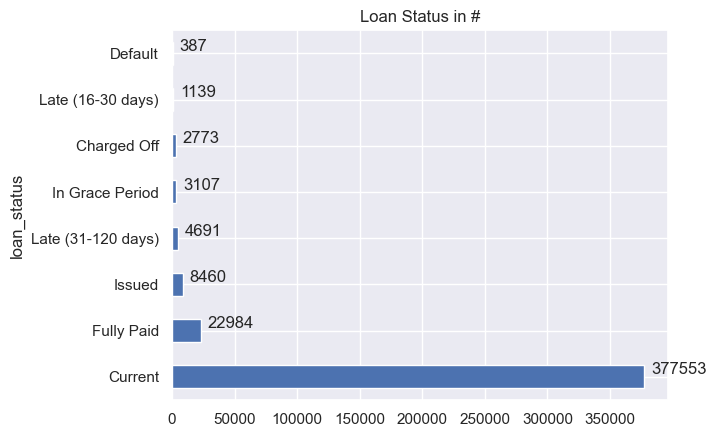

In [570]:
import matplotlib.pyplot as plt           
import seaborn as sns  
sns.set()
ax = loan_data['loan_status'].value_counts().plot(kind='barh')

for p in ax.patches:
        ax.annotate(str(p.get_width()), (p.get_x() + p.get_width(), p.get_y()), xytext=(5, 10), textcoords='offset points')

# Show the plot
plt.title("Loan Status in #")
plt.show()

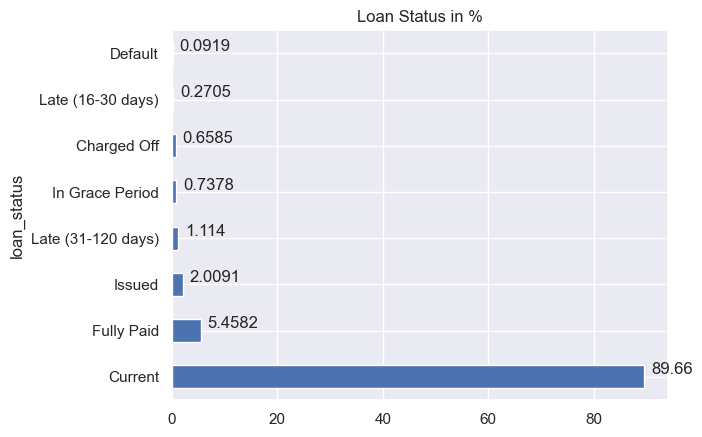

In [571]:
ax = (round(loan_data['loan_status'].value_counts() / loan_data['loan_status'].count()*100, 4)).plot(kind = 'barh')
# We divide the number of observations for each unique value of a variable by the total number of observations.
# Thus, we get the proportion of observations for each unique value of a variable.
for p in ax.patches:
        ax.annotate(str(p.get_width()), (p.get_x() + p.get_width(), p.get_y()), xytext=(5, 10), textcoords='offset points')

# Show the plot
plt.title("Loan Status in %")
plt.show()

In [572]:
# Good/ Bad Definition
loan_data['good_bad'] = np.where(loan_data['loan_status'].isin(['Charged Off', 'Default',
                                                       'Does not meet the credit policy. Status:Charged Off',
                                                       'Late (31-120 days)']), 0, 1)

In [574]:
loan_data['good_bad'].value_counts()

good_bad
1    413243
0      7851
Name: count, dtype: int64

In [575]:
from sklearn.model_selection import train_test_split

In [576]:
loan_data.drop('good_bad', axis = 1)

,id,member_id,loan_amnt,funded_amnt,funded_amnt_inv,term,int_rate,installment,grade,sub_grade,emp_title,emp_length,home_ownership,annual_inc,verification_status,issue_d,loan_status,pymnt_plan,url,desc,purpose,title,zip_code,addr_state,dti,delinq_2yrs,earliest_cr_line,inq_last_6mths,mths_since_last_delinq,mths_since_last_record,open_acc,pub_rec,revol_bal,revol_util,total_acc,initial_list_status,out_prncp,out_prncp_inv,total_pymnt,total_pymnt_inv,total_rec_prncp,total_rec_int,total_rec_late_fee,recoveries,collection_recovery_fee,last_pymnt_d,last_pymnt_amnt,next_pymnt_d,last_credit_pull_d,collections_12_mths_ex_med,mths_since_last_major_derog,policy_code,application_type,annual_inc_joint,dti_joint,verification_status_joint,acc_now_delinq,tot_coll_amt,tot_cur_bal,open_acc_6m,open_il_6m,open_il_12m,open_il_24m,mths_since_rcnt_il,total_bal_il,il_util,open_rv_12m,open_rv_24m,max_bal_bc,all_util,total_rev_hi_lim,inq_fi,total_cu_tl,inq_last_12m,emp_length_int,earliest_cr_line_date,mths_since_earliest_cr_line,term_int,issue_d_date,mths_since_issue_d,grade:A,grade:B,grade:C,grade:D,grade:E,grade:F,grade:G,sub_grade:A1,sub_grade:A2,sub_grade:A3,sub_grade:A4,sub_grade:A5,sub_grade:B1,sub_grade:B2,sub_grade:B3,sub_grade:B4,sub_grade:B5,sub_grade:C1,sub_grade:C2,sub_grade:C3,sub_grade:C4,sub_grade:C5,sub_grade:D1,sub_grade:D2,sub_grade:D3,sub_grade:D4,sub_grade:D5,sub_grade:E1,sub_grade:E2,sub_grade:E3,sub_grade:E4,sub_grade:E5,sub_grade:F1,sub_grade:F2,sub_grade:F3,sub_grade:F4,sub_grade:F5,sub_grade:G1,sub_grade:G2,sub_grade:G3,sub_grade:G4,sub_grade:G5,home_ownership:ANY,home_ownership:MORTGAGE,home_ownership:OWN,home_ownership:RENT,verification_status:Not Verified,verification_status:Source Verified,verification_status:Verified,loan_status:Charged Off,loan_status:Current,loan_status:Default,loan_status:Fully Paid,loan_status:In Grace Period,loan_status:Issued,loan_status:Late (16-30 days),loan_status:Late (31-120 days),purpose:car,purpose:credit_card,purpose:debt_consolidation,purpose:educational,purpose:home_improvement,purpose:house,purpose:major_purchase,purpose:medical,purpose:moving,purpose:other,purpose:renewable_energy,purpose:small_business,purpose:vacation,purpose:wedding,addr_state:AK,addr_state:AL,addr_state:AR,addr_state:AZ,addr_state:CA,addr_state:CO,addr_state:CT,addr_state:DC,addr_state:DE,addr_state:FL,addr_state:GA,addr_state:HI,addr_state:IL,addr_state:IN,addr_state:KS,addr_state:KY,addr_state:LA,addr_state:MA,addr_state:MD,addr_state:ME,addr_state:MI,addr_state:MN,addr_state:MO,addr_state:MS,addr_state:MT,addr_state:NC,addr_state:ND,addr_state:NE,addr_state:NH,addr_state:NJ,addr_state:NM,addr_state:NV,addr_state:NY,addr_state:OH,addr_state:OK,addr_state:OR,addr_state:PA,addr_state:RI,addr_state:SC,addr_state:SD,addr_state:TN,addr_state:TX,addr_state:UT,addr_state:VA,addr_state:VT,addr_state:WA,addr_state:WI,addr_state:WV,addr_state:WY,initial_list_status:f,initial_list_status:w
0,68444620,73334399,35000,35000,35000.0,60 months,11.99,778.38,C,C1,Foreign Service Officer,10+ years,MORTGAGE,128000.0,Source Verified,Dec-15,Issued,n,https://www.lendingclub.com/browse/loanDetail....,NaN,home_improvement,Home improvement,200xx,DC,6.46,0.0,Feb-90,0.0,46.0,NaN,17.0,0.0,14277,27.4,46.0,w,35000.00,35000.00,0.00,0.00,0.00,0.00,0.0,0.0,0.0,NaN,0.00,Jan-16,Jan-16,0.0,56.0,1,INDIVIDUAL,NaN,NaN,NaN,0.0,321.0,146867.0,1.0,11.0,0.0,0.0,28.0,35367.0,49.3,0.0,1.0,5020.0,40.1,52200.0,1.0,4.0,0.0,10.0,1990-02-01,346,60,2015-12-01,36,False,False,True,False,False,False,False,False,False,False,False,False,False,False,False,False,False,True,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,True,False,False,False,True,False,False,False,False,False,False,True,False,False,False,False,False,False,True,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,True,False,False,False,False,False,False,False,False,Fa

In [577]:
loan_data['good_bad'].value_counts()

good_bad
1    413243
0      7851
Name: count, dtype: int64

In [578]:
#####
df_inputs_prepr = loan_data.drop('good_bad', axis = 1)
df_targets_prepr = loan_data['good_bad']
#####
#df_inputs_prepr = loan_data_inputs_test
##df_targets_prepr = loan_data_targets_test

In [579]:
# WoE function for discrete unordered variables
def woe_discrete(df, discrete_variabe_name, good_bad_variable_df):
    df = pd.concat([df[discrete_variabe_name], good_bad_variable_df], axis = 1)
    df = pd.concat([df.groupby(df.columns.values[0], as_index = False)[df.columns.values[1]].count(),
                    df.groupby(df.columns.values[0], as_index = False)[df.columns.values[1]].mean()], axis = 1)
    df = df.iloc[:, [0, 1, 3]]
    df.columns = [df.columns.values[0], 'n_obs', 'prop_good']
    df['prop_n_obs'] = df['n_obs'] / df['n_obs'].sum()
    df['n_good'] = df['prop_good'] * df['n_obs']
    df['n_bad'] = (1 - df['prop_good']) * df['n_obs']
    df['prop_n_good'] = df['n_good'] / df['n_good'].sum()
    df['prop_n_bad'] = df['n_bad'] / df['n_bad'].sum()
    df['WoE'] = np.log(df['prop_n_good'] / df['prop_n_bad'])
    df = df.sort_values(['WoE'])
    df = df.reset_index(drop = True)
    df['diff_prop_good'] = df['prop_good'].diff().abs()
    df['diff_WoE'] = df['WoE'].diff().abs()
    df['IV'] = (df['prop_n_good'] - df['prop_n_bad']) * df['WoE']
    df['IV'] = df['IV'].sum()
    return df
# Here we combine all of the operations above in a function.
# The function takes 3 arguments: a dataframe, a string, and a dataframe. The function returns a dataframe as a result.

In [580]:
# 'grade', 'home_ownership', 'verification_status',
# 'purpose', 'addr_state', 'initial_list_status'

In [581]:
# 'grade'
df_temp = woe_discrete(df_inputs_prepr, 'grade', df_targets_prepr)
df_temp

,grade,n_obs,prop_good,prop_n_obs,n_good,n_bad,prop_n_good,prop_n_bad,WoE,diff_prop_good,diff_WoE,IV
0,G,2167,0.904015,0.005146,1959.0,208.0,0.004741,0.026493,-1.720744,NaN,NaN,0.633941
1,F,9817,0.930529,0.023313,9135.0,682.0,0.022106,0.086868,-1.368556,0.026514,0.352187,0.633941
2,E,34948,0.956936,0.082993,33443.0,1505.0,0.080928,0.191695,-0.862345,0.026407,0.506211,0.633941
3,D,62654,0.967488,0.148789,60617.0,2037.0,0.146686,0.259457,-0.570298,0.010552,0.292048,0.633941
4,C,120567,0.982541,0.286318,118462.0,2105.0,0.286664,0.268119,0.066882,0.015053,0.637180,0.633941
5,B,117606,0.991097,0.279287,116559.0,1047.0,0.282059,0.133359,0.749074,0.008557,0.682192,0.633941
6,A,73335,0.996359,0.174154,73068.0,267.0,0.176816,0.034008,1.648502,0.005262,0.899428,0.633941


In [582]:
import matplotlib.pyplot as plt
import seaborn as sns
sns.set()

In [583]:
# Below we define a function that takes 2 arguments: a dataframe and a number.
# The number parameter has a default value of 0.
# This means that if we call the function and omit the number parameter, it will be executed with it having a value of 0.
# The function displays a graph.

def plot_by_woe(df_WoE, rotation_of_x_axis_labels=0):
    x = np.array(df_WoE.iloc[:, 0].apply(str))
    # Turns the values of the column with index 0 to strings, makes an array from these strings, and passes it to variable x.
    y = df_WoE['WoE']
    # Selects a column with label 'WoE' and passes it to variable y.
    
    plt.figure(figsize=(18, 6))
    # Sets the graph size to width 18 x height 6.
    plt.plot(x, y, marker='o', linestyle='--', color='k')
    # Plots the datapoints with coordiantes variable x on the x-axis and variable y on the y-axis.
    # Sets the marker for each datapoint to a circle, the style line between the points to dashed, and the color to black.
    plt.xlabel(df_WoE.columns[0])
    # Names the x-axis with the name of the column with index 0.
    plt.ylabel('Weight of Evidence')
    # Names the y-axis 'Weight of Evidence'.
    plt.title('Weight of Evidence by ' + df_WoE.columns[0])
    # Names the grapth 'Weight of Evidence by ' the name of the column with index 0.
    
    for i, j in zip(x, y):
        plt.annotate(f'{j:.2f}', (i, j), textcoords='offset points', xytext=(0, 10), ha='center')
    # put the values of weight of evidence against each data coordinates
    
    plt.xticks(rotation=rotation_of_x_axis_labels)
    # Rotates the labels of the x-axis a predefined number of degrees.
    plt.show()

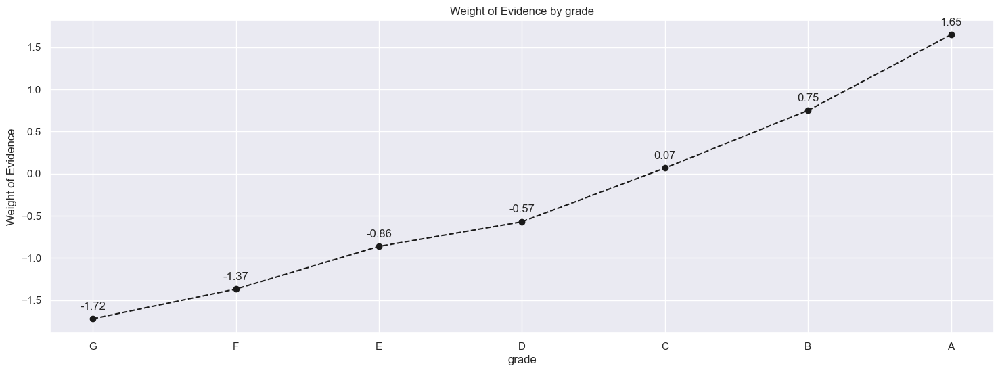

In [584]:
plot_by_woe(df_temp)

In [585]:
# 'home_ownership'
df_temp = woe_discrete(df_inputs_prepr, 'home_ownership', df_targets_prepr)
df_temp

,home_ownership,n_obs,prop_good,prop_n_obs,n_good,n_bad,prop_n_good,prop_n_bad,WoE,diff_prop_good,diff_WoE,IV
0,RENT,167644,0.976933,0.398115,163777.0,3867.0,0.396321,0.492549,-0.217368,NaN,NaN,inf
1,OWN,45766,0.980750,0.108684,44885.0,881.0,0.108616,0.112215,-0.032594,0.003817,0.184775,inf
2,MORTGAGE,207682,0.985059,0.493196,204579.0,3103.0,0.495057,0.395236,0.225190,0.004309,0.257784,inf
3,ANY,2,1.000000,0.000005,2.0,0.0,0.000005,0.000000,inf,0.014941,inf,inf


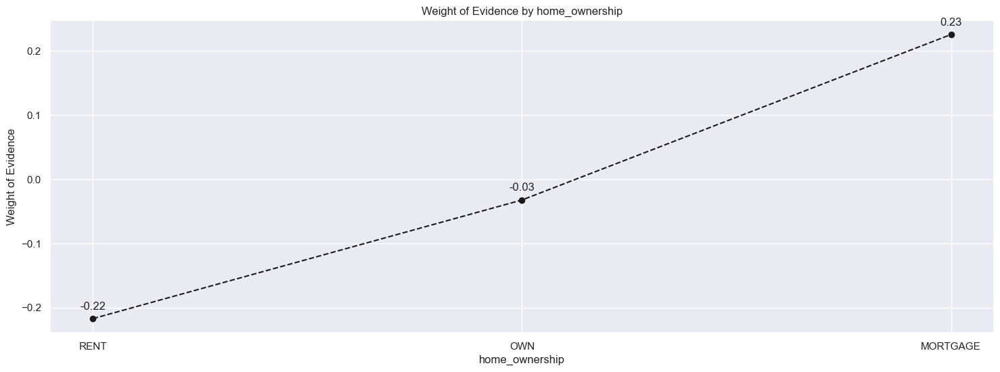

In [586]:
plot_by_woe(df_temp)

In [587]:
# There are many categories with very few observations and many categories with very different "good" %.
# Therefore, we create a new discrete variable where we combine some of the categories.
# 'OTHERS' and 'NONE' are riskiest but are very few. 'RENT' is the next riskiest.
# 'ANY' are least risky but are too few. Conceptually, they belong to the same category. Also, their inclusion would not change anything.
# We combine them in one category, 'RENT_OTHER_NONE_ANY'.
# We end up with 3 categories: 'RENT_OTHER_NONE_ANY', 'OWN', 'MORTGAGE'.

df_inputs_prepr['home_ownership:RENT_OTHER_NONE_ANY'] = sum([df_inputs_prepr['home_ownership:RENT'],
                                                      df_inputs_prepr['home_ownership:ANY']])
# 'RENT_OTHER_NONE_ANY' will be the reference category.

# Alternatively:
#loan_data.loc['home_ownership' in ['RENT', 'OTHER', 'NONE', 'ANY'], 'home_ownership:RENT_OTHER_NONE_ANY'] = 1
#loan_data.loc['home_ownership' not in ['RENT', 'OTHER', 'NONE', 'ANY'], 'home_ownership:RENT_OTHER_NONE_ANY'] = 0
#loan_data.loc['loan_status' not in ['OWN'], 'home_ownership:OWN'] = 1
#loan_data.loc['loan_status' not in ['OWN'], 'home_ownership:OWN'] = 0
#loan_data.loc['loan_status' not in ['MORTGAGE'], 'home_ownership:MORTGAGE'] = 1
#loan_data.loc['loan_status' not in ['MORTGAGE'], 'home_ownership:MORTGAGE'] = 0

In [588]:
loan_data['home_ownership'].unique()

array(['MORTGAGE', 'RENT', 'OWN', 'ANY'], dtype=object)

In [589]:
df_inputs_prepr['home_ownership:RENT_OTHER_NONE_ANY'] = sum([df_inputs_prepr['home_ownership:RENT'], df_inputs_prepr['home_ownership:ANY']])

In [590]:
# 'addr_state'
df_inputs_prepr['addr_state'].unique()

array(['DC', 'IN', 'KS', 'IL', 'OR', 'VA', 'PA', 'GA', 'TN', 'OH', 'NY',
       'FL', 'NJ', 'RI', 'NC', 'AL', 'TX', 'SC', 'MD', 'WA', 'MO', 'MN',
       'NH', 'VT', 'AZ', 'MI', 'MA', 'CA', 'LA', 'DE', 'NM', 'CO', 'WI',
       'SD', 'CT', 'NE', 'HI', 'AR', 'MT', 'WV', 'WY', 'OK', 'NV', 'KY',
       'MS', 'ME', 'UT', 'ND', 'AK'], dtype=object)

In [591]:
if ['addr_state:ND'] in df_inputs_prepr.columns.values:
    pass
else:
    df_inputs_prepr['addr_state:ND'] = 0

In [592]:
if ['addr_state:ID'] in df_inputs_prepr.columns.values:
    pass
else:
    df_inputs_prepr['addr_state:ID'] = 0

In [593]:
if ['addr_state:IA'] in df_inputs_prepr.columns.values:
    pass
else:
    df_inputs_prepr['addr_state:IA'] = 0

In [594]:
df_temp = woe_discrete(df_inputs_prepr, 'addr_state', df_targets_prepr)
df_temp

,addr_state,n_obs,prop_good,prop_n_obs,n_good,n_bad,prop_n_good,prop_n_bad,WoE,diff_prop_good,diff_WoE,IV
0,NV,5924,0.969953,0.014068,5746.0,178.0,0.013905,0.022672,-0.488919,NaN,NaN,inf
1,SD,835,0.970060,0.001983,810.0,25.0,0.001960,0.003184,-0.485236,0.000107,0.003683,inf
2,HI,2083,0.973596,0.004947,2028.0,55.0,0.004908,0.007005,-0.355923,0.003536,0.129314,inf
3,OK,3968,0.976310,0.009423,3874.0,94.0,0.009375,0.011973,-0.244647,0.002715,0.111276,inf
4,AK,954,0.977987,0.002266,933.0,21.0,0.002258,0.002675,-0.169512,0.001677,0.075135,inf
5,NY,33844,0.978253,0.080372,33108.0,736.0,0.080118,0.093746,-0.157095,0.000266,0.012417,inf
6,AL,5347,0.978306,0.012698,5231.0,116.0,0.012658,0.014775,-0.154627,0.000052,0.002467,inf
7,UT,2836,0.978491,0.006735,2775.0,61.0,0.006715,0.007770,-0.145863,0.000185,0.008765,inf
8,WY,900,0.978889,0.002137,881.0,19.0,0.002132,0.002420,-0.126776,0.000398,0.019086,inf
9,FL,29298,0.979111,0.069576,28686.0,612.0,0.069417,0.077952,-0.115963,0.000222,0.010814,inf


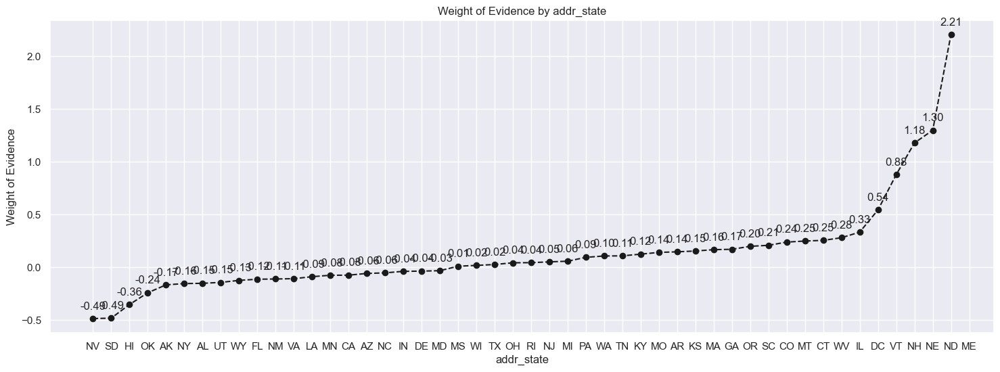

In [595]:
plot_by_woe(df_temp)

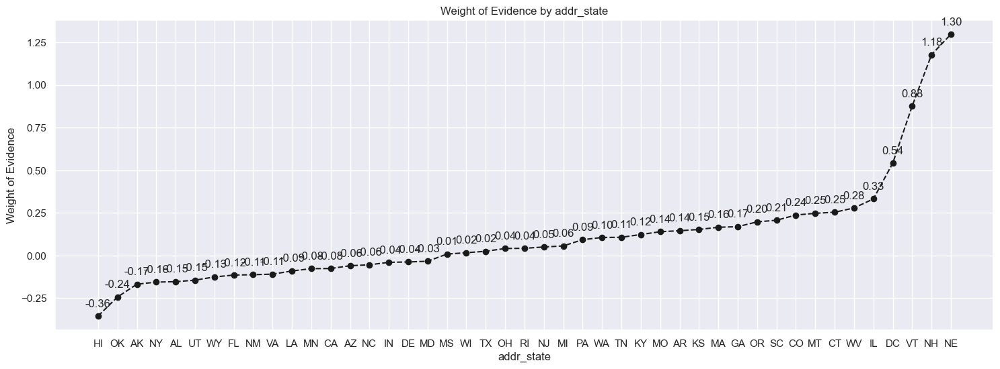

In [596]:
plot_by_woe(df_temp.iloc[2: -2, : ])

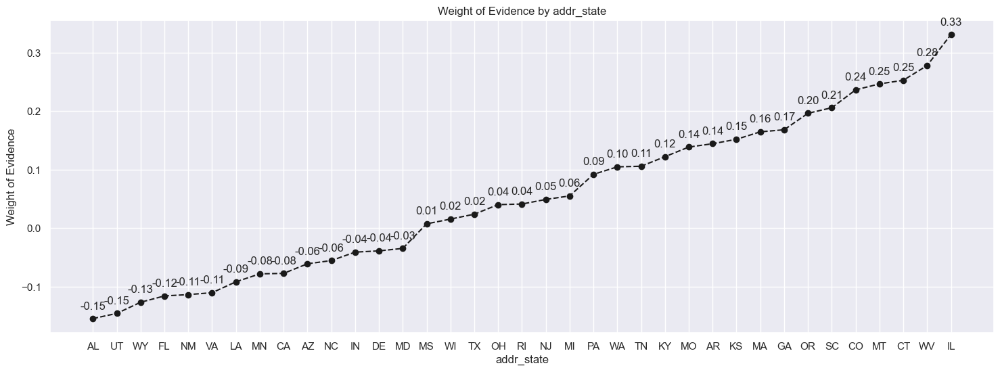

In [597]:
plot_by_woe(df_temp.iloc[6: -6, : ])

In [598]:
df_inputs_prepr.columns.values

array(['id', 'member_id', 'loan_amnt', 'funded_amnt', 'funded_amnt_inv',
       'term', 'int_rate', 'installment', 'grade', 'sub_grade',
       'emp_title', 'emp_length', 'home_ownership', 'annual_inc',
       'verification_status', 'issue_d', 'loan_status', 'pymnt_plan',
       'url', 'desc', 'purpose', 'title', 'zip_code', 'addr_state', 'dti',
       'delinq_2yrs', 'earliest_cr_line', 'inq_last_6mths',
       'mths_since_last_delinq', 'mths_since_last_record', 'open_acc',
       'pub_rec', 'revol_bal', 'revol_util', 'total_acc',
       'initial_list_status', 'out_prncp', 'out_prncp_inv', 'total_pymnt',
       'total_pymnt_inv', 'total_rec_prncp', 'total_rec_int',
       'total_rec_late_fee', 'recoveries', 'collection_recovery_fee',
       'last_pymnt_d', 'last_pymnt_amnt', 'next_pymnt_d',
       'last_credit_pull_d', 'collections_12_mths_ex_med',
       'mths_since_last_major_derog', 'policy_code', 'application_type',
       'annual_inc_joint', 'dti_joint', 'verification_status_joint

In [599]:
# We create the following categories:
# 'ND' 'NE' 'IA' NV' 'FL' 'HI' 'AL'
# 'NM' 'VA'
# 'NY'
# 'OK' 'TN' 'MO' 'LA' 'MD' 'NC'
# 'CA'
# 'UT' 'KY' 'AZ' 'NJ'
# 'AR' 'MI' 'PA' 'OH' 'MN'
# 'RI' 'MA' 'DE' 'SD' 'IN'
# 'GA' 'WA' 'OR'
# 'WI' 'MT'
# 'TX'
# 'IL' 'CT'
# 'KS' 'SC' 'CO' 'VT' 'AK' 'MS'
# 'WV' 'NH' 'WY' 'DC' 'ME' 'ID'

# 'IA_NV_HI_ID_AL_FL' will be the reference category.

df_inputs_prepr['addr_state:ND_NE_IA_NV_FL_HI_AL'] = sum([df_inputs_prepr['addr_state:ND'], df_inputs_prepr['addr_state:NE'],
                                              df_inputs_prepr['addr_state:IA'], df_inputs_prepr['addr_state:NV'],
                                              df_inputs_prepr['addr_state:FL'], df_inputs_prepr['addr_state:HI'],
                                                          df_inputs_prepr['addr_state:AL']])

df_inputs_prepr['addr_state:NM_VA'] = sum([df_inputs_prepr['addr_state:NM'], df_inputs_prepr['addr_state:VA']])

df_inputs_prepr['addr_state:OK_TN_MO_LA_MD_NC'] = sum([df_inputs_prepr['addr_state:OK'], df_inputs_prepr['addr_state:TN'],
                                              df_inputs_prepr['addr_state:MO'], df_inputs_prepr['addr_state:LA'],
                                              df_inputs_prepr['addr_state:MD'], df_inputs_prepr['addr_state:NC']])

df_inputs_prepr['addr_state:UT_KY_AZ_NJ'] = sum([df_inputs_prepr['addr_state:UT'], df_inputs_prepr['addr_state:KY'],
                                              df_inputs_prepr['addr_state:AZ'], df_inputs_prepr['addr_state:NJ']])

df_inputs_prepr['addr_state:AR_MI_PA_OH_MN'] = sum([df_inputs_prepr['addr_state:AR'], df_inputs_prepr['addr_state:MI'],
                                              df_inputs_prepr['addr_state:PA'], df_inputs_prepr['addr_state:OH'],
                                              df_inputs_prepr['addr_state:MN']])

df_inputs_prepr['addr_state:RI_MA_DE_SD_IN'] = sum([df_inputs_prepr['addr_state:RI'], df_inputs_prepr['addr_state:MA'],
                                              df_inputs_prepr['addr_state:DE'], df_inputs_prepr['addr_state:SD'],
                                              df_inputs_prepr['addr_state:IN']])

df_inputs_prepr['addr_state:GA_WA_OR'] = sum([df_inputs_prepr['addr_state:GA'], df_inputs_prepr['addr_state:WA'],
                                              df_inputs_prepr['addr_state:OR']])

df_inputs_prepr['addr_state:WI_MT'] = sum([df_inputs_prepr['addr_state:WI'], df_inputs_prepr['addr_state:MT']])

df_inputs_prepr['addr_state:IL_CT'] = sum([df_inputs_prepr['addr_state:IL'], df_inputs_prepr['addr_state:CT']])

df_inputs_prepr['addr_state:KS_SC_CO_VT_AK_MS'] = sum([df_inputs_prepr['addr_state:KS'], df_inputs_prepr['addr_state:SC'],
                                              df_inputs_prepr['addr_state:CO'], df_inputs_prepr['addr_state:VT'],
                                              df_inputs_prepr['addr_state:AK'], df_inputs_prepr['addr_state:MS']])

df_inputs_prepr['addr_state:WV_NH_WY_DC_ME_ID'] = sum([df_inputs_prepr['addr_state:WV'], df_inputs_prepr['addr_state:NH'],
                                              df_inputs_prepr['addr_state:WY'], df_inputs_prepr['addr_state:DC'],
                                              df_inputs_prepr['addr_state:ME'], df_inputs_prepr['addr_state:ID']])

In [600]:
# 'verification_status'
df_temp = woe_discrete(df_inputs_prepr, 'verification_status', df_targets_prepr)
df_temp

,verification_status,n_obs,prop_good,prop_n_obs,n_good,n_bad,prop_n_good,prop_n_bad,WoE,diff_prop_good,diff_WoE,IV
0,Verified,123016,0.976532,0.292134,120129.0,2887.0,0.290698,0.367724,-0.235047,NaN,NaN,0.046808
1,Source Verified,179565,0.981110,0.426425,176173.0,3392.0,0.426318,0.432047,-0.013348,0.004578,0.221698,0.046808
2,Not Verified,118513,0.986736,0.281441,116941.0,1572.0,0.282984,0.200229,0.345926,0.005626,0.359274,0.046808


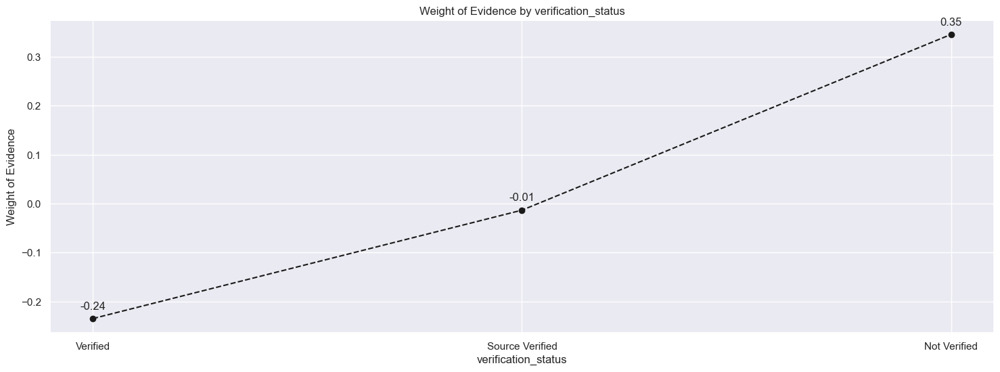

In [602]:
plot_by_woe(df_temp)

In [603]:
# 'purpose'
df_temp = woe_discrete(df_inputs_prepr, 'purpose', df_targets_prepr)
df_temp

,purpose,n_obs,prop_good,prop_n_obs,n_good,n_bad,prop_n_good,prop_n_bad,WoE,diff_prop_good,diff_WoE,IV
0,wedding,4,0.750000,0.000009,3.0,1.0,0.000007,0.000127,-2.864783,NaN,NaN,inf
1,renewable_energy,224,0.955357,0.000532,214.0,10.0,0.000518,0.001274,-0.900004,0.205357,1.964779,inf
2,small_business,3364,0.958680,0.007989,3225.0,139.0,0.007804,0.017705,-0.819181,0.003323,0.080823,inf
3,moving,2420,0.965289,0.005747,2336.0,84.0,0.005653,0.010699,-0.638016,0.006609,0.181164,inf
4,house,1438,0.967316,0.003415,1391.0,47.0,0.003366,0.005986,-0.575764,0.002026,0.062252,inf
5,medical,3938,0.970797,0.009352,3823.0,115.0,0.009251,0.014648,-0.459536,0.003482,0.116228,inf
6,major_purchase,7449,0.975970,0.017690,7270.0,179.0,0.017593,0.022800,-0.259269,0.005173,0.200267,inf
7,other,19204,0.976672,0.045605,18756.0,448.0,0.045387,0.057063,-0.228919,0.000702,0.030350,inf
8,vacation,2249,0.977768,0.005341,2199.0,50.0,0.005321,0.006369,-0.179660,0.001096,0.049259,inf
9,debt_consolidation,250020,0.979878,0.593739,244989.0,5031.0,0.592845,0.640810,-0.077800,0.002110,0.101860,inf


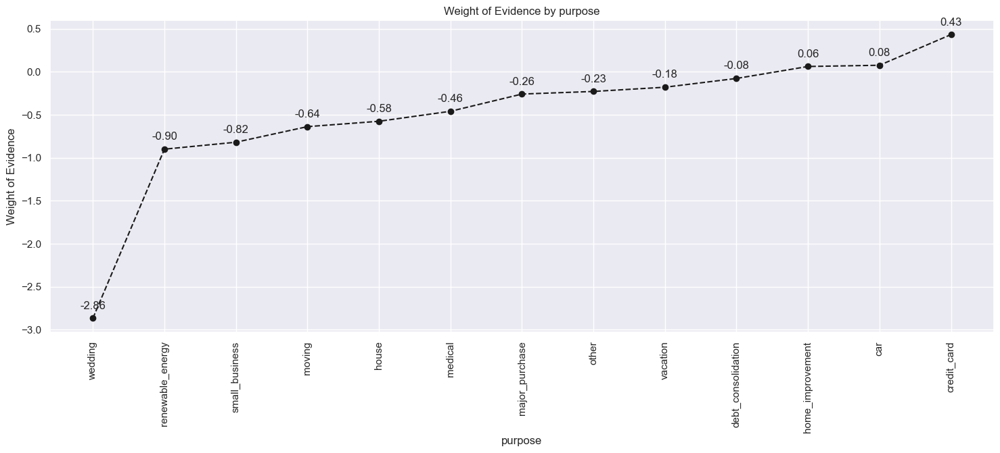

In [604]:
plot_by_woe(df_temp, 90)

In [605]:
# We combine 'educational', 'small_business', 'wedding', 'renewable_energy', 'moving', 'house' in one category: 'educ__sm_b__wedd__ren_en__mov__house'.
# We combine 'other', 'medical', 'vacation' in one category: 'oth__med__vacation'.
# We combine 'major_purchase', 'car', 'home_improvement' in one category: 'major_purch__car__home_impr'.
# We leave 'debt_consolidtion' in a separate category.
# We leave 'credit_card' in a separate category.
# 'educ__sm_b__wedd__ren_en__mov__house' will be the reference category.
df_inputs_prepr['purpose:educ__sm_b__wedd__ren_en__mov__house'] = sum([df_inputs_prepr['purpose:educational'], df_inputs_prepr['purpose:small_business'],
                                                                 df_inputs_prepr['purpose:wedding'], df_inputs_prepr['purpose:renewable_energy'],
                                                                 df_inputs_prepr['purpose:moving'], df_inputs_prepr['purpose:house']])
df_inputs_prepr['purpose:oth__med__vacation'] = sum([df_inputs_prepr['purpose:other'], df_inputs_prepr['purpose:medical'],
                                             df_inputs_prepr['purpose:vacation']])
df_inputs_prepr['purpose:major_purch__car__home_impr'] = sum([df_inputs_prepr['purpose:major_purchase'], df_inputs_prepr['purpose:car'],
                                                        df_inputs_prepr['purpose:home_improvement']])

In [606]:
# 'initial_list_status'
df_temp = woe_discrete(df_inputs_prepr, 'initial_list_status', df_targets_prepr)
df_temp

,initial_list_status,n_obs,prop_good,prop_n_obs,n_good,n_bad,prop_n_good,prop_n_bad,WoE,diff_prop_good,diff_WoE,IV
0,f,153843,0.972550,0.365341,149620.0,4223.0,0.362063,0.537893,-0.395842,NaN,NaN,0.126296
1,w,267251,0.986425,0.634659,263623.0,3628.0,0.637937,0.462107,0.322444,0.013875,0.718286,0.126296


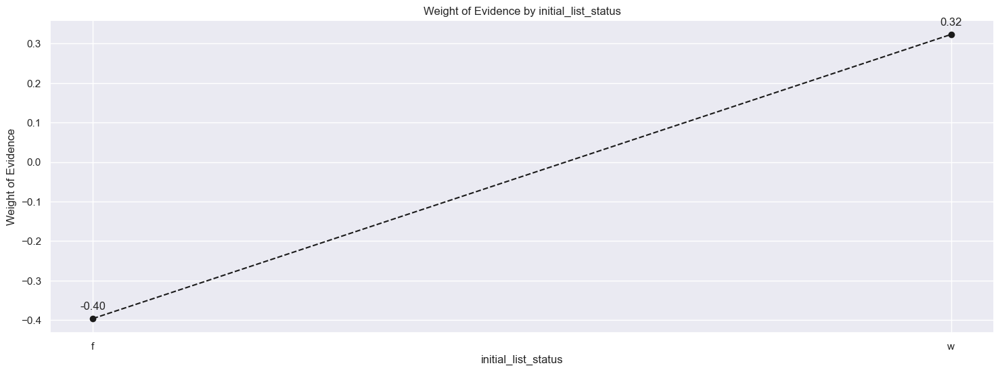

In [607]:
plot_by_woe(df_temp)

In [608]:
# WoE function for ordered discrete and continuous variables
def woe_ordered_continuous(df, OC_variabe_name, good_bad_variable_df):
    df = pd.concat([df[OC_variabe_name], good_bad_variable_df], axis = 1)
    df = pd.concat([df.groupby(df.columns.values[0], as_index = False)[df.columns.values[1]].count(),
                    df.groupby(df.columns.values[0], as_index = False)[df.columns.values[1]].mean()], axis = 1)
    df = df.iloc[:, [0, 1, 3]]
    df.columns = [df.columns.values[0], 'n_obs', 'prop_good']
    df['prop_n_obs'] = df['n_obs'] / df['n_obs'].sum()
    df['n_good'] = df['prop_good'] * df['n_obs']
    df['n_bad'] = (1 - df['prop_good']) * df['n_obs']
    df['prop_n_good'] = df['n_good'] / df['n_good'].sum()
    df['prop_n_bad'] = df['n_bad'] / df['n_bad'].sum()
    df['WoE'] = np.log(df['prop_n_good'] / df['prop_n_bad'])
    df['diff_prop_good'] = df['prop_good'].diff().abs()
    df['diff_WoE'] = df['WoE'].diff().abs()
    df['IV'] = (df['prop_n_good'] - df['prop_n_bad']) * df['WoE']
    df['IV'] = df['IV'].sum()
    return df
# Here we define a function similar to the one above, ...
# ... with one slight difference: we order the results by the values of a different column.
# The function takes 3 arguments: a dataframe, a string, and a dataframe. The function returns a dataframe as a result.

In [609]:
# term
df_inputs_prepr['term_int'].unique()
# There are only two unique values, 36 and 60.

array([60, 36], dtype=int64)

In [610]:
df_temp = woe_ordered_continuous(df_inputs_prepr, 'term_int', df_targets_prepr)
df_temp

,term_int,n_obs,prop_good,prop_n_obs,n_good,n_bad,prop_n_good,prop_n_bad,WoE,diff_prop_good,diff_WoE,IV
0,36,283172,0.983533,0.672467,278509.0,4663.0,0.673959,0.593937,0.126396,NaN,NaN,0.027678
1,60,137922,0.976885,0.327533,134734.0,3188.0,0.326041,0.406063,-0.219486,0.006647,0.345883,0.027678


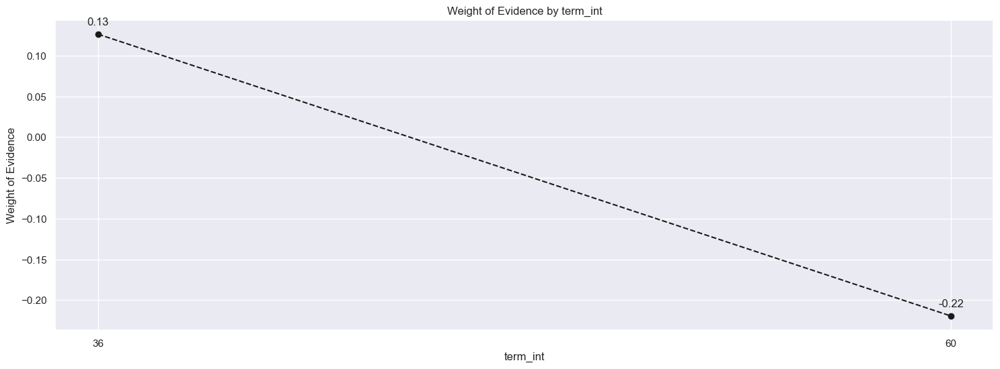

In [611]:
plot_by_woe(df_temp)

In [612]:
# Leave as is.
# '60' will be the reference category.
df_inputs_prepr['term:36'] = np.where((df_inputs_prepr['term_int'] == 36), 1, 0)
df_inputs_prepr['term:60'] = np.where((df_inputs_prepr['term_int'] == 60), 1, 0)

In [613]:
# emp_length_int
df_inputs_prepr['emp_length_int'].unique()
# Has only 11 levels: from 0 to 10. Hence, we turn it into a factor with 11 levels.

array([10.,  0.,  5.,  3.,  4.,  2.,  8.,  9.,  1.,  6.,  7.])

In [614]:
df_temp = woe_ordered_continuous(df_inputs_prepr, 'emp_length_int', df_targets_prepr)
df_temp

,emp_length_int,n_obs,prop_good,prop_n_obs,n_good,n_bad,prop_n_good,prop_n_bad,WoE,diff_prop_good,diff_WoE,IV
0,0.0,58157,0.977733,0.138109,56862.0,1295.0,0.137599,0.164947,-0.181278,NaN,NaN,0.019134
1,1.0,27473,0.977687,0.065242,26860.0,613.0,0.064998,0.078079,-0.183366,0.000046,0.002088,0.019134
2,2.0,37497,0.980932,0.089047,36782.0,715.0,0.089008,0.091071,-0.022914,0.003245,0.160453,0.019134
3,3.0,33430,0.980975,0.079388,32794.0,636.0,0.079358,0.081009,-0.020593,0.000043,0.002321,0.019134
4,4.0,24506,0.979678,0.058196,24008.0,498.0,0.058097,0.063431,-0.087853,0.001297,0.067260,0.019134
5,5.0,24930,0.980866,0.059203,24453.0,477.0,0.059173,0.060757,-0.026403,0.001188,0.061449,0.019134
6,6.0,16838,0.978976,0.039986,16484.0,354.0,0.039889,0.045090,-0.122546,0.001890,0.096143,0.019134
7,7.0,18414,0.979201,0.043729,18031.0,383.0,0.043633,0.048784,-0.111582,0.000224,0.010964,0.019134
8,8.0,21560,0.983905,0.051200,21213.0,347.0,0.051333,0.044198,0.149650,0.004705,0.261232,0.019134
9,9.0,16769,0.982289,0.039822,16472.0,297.0,0.039860,0.037830,0.052290,0.001617,0.097360,0.019134


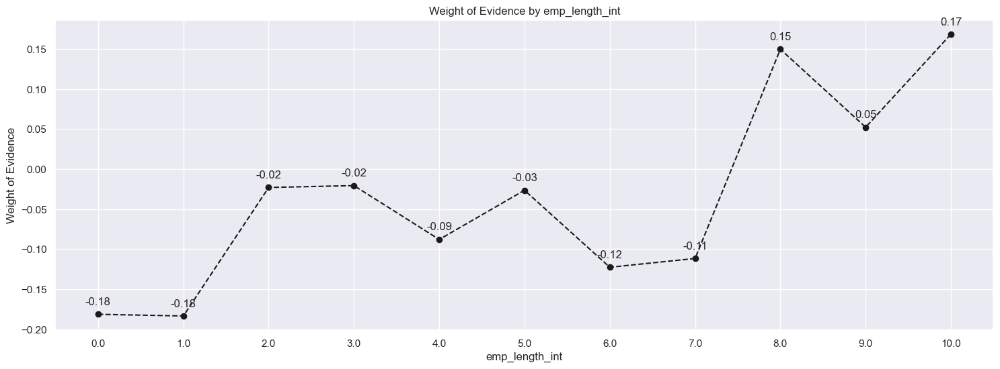

In [615]:
plot_by_woe(df_temp)

In [616]:
# We create the following categories: '0', '1', '2 - 4', '5 - 6', '7 - 9', '10'
# '0' will be the reference category
df_inputs_prepr['emp_length:0'] = np.where(df_inputs_prepr['emp_length_int'].isin([0]), 1, 0)
df_inputs_prepr['emp_length:1'] = np.where(df_inputs_prepr['emp_length_int'].isin([1]), 1, 0)
df_inputs_prepr['emp_length:2-4'] = np.where(df_inputs_prepr['emp_length_int'].isin(range(2, 5)), 1, 0)
df_inputs_prepr['emp_length:5-6'] = np.where(df_inputs_prepr['emp_length_int'].isin(range(5, 7)), 1, 0)
df_inputs_prepr['emp_length:7-9'] = np.where(df_inputs_prepr['emp_length_int'].isin(range(7, 10)), 1, 0)
df_inputs_prepr['emp_length:10'] = np.where(df_inputs_prepr['emp_length_int'].isin([10]), 1, 0)

In [617]:
df_inputs_prepr['mths_since_issue_d'].unique()

array([36, 37, 38, 39, 40, 41, 42, 43, 44, 45, 46, 47], dtype=int64)

In [618]:
df_inputs_prepr['mths_since_issue_d_factor'] = pd.cut(df_inputs_prepr['mths_since_issue_d'], 50)

In [619]:
df_inputs_prepr['mths_since_issue_d_factor']

0         (35.989, 36.22]
1         (35.989, 36.22]
2         (35.989, 36.22]
3         (35.989, 36.22]
4         (35.989, 36.22]
               ...       
421089      (46.78, 47.0]
421090      (46.78, 47.0]
421091      (46.78, 47.0]
421092      (46.78, 47.0]
421093      (46.78, 47.0]
Name: mths_since_issue_d_factor, Length: 421094, dtype: category
Categories (50, interval[float64, right]): [(35.989, 36.22] < (36.22, 36.44] < (36.44, 36.66] < (36.66, 36.88] ... (46.12, 46.34] < (46.34, 46.56] < (46.56, 46.78] < (46.78, 47.0]]

In [620]:
# mths_since_issue_d
df_temp = woe_ordered_continuous(df_inputs_prepr, 'mths_since_issue_d_factor', df_targets_prepr)
df_temp

C:\Users\dcgzb\AppData\Local\Temp\ipykernel_10772\1881610760.py:4: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  df = pd.concat([df.groupby(df.columns.values[0], as_index = False)[df.columns.values[1]].count(),
C:\Users\dcgzb\AppData\Local\Temp\ipykernel_10772\1881610760.py:5: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  df.groupby(df.columns.values[0], as_index = False)[df.columns.values[1]].mean()], axis = 1)


,mths_since_issue_d_factor,n_obs,prop_good,prop_n_obs,n_good,n_bad,prop_n_good,prop_n_bad,WoE,diff_prop_good,diff_WoE,IV
0,"(35.989, 36.22]",44342,1.000000,0.105302,44342.0,0.0,0.107302,0.000000,inf,NaN,NaN,inf
1,"(36.22, 36.44]",0,NaN,0.000000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,inf
2,"(36.44, 36.66]",0,NaN,0.000000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,inf
3,"(36.66, 36.88]",0,NaN,0.000000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,inf
4,"(36.88, 37.1]",37530,0.998082,0.089125,37458.0,72.0,0.090644,0.009171,2.290915,NaN,NaN,inf
5,"(37.1, 37.32]",0,NaN,0.000000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,inf
6,"(37.32, 37.54]",0,NaN,0.000000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,inf
7,"(37.54, 37.76]",0,NaN,0.000000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,inf
8,"(37.76, 37.98]",0,NaN,0.000000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,inf
9,"(37.98, 38.2]",48631,0.997327,0.115487,48501.0,130.0,0.117367,0.016558,1.958410,NaN,NaN,inf


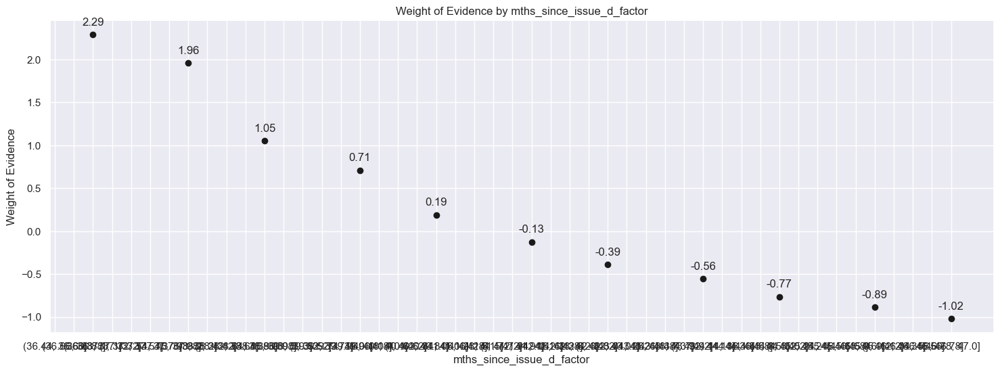

In [621]:
plot_by_woe(df_temp)

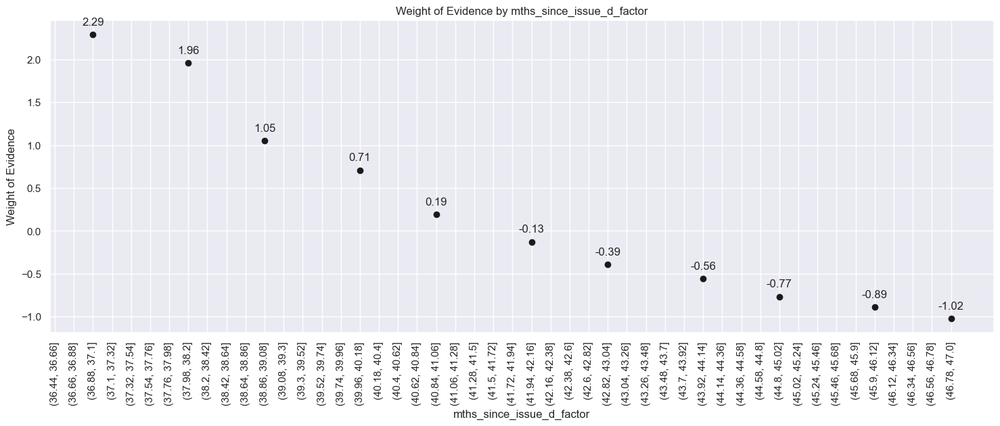

In [622]:
plot_by_woe(df_temp, 90)

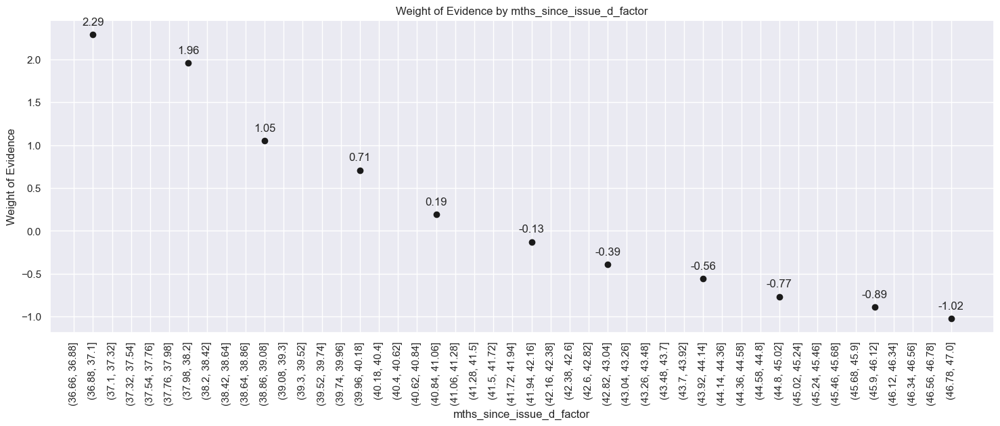

In [623]:
plot_by_woe(df_temp.iloc[3: , : ], 90)

In [624]:
# We create the following categories:
# < 38, 38 - 39, 40 - 41, 42 - 48, 49 - 52, 53 - 64, 65 - 84, > 84.
df_inputs_prepr['mths_since_issue_d:<38'] = np.where(df_inputs_prepr['mths_since_issue_d'].isin(range(38)), 1, 0)
df_inputs_prepr['mths_since_issue_d:38-39'] = np.where(df_inputs_prepr['mths_since_issue_d'].isin(range(38, 40)), 1, 0)
df_inputs_prepr['mths_since_issue_d:40-41'] = np.where(df_inputs_prepr['mths_since_issue_d'].isin(range(40, 42)), 1, 0)
df_inputs_prepr['mths_since_issue_d:42-48'] = np.where(df_inputs_prepr['mths_since_issue_d'].isin(range(42, 49)), 1, 0)
df_inputs_prepr['mths_since_issue_d:49-52'] = np.where(df_inputs_prepr['mths_since_issue_d'].isin(range(49, 53)), 1, 0)
df_inputs_prepr['mths_since_issue_d:53-64'] = np.where(df_inputs_prepr['mths_since_issue_d'].isin(range(53, 65)), 1, 0)
df_inputs_prepr['mths_since_issue_d:65-84'] = np.where(df_inputs_prepr['mths_since_issue_d'].isin(range(65, 85)), 1, 0)
df_inputs_prepr['mths_since_issue_d:>84'] = np.where(df_inputs_prepr['mths_since_issue_d'].isin(range(85, int(df_inputs_prepr['mths_since_issue_d'].max()))), 1, 0)

In [625]:
# int_rate
df_inputs_prepr['int_rate_factor'] = pd.cut(df_inputs_prepr['int_rate'], 50)

In [626]:
df_temp = woe_ordered_continuous(df_inputs_prepr, 'int_rate_factor', df_targets_prepr)
df_temp

C:\Users\dcgzb\AppData\Local\Temp\ipykernel_10772\1881610760.py:4: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  df = pd.concat([df.groupby(df.columns.values[0], as_index = False)[df.columns.values[1]].count(),
C:\Users\dcgzb\AppData\Local\Temp\ipykernel_10772\1881610760.py:5: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  df.groupby(df.columns.values[0], as_index = False)[df.columns.values[1]].mean()], axis = 1)


,int_rate_factor,n_obs,prop_good,prop_n_obs,n_good,n_bad,prop_n_good,prop_n_bad,WoE,diff_prop_good,diff_WoE,IV
0,"(5.296, 5.793]",9651,0.999689,0.022919,9648.0,3.0,0.023347,0.000382,4.112499,NaN,NaN,inf
1,"(5.793, 6.267]",10214,0.997259,0.024256,10186.0,28.0,0.024649,0.003566,1.933170,0.002430,2.179329,inf
2,"(6.267, 6.74]",6530,0.994793,0.015507,6496.0,34.0,0.015720,0.004331,1.289186,0.002465,0.643984,inf
3,"(6.74, 7.214]",12488,0.995275,0.029656,12429.0,59.0,0.030077,0.007515,1.386855,0.000482,0.097669,inf
4,"(7.214, 7.687]",11416,0.997985,0.027110,11393.0,23.0,0.027570,0.002930,2.241865,0.002710,0.855010,inf
5,"(7.687, 8.16]",20636,0.995687,0.049006,20547.0,89.0,0.049721,0.011336,1.478439,0.002298,0.763426,inf
6,"(8.16, 8.634]",22498,0.994133,0.053428,22366.0,132.0,0.054123,0.016813,1.169100,0.001554,0.309339,inf
7,"(8.634, 9.107]",2020,0.979703,0.004797,1979.0,41.0,0.004789,0.005222,-0.086620,0.014430,1.255720,inf
8,"(9.107, 9.581]",22171,0.992783,0.052651,22011.0,160.0,0.053264,0.020380,0.960729,0.013080,1.047349,inf
9,"(9.581, 10.054]",22364,0.993829,0.053109,22226.0,138.0,0.053784,0.017577,1.118369,0.001046,0.157641,inf


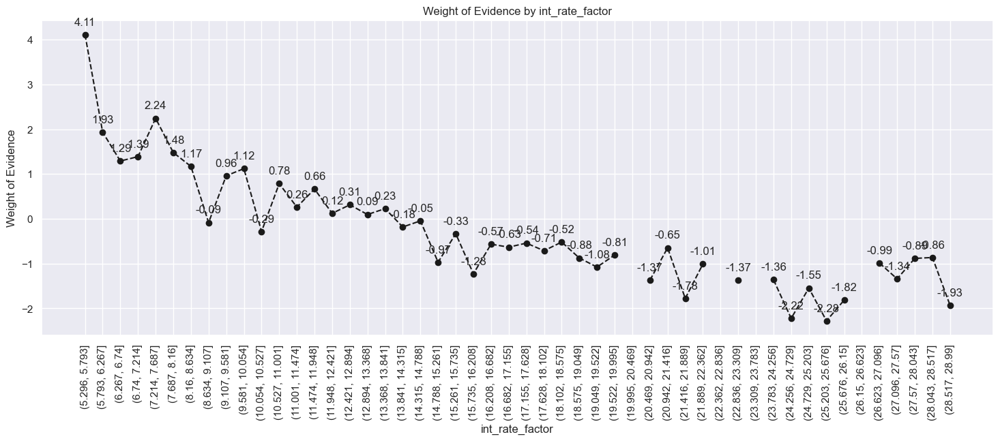

In [627]:
plot_by_woe(df_temp, 90)

In [628]:
df_inputs_prepr['int_rate:<9.548'] = np.where((df_inputs_prepr['int_rate'] <= 9.548), 1, 0)
df_inputs_prepr['int_rate:9.548-12.025'] = np.where((df_inputs_prepr['int_rate'] > 9.548) & (df_inputs_prepr['int_rate'] <= 12.025), 1, 0)
df_inputs_prepr['int_rate:12.025-15.74'] = np.where((df_inputs_prepr['int_rate'] > 12.025) & (df_inputs_prepr['int_rate'] <= 15.74), 1, 0)
df_inputs_prepr['int_rate:15.74-20.281'] = np.where((df_inputs_prepr['int_rate'] > 15.74) & (df_inputs_prepr['int_rate'] <= 20.281), 1, 0)
df_inputs_prepr['int_rate:>20.281'] = np.where((df_inputs_prepr['int_rate'] > 20.281), 1, 0)

In [629]:
# mths_since_earliest_cr_line
df_inputs_prepr['mths_since_earliest_cr_line_factor'] = pd.cut(df_inputs_prepr['mths_since_earliest_cr_line'], 50)
df_temp = woe_ordered_continuous(df_inputs_prepr, 'mths_since_earliest_cr_line_factor', df_targets_prepr)
df_temp

C:\Users\dcgzb\AppData\Local\Temp\ipykernel_10772\1881610760.py:4: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  df = pd.concat([df.groupby(df.columns.values[0], as_index = False)[df.columns.values[1]].count(),
C:\Users\dcgzb\AppData\Local\Temp\ipykernel_10772\1881610760.py:5: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  df.groupby(df.columns.values[0], as_index = False)[df.columns.values[1]].mean()], axis = 1)


,mths_since_earliest_cr_line_factor,n_obs,prop_good,prop_n_obs,n_good,n_bad,prop_n_good,prop_n_bad,WoE,diff_prop_good,diff_WoE,IV
0,"(72.174, 89.52]",4727,0.977787,0.011226,4622.0,105.0,0.011185,0.013374,-0.178772,NaN,NaN,inf
1,"(89.52, 106.04]",7570,0.973052,0.017977,7366.0,204.0,0.017825,0.025984,-0.376885,0.004736,0.198112,inf
2,"(106.04, 122.56]",7983,0.971439,0.018958,7755.0,228.0,0.018766,0.029041,-0.436647,0.001612,0.059763,inf
3,"(122.56, 139.08]",16247,0.976980,0.038583,15873.0,374.0,0.038411,0.047637,-0.215276,0.005541,0.221372,inf
4,"(139.08, 155.6]",20569,0.975011,0.048847,20055.0,514.0,0.048531,0.065469,-0.299384,0.001969,0.084109,inf
5,"(155.6, 172.12]",33434,0.978585,0.079398,32718.0,716.0,0.079174,0.091199,-0.141394,0.003574,0.157990,inf
6,"(172.12, 188.64]",35962,0.979423,0.085401,35222.0,740.0,0.085233,0.094256,-0.100619,0.000838,0.040775,inf
7,"(188.64, 205.16]",39155,0.979339,0.092984,38346.0,809.0,0.092793,0.103044,-0.104788,0.000084,0.004169,inf
8,"(205.16, 221.68]",39248,0.981579,0.093205,38525.0,723.0,0.093226,0.092090,0.012259,0.002240,0.117047,inf
9,"(221.68, 238.2]",34783,0.982261,0.082602,34166.0,617.0,0.082678,0.078589,0.050722,0.000683,0.038464,inf


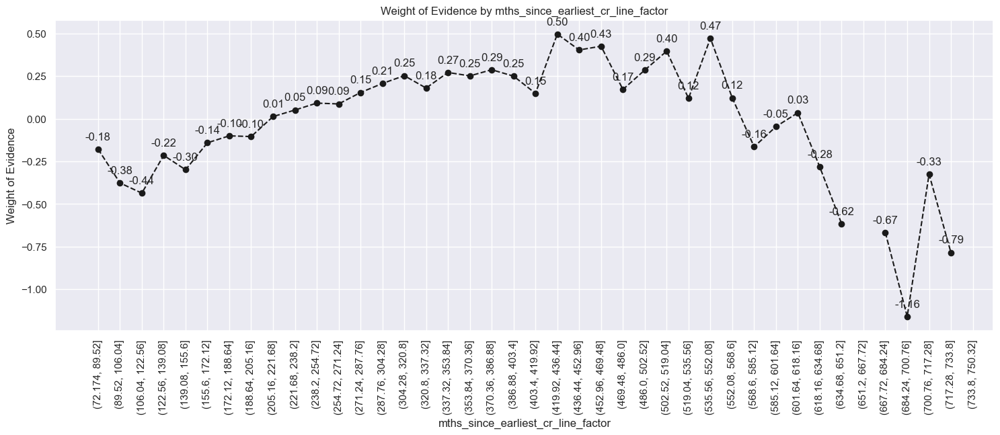

In [630]:
plot_by_woe(df_temp, 90)

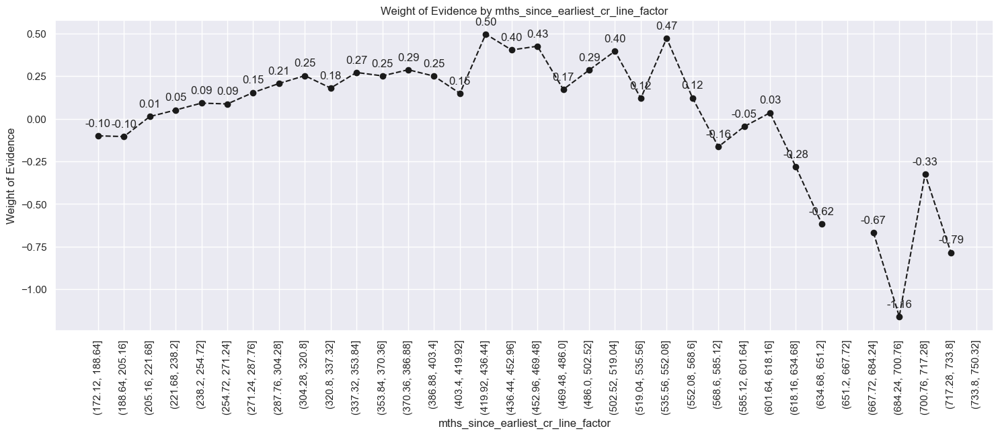

In [631]:
plot_by_woe(df_temp.iloc[6: , : ], 90)

In [632]:
# We create the following categories:
# < 140, # 141 - 164, # 165 - 247, # 248 - 270, # 271 - 352, # > 352
df_inputs_prepr['mths_since_earliest_cr_line:<140'] = np.where(df_inputs_prepr['mths_since_earliest_cr_line'].isin(range(140)), 1, 0)
df_inputs_prepr['mths_since_earliest_cr_line:141-164'] = np.where(df_inputs_prepr['mths_since_earliest_cr_line'].isin(range(140, 165)), 1, 0)
df_inputs_prepr['mths_since_earliest_cr_line:165-247'] = np.where(df_inputs_prepr['mths_since_earliest_cr_line'].isin(range(165, 248)), 1, 0)
df_inputs_prepr['mths_since_earliest_cr_line:248-270'] = np.where(df_inputs_prepr['mths_since_earliest_cr_line'].isin(range(248, 271)), 1, 0)
df_inputs_prepr['mths_since_earliest_cr_line:271-352'] = np.where(df_inputs_prepr['mths_since_earliest_cr_line'].isin(range(271, 353)), 1, 0)
df_inputs_prepr['mths_since_earliest_cr_line:>352'] = np.where(df_inputs_prepr['mths_since_earliest_cr_line'].isin(range(353, int(df_inputs_prepr['mths_since_earliest_cr_line'].max()))), 1, 0)

In [633]:
# delinq_2yrs
df_temp = woe_ordered_continuous(df_inputs_prepr, 'delinq_2yrs', df_targets_prepr)
df_temp

,delinq_2yrs,n_obs,prop_good,prop_n_obs,n_good,n_bad,prop_n_good,prop_n_bad,WoE,diff_prop_good,diff_WoE,IV
0,0.0,334007,0.981812,0.793189,327932.0,6075.0,0.793557,0.773787,0.025229,NaN,NaN,inf
1,1.0,57000,0.980246,0.135362,55874.0,1126.0,0.135209,0.143421,-0.058967,0.001566,0.084197,inf
2,2.0,17241,0.979120,0.040943,16881.0,360.0,0.040850,0.045854,-0.115555,0.001126,0.056588,inf
3,3.0,6293,0.976800,0.014944,6147.0,146.0,0.014875,0.018596,-0.223282,0.002320,0.107727,inf
4,4.0,2949,0.976263,0.007003,2879.0,70.0,0.006967,0.008916,-0.246692,0.000536,0.023410,inf
5,5.0,1475,0.978305,0.003503,1443.0,32.0,0.003492,0.004076,-0.154651,0.002042,0.092041,inf
6,6.0,842,0.980998,0.002000,826.0,16.0,0.001999,0.002038,-0.019389,0.002693,0.135262,inf
7,7.0,438,0.984018,0.001040,431.0,7.0,0.001043,0.000892,0.156803,0.003021,0.176192,inf
8,8.0,284,0.982394,0.000674,279.0,5.0,0.000675,0.000637,0.058379,0.001624,0.098424,inf
9,9.0,173,0.976879,0.000411,169.0,4.0,0.000409,0.000509,-0.219791,0.005516,0.278170,inf


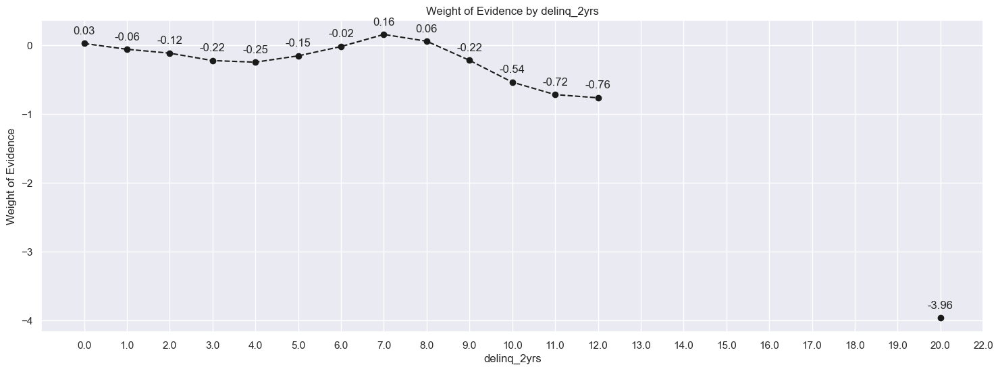

In [634]:
plot_by_woe(df_temp)

In [635]:
# Categories: 0, 1-3, >=4
df_inputs_prepr['delinq_2yrs:0'] = np.where((df_inputs_prepr['delinq_2yrs'] == 0), 1, 0)
df_inputs_prepr['delinq_2yrs:1-3'] = np.where((df_inputs_prepr['delinq_2yrs'] >= 1) & (df_inputs_prepr['delinq_2yrs'] <= 3), 1, 0)
df_inputs_prepr['delinq_2yrs:>=4'] = np.where((df_inputs_prepr['delinq_2yrs'] >= 9), 1, 0)

In [636]:
# inq_last_6mths
df_temp = woe_ordered_continuous(df_inputs_prepr, 'inq_last_6mths', df_targets_prepr)
df_temp

,inq_last_6mths,n_obs,prop_good,prop_n_obs,n_good,n_bad,prop_n_good,prop_n_bad,WoE,diff_prop_good,diff_WoE,IV
0,0.0,256407,0.984813,0.608907,252513.0,3894.0,0.611052,0.495988,0.208631,NaN,NaN,0.06837
1,1.0,111346,0.978571,0.264421,108960.0,2386.0,0.263671,0.303910,-0.142032,0.006242,0.350663,0.06837
2,2.0,36292,0.973438,0.086185,35328.0,964.0,0.085490,0.122787,-0.362055,0.005134,0.220023,0.06837
3,3.0,12272,0.964635,0.029143,11838.0,434.0,0.028647,0.055280,-0.657369,0.008803,0.295314,0.06837
4,4.0,3517,0.966164,0.008352,3398.0,119.0,0.008223,0.015157,-0.611576,0.001529,0.045793,0.06837
5,5.0,1217,0.957272,0.002890,1165.0,52.0,0.002819,0.006623,-0.854162,0.008892,0.242586,0.06837
6,6.0,43,0.953488,0.000102,41.0,2.0,0.000099,0.000255,-0.942970,0.003784,0.088808,0.06837


In [ ]:
plot_by_woe(df_temp)

In [637]:
# Categories: 0, 1 - 2, 3 - 6, > 6
df_inputs_prepr['inq_last_6mths:0'] = np.where((df_inputs_prepr['inq_last_6mths'] == 0), 1, 0)
df_inputs_prepr['inq_last_6mths:1-2'] = np.where((df_inputs_prepr['inq_last_6mths'] >= 1) & (df_inputs_prepr['inq_last_6mths'] <= 2), 1, 0)
df_inputs_prepr['inq_last_6mths:3-6'] = np.where((df_inputs_prepr['inq_last_6mths'] >= 3) & (df_inputs_prepr['inq_last_6mths'] <= 6), 1, 0)
df_inputs_prepr['inq_last_6mths:>6'] = np.where((df_inputs_prepr['inq_last_6mths'] > 6), 1, 0)

In [638]:
# open_acc
df_temp = woe_ordered_continuous(df_inputs_prepr, 'open_acc', df_targets_prepr)
df_temp

,open_acc,n_obs,prop_good,prop_n_obs,n_good,n_bad,prop_n_good,prop_n_bad,WoE,diff_prop_good,diff_WoE,IV
0,1.0,90,0.988889,0.000214,89.0,1.0,0.000215,0.000127,0.525241,NaN,NaN,inf
1,2.0,986,0.972617,0.002342,959.0,27.0,0.002321,0.003439,-0.393341,0.016272,0.918582,inf
2,3.0,4119,0.984462,0.009782,4055.0,64.0,0.009813,0.008152,0.185428,0.011846,0.578769,inf
3,4.0,10779,0.978941,0.025598,10552.0,227.0,0.025535,0.028914,-0.124274,0.005522,0.309702,inf
4,5.0,18222,0.980738,0.043273,17871.0,351.0,0.043246,0.044708,-0.033247,0.001797,0.091028,inf
5,6.0,25117,0.980491,0.059647,24627.0,490.0,0.059594,0.062412,-0.046202,0.000246,0.012955,inf
6,7.0,30294,0.981283,0.071941,29727.0,567.0,0.071936,0.072220,-0.003943,0.000792,0.042258,inf
7,8.0,34685,0.980885,0.082369,34022.0,663.0,0.082329,0.084448,-0.025407,0.000398,0.021464,inf
8,9.0,36266,0.981801,0.086123,35606.0,660.0,0.086162,0.084066,0.024635,0.000916,0.050042,inf
9,10.0,35809,0.980647,0.085038,35116.0,693.0,0.084977,0.088269,-0.038013,0.001154,0.062647,inf


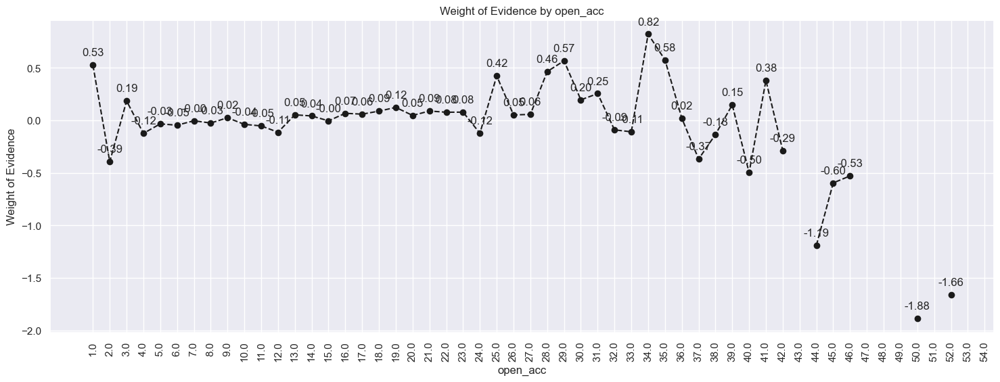

In [639]:
plot_by_woe(df_temp, 90)

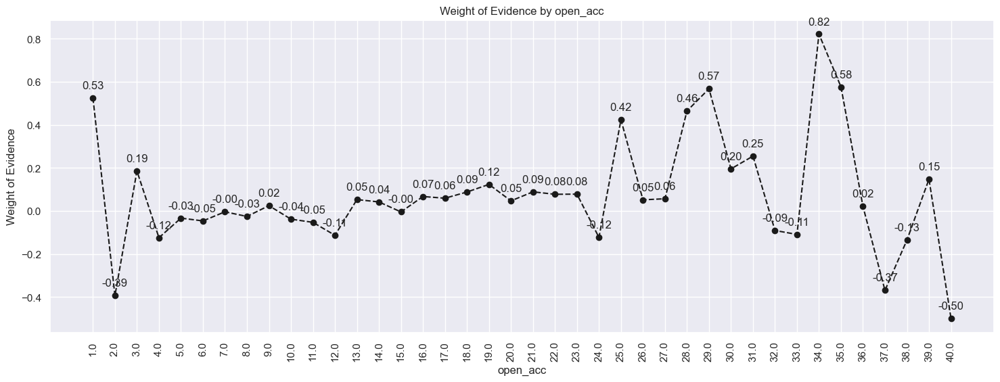

In [640]:
plot_by_woe(df_temp.iloc[ : 40, :], 90)

In [641]:
# Categories: '0', '1-3', '4-12', '13-17', '18-22', '23-25', '26-30', '>30'
df_inputs_prepr['open_acc:0'] = np.where((df_inputs_prepr['open_acc'] == 0), 1, 0)
df_inputs_prepr['open_acc:1-3'] = np.where((df_inputs_prepr['open_acc'] >= 1) & (df_inputs_prepr['open_acc'] <= 3), 1, 0)
df_inputs_prepr['open_acc:4-12'] = np.where((df_inputs_prepr['open_acc'] >= 4) & (df_inputs_prepr['open_acc'] <= 12), 1, 0)
df_inputs_prepr['open_acc:13-17'] = np.where((df_inputs_prepr['open_acc'] >= 13) & (df_inputs_prepr['open_acc'] <= 17), 1, 0)
df_inputs_prepr['open_acc:18-22'] = np.where((df_inputs_prepr['open_acc'] >= 18) & (df_inputs_prepr['open_acc'] <= 22), 1, 0)
df_inputs_prepr['open_acc:23-25'] = np.where((df_inputs_prepr['open_acc'] >= 23) & (df_inputs_prepr['open_acc'] <= 25), 1, 0)
df_inputs_prepr['open_acc:26-30'] = np.where((df_inputs_prepr['open_acc'] >= 26) & (df_inputs_prepr['open_acc'] <= 30), 1, 0)
df_inputs_prepr['open_acc:>=31'] = np.where((df_inputs_prepr['open_acc'] >= 31), 1, 0)

In [642]:
# pub_rec
df_temp = woe_ordered_continuous(df_inputs_prepr, 'pub_rec', df_targets_prepr)
df_temp

,pub_rec,n_obs,prop_good,prop_n_obs,n_good,n_bad,prop_n_good,prop_n_bad,WoE,diff_prop_good,diff_WoE,IV
0,0.0,346679,0.981594,0.823282,340298.0,6381.0,0.823482,0.812763,0.013102,NaN,NaN,inf
1,1.0,60215,0.979972,0.142997,59009.0,1206.0,0.142795,0.153611,-0.073014,0.001622,0.086116,inf
2,2.0,9230,0.982124,0.021919,9065.0,165.0,0.021936,0.021016,0.042836,0.002152,0.115850,inf
3,3.0,2876,0.979833,0.006830,2818.0,58.0,0.006819,0.007388,-0.080055,0.002290,0.122891,inf
4,4.0,1044,0.977011,0.002479,1020.0,24.0,0.002468,0.003057,-0.213891,0.002822,0.133836,inf
5,5.0,481,0.979210,0.001142,471.0,10.0,0.001140,0.001274,-0.111122,0.002198,0.102769,inf
6,6.0,249,0.983936,0.000591,245.0,4.0,0.000593,0.000509,0.151569,0.004726,0.262691,inf
7,7.0,108,1.000000,0.000256,108.0,0.0,0.000261,0.000000,inf,0.016064,inf,inf
8,8.0,84,1.000000,0.000199,84.0,0.0,0.000203,0.000000,inf,0.000000,NaN,inf
9,9.0,34,0.970588,0.000081,33.0,1.0,0.000080,0.000127,-0.466887,0.029412,inf,inf


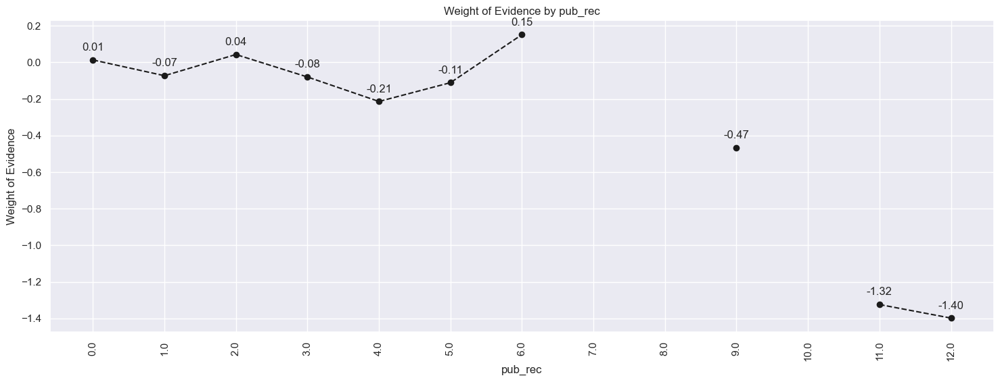

In [643]:
plot_by_woe(df_temp, 90)

In [644]:
# Categories '0-2', '3-4', '>=5'
df_inputs_prepr['pub_rec:0-2'] = np.where((df_inputs_prepr['pub_rec'] >= 0) & (df_inputs_prepr['pub_rec'] <= 2), 1, 0)
df_inputs_prepr['pub_rec:3-4'] = np.where((df_inputs_prepr['pub_rec'] >= 3) & (df_inputs_prepr['pub_rec'] <= 4), 1, 0)
df_inputs_prepr['pub_rec:>=5'] = np.where((df_inputs_prepr['pub_rec'] >= 5), 1, 0)

In [645]:
# total_acc
df_inputs_prepr['total_acc_factor'] = pd.cut(df_inputs_prepr['total_acc'], 50)
df_temp = woe_ordered_continuous(df_inputs_prepr, 'total_acc_factor', df_targets_prepr)
df_temp

C:\Users\dcgzb\AppData\Local\Temp\ipykernel_10772\1881610760.py:4: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  df = pd.concat([df.groupby(df.columns.values[0], as_index = False)[df.columns.values[1]].count(),
C:\Users\dcgzb\AppData\Local\Temp\ipykernel_10772\1881610760.py:5: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  df.groupby(df.columns.values[0], as_index = False)[df.columns.values[1]].mean()], axis = 1)


,total_acc_factor,n_obs,prop_good,prop_n_obs,n_good,n_bad,prop_n_good,prop_n_bad,WoE,diff_prop_good,diff_WoE,IV
0,"(3.835, 7.3]",11333,0.976970,0.026913,11072.0,261.0,0.026793,0.033244,-0.215741,NaN,NaN,inf
1,"(7.3, 10.6]",21005,0.979767,0.049882,20580.0,425.0,0.049801,0.054133,-0.083409,0.002797,0.132332,inf
2,"(10.6, 13.9]",31446,0.979457,0.074677,30800.0,646.0,0.074532,0.082283,-0.098924,0.000310,0.015515,inf
3,"(13.9, 17.2]",53180,0.980557,0.126290,52146.0,1034.0,0.126187,0.131703,-0.042782,0.001100,0.056142,inf
4,"(17.2, 20.5]",44528,0.981742,0.105744,43715.0,813.0,0.105785,0.103554,0.021321,0.001185,0.064103,inf
5,"(20.5, 23.8]",44749,0.981676,0.106268,43929.0,820.0,0.106303,0.104445,0.017631,0.000066,0.003690,inf
6,"(23.8, 27.1]",55586,0.981182,0.132004,54540.0,1046.0,0.131980,0.133231,-0.009434,0.000493,0.027065,inf
7,"(27.1, 30.4]",35493,0.982363,0.084288,34867.0,626.0,0.084374,0.079735,0.056551,0.001180,0.065985,inf
8,"(30.4, 33.7]",29540,0.982668,0.070151,29028.0,512.0,0.070244,0.065215,0.074297,0.000305,0.017746,inf
9,"(33.7, 37.0]",30463,0.982405,0.072343,29927.0,536.0,0.072420,0.068272,0.058987,0.000263,0.015309,inf


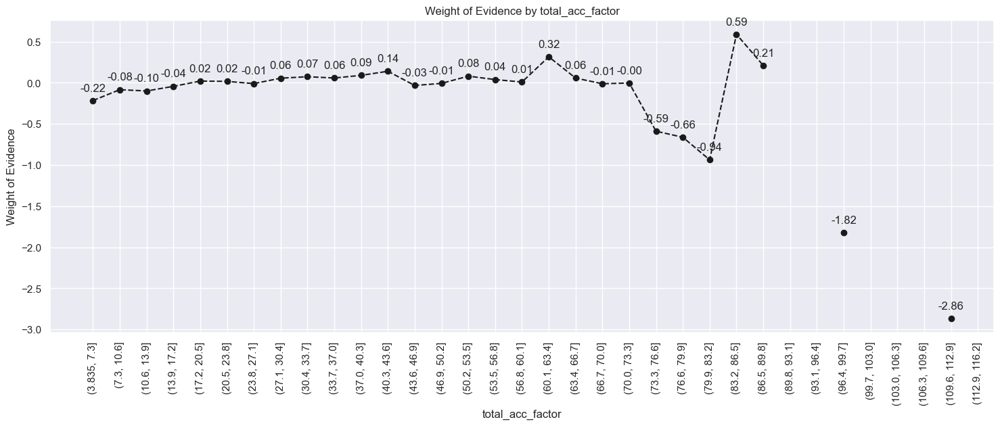

In [646]:
plot_by_woe(df_temp, 90)

In [647]:
# Categories: '<=27', '28-51', '>51'
df_inputs_prepr['total_acc:<=27'] = np.where((df_inputs_prepr['total_acc'] <= 27), 1, 0)
df_inputs_prepr['total_acc:28-51'] = np.where((df_inputs_prepr['total_acc'] >= 28) & (df_inputs_prepr['total_acc'] <= 51), 1, 0)
df_inputs_prepr['total_acc:>=52'] = np.where((df_inputs_prepr['total_acc'] >= 52), 1, 0)

In [648]:
# acc_now_delinq
df_temp = woe_ordered_continuous(df_inputs_prepr, 'acc_now_delinq', df_targets_prepr)
df_temp

,acc_now_delinq,n_obs,prop_good,prop_n_obs,n_good,n_bad,prop_n_good,prop_n_bad,WoE,diff_prop_good,diff_WoE,IV
0,0.0,418712,0.981424,0.994343,410934.0,7778.0,0.994412,0.990702,0.003738,NaN,NaN,inf
1,1.0,2243,0.971021,0.005327,2178.0,65.0,0.005271,0.008279,-0.451620,0.010403,0.455358,inf
2,2.0,116,0.939655,0.000275,109.0,7.0,0.000264,0.000892,-1.217957,0.031366,0.766337,inf
3,3.0,17,1.000000,0.000040,17.0,0.0,0.000041,0.000000,inf,0.060345,inf,inf
4,4.0,3,0.666667,0.000007,2.0,1.0,0.000005,0.000127,-3.270248,0.333333,inf,inf
5,5.0,1,1.000000,0.000002,1.0,0.0,0.000002,0.000000,inf,0.333333,inf,inf
6,6.0,1,1.000000,0.000002,1.0,0.0,0.000002,0.000000,inf,0.000000,NaN,inf
7,14.0,1,1.000000,0.000002,1.0,0.0,0.000002,0.000000,inf,0.000000,NaN,inf


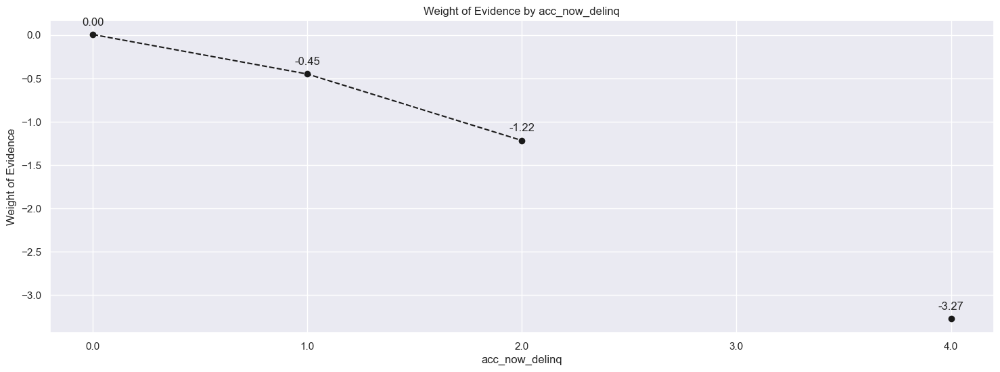

In [649]:
plot_by_woe(df_temp)

In [650]:
# Categories: '0', '>=1'
df_inputs_prepr['acc_now_delinq:0'] = np.where((df_inputs_prepr['acc_now_delinq'] == 0), 1, 0)
df_inputs_prepr['acc_now_delinq:>=1'] = np.where((df_inputs_prepr['acc_now_delinq'] >= 1), 1, 0)

In [651]:
# total_rev_hi_lim
df_inputs_prepr['total_rev_hi_lim_factor'] = pd.cut(df_inputs_prepr['total_rev_hi_lim'], 2000)
df_temp = woe_ordered_continuous(df_inputs_prepr, 'total_rev_hi_lim_factor', df_targets_prepr)
df_temp

C:\Users\dcgzb\AppData\Local\Temp\ipykernel_10772\1881610760.py:4: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  df = pd.concat([df.groupby(df.columns.values[0], as_index = False)[df.columns.values[1]].count(),
C:\Users\dcgzb\AppData\Local\Temp\ipykernel_10772\1881610760.py:5: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  df.groupby(df.columns.values[0], as_index = False)[df.columns.values[1]].mean()], axis = 1)
F:\anaconda3\envs\Udemycreditriskmodel\lib\site-packages\pandas\core\arraylike.py:396: RuntimeWarning: divide by zero encountered in log
  result = getattr(ufunc, method)(*inputs, **kwargs)


,total_rev_hi_lim_factor,n_obs,prop_good,prop_n_obs,n_good,n_bad,prop_n_good,prop_n_bad,WoE,diff_prop_good,diff_WoE,IV
0,"(-9999.999, 5000.0]",12981,0.971266,0.030827,12608.0,373.0,0.030510,0.047510,-0.442886,NaN,NaN,inf
1,"(5000.0, 9999.999]",42858,0.974801,0.101778,41778.0,1080.0,0.101098,0.137562,-0.307986,0.003535,0.134900,inf
2,"(9999.999, 14999.998]",56173,0.977658,0.133398,54918.0,1255.0,0.132895,0.159852,-0.184689,0.002858,0.123297,inf
3,"(14999.998, 19999.998]",54873,0.979498,0.130311,53748.0,1125.0,0.130064,0.143294,-0.096871,0.001840,0.087818,inf
4,"(19999.998, 24999.997]",46739,0.981942,0.110994,45895.0,844.0,0.111061,0.107502,0.032564,0.002444,0.129436,inf
...,...,...,...,...,...,...,...,...,...,...,...,...
1995,"(9974999.002, 9979999.002]",0,NaN,0.000000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,inf
1996,"(9979999.002, 9984999.002]",0,NaN,0.000000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,inf
1997,"(9984999.002, 9989999.001]",0,NaN,0.000000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,inf
1998,"(9989999.001, 9994999.0]",0,NaN,0.000000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,inf


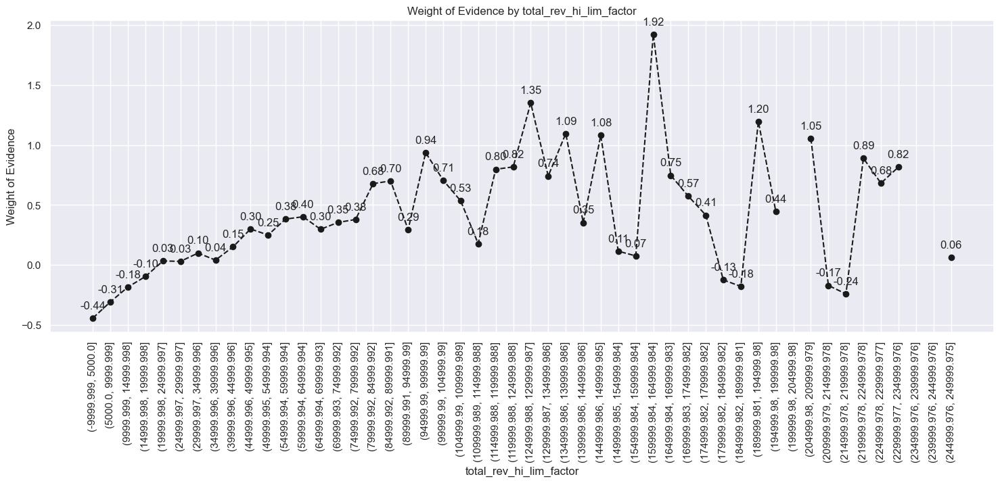

In [652]:
plot_by_woe(df_temp.iloc[: 50, : ], 90)

In [653]:
# Categories
# '<=5K', '5K-10K', '10K-20K', '20K-30K', '30K-40K', '40K-55K', '55K-95K', '>95K'
df_inputs_prepr['total_rev_hi_lim:<=5K'] = np.where((df_inputs_prepr['total_rev_hi_lim'] <= 5000), 1, 0)
df_inputs_prepr['total_rev_hi_lim:5K-10K'] = np.where((df_inputs_prepr['total_rev_hi_lim'] > 5000) & (df_inputs_prepr['total_rev_hi_lim'] <= 10000), 1, 0)
df_inputs_prepr['total_rev_hi_lim:10K-20K'] = np.where((df_inputs_prepr['total_rev_hi_lim'] > 10000) & (df_inputs_prepr['total_rev_hi_lim'] <= 20000), 1, 0)
df_inputs_prepr['total_rev_hi_lim:20K-30K'] = np.where((df_inputs_prepr['total_rev_hi_lim'] > 20000) & (df_inputs_prepr['total_rev_hi_lim'] <= 30000), 1, 0)
df_inputs_prepr['total_rev_hi_lim:30K-40K'] = np.where((df_inputs_prepr['total_rev_hi_lim'] > 30000) & (df_inputs_prepr['total_rev_hi_lim'] <= 40000), 1, 0)
df_inputs_prepr['total_rev_hi_lim:40K-55K'] = np.where((df_inputs_prepr['total_rev_hi_lim'] > 40000) & (df_inputs_prepr['total_rev_hi_lim'] <= 55000), 1, 0)
df_inputs_prepr['total_rev_hi_lim:55K-95K'] = np.where((df_inputs_prepr['total_rev_hi_lim'] > 55000) & (df_inputs_prepr['total_rev_hi_lim'] <= 95000), 1, 0)
df_inputs_prepr['total_rev_hi_lim:>95K'] = np.where((df_inputs_prepr['total_rev_hi_lim'] > 95000), 1, 0)

In [654]:
# annual_inc
df_inputs_prepr['annual_inc_factor'] = pd.cut(df_inputs_prepr['annual_inc'], 50)
df_temp = woe_ordered_continuous(df_inputs_prepr, 'annual_inc_factor', df_targets_prepr)
df_temp

C:\Users\dcgzb\AppData\Local\Temp\ipykernel_10772\1881610760.py:4: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  df = pd.concat([df.groupby(df.columns.values[0], as_index = False)[df.columns.values[1]].count(),
C:\Users\dcgzb\AppData\Local\Temp\ipykernel_10772\1881610760.py:5: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  df.groupby(df.columns.values[0], as_index = False)[df.columns.values[1]].mean()], axis = 1)


,annual_inc_factor,n_obs,prop_good,prop_n_obs,n_good,n_bad,prop_n_good,prop_n_bad,WoE,diff_prop_good,diff_WoE,IV
0,"(-9500.0, 190000.0]",409693,0.981193,0.972925,401988.0,7705.0,0.972764,0.981404,-0.008842,NaN,NaN,inf
1,"(190000.0, 380000.0]",10007,0.986609,0.023764,9873.0,134.0,0.023892,0.017068,0.336324,0.005416,0.345166,inf
2,"(380000.0, 570000.0]",943,0.990456,0.002239,934.0,9.0,0.002260,0.001146,0.678857,0.003847,0.342533,inf
3,"(570000.0, 760000.0]",257,1.000000,0.000610,257.0,0.0,0.000622,0.000000,inf,0.009544,inf,inf
4,"(760000.0, 950000.0]",70,1.000000,0.000166,70.0,0.0,0.000169,0.000000,inf,0.000000,NaN,inf
5,"(950000.0, 1140000.0]",43,1.000000,0.000102,43.0,0.0,0.000104,0.000000,inf,0.000000,NaN,inf
6,"(1140000.0, 1330000.0]",20,0.950000,0.000047,19.0,1.0,0.000046,0.000127,-1.018956,0.050000,inf,inf
7,"(1330000.0, 1520000.0]",14,1.000000,0.000033,14.0,0.0,0.000034,0.000000,inf,0.050000,inf,inf
8,"(1520000.0, 1710000.0]",3,0.666667,0.000007,2.0,1.0,0.000005,0.000127,-3.270248,0.333333,inf,inf
9,"(1710000.0, 1900000.0]",5,1.000000,0.000012,5.0,0.0,0.000012,0.000000,inf,0.333333,inf,inf


In [655]:
df_inputs_prepr['annual_inc_factor'] = pd.cut(df_inputs_prepr['annual_inc'], 100)
df_temp = woe_ordered_continuous(df_inputs_prepr, 'annual_inc_factor', df_targets_prepr)
df_temp

C:\Users\dcgzb\AppData\Local\Temp\ipykernel_10772\1881610760.py:4: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  df = pd.concat([df.groupby(df.columns.values[0], as_index = False)[df.columns.values[1]].count(),
C:\Users\dcgzb\AppData\Local\Temp\ipykernel_10772\1881610760.py:5: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  df.groupby(df.columns.values[0], as_index = False)[df.columns.values[1]].mean()], axis = 1)


,annual_inc_factor,n_obs,prop_good,prop_n_obs,n_good,n_bad,prop_n_good,prop_n_bad,WoE,diff_prop_good,diff_WoE,IV
0,"(-9500.0, 95000.0]",325648,0.980203,0.773338,319201.0,6447.0,0.772429,0.821169,-0.061189,NaN,NaN,inf
1,"(95000.0, 190000.0]",84045,0.985032,0.199587,82787.0,1258.0,0.200335,0.160234,0.223353,0.004829,0.284542,inf
2,"(190000.0, 285000.0]",8186,0.986196,0.019440,8073.0,113.0,0.019536,0.014393,0.305498,0.001164,0.082145,inf
3,"(285000.0, 380000.0]",1821,0.988468,0.004324,1800.0,21.0,0.004356,0.002675,0.487625,0.002272,0.182127,inf
4,"(380000.0, 475000.0]",652,0.990798,0.001548,646.0,6.0,0.001563,0.000764,0.715645,0.002330,0.228021,inf
5,"(475000.0, 570000.0]",291,0.989691,0.000691,288.0,3.0,0.000697,0.000382,0.600953,0.001107,0.114692,inf
6,"(570000.0, 665000.0]",165,1.000000,0.000392,165.0,0.0,0.000399,0.000000,inf,0.010309,inf,inf
7,"(665000.0, 760000.0]",92,1.000000,0.000218,92.0,0.0,0.000223,0.000000,inf,0.000000,NaN,inf
8,"(760000.0, 855000.0]",46,1.000000,0.000109,46.0,0.0,0.000111,0.000000,inf,0.000000,NaN,inf
9,"(855000.0, 950000.0]",24,1.000000,0.000057,24.0,0.0,0.000058,0.000000,inf,0.000000,NaN,inf


In [656]:
df_inputs_prepr_temp = df_inputs_prepr.loc[df_inputs_prepr['annual_inc'] <= 140000, : ]
#loan_data_temp = loan_data_temp.reset_index(drop = True)
#df_inputs_prepr_temp

In [657]:
df_inputs_prepr_temp = df_inputs_prepr.loc[df_inputs_prepr['annual_inc'] <= 140000, : ]
#loan_data_temp = loan_data_temp.reset_index(drop = True)
#df_inputs_prepr_temp

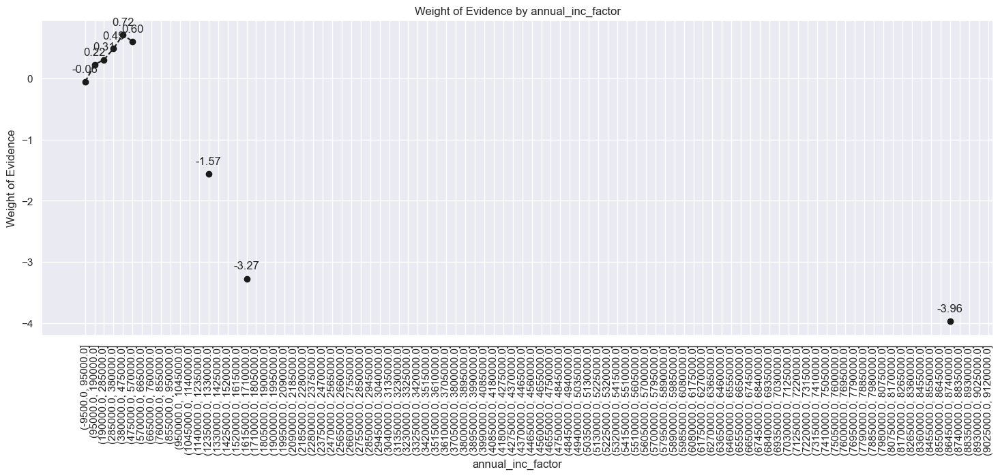

In [658]:
plot_by_woe(df_temp, 90)

In [659]:
# WoE is monotonically decreasing with income, so we split income in 10 equal categories, each with width of 15k.
df_inputs_prepr['annual_inc:<20K'] = np.where((df_inputs_prepr['annual_inc'] <= 20000), 1, 0)
df_inputs_prepr['annual_inc:20K-30K'] = np.where((df_inputs_prepr['annual_inc'] > 20000) & (df_inputs_prepr['annual_inc'] <= 30000), 1, 0)
df_inputs_prepr['annual_inc:30K-40K'] = np.where((df_inputs_prepr['annual_inc'] > 30000) & (df_inputs_prepr['annual_inc'] <= 40000), 1, 0)
df_inputs_prepr['annual_inc:40K-50K'] = np.where((df_inputs_prepr['annual_inc'] > 40000) & (df_inputs_prepr['annual_inc'] <= 50000), 1, 0)
df_inputs_prepr['annual_inc:50K-60K'] = np.where((df_inputs_prepr['annual_inc'] > 50000) & (df_inputs_prepr['annual_inc'] <= 60000), 1, 0)
df_inputs_prepr['annual_inc:60K-70K'] = np.where((df_inputs_prepr['annual_inc'] > 60000) & (df_inputs_prepr['annual_inc'] <= 70000), 1, 0)
df_inputs_prepr['annual_inc:70K-80K'] = np.where((df_inputs_prepr['annual_inc'] > 70000) & (df_inputs_prepr['annual_inc'] <= 80000), 1, 0)
df_inputs_prepr['annual_inc:80K-90K'] = np.where((df_inputs_prepr['annual_inc'] > 80000) & (df_inputs_prepr['annual_inc'] <= 90000), 1, 0)
df_inputs_prepr['annual_inc:90K-100K'] = np.where((df_inputs_prepr['annual_inc'] > 90000) & (df_inputs_prepr['annual_inc'] <= 100000), 1, 0)
df_inputs_prepr['annual_inc:100K-120K'] = np.where((df_inputs_prepr['annual_inc'] > 100000) & (df_inputs_prepr['annual_inc'] <= 120000), 1, 0)
df_inputs_prepr['annual_inc:120K-140K'] = np.where((df_inputs_prepr['annual_inc'] > 120000) & (df_inputs_prepr['annual_inc'] <= 140000), 1, 0)
df_inputs_prepr['annual_inc:>140K'] = np.where((df_inputs_prepr['annual_inc'] > 140000), 1, 0)

In [660]:
# dti
df_inputs_prepr['dti_factor'] = pd.cut(df_inputs_prepr['dti'], 100)
df_temp = woe_ordered_continuous(df_inputs_prepr, 'dti_factor', df_targets_prepr)
df_temp

C:\Users\dcgzb\AppData\Local\Temp\ipykernel_10772\1881610760.py:4: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  df = pd.concat([df.groupby(df.columns.values[0], as_index = False)[df.columns.values[1]].count(),
C:\Users\dcgzb\AppData\Local\Temp\ipykernel_10772\1881610760.py:5: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  df.groupby(df.columns.values[0], as_index = False)[df.columns.values[1]].mean()], axis = 1)


,dti_factor,n_obs,prop_good,prop_n_obs,n_good,n_bad,prop_n_good,prop_n_bad,WoE,diff_prop_good,diff_WoE,IV
0,"(-9.999, 99.99]",421083,0.981355,0.999974,413232.0,7851.0,0.999973,1.0,-0.000027,NaN,NaN,inf
1,"(99.99, 199.98]",6,1.000000,0.000014,6.0,0.0,0.000015,0.0,inf,0.018645,inf,inf
2,"(199.98, 299.97]",0,NaN,0.000000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,inf
3,"(299.97, 399.96]",1,1.000000,0.000002,1.0,0.0,0.000002,0.0,inf,NaN,NaN,inf
4,"(399.96, 499.95]",0,NaN,0.000000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,inf
5,"(499.95, 599.94]",0,NaN,0.000000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,inf
6,"(599.94, 699.93]",1,1.000000,0.000002,1.0,0.0,0.000002,0.0,inf,NaN,NaN,inf
7,"(699.93, 799.92]",0,NaN,0.000000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,inf
8,"(799.92, 899.91]",0,NaN,0.000000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,inf
9,"(899.91, 999.9]",0,NaN,0.000000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,inf


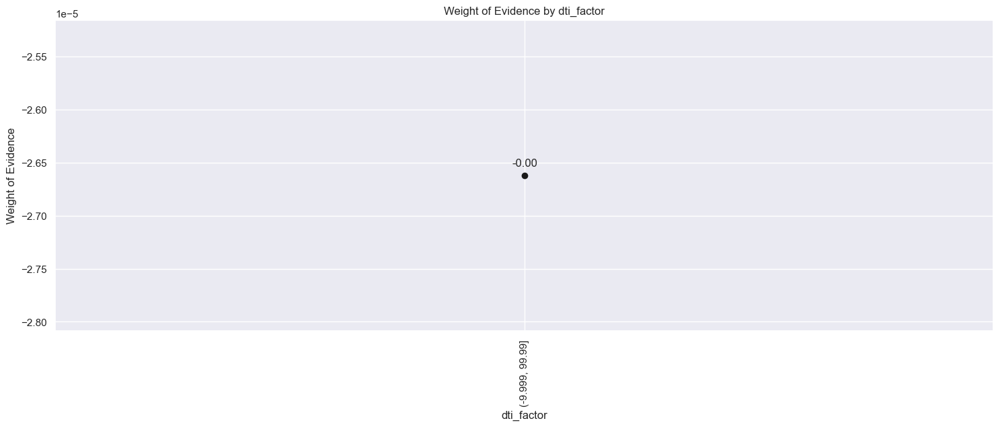

In [661]:
plot_by_woe(df_temp, 90)

In [662]:
df_inputs_prepr_temp = df_inputs_prepr.loc[df_inputs_prepr['dti'] <= 35, : ]

In [663]:
df_inputs_prepr_temp['dti_factor'] = pd.cut(df_inputs_prepr_temp['dti'], 50)
df_temp = woe_ordered_continuous(df_inputs_prepr_temp, 'dti_factor', df_targets_prepr[df_inputs_prepr_temp.index])
df_temp

C:\Users\dcgzb\AppData\Local\Temp\ipykernel_10772\2843865280.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_inputs_prepr_temp['dti_factor'] = pd.cut(df_inputs_prepr_temp['dti'], 50)
C:\Users\dcgzb\AppData\Local\Temp\ipykernel_10772\1881610760.py:4: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  df = pd.concat([df.groupby(df.columns.values[0], as_index = False)[df.columns.values[1]].count(),
C:\Users\dcgzb\AppData\Local\Temp\ipykernel_10772\1881610760.py:5: FutureWarning: The default of observed=False is deprecated and will be changed to True in a futu

,dti_factor,n_obs,prop_good,prop_n_obs,n_good,n_bad,prop_n_good,prop_n_bad,WoE,diff_prop_good,diff_WoE,IV
0,"(-0.035, 0.7]",707,0.980198,0.001749,693.0,14.0,0.001746,0.001907,-0.088060,NaN,NaN,0.045535
1,"(0.7, 1.4]",1116,0.977599,0.002761,1091.0,25.0,0.002749,0.003406,-0.214059,0.002599,0.125999,0.045535
2,"(1.4, 2.1]",1596,0.981830,0.003949,1567.0,29.0,0.003949,0.003950,-0.000410,0.004231,0.213648,0.045535
3,"(2.1, 2.8]",2140,0.982710,0.005295,2103.0,37.0,0.005299,0.005040,0.050169,0.000881,0.050580,0.045535
4,"(2.8, 3.5]",2873,0.981552,0.007108,2820.0,53.0,0.007106,0.007220,-0.015833,0.001158,0.066002,0.045535
5,"(3.5, 4.2]",3342,0.982944,0.008269,3285.0,57.0,0.008278,0.007765,0.064038,0.001392,0.079870,0.045535
6,"(4.2, 4.9]",3963,0.988140,0.009805,3916.0,47.0,0.009868,0.006402,0.432645,0.005196,0.368608,0.045535
7,"(4.9, 5.6]",4945,0.986653,0.012235,4879.0,66.0,0.012295,0.008991,0.313008,0.001487,0.119638,0.045535
8,"(5.6, 6.3]",5600,0.986071,0.013856,5522.0,78.0,0.013915,0.010625,0.269754,0.000582,0.043254,0.045535
9,"(6.3, 7.0]",6101,0.987543,0.015095,6025.0,76.0,0.015183,0.010353,0.382907,0.001472,0.113153,0.045535


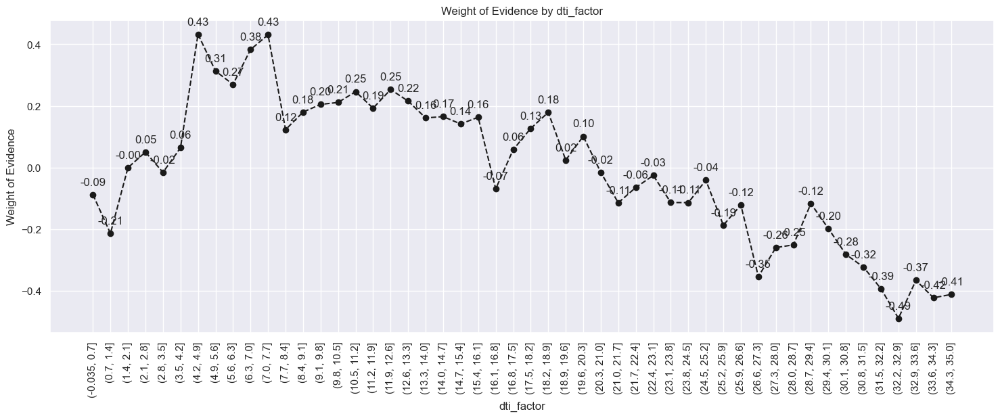

In [664]:
plot_by_woe(df_temp, 90)

In [665]:
# Categories:
df_inputs_prepr['dti:<=1.4'] = np.where((df_inputs_prepr['dti'] <= 1.4), 1, 0)
df_inputs_prepr['dti:1.4-3.5'] = np.where((df_inputs_prepr['dti'] > 1.4) & (df_inputs_prepr['dti'] <= 3.5), 1, 0)
df_inputs_prepr['dti:3.5-7.7'] = np.where((df_inputs_prepr['dti'] > 3.5) & (df_inputs_prepr['dti'] <= 7.7), 1, 0)
df_inputs_prepr['dti:7.7-10.5'] = np.where((df_inputs_prepr['dti'] > 7.7) & (df_inputs_prepr['dti'] <= 10.5), 1, 0)
df_inputs_prepr['dti:10.5-16.1'] = np.where((df_inputs_prepr['dti'] > 10.5) & (df_inputs_prepr['dti'] <= 16.1), 1, 0)
df_inputs_prepr['dti:16.1-20.3'] = np.where((df_inputs_prepr['dti'] > 16.1) & (df_inputs_prepr['dti'] <= 20.3), 1, 0)
df_inputs_prepr['dti:20.3-21.7'] = np.where((df_inputs_prepr['dti'] > 20.3) & (df_inputs_prepr['dti'] <= 21.7), 1, 0)
df_inputs_prepr['dti:21.7-22.4'] = np.where((df_inputs_prepr['dti'] > 21.7) & (df_inputs_prepr['dti'] <= 22.4), 1, 0)
df_inputs_prepr['dti:22.4-35'] = np.where((df_inputs_prepr['dti'] > 22.4) & (df_inputs_prepr['dti'] <= 35), 1, 0)
df_inputs_prepr['dti:>35'] = np.where((df_inputs_prepr['dti'] > 35), 1, 0)

C:\Users\dcgzb\AppData\Local\Temp\ipykernel_10772\284476014.py:10: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_inputs_prepr['dti:22.4-35'] = np.where((df_inputs_prepr['dti'] > 22.4) & (df_inputs_prepr['dti'] <= 35), 1, 0)
C:\Users\dcgzb\AppData\Local\Temp\ipykernel_10772\284476014.py:11: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_inputs_prepr['dti:>35'] = np.where((df_inputs_prepr['dti'] > 35), 1, 0)


In [666]:
# mths_since_last_delinq
# We have to create one category for missing values and do fine and coarse classing for the rest.
#loan_data_temp = loan_data[np.isfinite(loan_data['mths_since_last_delinq'])]
df_inputs_prepr_temp = df_inputs_prepr[pd.notnull(df_inputs_prepr['mths_since_last_delinq'])]
#sum(loan_data_temp['mths_since_last_delinq'].isnull())
df_inputs_prepr_temp['mths_since_last_delinq_factor'] = pd.cut(df_inputs_prepr_temp['mths_since_last_delinq'], 50)
df_temp = woe_ordered_continuous(df_inputs_prepr_temp, 'mths_since_last_delinq_factor', df_targets_prepr[df_inputs_prepr_temp.index])
df_temp

C:\Users\dcgzb\AppData\Local\Temp\ipykernel_10772\402041143.py:6: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_inputs_prepr_temp['mths_since_last_delinq_factor'] = pd.cut(df_inputs_prepr_temp['mths_since_last_delinq'], 50)
C:\Users\dcgzb\AppData\Local\Temp\ipykernel_10772\402041143.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_inputs_prepr_temp['mths_since_last_delinq_factor'] = pd.cut(df_inputs_prepr_temp['mths_since_last_delinq'], 50)
C:\Users\dcgzb\AppData\Local\Temp\ipykernel_10772\1881610760.py:4: Fu

,mths_since_last_delinq_factor,n_obs,prop_good,prop_n_obs,n_good,n_bad,prop_n_good,prop_n_bad,WoE,diff_prop_good,diff_WoE,IV
0,"(-0.176, 3.52]",7261,0.973833,0.033440,7071.0,190.0,0.033183,0.047041,-0.349003,NaN,NaN,inf
1,"(3.52, 7.04]",15763,0.978367,0.072596,15422.0,341.0,0.072372,0.084427,-0.154068,0.004534,0.194935,inf
2,"(7.04, 10.56]",12365,0.980348,0.056947,12122.0,243.0,0.056886,0.060163,-0.056020,0.001981,0.098048,inf
3,"(10.56, 14.08]",16125,0.979721,0.074263,15798.0,327.0,0.074136,0.080961,-0.088058,0.000627,0.032037,inf
4,"(14.08, 17.6]",11384,0.976985,0.052429,11122.0,262.0,0.052193,0.064868,-0.217400,0.002736,0.129343,inf
5,"(17.6, 21.12]",14291,0.983626,0.065817,14057.0,234.0,0.065966,0.057935,0.129818,0.006641,0.347219,inf
6,"(21.12, 24.64]",10544,0.982170,0.048560,10356.0,188.0,0.048598,0.046546,0.043143,0.001456,0.086675,inf
7,"(24.64, 28.16]",13761,0.981760,0.063376,13510.0,251.0,0.063399,0.062144,0.019996,0.000410,0.023147,inf
8,"(28.16, 31.68]",9867,0.985001,0.045442,9719.0,148.0,0.045609,0.036643,0.218889,0.003240,0.198893,inf
9,"(31.68, 35.2]",12583,0.985218,0.057951,12397.0,186.0,0.058176,0.046051,0.233727,0.000218,0.014837,inf


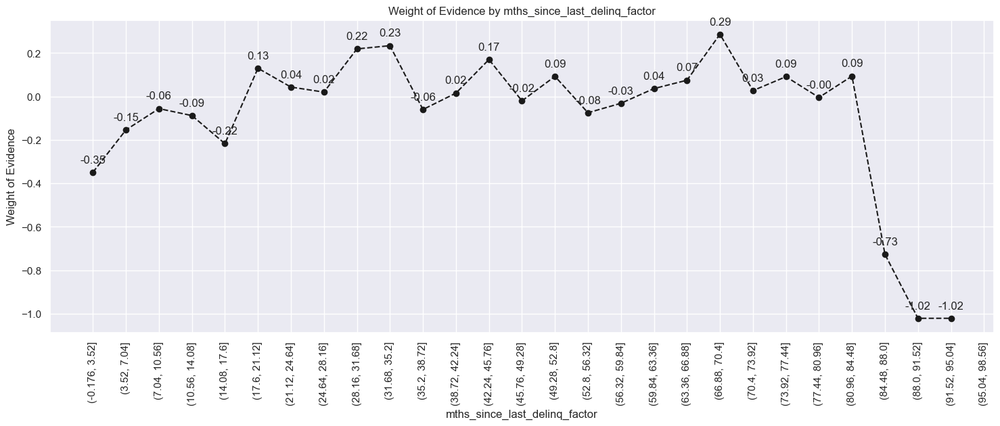

In [667]:
plot_by_woe(df_temp, 90)

In [668]:
# Categories: Missing, 0-3, 4-30, 31-56, >=57
df_inputs_prepr['mths_since_last_delinq:Missing'] = np.where((df_inputs_prepr['mths_since_last_delinq'].isnull()), 1, 0)
df_inputs_prepr['mths_since_last_delinq:0-3'] = np.where((df_inputs_prepr['mths_since_last_delinq'] >= 0) & (df_inputs_prepr['mths_since_last_delinq'] <= 3), 1, 0)
df_inputs_prepr['mths_since_last_delinq:4-30'] = np.where((df_inputs_prepr['mths_since_last_delinq'] >= 4) & (df_inputs_prepr['mths_since_last_delinq'] <= 30), 1, 0)
df_inputs_prepr['mths_since_last_delinq:31-56'] = np.where((df_inputs_prepr['mths_since_last_delinq'] >= 31) & (df_inputs_prepr['mths_since_last_delinq'] <= 56), 1, 0)
df_inputs_prepr['mths_since_last_delinq:>=57'] = np.where((df_inputs_prepr['mths_since_last_delinq'] >= 57), 1, 0)

C:\Users\dcgzb\AppData\Local\Temp\ipykernel_10772\3878719826.py:2: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_inputs_prepr['mths_since_last_delinq:Missing'] = np.where((df_inputs_prepr['mths_since_last_delinq'].isnull()), 1, 0)
C:\Users\dcgzb\AppData\Local\Temp\ipykernel_10772\3878719826.py:3: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_inputs_prepr['mths_since_last_delinq:0-3'] = np.where((df_inputs_prepr['mths_since_last_delinq'] >= 0) & (df_inputs_prepr['mths_since_last_delinq'] <= 3), 1, 0)
C:\Users\dcgzb\AppData\

In [669]:
# mths_since_last_record
# We have to create one category for missing values and do fine and coarse classing for the rest.
df_inputs_prepr_temp = df_inputs_prepr[pd.notnull(df_inputs_prepr['mths_since_last_record'])]
#sum(loan_data_temp['mths_since_last_record'].isnull())
df_inputs_prepr_temp['mths_since_last_record_factor'] = pd.cut(df_inputs_prepr_temp['mths_since_last_record'], 50)
df_temp = woe_ordered_continuous(df_inputs_prepr_temp, 'mths_since_last_record_factor', df_targets_prepr[df_inputs_prepr_temp.index])
df_temp

C:\Users\dcgzb\AppData\Local\Temp\ipykernel_10772\1692638012.py:5: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_inputs_prepr_temp['mths_since_last_record_factor'] = pd.cut(df_inputs_prepr_temp['mths_since_last_record'], 50)
C:\Users\dcgzb\AppData\Local\Temp\ipykernel_10772\1692638012.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_inputs_prepr_temp['mths_since_last_record_factor'] = pd.cut(df_inputs_prepr_temp['mths_since_last_record'], 50)
C:\Users\dcgzb\AppData\Local\Temp\ipykernel_10772\1881610760.py:4: 

,mths_since_last_record_factor,n_obs,prop_good,prop_n_obs,n_good,n_bad,prop_n_good,prop_n_bad,WoE,diff_prop_good,diff_WoE,IV
0,"(-0.12, 2.4]",87,0.965517,0.001169,84.0,3.0,0.001152,0.002041,-0.572239,NaN,NaN,0.060687
1,"(2.4, 4.8]",161,0.968944,0.002164,156.0,5.0,0.002139,0.003401,-0.464025,0.003427,0.108214,0.060687
2,"(4.8, 7.2]",344,0.976744,0.004623,336.0,8.0,0.004606,0.005442,-0.166774,0.007800,0.297252,0.060687
3,"(7.2, 9.6]",291,0.982818,0.003911,286.0,5.0,0.003921,0.003401,0.142111,0.006074,0.308884,0.060687
4,"(9.6, 12.0]",537,0.970205,0.007216,521.0,16.0,0.007142,0.010884,-0.421282,0.012613,0.563393,0.060687
5,"(12.0, 14.4]",404,0.985149,0.005429,398.0,6.0,0.005456,0.004082,0.290249,0.014944,0.711531,0.060687
6,"(14.4, 16.8]",410,0.980488,0.005510,402.0,8.0,0.005511,0.005442,0.012567,0.004661,0.277682,0.060687
7,"(16.8, 19.2]",693,0.987013,0.009313,684.0,9.0,0.009377,0.006122,0.426290,0.006525,0.413723,0.060687
8,"(19.2, 21.6]",521,0.986564,0.007001,514.0,7.0,0.007046,0.004762,0.391870,0.000449,0.034420,0.060687
9,"(21.6, 24.0]",825,0.979394,0.011086,808.0,17.0,0.011077,0.011565,-0.043095,0.007170,0.434964,0.060687


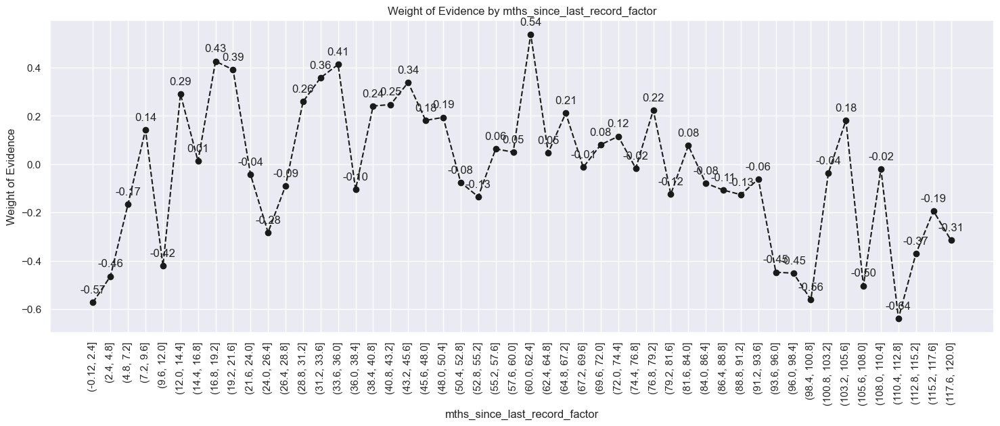

In [670]:
plot_by_woe(df_temp, 90)

In [671]:
# Categories: 'Missing', '0-2', '3-20', '21-31', '32-80', '81-86', '>86'
df_inputs_prepr['mths_since_last_record:Missing'] = np.where((df_inputs_prepr['mths_since_last_record'].isnull()), 1, 0)
df_inputs_prepr['mths_since_last_record:0-2'] = np.where((df_inputs_prepr['mths_since_last_record'] >= 0) & (df_inputs_prepr['mths_since_last_record'] <= 2), 1, 0)
df_inputs_prepr['mths_since_last_record:3-20'] = np.where((df_inputs_prepr['mths_since_last_record'] >= 3) & (df_inputs_prepr['mths_since_last_record'] <= 20), 1, 0)
df_inputs_prepr['mths_since_last_record:21-31'] = np.where((df_inputs_prepr['mths_since_last_record'] >= 21) & (df_inputs_prepr['mths_since_last_record'] <= 31), 1, 0)
df_inputs_prepr['mths_since_last_record:32-80'] = np.where((df_inputs_prepr['mths_since_last_record'] >= 32) & (df_inputs_prepr['mths_since_last_record'] <= 80), 1, 0)
df_inputs_prepr['mths_since_last_record:81-86'] = np.where((df_inputs_prepr['mths_since_last_record'] >= 81) & (df_inputs_prepr['mths_since_last_record'] <= 86), 1, 0)
df_inputs_prepr['mths_since_last_record:>86'] = np.where((df_inputs_prepr['mths_since_last_record'] >= 86), 1, 0)

C:\Users\dcgzb\AppData\Local\Temp\ipykernel_10772\1089508853.py:2: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_inputs_prepr['mths_since_last_record:Missing'] = np.where((df_inputs_prepr['mths_since_last_record'].isnull()), 1, 0)
C:\Users\dcgzb\AppData\Local\Temp\ipykernel_10772\1089508853.py:3: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_inputs_prepr['mths_since_last_record:0-2'] = np.where((df_inputs_prepr['mths_since_last_record'] >= 0) & (df_inputs_prepr['mths_since_last_record'] <= 2), 1, 0)
C:\Users\dcgzb\AppData\

In [672]:
df_inputs_prepr['mths_since_last_delinq:Missing'].sum()

203961

In [673]:
df_inputs_prepr['mths_since_last_delinq:Missing'].sum()

203961

In [674]:
df_inputs_prepr['mths_since_last_delinq:Missing'].sum()

203961

In [675]:
# installment
df_inputs_prepr['installment_factor'] = pd.cut(df_inputs_prepr['installment'], 50)
df_temp = woe_ordered_continuous(df_inputs_prepr, 'installment_factor', df_targets_prepr)
df_temp

C:\Users\dcgzb\AppData\Local\Temp\ipykernel_10772\3144613790.py:2: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_inputs_prepr['installment_factor'] = pd.cut(df_inputs_prepr['installment'], 50)
C:\Users\dcgzb\AppData\Local\Temp\ipykernel_10772\1881610760.py:4: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  df = pd.concat([df.groupby(df.columns.values[0], as_index = False)[df.columns.values[1]].count(),
C:\Users\dcgzb\AppData\Local\Temp\ipykernel_10772\1881610760.py:5: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future ve

,installment_factor,n_obs,prop_good,prop_n_obs,n_good,n_bad,prop_n_good,prop_n_bad,WoE,diff_prop_good,diff_WoE,IV
0,"(28.705, 58.427]",3506,0.982886,0.008326,3446.0,60.0,0.008339,0.007642,0.087230,NaN,NaN,inf
1,"(58.427, 86.734]",5832,0.981310,0.013850,5723.0,109.0,0.013849,0.013884,-0.002494,0.001576,0.089724,inf
2,"(86.734, 115.04]",8123,0.983134,0.019290,7986.0,137.0,0.019325,0.017450,0.102069,0.001824,0.104564,inf
3,"(115.04, 143.347]",9139,0.982383,0.021703,8978.0,161.0,0.021726,0.020507,0.057733,0.000751,0.044336,inf
4,"(143.347, 171.654]",17953,0.984459,0.042634,17674.0,279.0,0.042769,0.035537,0.185243,0.002076,0.127510,inf
5,"(171.654, 199.961]",15515,0.985691,0.036845,15293.0,222.0,0.037007,0.028277,0.269078,0.001232,0.083835,inf
6,"(199.961, 228.268]",16515,0.982864,0.039219,16232.0,283.0,0.039280,0.036046,0.085898,0.002827,0.183180,inf
7,"(228.268, 256.574]",22043,0.983033,0.052347,21669.0,374.0,0.052436,0.047637,0.095987,0.000169,0.010089,inf
8,"(256.574, 284.881]",25323,0.980966,0.060136,24841.0,482.0,0.060112,0.061393,-0.021088,0.002067,0.117075,inf
9,"(284.881, 313.188]",24135,0.980443,0.057315,23663.0,472.0,0.057262,0.060120,-0.048706,0.000523,0.027618,inf


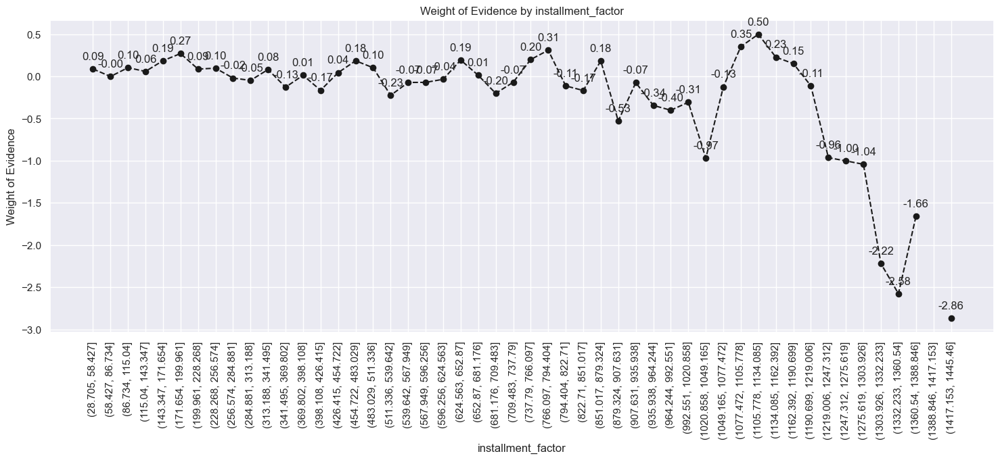

In [676]:
plot_by_woe(df_temp, 90)

In [677]:
#####
#loan_data_inputs_train = df_inputs_prepr
#####
#loan_data_inputs_test = df_inputs_prepr
######
loan_data_inputs_2015 = df_inputs_prepr

In [678]:
loan_data_targets_2015 = df_targets_prepr

In [679]:
pd.options.display.max_rows = None
loan_data_inputs_2015.columns.values

array(['id', 'member_id', 'loan_amnt', 'funded_amnt', 'funded_amnt_inv',
       'term', 'int_rate', 'installment', 'grade', 'sub_grade',
       'emp_title', 'emp_length', 'home_ownership', 'annual_inc',
       'verification_status', 'issue_d', 'loan_status', 'pymnt_plan',
       'url', 'desc', 'purpose', 'title', 'zip_code', 'addr_state', 'dti',
       'delinq_2yrs', 'earliest_cr_line', 'inq_last_6mths',
       'mths_since_last_delinq', 'mths_since_last_record', 'open_acc',
       'pub_rec', 'revol_bal', 'revol_util', 'total_acc',
       'initial_list_status', 'out_prncp', 'out_prncp_inv', 'total_pymnt',
       'total_pymnt_inv', 'total_rec_prncp', 'total_rec_int',
       'total_rec_late_fee', 'recoveries', 'collection_recovery_fee',
       'last_pymnt_d', 'last_pymnt_amnt', 'next_pymnt_d',
       'last_credit_pull_d', 'collections_12_mths_ex_med',
       'mths_since_last_major_derog', 'policy_code', 'application_type',
       'annual_inc_joint', 'dti_joint', 'verification_status_joint

In [680]:
loan_data_inputs_2015.shape

(421094, 319)

In [681]:
loan_data_targets_2015.shape

(421094,)

In [682]:
loan_data_inputs_2015.to_csv('loan_data_inputs_2015.csv')
loan_data_targets_2015.to_csv('loan_data_targets_2015.csv')

In [684]:
inputs_train_with_ref_cat = pd.read_csv('inputs_train_with_ref_cat.csv', index_col = 0)
# We import the dataset with old data, i.e. "expected" data.

In [685]:
inputs_train_with_ref_cat.columns.values

array(['grade:A', 'grade:B', 'grade:C', 'grade:D', 'grade:E', 'grade:F',
       'grade:G', 'home_ownership:RENT_OTHER_NONE_ANY',
       'home_ownership:OWN', 'home_ownership:MORTGAGE',
       'addr_state:ND_NE_IA_NV_FL_HI_AL', 'addr_state:NM_VA',
       'addr_state:NY', 'addr_state:OK_TN_MO_LA_MD_NC', 'addr_state:CA',
       'addr_state:UT_KY_AZ_NJ', 'addr_state:AR_MI_PA_OH_MN',
       'addr_state:RI_MA_DE_SD_IN', 'addr_state:GA_WA_OR',
       'addr_state:WI_MT', 'addr_state:TX', 'addr_state:IL_CT',
       'addr_state:KS_SC_CO_VT_AK_MS', 'addr_state:WV_NH_WY_DC_ME_ID',
       'verification_status:Not Verified',
       'verification_status:Source Verified',
       'verification_status:Verified',
       'purpose:educ__sm_b__wedd__ren_en__mov__house',
       'purpose:credit_card', 'purpose:debt_consolidation',
       'purpose:oth__med__vacation',
       'purpose:major_purch__car__home_impr', 'initial_list_status:f',
       'initial_list_status:w', 'term:36', 'term:60', 'emp_length:0',
   

In [686]:
# From the dataframe with new, "actual" data, we keep only the relevant columns.
inputs_2015_with_ref_cat = loan_data_inputs_2015.loc[: , ['grade:A',
'grade:B',
'grade:C',
'grade:D',
'grade:E',
'grade:F',
'grade:G',
'home_ownership:RENT_OTHER_NONE_ANY',
'home_ownership:OWN',
'home_ownership:MORTGAGE',
'addr_state:ND_NE_IA_NV_FL_HI_AL',
'addr_state:NM_VA',
'addr_state:NY',
'addr_state:OK_TN_MO_LA_MD_NC',
'addr_state:CA',
'addr_state:UT_KY_AZ_NJ',
'addr_state:AR_MI_PA_OH_MN',
'addr_state:RI_MA_DE_SD_IN',
'addr_state:GA_WA_OR',
'addr_state:WI_MT',
'addr_state:TX',
'addr_state:IL_CT',
'addr_state:KS_SC_CO_VT_AK_MS',
'addr_state:WV_NH_WY_DC_ME_ID',
'verification_status:Not Verified',
'verification_status:Source Verified',
'verification_status:Verified',
'purpose:educ__sm_b__wedd__ren_en__mov__house',
'purpose:credit_card',
'purpose:debt_consolidation',
'purpose:oth__med__vacation',
'purpose:major_purch__car__home_impr',
'initial_list_status:f',
'initial_list_status:w',
'term:36',
'term:60',
'emp_length:0',
'emp_length:1',
'emp_length:2-4',
'emp_length:5-6',
'emp_length:7-9',
'emp_length:10',
'mths_since_issue_d:<38',
'mths_since_issue_d:38-39',
'mths_since_issue_d:40-41',
'mths_since_issue_d:42-48',
'mths_since_issue_d:49-52',
'mths_since_issue_d:53-64',
'mths_since_issue_d:65-84',
'mths_since_issue_d:>84',
'int_rate:<9.548',
'int_rate:9.548-12.025',
'int_rate:12.025-15.74',
'int_rate:15.74-20.281',
'int_rate:>20.281',
'mths_since_earliest_cr_line:<140',
'mths_since_earliest_cr_line:141-164',
'mths_since_earliest_cr_line:165-247',
'mths_since_earliest_cr_line:248-270',
'mths_since_earliest_cr_line:271-352',
'mths_since_earliest_cr_line:>352',
'inq_last_6mths:0',
'inq_last_6mths:1-2',
'inq_last_6mths:3-6',
'inq_last_6mths:>6',
'acc_now_delinq:0',
'acc_now_delinq:>=1',
'annual_inc:<20K',
'annual_inc:20K-30K',
'annual_inc:30K-40K',
'annual_inc:40K-50K',
'annual_inc:50K-60K',
'annual_inc:60K-70K',
'annual_inc:70K-80K',
'annual_inc:80K-90K',
'annual_inc:90K-100K',
'annual_inc:100K-120K',
'annual_inc:120K-140K',
'annual_inc:>140K',
'dti:<=1.4',
'dti:1.4-3.5',
'dti:3.5-7.7',
'dti:7.7-10.5',
'dti:10.5-16.1',
'dti:16.1-20.3',
'dti:20.3-21.7',
'dti:21.7-22.4',
'dti:22.4-35',
'dti:>35',
'mths_since_last_delinq:Missing',
'mths_since_last_delinq:0-3',
'mths_since_last_delinq:4-30',
'mths_since_last_delinq:31-56',
'mths_since_last_delinq:>=57',
'mths_since_last_record:Missing',
'mths_since_last_record:0-2',
'mths_since_last_record:3-20',
'mths_since_last_record:21-31',
'mths_since_last_record:32-80',
'mths_since_last_record:81-86',
'mths_since_last_record:>86',
]]

In [687]:
inputs_train_with_ref_cat.shape

(373004, 101)

In [688]:
inputs_2015_with_ref_cat.shape

(421094, 101)

In [689]:
df_scorecard = pd.read_csv('df_scorecard.csv', index_col = 0)
# We import the scorecard.

In [690]:
df_scorecard

,index,Feature name,Coefficients,p_values,Original feature name,Score - Calculation,Score - Preliminary,Difference,Score - Final
0,0,Intercept,-1.461507,NaN,Intercept,310.723699,311.0,0.276301,311.0
1,1,grade:A,1.095858,3.634202e-33,grade,83.506155,84.0,0.493845,82.0
2,2,grade:B,0.855118,1.366137e-44,grade,65.161346,65.0,-0.161346,65.0
3,3,grade:C,0.657372,2.622250e-31,grade,50.092772,50.0,-0.092772,50.0
4,4,grade:D,0.478447,3.818008e-19,grade,36.458432,36.0,-0.458432,36.0
5,5,grade:E,0.315083,2.867491e-11,grade,24.009798,24.0,-0.009798,24.0
6,6,grade:F,0.162163,9.976025e-04,grade,12.357054,12.0,-0.357054,12.0
7,7,home_ownership:OWN,0.073842,2.258225e-04,home_ownership,5.626850,6.0,0.373150,6.0
8,8,home_ownership:MORTGAGE,0.107316,2.285390e-17,home_ownership,8.177643,8.0,-0.177643,8.0
9,9,addr_state:NM_VA,0.058589,6.696356e-02,addr_state,4.464595,4.0,-0.464595,4.0


In [691]:
inputs_train_with_ref_cat_w_intercept = inputs_train_with_ref_cat
inputs_train_with_ref_cat_w_intercept.insert(0, 'Intercept', 1)
# We insert a column in the dataframe, with an index of 0, that is, in the beginning of the dataframe.
# The name of that column is 'Intercept', and its values are 1s.
inputs_train_with_ref_cat_w_intercept = inputs_train_with_ref_cat_w_intercept[df_scorecard['Feature name'].values]
# Here, from the 'inputs_train_with_ref_cat_w_intercept' dataframe, we keep only the columns with column names,
# exactly equal to the row values of the 'Feature name' column from the 'df_scorecard' dataframe.
inputs_train_with_ref_cat_w_intercept.head()

,Intercept,grade:A,grade:B,grade:C,grade:D,grade:E,grade:F,home_ownership:OWN,home_ownership:MORTGAGE,addr_state:NM_VA,addr_state:NY,addr_state:OK_TN_MO_LA_MD_NC,addr_state:CA,addr_state:UT_KY_AZ_NJ,addr_state:AR_MI_PA_OH_MN,addr_state:RI_MA_DE_SD_IN,addr_state:GA_WA_OR,addr_state:WI_MT,addr_state:TX,addr_state:IL_CT,addr_state:KS_SC_CO_VT_AK_MS,addr_state:WV_NH_WY_DC_ME_ID,verification_status:Not Verified,verification_status:Source Verified,purpose:credit_card,purpose:debt_consolidation,purpose:oth__med__vacation,purpose:major_purch__car__home_impr,initial_list_status:w,term:36,emp_length:1,emp_length:2-4,emp_length:5-6,emp_length:7-9,emp_length:10,mths_since_issue_d:<38,mths_since_issue_d:38-39,mths_since_issue_d:40-41,mths_since_issue_d:42-48,mths_since_issue_d:49-52,mths_since_issue_d:53-64,mths_since_issue_d:65-84,int_rate:<9.548,int_rate:9.548-12.025,int_rate:12.025-15.74,int_rate:15.74-20.281,mths_since_earliest_cr_line:141-164,mths_since_earliest_cr_line:165-247,mths_since_earliest_cr_line:248-270,mths_since_earliest_cr_line:271-352,mths_since_earliest_cr_line:>352,inq_last_6mths:0,inq_last_6mths:1-2,inq_last_6mths:3-6,acc_now_delinq:>=1,annual_inc:20K-30K,annual_inc:30K-40K,annual_inc:40K-50K,annual_inc:50K-60K,annual_inc:60K-70K,annual_inc:70K-80K,annual_inc:80K-90K,annual_inc:90K-100K,annual_inc:100K-120K,annual_inc:120K-140K,annual_inc:>140K,dti:<=1.4,dti:1.4-3.5,dti:3.5-7.7,dti:7.7-10.5,dti:10.5-16.1,dti:16.1-20.3,dti:20.3-21.7,dti:21.7-22.4,dti:22.4-35,mths_since_last_delinq:Missing,mths_since_last_delinq:4-30,mths_since_last_delinq:31-56,mths_since_last_delinq:>=57,mths_since_last_record:Missing,mths_since_last_record:3-20,mths_since_last_record:21-31,mths_since_last_record:32-80,mths_since_last_record:81-86,mths_since_last_record:>86,grade:G,home_ownership:RENT_OTHER_NONE_ANY,addr_state:ND_NE_IA_NV_FL_HI_AL,verification_status:Verified,purpose:educ__sm_b__wedd__ren_en__mov__house,initial_list_status:f,term:60,emp_length:0,mths_since_issue_d:>84,int_rate:>20.281,mths_since_earliest_cr_line:<140,inq_last_6mths:>6,acc_now_delinq:0,annual_inc:<20K,dti:>35,mths_since_last_delinq:0-3,mths_since_last_record:0-2
431128,1,False,True,False,False,False,False,False,True,0,False,0,False,0,0,0,0,0,True,0,0,0,False,True,False,True,0,0,False,1,0,0,0,0,1,0,0,0,1,0,0,0,0,1,0,0,0,0,0,1,0,0,1,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,1,0,1,0,0,0,0,0,False,0,0,False,0,True,0,0,0,0,0,0,1,0,0,0,0
413015,1,False,False,False,True,False,False,False,False,1,False,0,False,0,0,0,0,0,False,0,0,0,False,False,False,True,0,0,True,0,0,1,0,0,0,0,0,0,1,0,0,0,0,0,0,1,1,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,1,0,0,0,1,0,0,0,1,0,0,0,0,0,False,1,0,True,0,False,1,0,0,0,0,0,1,0,0,0,0
90236,1,False,False,False,False,False,True,False,True,0,False,0,False,1,0,0,0,0,False,0,0,0,False,False,False,True,0,0,True,0,0,0,0,0,1,0,0,0,0,1,0,0,0,0,0,0,0,0,1,0,0,0,1,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,1,0,0,1,0,0,0,0,0,False,0,0,True,0,False,1,0,0,1,0,0,1,0,0,0,0
122060,1,False,True,False,False,False,False,False,False,0,False,0,False,1,0,0,0,0,False,0,0,0,True,False,False,True,0,0,True,1,0,1,0,0,0,0,0,0,0,0,1,0,0,0,1,0,1,0,0,0,0,1,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,1,0,0,1,0,0,0,0,0,False,1,0,False,0,False,0,0,0,0,0,0,1,0,0,0,0
41491,1,False,True,False,False,False,False,False,True,0,False,0,False,0,0,0,0,0,False,1,0,0,True,False,False,False,1,0,False,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,1,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,1,0,0,0,1,0,0,0,0,0,False,0,0,False,0,True,0,1,1,0,0,0,1,1,0,0,0


In [692]:
inputs_train_with_ref_cat_w_intercept.columns.values

array(['Intercept', 'grade:A', 'grade:B', 'grade:C', 'grade:D', 'grade:E',
       'grade:F', 'home_ownership:OWN', 'home_ownership:MORTGAGE',
       'addr_state:NM_VA', 'addr_state:NY',
       'addr_state:OK_TN_MO_LA_MD_NC', 'addr_state:CA',
       'addr_state:UT_KY_AZ_NJ', 'addr_state:AR_MI_PA_OH_MN',
       'addr_state:RI_MA_DE_SD_IN', 'addr_state:GA_WA_OR',
       'addr_state:WI_MT', 'addr_state:TX', 'addr_state:IL_CT',
       'addr_state:KS_SC_CO_VT_AK_MS', 'addr_state:WV_NH_WY_DC_ME_ID',
       'verification_status:Not Verified',
       'verification_status:Source Verified', 'purpose:credit_card',
       'purpose:debt_consolidation', 'purpose:oth__med__vacation',
       'purpose:major_purch__car__home_impr', 'initial_list_status:w',
       'term:36', 'emp_length:1', 'emp_length:2-4', 'emp_length:5-6',
       'emp_length:7-9', 'emp_length:10', 'mths_since_issue_d:<38',
       'mths_since_issue_d:38-39', 'mths_since_issue_d:40-41',
       'mths_since_issue_d:42-48', 'mths_since_issu

In [693]:
inputs_2015_with_ref_cat.columns.values

array(['grade:A', 'grade:B', 'grade:C', 'grade:D', 'grade:E', 'grade:F',
       'grade:G', 'home_ownership:RENT_OTHER_NONE_ANY',
       'home_ownership:OWN', 'home_ownership:MORTGAGE',
       'addr_state:ND_NE_IA_NV_FL_HI_AL', 'addr_state:NM_VA',
       'addr_state:NY', 'addr_state:OK_TN_MO_LA_MD_NC', 'addr_state:CA',
       'addr_state:UT_KY_AZ_NJ', 'addr_state:AR_MI_PA_OH_MN',
       'addr_state:RI_MA_DE_SD_IN', 'addr_state:GA_WA_OR',
       'addr_state:WI_MT', 'addr_state:TX', 'addr_state:IL_CT',
       'addr_state:KS_SC_CO_VT_AK_MS', 'addr_state:WV_NH_WY_DC_ME_ID',
       'verification_status:Not Verified',
       'verification_status:Source Verified',
       'verification_status:Verified',
       'purpose:educ__sm_b__wedd__ren_en__mov__house',
       'purpose:credit_card', 'purpose:debt_consolidation',
       'purpose:oth__med__vacation',
       'purpose:major_purch__car__home_impr', 'initial_list_status:f',
       'initial_list_status:w', 'term:36', 'term:60', 'emp_length:0',
   

In [694]:
inputs_2015_with_ref_cat_w_intercept = inputs_2015_with_ref_cat
inputs_2015_with_ref_cat_w_intercept.insert(0, 'Intercept', 1)
# We insert a column in the dataframe, with an index of 0, that is, in the beginning of the dataframe.
# The name of that column is 'Intercept', and its values are 1s.
inputs_2015_with_ref_cat_w_intercept = inputs_2015_with_ref_cat_w_intercept[df_scorecard['Feature name'].values]
# Here, from the 'inputs_train_with_ref_cat_w_intercept' dataframe, we keep only the columns with column names,
# exactly equal to the row values of the 'Feature name' column from the 'df_scorecard' dataframe.
inputs_2015_with_ref_cat_w_intercept.head()

,Intercept,grade:A,grade:B,grade:C,grade:D,grade:E,grade:F,home_ownership:OWN,home_ownership:MORTGAGE,addr_state:NM_VA,addr_state:NY,addr_state:OK_TN_MO_LA_MD_NC,addr_state:CA,addr_state:UT_KY_AZ_NJ,addr_state:AR_MI_PA_OH_MN,addr_state:RI_MA_DE_SD_IN,addr_state:GA_WA_OR,addr_state:WI_MT,addr_state:TX,addr_state:IL_CT,addr_state:KS_SC_CO_VT_AK_MS,addr_state:WV_NH_WY_DC_ME_ID,verification_status:Not Verified,verification_status:Source Verified,purpose:credit_card,purpose:debt_consolidation,purpose:oth__med__vacation,purpose:major_purch__car__home_impr,initial_list_status:w,term:36,emp_length:1,emp_length:2-4,emp_length:5-6,emp_length:7-9,emp_length:10,mths_since_issue_d:<38,mths_since_issue_d:38-39,mths_since_issue_d:40-41,mths_since_issue_d:42-48,mths_since_issue_d:49-52,mths_since_issue_d:53-64,mths_since_issue_d:65-84,int_rate:<9.548,int_rate:9.548-12.025,int_rate:12.025-15.74,int_rate:15.74-20.281,mths_since_earliest_cr_line:141-164,mths_since_earliest_cr_line:165-247,mths_since_earliest_cr_line:248-270,mths_since_earliest_cr_line:271-352,mths_since_earliest_cr_line:>352,inq_last_6mths:0,inq_last_6mths:1-2,inq_last_6mths:3-6,acc_now_delinq:>=1,annual_inc:20K-30K,annual_inc:30K-40K,annual_inc:40K-50K,annual_inc:50K-60K,annual_inc:60K-70K,annual_inc:70K-80K,annual_inc:80K-90K,annual_inc:90K-100K,annual_inc:100K-120K,annual_inc:120K-140K,annual_inc:>140K,dti:<=1.4,dti:1.4-3.5,dti:3.5-7.7,dti:7.7-10.5,dti:10.5-16.1,dti:16.1-20.3,dti:20.3-21.7,dti:21.7-22.4,dti:22.4-35,mths_since_last_delinq:Missing,mths_since_last_delinq:4-30,mths_since_last_delinq:31-56,mths_since_last_delinq:>=57,mths_since_last_record:Missing,mths_since_last_record:3-20,mths_since_last_record:21-31,mths_since_last_record:32-80,mths_since_last_record:81-86,mths_since_last_record:>86,grade:G,home_ownership:RENT_OTHER_NONE_ANY,addr_state:ND_NE_IA_NV_FL_HI_AL,verification_status:Verified,purpose:educ__sm_b__wedd__ren_en__mov__house,initial_list_status:f,term:60,emp_length:0,mths_since_issue_d:>84,int_rate:>20.281,mths_since_earliest_cr_line:<140,inq_last_6mths:>6,acc_now_delinq:0,annual_inc:<20K,dti:>35,mths_since_last_delinq:0-3,mths_since_last_record:0-2
0,1,False,False,True,False,False,False,False,True,0,False,0,False,0,0,0,0,0,False,0,0,1,False,True,False,False,0,1,True,0,0,0,0,0,1,1,0,0,0,0,0,0,0,1,0,0,0,0,0,1,0,1,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,1,0,0,0,0,0,0,0,0,1,0,1,0,0,0,0,0,False,0,0,False,0,False,1,0,0,0,0,0,1,0,0,0,0
1,1,True,False,False,False,False,False,False,True,0,False,0,False,0,0,1,0,0,False,0,0,0,True,False,True,False,0,0,True,1,0,0,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,1,0,0,0,1,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,1,0,0,0,0,0,0,1,0,0,0,1,0,0,0,0,0,False,0,0,False,0,False,0,1,0,0,0,0,1,0,0,0,0
2,1,False,False,True,False,False,False,False,False,0,False,0,False,0,0,0,0,0,False,0,1,0,False,True,False,True,0,0,True,1,0,0,1,0,0,1,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,1,0,0,1,0,0,0,0,0,False,1,0,False,0,False,0,0,0,0,1,0,1,0,0,0,0
3,1,False,False,True,False,False,False,False,False,0,False,0,False,0,0,1,0,0,False,0,0,0,True,False,False,True,0,0,True,0,0,0,0,0,1,1,0,0,0,0,0,0,0,1,0,0,0,1,0,0,0,0,1,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,1,0,0,0,1,0,0,0,0,0,False,1,0,False,0,False,1,0,0,0,0,0,1,0,0,0,0
4,1,False,True,False,False,False,False,False,True,0,False,0,False,0,0,0,0,0,False,1,0,0,True,False,False,False,0,1,True,0,0,0,0,0,1,1,0,0,0,0,0,0,0,1,0,0,0,1,0,0,0,1,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,1,0,0,0,1,0,0,0,0,0,False,0,0,False,0,False,1,0,0,0,0,0,1,0,0,0,0


In [695]:
scorecard_scores = df_scorecard['Score - Final']
scorecard_scores = scorecard_scores.values.reshape(102, 1)

In [696]:
y_scores_train = inputs_train_with_ref_cat_w_intercept.dot(scorecard_scores)
# Here we multiply the values of each row of the dataframe by the values of each column of the variable,
# which is an argument of the 'dot' method, and sum them. It's essentially the sum of the products.
y_scores_train.head()

,0
431128,622.0
413015,581.0
90236,492.0
122060,585.0
41491,571.0


In [697]:
y_scores_2015 = inputs_2015_with_ref_cat_w_intercept.dot(scorecard_scores)
# Here we multiply the values of each row of the dataframe by the values of each column of the variable,
# which is an argument of the 'dot' method, and sum them. It's essentially the sum of the products.
y_scores_2015.head()

,0
0,747.0
1,759.0
2,639.0
3,624.0
4,706.0


In [698]:
inputs_train_with_ref_cat_w_intercept = pd.concat([inputs_train_with_ref_cat_w_intercept, y_scores_train], axis = 1)
inputs_2015_with_ref_cat_w_intercept = pd.concat([inputs_2015_with_ref_cat_w_intercept, y_scores_2015], axis = 1)
# Here we concatenate the scores we calculated with the rest of the variables in the two dataframes:
# the one with old ("expected") data and the one with new ("actual") data.

In [699]:
inputs_train_with_ref_cat_w_intercept.columns.values[inputs_train_with_ref_cat_w_intercept.shape[1] - 1] = 'Score'
inputs_2015_with_ref_cat_w_intercept.columns.values[inputs_2015_with_ref_cat_w_intercept.shape[1] - 1] = 'Score'
# Here we rename the columns containing scores to "Score" in both dataframes.

In [700]:
inputs_2015_with_ref_cat_w_intercept.head()

,Intercept,grade:A,grade:B,grade:C,grade:D,grade:E,grade:F,home_ownership:OWN,home_ownership:MORTGAGE,addr_state:NM_VA,addr_state:NY,addr_state:OK_TN_MO_LA_MD_NC,addr_state:CA,addr_state:UT_KY_AZ_NJ,addr_state:AR_MI_PA_OH_MN,addr_state:RI_MA_DE_SD_IN,addr_state:GA_WA_OR,addr_state:WI_MT,addr_state:TX,addr_state:IL_CT,addr_state:KS_SC_CO_VT_AK_MS,addr_state:WV_NH_WY_DC_ME_ID,verification_status:Not Verified,verification_status:Source Verified,purpose:credit_card,purpose:debt_consolidation,purpose:oth__med__vacation,purpose:major_purch__car__home_impr,initial_list_status:w,term:36,emp_length:1,emp_length:2-4,emp_length:5-6,emp_length:7-9,emp_length:10,mths_since_issue_d:<38,mths_since_issue_d:38-39,mths_since_issue_d:40-41,mths_since_issue_d:42-48,mths_since_issue_d:49-52,mths_since_issue_d:53-64,mths_since_issue_d:65-84,int_rate:<9.548,int_rate:9.548-12.025,int_rate:12.025-15.74,int_rate:15.74-20.281,mths_since_earliest_cr_line:141-164,mths_since_earliest_cr_line:165-247,mths_since_earliest_cr_line:248-270,mths_since_earliest_cr_line:271-352,mths_since_earliest_cr_line:>352,inq_last_6mths:0,inq_last_6mths:1-2,inq_last_6mths:3-6,acc_now_delinq:>=1,annual_inc:20K-30K,annual_inc:30K-40K,annual_inc:40K-50K,annual_inc:50K-60K,annual_inc:60K-70K,annual_inc:70K-80K,annual_inc:80K-90K,annual_inc:90K-100K,annual_inc:100K-120K,annual_inc:120K-140K,annual_inc:>140K,dti:<=1.4,dti:1.4-3.5,dti:3.5-7.7,dti:7.7-10.5,dti:10.5-16.1,dti:16.1-20.3,dti:20.3-21.7,dti:21.7-22.4,dti:22.4-35,mths_since_last_delinq:Missing,mths_since_last_delinq:4-30,mths_since_last_delinq:31-56,mths_since_last_delinq:>=57,mths_since_last_record:Missing,mths_since_last_record:3-20,mths_since_last_record:21-31,mths_since_last_record:32-80,mths_since_last_record:81-86,mths_since_last_record:>86,grade:G,home_ownership:RENT_OTHER_NONE_ANY,addr_state:ND_NE_IA_NV_FL_HI_AL,verification_status:Verified,purpose:educ__sm_b__wedd__ren_en__mov__house,initial_list_status:f,term:60,emp_length:0,mths_since_issue_d:>84,int_rate:>20.281,mths_since_earliest_cr_line:<140,inq_last_6mths:>6,acc_now_delinq:0,annual_inc:<20K,dti:>35,mths_since_last_delinq:0-3,mths_since_last_record:0-2,Score
0,1,False,False,True,False,False,False,False,True,0,False,0,False,0,0,0,0,0,False,0,0,1,False,True,False,False,0,1,True,0,0,0,0,0,1,1,0,0,0,0,0,0,0,1,0,0,0,0,0,1,0,1,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,1,0,0,0,0,0,0,0,0,1,0,1,0,0,0,0,0,False,0,0,False,0,False,1,0,0,0,0,0,1,0,0,0,0,747.0
1,1,True,False,False,False,False,False,False,True,0,False,0,False,0,0,1,0,0,False,0,0,0,True,False,True,False,0,0,True,1,0,0,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,1,0,0,0,1,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,1,0,0,0,0,0,0,1,0,0,0,1,0,0,0,0,0,False,0,0,False,0,False,0,1,0,0,0,0,1,0,0,0,0,759.0
2,1,False,False,True,False,False,False,False,False,0,False,0,False,0,0,0,0,0,False,0,1,0,False,True,False,True,0,0,True,1,0,0,1,0,0,1,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,1,0,0,1,0,0,0,0,0,False,1,0,False,0,False,0,0,0,0,1,0,1,0,0,0,0,639.0
3,1,False,False,True,False,False,False,False,False,0,False,0,False,0,0,1,0,0,False,0,0,0,True,False,False,True,0,0,True,0,0,0,0,0,1,1,0,0,0,0,0,0,0,1,0,0,0,1,0,0,0,0,1,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,1,0,0,0,1,0,0,0,0,0,False,1,0,False,0,False,1,0,0,0,0,0,1,0,0,0,0,624.0
4,1,False,True,False,False,False,False,False,True,0,False,0,False,0,0,0,0,0,False,1,0,0,True,False,False,False,0,1,True,0,0,0,0,0,1,1,0,0,0,0,0,0,0,1,0,0,0,1,0,0,0,1,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,1,0,0,0,1,0,0,0,0,0,False,0,0,False,0,False,1,0,0,0,0,0,1,0,0,0,0,706.0


In [701]:
inputs_train_with_ref_cat_w_intercept['Score:300-350'] = np.where((inputs_train_with_ref_cat_w_intercept['Score'] >= 300) & (inputs_train_with_ref_cat_w_intercept['Score'] < 350), 1, 0)
inputs_train_with_ref_cat_w_intercept['Score:350-400'] = np.where((inputs_train_with_ref_cat_w_intercept['Score'] >= 350) & (inputs_train_with_ref_cat_w_intercept['Score'] < 400), 1, 0)
inputs_train_with_ref_cat_w_intercept['Score:400-450'] = np.where((inputs_train_with_ref_cat_w_intercept['Score'] >= 400) & (inputs_train_with_ref_cat_w_intercept['Score'] < 450), 1, 0)
inputs_train_with_ref_cat_w_intercept['Score:450-500'] = np.where((inputs_train_with_ref_cat_w_intercept['Score'] >= 450) & (inputs_train_with_ref_cat_w_intercept['Score'] < 500), 1, 0)
inputs_train_with_ref_cat_w_intercept['Score:500-550'] = np.where((inputs_train_with_ref_cat_w_intercept['Score'] >= 500) & (inputs_train_with_ref_cat_w_intercept['Score'] < 550), 1, 0)
inputs_train_with_ref_cat_w_intercept['Score:550-600'] = np.where((inputs_train_with_ref_cat_w_intercept['Score'] >= 550) & (inputs_train_with_ref_cat_w_intercept['Score'] < 600), 1, 0)
inputs_train_with_ref_cat_w_intercept['Score:600-650'] = np.where((inputs_train_with_ref_cat_w_intercept['Score'] >= 600) & (inputs_train_with_ref_cat_w_intercept['Score'] < 650), 1, 0)
inputs_train_with_ref_cat_w_intercept['Score:650-700'] = np.where((inputs_train_with_ref_cat_w_intercept['Score'] >= 650) & (inputs_train_with_ref_cat_w_intercept['Score'] < 700), 1, 0)
inputs_train_with_ref_cat_w_intercept['Score:700-750'] = np.where((inputs_train_with_ref_cat_w_intercept['Score'] >= 700) & (inputs_train_with_ref_cat_w_intercept['Score'] < 750), 1, 0)
inputs_train_with_ref_cat_w_intercept['Score:750-800'] = np.where((inputs_train_with_ref_cat_w_intercept['Score'] >= 750) & (inputs_train_with_ref_cat_w_intercept['Score'] < 800), 1, 0)
inputs_train_with_ref_cat_w_intercept['Score:800-850'] = np.where((inputs_train_with_ref_cat_w_intercept['Score'] >= 800) & (inputs_train_with_ref_cat_w_intercept['Score'] <= 850), 1, 0)
# We create dummy variables for score intervals in the dataframe with old ("expected").

In [702]:
inputs_2015_with_ref_cat_w_intercept['Score:300-350'] = np.where((inputs_2015_with_ref_cat_w_intercept['Score'] >= 300) & (inputs_2015_with_ref_cat_w_intercept['Score'] < 350), 1, 0)
inputs_2015_with_ref_cat_w_intercept['Score:350-400'] = np.where((inputs_2015_with_ref_cat_w_intercept['Score'] >= 350) & (inputs_2015_with_ref_cat_w_intercept['Score'] < 400), 1, 0)
inputs_2015_with_ref_cat_w_intercept['Score:400-450'] = np.where((inputs_2015_with_ref_cat_w_intercept['Score'] >= 400) & (inputs_2015_with_ref_cat_w_intercept['Score'] < 450), 1, 0)
inputs_2015_with_ref_cat_w_intercept['Score:450-500'] = np.where((inputs_2015_with_ref_cat_w_intercept['Score'] >= 450) & (inputs_2015_with_ref_cat_w_intercept['Score'] < 500), 1, 0)
inputs_2015_with_ref_cat_w_intercept['Score:500-550'] = np.where((inputs_2015_with_ref_cat_w_intercept['Score'] >= 500) & (inputs_2015_with_ref_cat_w_intercept['Score'] < 550), 1, 0)
inputs_2015_with_ref_cat_w_intercept['Score:550-600'] = np.where((inputs_2015_with_ref_cat_w_intercept['Score'] >= 550) & (inputs_2015_with_ref_cat_w_intercept['Score'] < 600), 1, 0)
inputs_2015_with_ref_cat_w_intercept['Score:600-650'] = np.where((inputs_2015_with_ref_cat_w_intercept['Score'] >= 600) & (inputs_2015_with_ref_cat_w_intercept['Score'] < 650), 1, 0)
inputs_2015_with_ref_cat_w_intercept['Score:650-700'] = np.where((inputs_2015_with_ref_cat_w_intercept['Score'] >= 650) & (inputs_2015_with_ref_cat_w_intercept['Score'] < 700), 1, 0)
inputs_2015_with_ref_cat_w_intercept['Score:700-750'] = np.where((inputs_2015_with_ref_cat_w_intercept['Score'] >= 700) & (inputs_2015_with_ref_cat_w_intercept['Score'] < 750), 1, 0)
inputs_2015_with_ref_cat_w_intercept['Score:750-800'] = np.where((inputs_2015_with_ref_cat_w_intercept['Score'] >= 750) & (inputs_2015_with_ref_cat_w_intercept['Score'] < 800), 1, 0)
inputs_2015_with_ref_cat_w_intercept['Score:800-850'] = np.where((inputs_2015_with_ref_cat_w_intercept['Score'] >= 800) & (inputs_2015_with_ref_cat_w_intercept['Score'] <= 850), 1, 0)
# We create dummy variables for score intervals in the dataframe with new ("actual").

## Population Stability Index: Calculation and Interpretation

In [703]:
PSI_calc_train = inputs_train_with_ref_cat_w_intercept.sum() / inputs_train_with_ref_cat_w_intercept.shape[0]
# We create a dataframe with proportions of observations for each dummy variable for the old ("expected") data.

In [704]:
PSI_calc_2015 = inputs_2015_with_ref_cat_w_intercept.sum() / inputs_2015_with_ref_cat_w_intercept.shape[0]
# We create a dataframe with proportions of observations for each dummy variable for the new ("actual") data.

In [705]:
PSI_calc = pd.concat([PSI_calc_train, PSI_calc_2015], axis = 1)
# We concatenate the two dataframes along the columns.

In [706]:
PSI_calc.head()

,0,1
Intercept,1.0,1.0
grade:A,0.160516,0.174154
grade:B,0.293632,0.279287
grade:C,0.268378,0.286318
grade:D,0.164977,0.148789


In [707]:
PSI_calc = PSI_calc.reset_index()
# We reset the index of the dataframe. The index becomes from 0 to the total number of rows less one.
# The old index, which is the dummy variable name, becomes a column, named 'index'.
PSI_calc['Original feature name'] = PSI_calc['index'].str.split(':').str[0]
# We create a new column, called 'Original feature name', which contains the value of the 'Feature name' column,
# up to the column symbol.
PSI_calc.columns = ['index', 'Proportions_Train', 'Proportions_New', 'Original feature name']
# We change the names of the columns of the dataframe.

In [708]:
PSI_calc = PSI_calc[np.array(['index', 'Original feature name', 'Proportions_Train', 'Proportions_New'])]

In [709]:
PSI_calc.head(15)

,index,Original feature name,Proportions_Train,Proportions_New
0,Intercept,Intercept,1.0,1.0
1,grade:A,grade,0.160516,0.174154
2,grade:B,grade,0.293632,0.279287
3,grade:C,grade,0.268378,0.286318
4,grade:D,grade,0.164977,0.148789
5,grade:E,grade,0.077085,0.082993
6,grade:F,grade,0.028324,0.023313
7,home_ownership:OWN,home_ownership,0.089377,0.108684
8,home_ownership:MORTGAGE,home_ownership,0.506118,0.493196
9,addr_state:NM_VA,addr_state,0.036222,0.034159


In [710]:
PSI_calc = PSI_calc[(PSI_calc['index'] != 'Intercept') & (PSI_calc['index'] != 'Score')]
# We remove the rows with values in the 'index' column 'Intercept' and 'Score'.

In [711]:
# Assuming PSI_calc is your DataFrame
def calculate_contribution(row):
    if row['Proportions_Train'] == 0 or row['Proportions_New'] == 0:
        return 0
    return (row['Proportions_New'] - row['Proportions_Train']) * np.log(row['Proportions_New'] / row['Proportions_Train'])

PSI_calc['Contribution'] = PSI_calc.apply(calculate_contribution, axis=1)

# This code defines a custom function calculate_contribution that calculates the contribution value for each row.
# Then, it uses apply with axis=1 to apply this function row-wise to your DataFrame.



# PSI_calc['Contribution'] = np.where((PSI_calc['Proportions_Train'] == 0) | (PSI_calc['Proportions_New'] == 0), 0, (PSI_calc['Proportions_New'] - PSI_calc['Proportions_Train']) * np.log(PSI_calc['Proportions_New'] / PSI_calc['Proportions_Train']))
# We calculate the contribution of each dummy variable to the PSI of each original variable it comes from.
# If either the proportion of old data or the proportion of new data are 0, the contribution is 0.
# Otherwise, we apply the PSI formula for each contribution.

In [712]:
PSI_calc

,index,Original feature name,Proportions_Train,Proportions_New,Contribution
1,grade:A,grade,0.160516,0.174154,1.112100e-03
2,grade:B,grade,0.293632,0.279287,7.185461e-04
3,grade:C,grade,0.268378,0.286318,1.160924e-03
4,grade:D,grade,0.164977,0.148789,1.671881e-03
5,grade:E,grade,0.077085,0.082993,4.363469e-04
6,grade:F,grade,0.028324,0.023313,9.756334e-04
7,home_ownership:OWN,home_ownership,0.089377,0.108684,3.775903e-03
8,home_ownership:MORTGAGE,home_ownership,0.506118,0.493196,3.341835e-04
9,addr_state:NM_VA,addr_state,0.036222,0.034159,1.210331e-04
10,addr_state:NY,addr_state,0.086088,0.080372,3.927075e-04


In [713]:
PSI_calc.groupby('Original feature name')['Contribution'].sum()
# Finally, we sum all contributions for each original independent variable and the 'Score' variable.

Original feature name
Score                          0.300015
acc_now_delinq                 0.000812
addr_state                     0.003741
annual_inc                     0.005411
dti                            0.078971
emp_length                     0.007744
grade                          0.006697
home_ownership                 0.004212
initial_list_status            0.333961
inq_last_6mths                 0.046704
int_rate                       0.079093
mths_since_earliest_cr_line    0.003775
mths_since_issue_d             0.304578
mths_since_last_delinq         0.011631
mths_since_last_record         0.054144
purpose                        0.011780
term                           0.012976
verification_status            0.048469
Name: Contribution, dtype: float64

In [714]:
PSI_calc.head()

,index,Original feature name,Proportions_Train,Proportions_New,Contribution
1,grade:A,grade,0.160516,0.174154,0.001112
2,grade:B,grade,0.293632,0.279287,0.000719
3,grade:C,grade,0.268378,0.286318,0.001161
4,grade:D,grade,0.164977,0.148789,0.001672
5,grade:E,grade,0.077085,0.082993,0.000436


In [715]:
conditions = [
    PSI_calc.groupby('Original feature name')['Contribution'].sum() == 0,
    PSI_calc.groupby('Original feature name')['Contribution'].sum() < 0.1,
    ((PSI_calc.groupby('Original feature name')['Contribution'].sum() > 0.1)&(PSI_calc.groupby('Original feature name')['Contribution'].sum() <=0.25)),
    PSI_calc.groupby('Original feature name')['Contribution'].sum() > 0.25,
    PSI_calc.groupby('Original feature name')['Contribution'].sum() == 1,
    # Add more conditions as needed
]

# Replace 'threshold1', 'threshold2', etc., with your actual threshold values

choices = [
    'Light Green',
    'Green',
    'Orange',
    'Red',
    'Black',
    # Add more results for each condition
]

In [716]:
# Calculate the aggregated values
aggregated_values = PSI_calc.groupby('Original feature name')['Contribution'].sum().reset_index()

# Define a mapping function to map the aggregated values back to each row
def map_aggregated_value(row):
    original_feature_name = row['Original feature name']
    contribution = row['Contribution']
    
    # Use the aggregated value for the corresponding 'Original feature name'
    aggregated_value = aggregated_values.loc[aggregated_values['Original feature name'] == original_feature_name, 'Contribution'].values[0]
    
    return aggregated_value

# Apply the mapping function to create a new column 'Aggregated_Contribution' in PSI_calc
PSI_calc['Aggregated_Contribution'] = PSI_calc.apply(map_aggregated_value, axis=1)

# Now, PSI_calc will have a new column 'Aggregated_Contribution' with the aggregated values for each row.

In [717]:
PSI_calc

,index,Original feature name,Proportions_Train,Proportions_New,Contribution,Aggregated_Contribution
1,grade:A,grade,0.160516,0.174154,1.112100e-03,0.006697
2,grade:B,grade,0.293632,0.279287,7.185461e-04,0.006697
3,grade:C,grade,0.268378,0.286318,1.160924e-03,0.006697
4,grade:D,grade,0.164977,0.148789,1.671881e-03,0.006697
5,grade:E,grade,0.077085,0.082993,4.363469e-04,0.006697
6,grade:F,grade,0.028324,0.023313,9.756334e-04,0.006697
7,home_ownership:OWN,home_ownership,0.089377,0.108684,3.775903e-03,0.004212
8,home_ownership:MORTGAGE,home_ownership,0.506118,0.493196,3.341835e-04,0.004212
9,addr_state:NM_VA,addr_state,0.036222,0.034159,1.210331e-04,0.003741
10,addr_state:NY,addr_state,0.086088,0.080372,3.927075e-04,0.003741


In [718]:
PSI_calc['Change_Flag'] = np.where(PSI_calc['Aggregated_Contribution'] == 0, 'Light Green', 'Green')
PSI_calc['Change_Flag'] = np.where((PSI_calc['Aggregated_Contribution'] > 0) & (PSI_calc['Aggregated_Contribution'] <= 0.1), 'Green', PSI_calc['Change_Flag'])
PSI_calc['Change_Flag'] = np.where((PSI_calc['Aggregated_Contribution'] > 0.1) & (PSI_calc['Aggregated_Contribution'] <= 0.25), 'Orange', PSI_calc['Change_Flag'])
PSI_calc['Change_Flag'] = np.where((PSI_calc['Aggregated_Contribution'] > 0.25) & (PSI_calc['Aggregated_Contribution'] < 1), 'Red', PSI_calc['Change_Flag'])
PSI_calc['Change_Flag'] = np.where(PSI_calc['Aggregated_Contribution'] == 1, 'Green', PSI_calc['Change_Flag'])


In [719]:
# Define a function to map Contribution values to colors
def map_contribution_to_color(value):
    if value == 0:
        return 'Light Green'
    elif 0 < value <= 0.1:
        return 'Green'
    elif 0.1 < value < 0.25:
        return 'Orange'
    elif 0.25 <= value < 1:
        return 'Red'
    elif value == 1:
        return 'Black'
    else:
        return 'Undefined'  # Handle other cases if needed

# Apply the function to create the 'Flag' column
PSI_calc['Flag'] = PSI_calc.groupby('Original feature name')['Contribution'].transform(lambda x: x.map(map_contribution_to_color))

# Now, the 'Flag' column will contain the color labels based on Contribution values


In [720]:
PSI_calc

,index,Original feature name,Proportions_Train,Proportions_New,Contribution,Aggregated_Contribution,Change_Flag,Flag
1,grade:A,grade,0.160516,0.174154,1.112100e-03,0.006697,Green,Green
2,grade:B,grade,0.293632,0.279287,7.185461e-04,0.006697,Green,Green
3,grade:C,grade,0.268378,0.286318,1.160924e-03,0.006697,Green,Green
4,grade:D,grade,0.164977,0.148789,1.671881e-03,0.006697,Green,Green
5,grade:E,grade,0.077085,0.082993,4.363469e-04,0.006697,Green,Green
6,grade:F,grade,0.028324,0.023313,9.756334e-04,0.006697,Green,Green
7,home_ownership:OWN,home_ownership,0.089377,0.108684,3.775903e-03,0.004212,Green,Green
8,home_ownership:MORTGAGE,home_ownership,0.506118,0.493196,3.341835e-04,0.004212,Green,Green
9,addr_state:NM_VA,addr_state,0.036222,0.034159,1.210331e-04,0.003741,Green,Green
10,addr_state:NY,addr_state,0.086088,0.080372,3.927075e-04,0.003741,Green,Green
